<center><h1>1-ab: Introduction to Neural Networks</h1></center>

<center><h2><a href="https://rdfia.github.io/">Course link</a></h2></center>

# Warning :
# Do "File -> Save a copy in Drive" before you start modifying the notebook, otherwise your modifications will not be saved.


In [2]:
!wget https://github.com/rdfia/rdfia.github.io/raw/master/data/2-ab.zip
!unzip -j 2-ab.zip
!wget https://github.com/rdfia/rdfia.github.io/raw/master/code/2-ab/utils-data.py

--2024-10-29 15:21:26--  https://github.com/rdfia/rdfia.github.io/raw/master/data/2-ab.zip
Resolving github.com (github.com)... 140.82.112.4
Connecting to github.com (github.com)|140.82.112.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/rdfia/rdfia.github.io/master/data/2-ab.zip [following]
--2024-10-29 15:21:27--  https://raw.githubusercontent.com/rdfia/rdfia.github.io/master/data/2-ab.zip
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.111.133, 185.199.110.133, 185.199.108.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.111.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 13423991 (13M) [application/zip]
Saving to: ‘2-ab.zip’

2-ab.zip            100%[===================>]  12.80M  --.-KB/s    in 0.1s    

2024-10-29 15:21:27 (124 MB/s) - ‘2-ab.zip’ saved [13423991/13423991]

Archive:  2-ab.zip
  inflating: ._2-ab            

In [3]:
import math
import torch
from torch.autograd import Variable
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
%run 'utils-data.py'

# Part 1 : Forward and backward passes "by hands"

In [4]:
def init_params(nx, nh, ny):
    """
    nx, nh, ny: integers
    out params: dictionnary
    """
    params = {}

    #####################
    ## Your code here  ##
    #####################
    # fill values for Wh, Wy, bh, by
    #the value of the standard deviation
    std = 0.3

    params["Wh"] = torch.randn((nh, nx)) * std
    params["Wy"] = torch.randn((ny, nh)) * std
    params["bh"] = torch.zeros(nh)
    params["by"] = torch.zeros(ny)

    ####################
    ##      END        #
    ####################
    return params

In [5]:
def forward(params, X):
    """
    params: dictionnary
    X: (n_batch, dimension)
    """
    bsize = X.size(0)
    nh = params['Wh'].size(0)
    ny = params['Wy'].size(0)
    outputs = {}

    #####################
    ## Your code here  ##
    #####################
    # fill values for X, htilde, h, ytilde, yhat

    outputs["X"] = X
    outputs["htilde"] = (torch.mm(outputs["X"], params["Wh"].T) + params["bh"])
    outputs["h"] = (torch.tanh(outputs["htilde"]))
    outputs["ytilde"] = (torch.mm(outputs["h"], params["Wy"].T) + params["by"])
    outputs["yhat"] = (torch.exp(outputs["ytilde"]) / torch.sum(torch.exp(outputs["ytilde"]), dim = 1, keepdim = True))

    ####################
    ##      END        #
    ####################

    return outputs['yhat'], outputs

In [6]:
def loss_accuracy(Yhat, Y):

    #####################
    ## Your code here  ##
    #####################

    L = -torch.mean(torch.sum(Y * torch.log(Yhat), dim=1))

    _, indsYhat = torch.max(Yhat, 1)
    _, indsY = torch.max(Y, 1)

    acc = torch.mean((indsYhat == indsY).float())

    ####################
    ##      END        #
    ####################

    return L, acc

In [7]:
def backward(params, outputs, Y):
    bsize = Y.shape[0]
    grads = {}

    #####################
    ## Your code here  ##
    #####################
    # fill values for Wy, Wh, by, bh
    grads["ytilde"] = outputs['yhat'] - Y

    grads["Wy"] = torch.mm(grads["ytilde"].T, outputs["h"])

    #grads["mm"] = torch.mm(grads["ytilde"], params["Wy"])
    #grads["h"] = 1 - outputs["h"] ** 2

    grads["dhtilde"] = (torch.mm(grads["ytilde"], params["Wy"]) * (1 - outputs["h"] ** 2))

    grads["Wh"] = torch.mm(grads["dhtilde"].T, outputs["X"])

    grads["by"] = torch.sum(grads["ytilde"].T, dim = 1)

    grads["bh"] = torch.sum(grads["dhtilde"].T, dim = 1)

    ####################
    ##      END        #
    ####################
    return grads

In [8]:
def sgd(params, grads, eta):

    #####################
    ## Your code here  ##
    #####################
    # update the params values

    params["Wh"] -= eta * grads["Wh"]
    params["Wy"] -= eta * grads["Wy"]
    params["bh"] -= eta * grads["bh"]
    params["by"] -= eta * grads["by"]

    ####################
    ##      END        #
    ####################
    return params

## Global learning procedure "by hands"

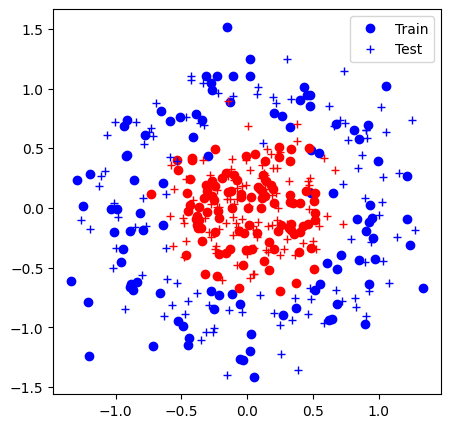

Iter 0: Acc train 0.6% (0.69), acc test 0.6% (0.69)


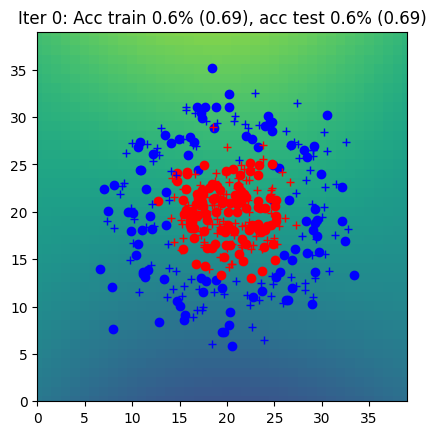

Iter 1: Acc train 0.5% (0.70), acc test 0.5% (0.70)


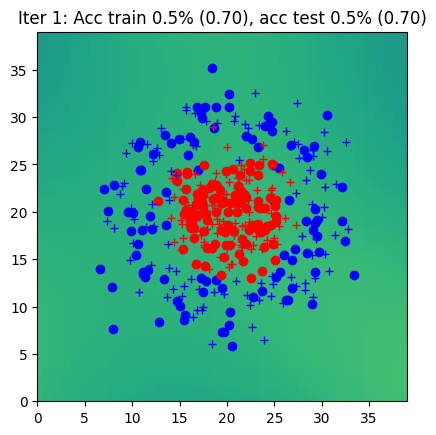

Iter 2: Acc train 0.5% (0.69), acc test 0.6% (0.69)


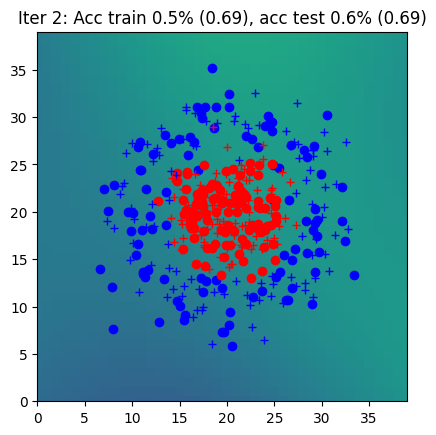

Iter 3: Acc train 0.5% (0.69), acc test 0.6% (0.69)


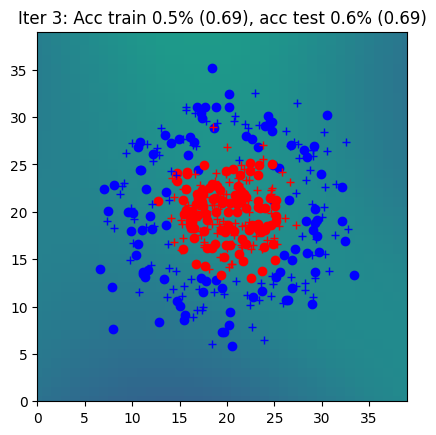

Iter 4: Acc train 0.5% (0.68), acc test 0.5% (0.68)


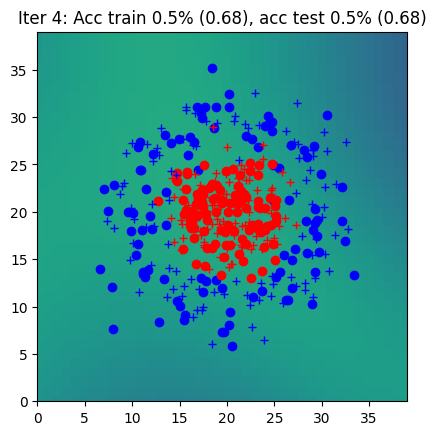

Iter 5: Acc train 0.5% (0.68), acc test 0.5% (0.68)


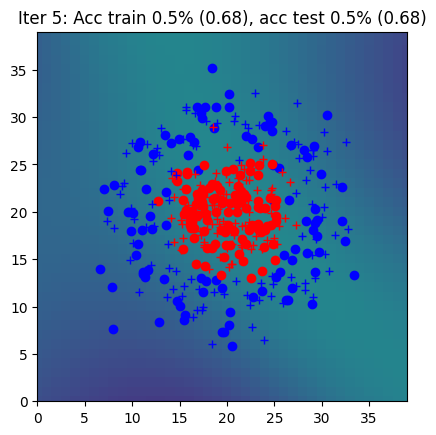

Iter 6: Acc train 0.6% (0.66), acc test 0.6% (0.67)


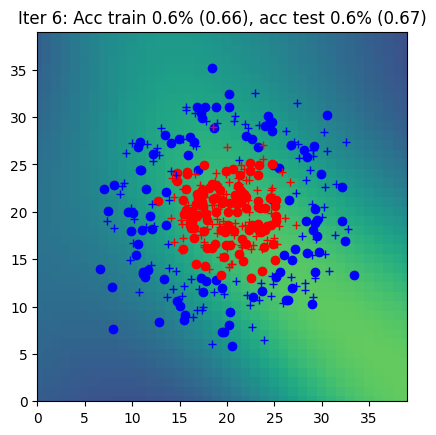

Iter 7: Acc train 0.5% (0.66), acc test 0.5% (0.66)


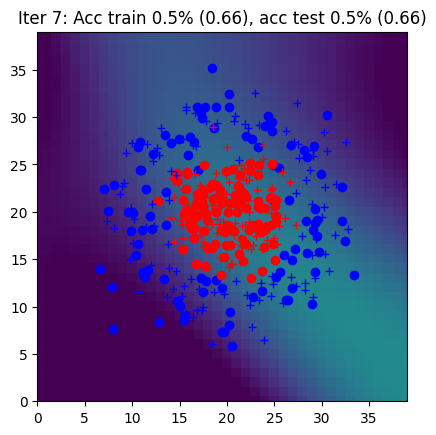

Iter 8: Acc train 0.7% (0.62), acc test 0.7% (0.63)


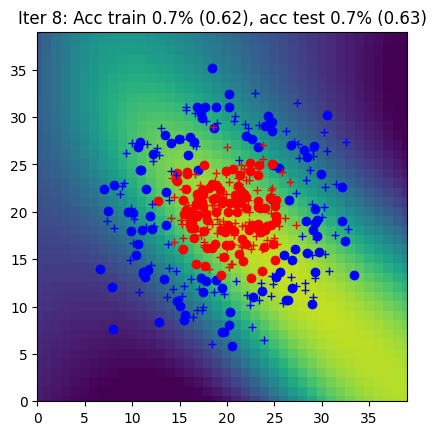

Iter 9: Acc train 0.8% (0.57), acc test 0.8% (0.59)


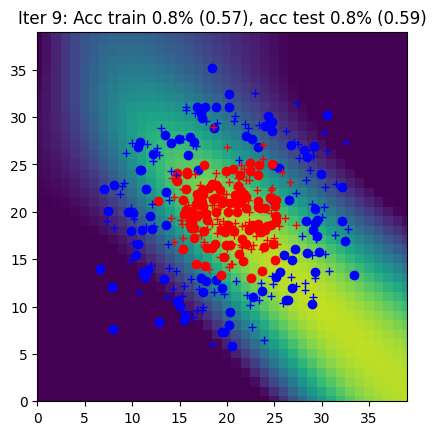

Iter 10: Acc train 0.8% (0.54), acc test 0.8% (0.57)


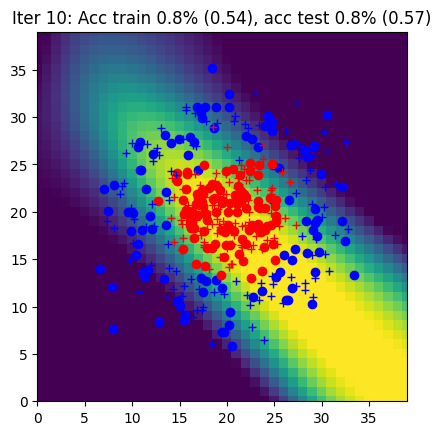

Iter 11: Acc train 0.8% (0.52), acc test 0.7% (0.54)


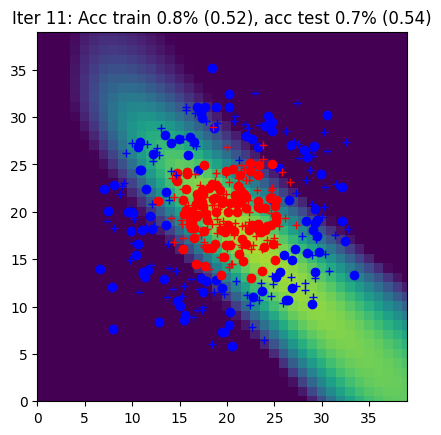

Iter 12: Acc train 0.8% (0.49), acc test 0.8% (0.52)


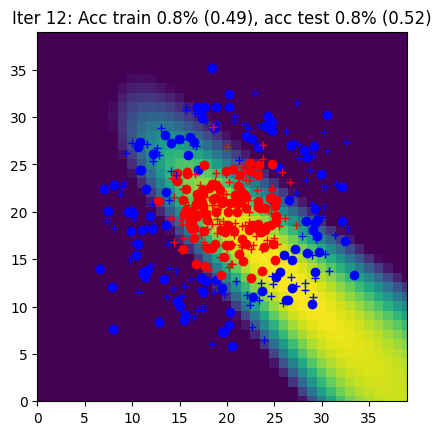

Iter 13: Acc train 0.8% (0.48), acc test 0.8% (0.51)


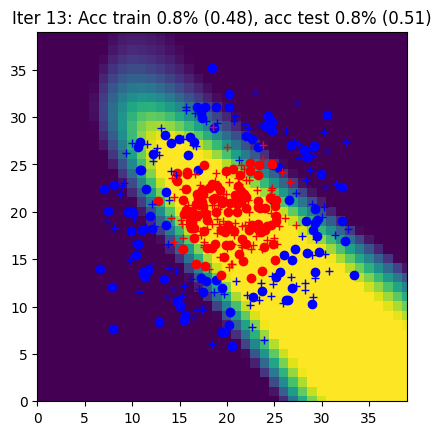

Iter 14: Acc train 0.8% (0.44), acc test 0.8% (0.48)


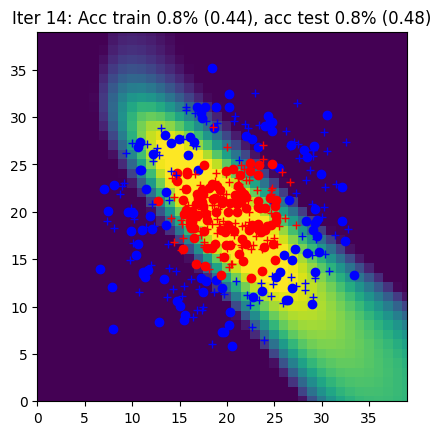

Iter 15: Acc train 0.8% (0.42), acc test 0.8% (0.46)


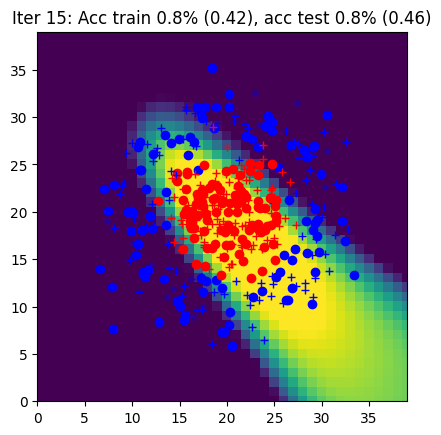

Iter 16: Acc train 0.8% (0.39), acc test 0.8% (0.42)


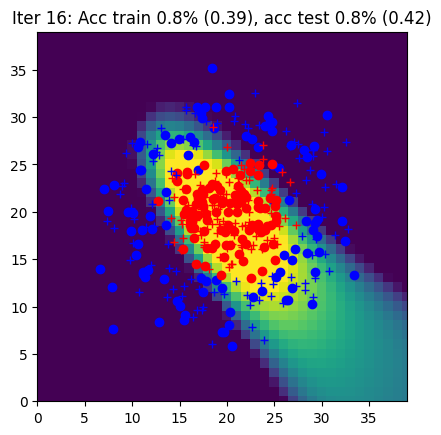

Iter 17: Acc train 0.9% (0.35), acc test 0.8% (0.38)


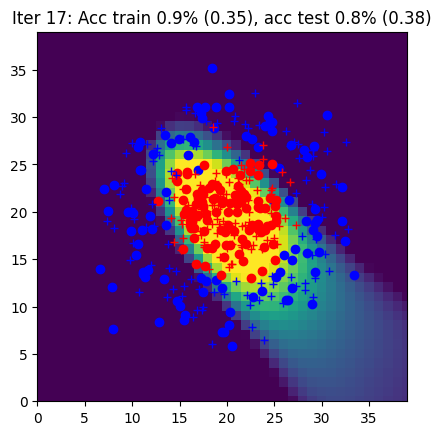

Iter 18: Acc train 0.9% (0.31), acc test 0.9% (0.34)


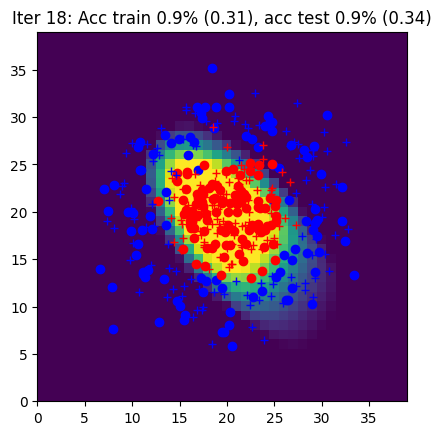

Iter 19: Acc train 0.9% (0.28), acc test 0.9% (0.29)


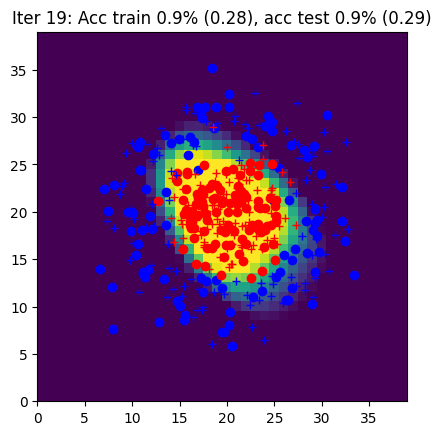

Iter 20: Acc train 0.9% (0.26), acc test 0.9% (0.28)


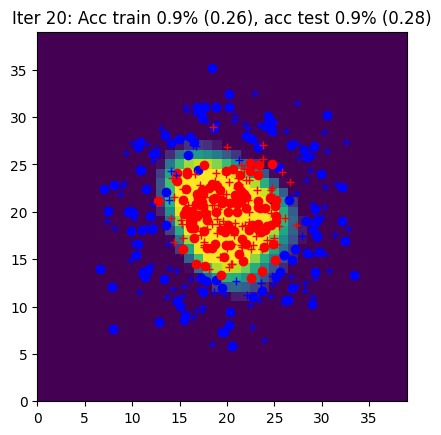

Iter 21: Acc train 0.9% (0.24), acc test 0.9% (0.26)


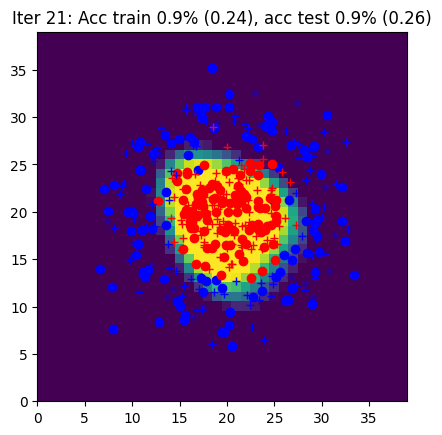

Iter 22: Acc train 0.9% (0.22), acc test 0.9% (0.23)


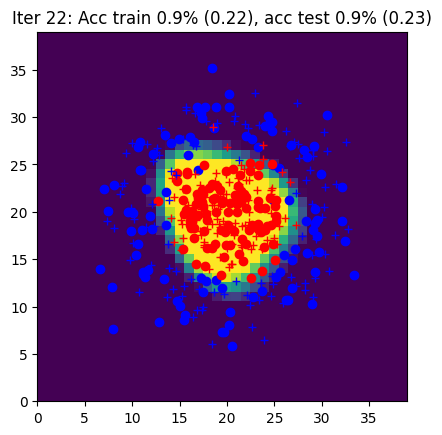

Iter 23: Acc train 0.9% (0.21), acc test 0.9% (0.22)


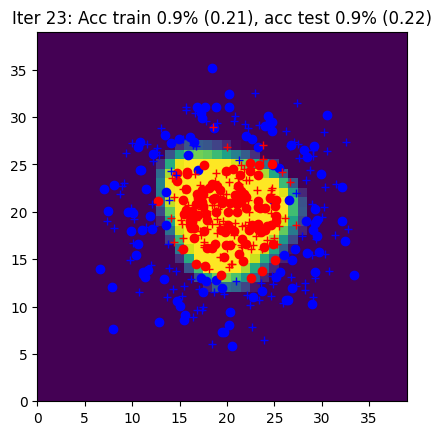

Iter 24: Acc train 0.9% (0.21), acc test 0.9% (0.23)


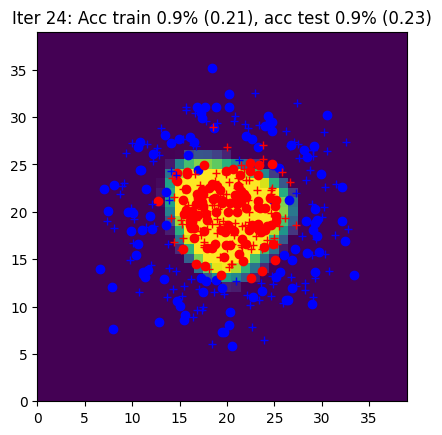

Iter 25: Acc train 0.9% (0.20), acc test 0.9% (0.22)


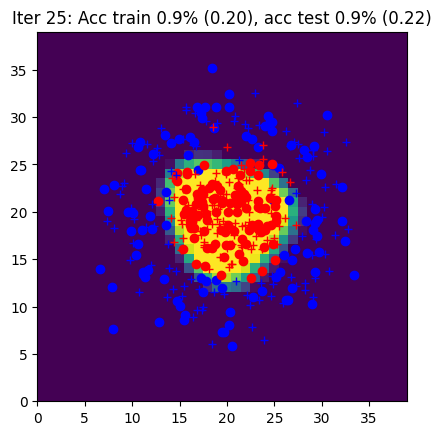

Iter 26: Acc train 0.9% (0.19), acc test 0.9% (0.19)


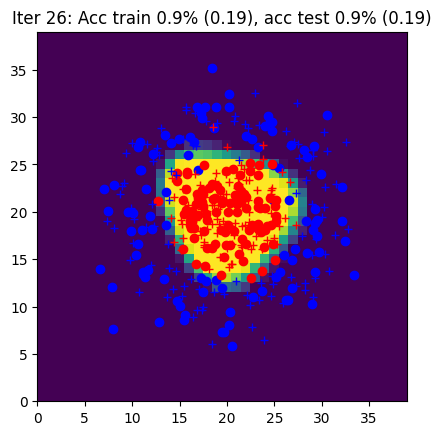

Iter 27: Acc train 0.9% (0.19), acc test 0.9% (0.19)


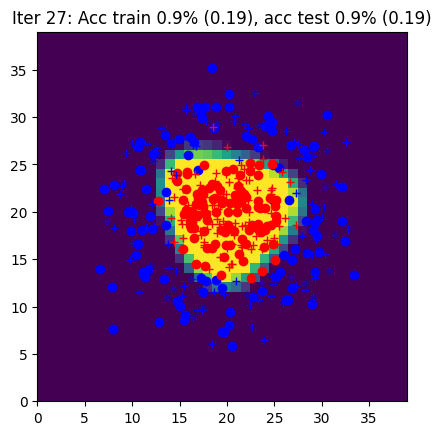

Iter 28: Acc train 0.9% (0.18), acc test 0.9% (0.18)


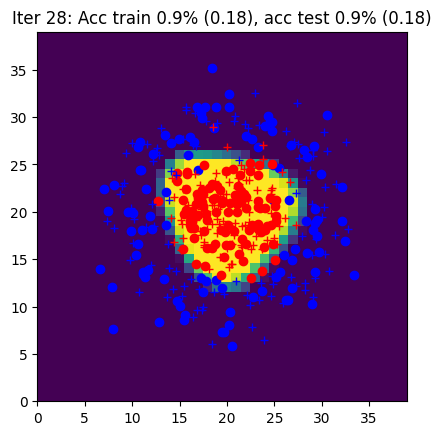

Iter 29: Acc train 0.9% (0.19), acc test 0.9% (0.21)


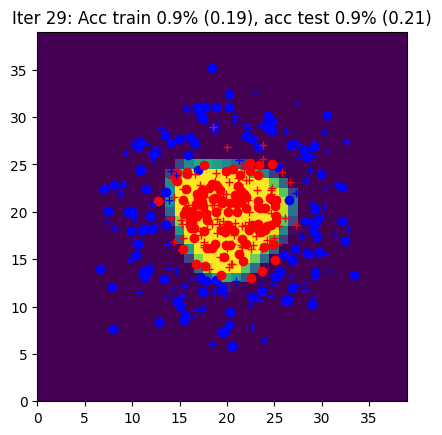

Iter 30: Acc train 0.9% (0.18), acc test 0.9% (0.18)


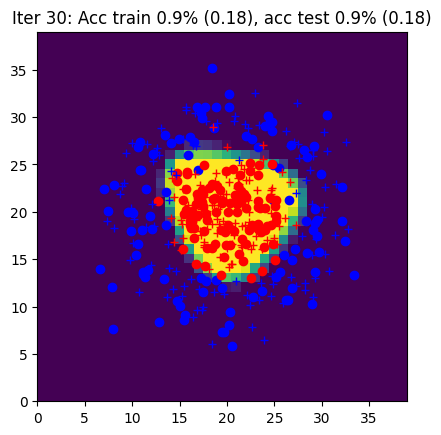

Iter 31: Acc train 0.9% (0.17), acc test 0.9% (0.19)


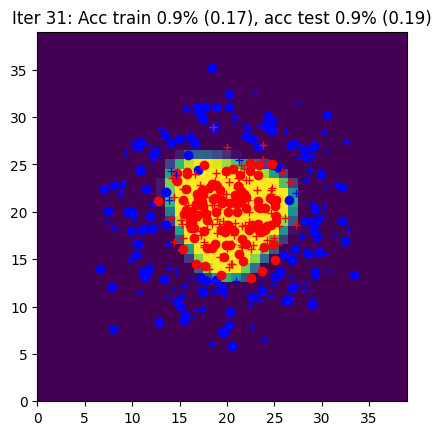

Iter 32: Acc train 0.9% (0.17), acc test 0.9% (0.18)


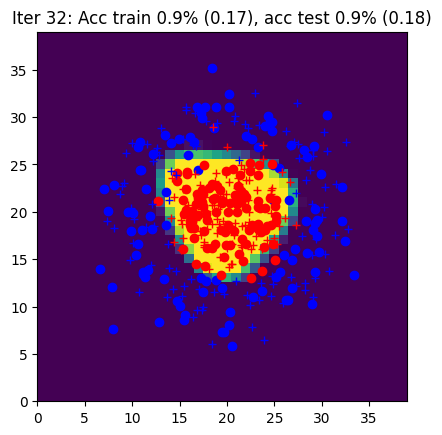

Iter 33: Acc train 0.9% (0.17), acc test 0.9% (0.19)


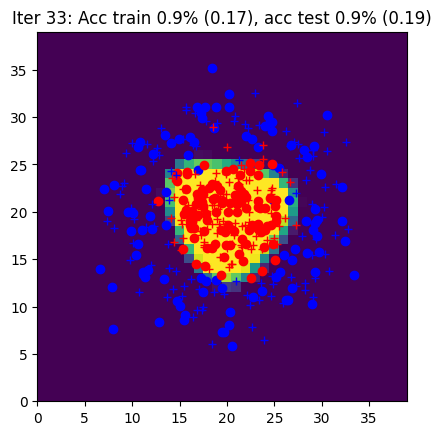

Iter 34: Acc train 0.9% (0.16), acc test 0.9% (0.19)


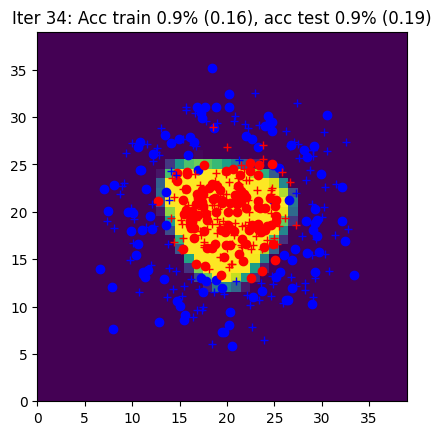

Iter 35: Acc train 0.9% (0.17), acc test 0.9% (0.19)


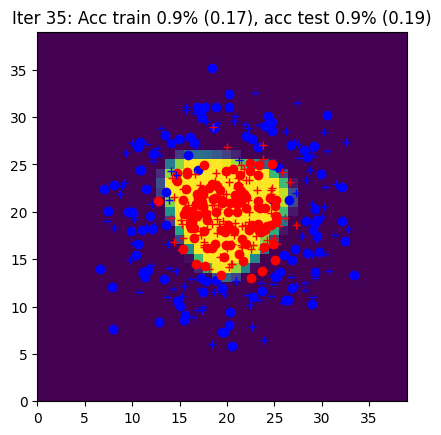

Iter 36: Acc train 0.9% (0.16), acc test 0.9% (0.17)


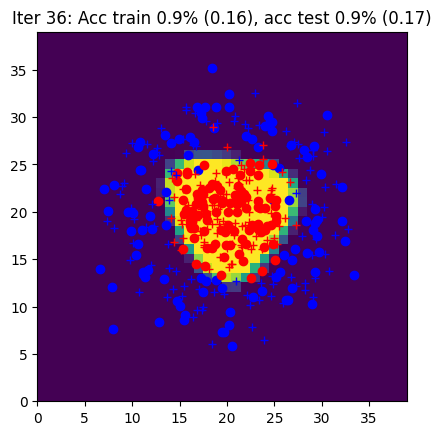

Iter 37: Acc train 0.9% (0.16), acc test 0.9% (0.19)


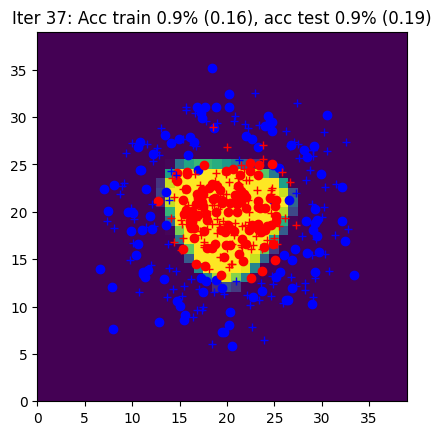

Iter 38: Acc train 0.9% (0.17), acc test 0.9% (0.18)


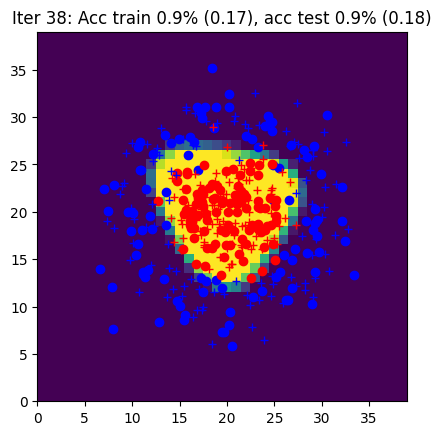

Iter 39: Acc train 0.9% (0.15), acc test 0.9% (0.17)


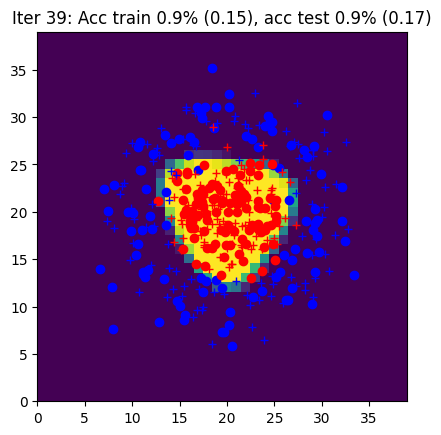

Iter 40: Acc train 0.9% (0.16), acc test 0.9% (0.19)


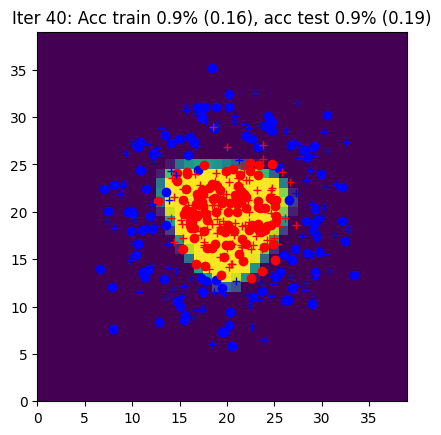

Iter 41: Acc train 0.9% (0.15), acc test 0.9% (0.17)


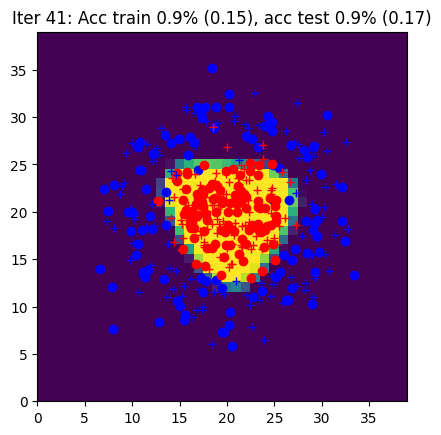

Iter 42: Acc train 0.9% (0.15), acc test 0.9% (0.19)


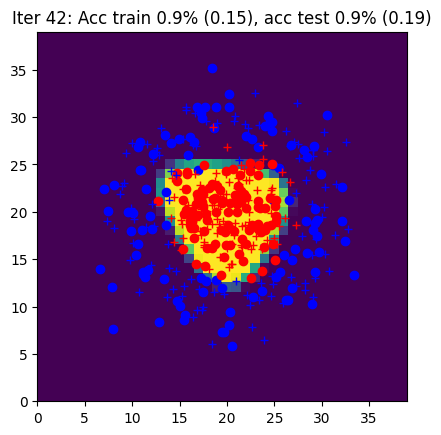

Iter 43: Acc train 0.9% (0.15), acc test 0.9% (0.17)


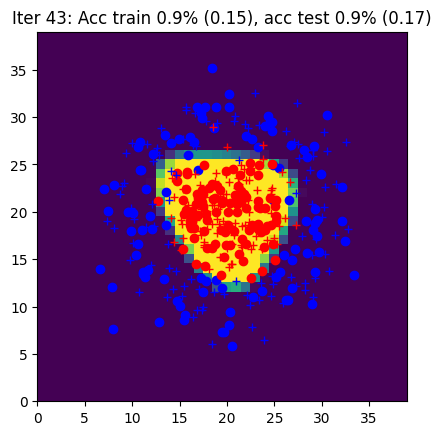

Iter 44: Acc train 0.9% (0.15), acc test 0.9% (0.17)


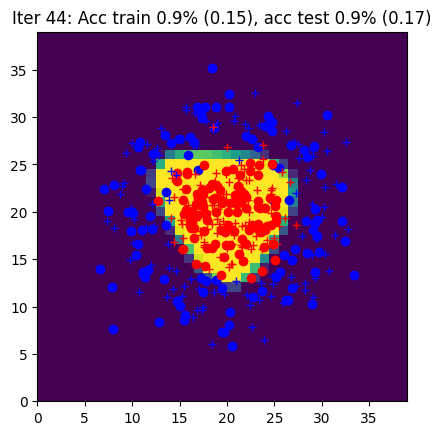

Iter 45: Acc train 0.9% (0.15), acc test 0.9% (0.19)


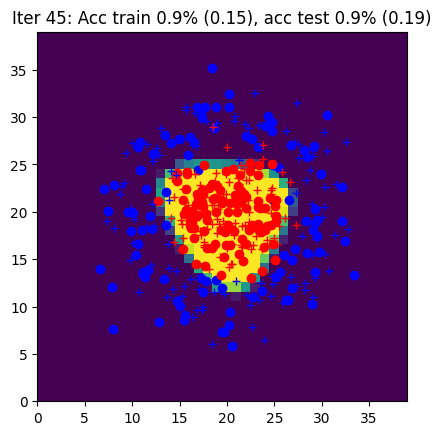

Iter 46: Acc train 0.9% (0.15), acc test 0.9% (0.18)


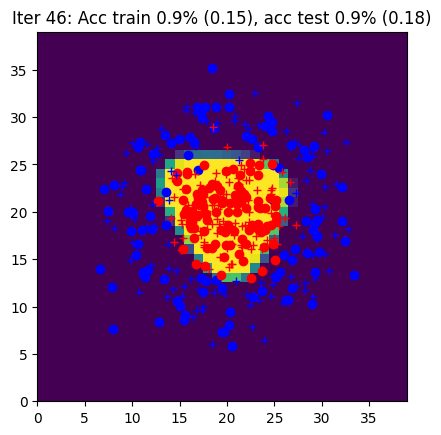

Iter 47: Acc train 0.9% (0.15), acc test 0.9% (0.16)


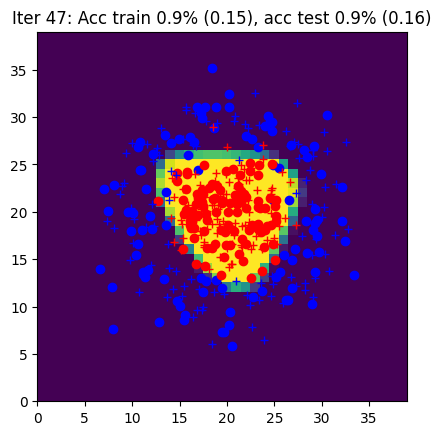

Iter 48: Acc train 0.9% (0.14), acc test 0.9% (0.18)


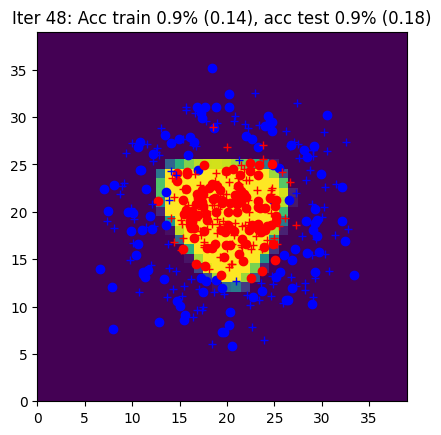

Iter 49: Acc train 0.9% (0.14), acc test 0.9% (0.19)


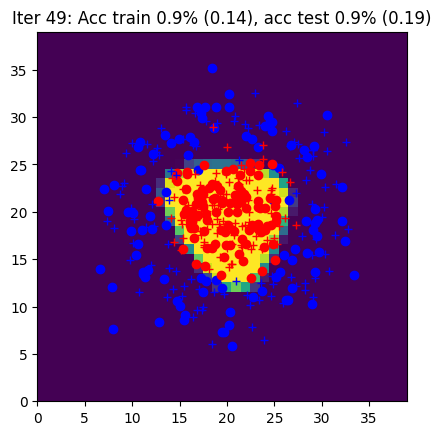

Iter 50: Acc train 0.9% (0.14), acc test 0.9% (0.17)


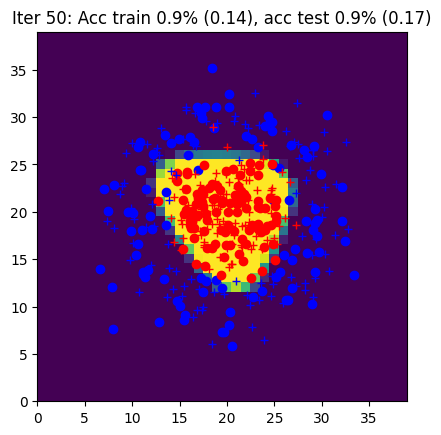

Iter 51: Acc train 0.9% (0.14), acc test 0.9% (0.20)


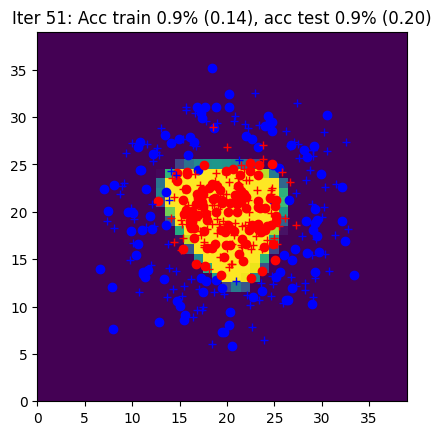

Iter 52: Acc train 0.9% (0.16), acc test 0.9% (0.21)


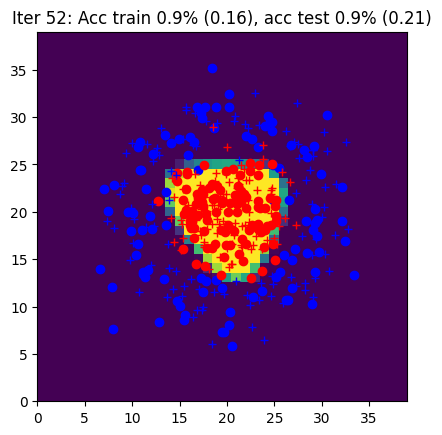

Iter 53: Acc train 0.9% (0.13), acc test 0.9% (0.18)


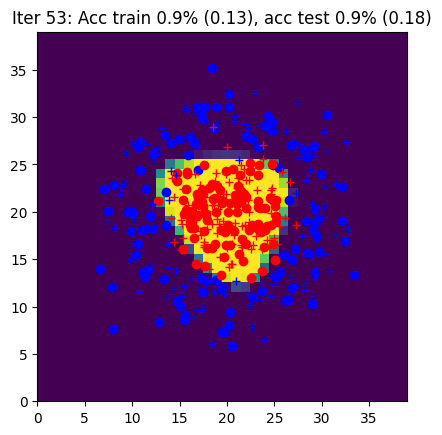

Iter 54: Acc train 0.9% (0.16), acc test 0.9% (0.24)


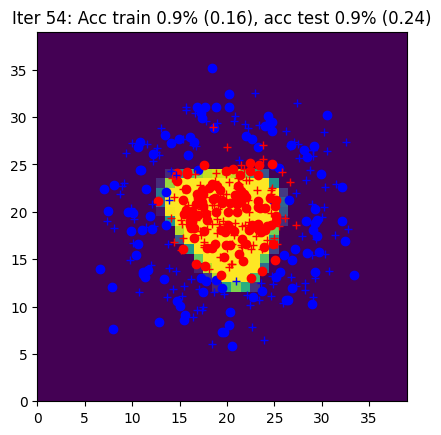

Iter 55: Acc train 0.9% (0.13), acc test 0.9% (0.17)


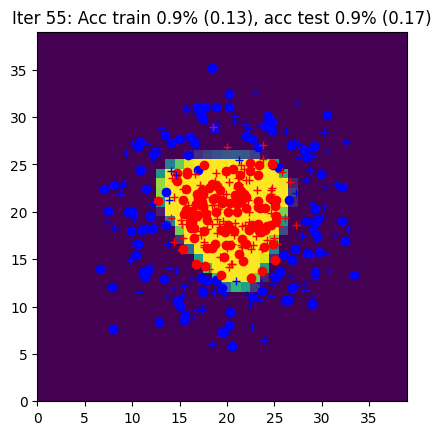

Iter 56: Acc train 0.9% (0.14), acc test 0.9% (0.21)


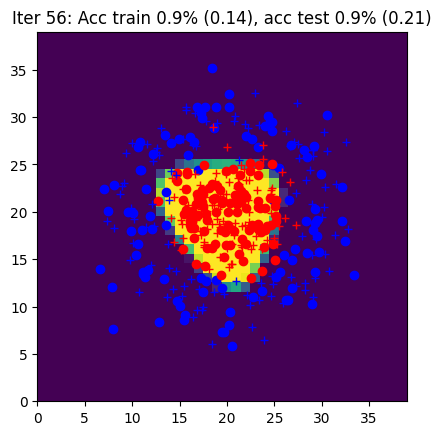

Iter 57: Acc train 0.9% (0.13), acc test 0.9% (0.18)


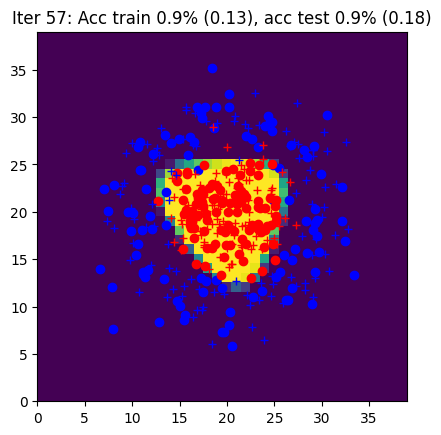

Iter 58: Acc train 0.9% (0.14), acc test 0.9% (0.17)


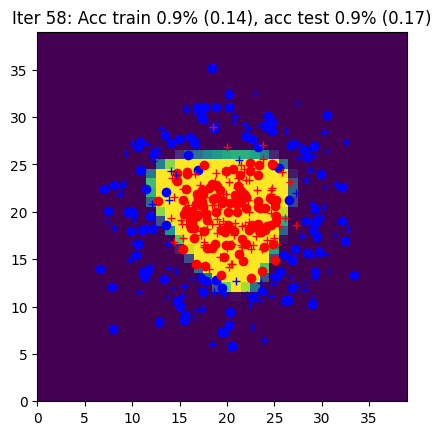

Iter 59: Acc train 0.9% (0.15), acc test 0.9% (0.18)


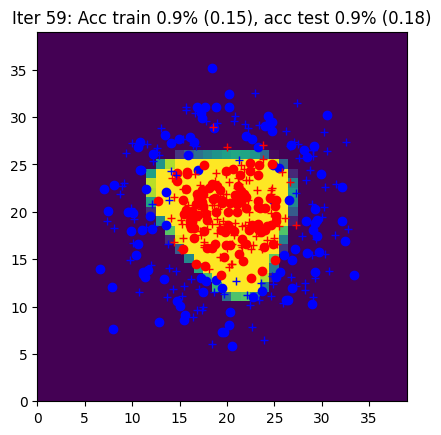

Iter 60: Acc train 0.9% (0.14), acc test 0.9% (0.21)


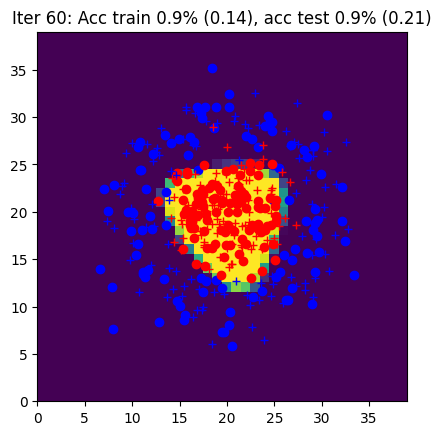

Iter 61: Acc train 0.9% (0.13), acc test 0.9% (0.17)


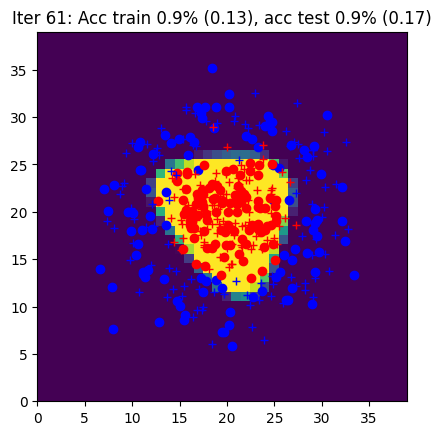

Iter 62: Acc train 1.0% (0.13), acc test 0.9% (0.18)


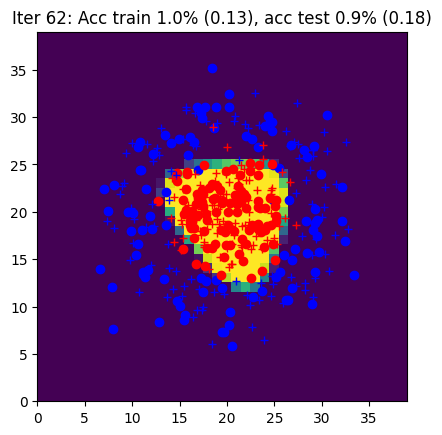

Iter 63: Acc train 1.0% (0.12), acc test 0.9% (0.17)


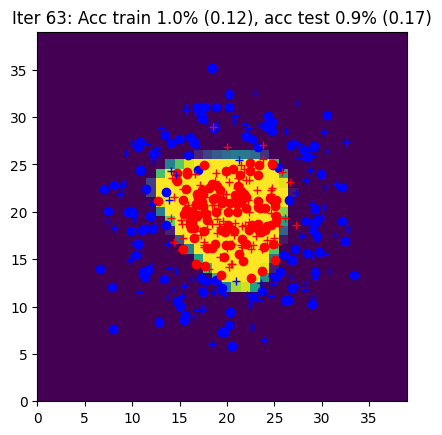

Iter 64: Acc train 0.9% (0.13), acc test 0.9% (0.17)


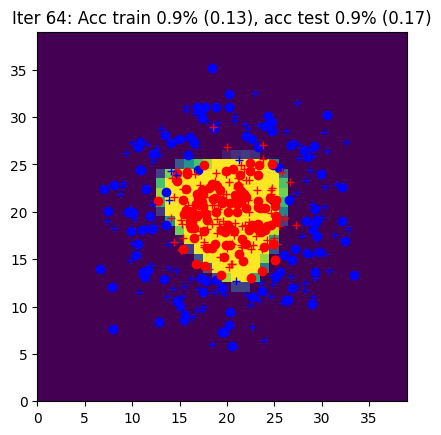

Iter 65: Acc train 0.9% (0.13), acc test 0.9% (0.17)


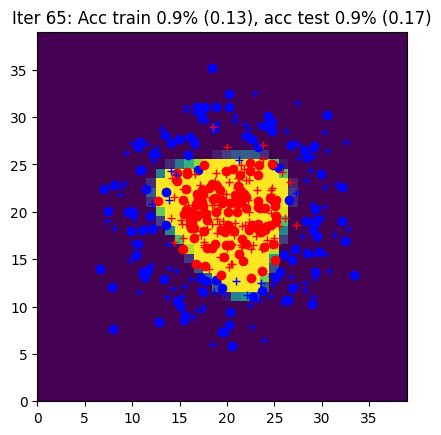

Iter 66: Acc train 1.0% (0.13), acc test 0.9% (0.20)


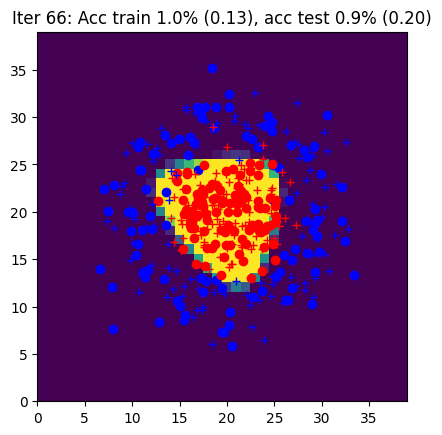

Iter 67: Acc train 0.9% (0.14), acc test 0.9% (0.22)


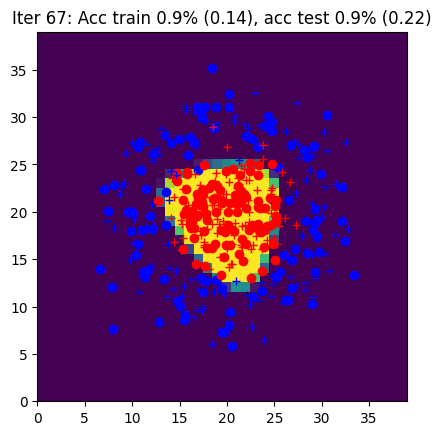

Iter 68: Acc train 0.9% (0.16), acc test 0.9% (0.24)


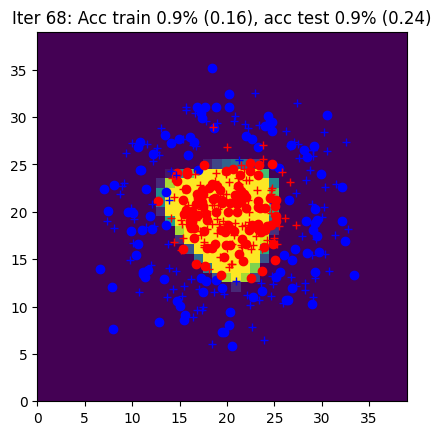

Iter 69: Acc train 1.0% (0.13), acc test 0.9% (0.17)


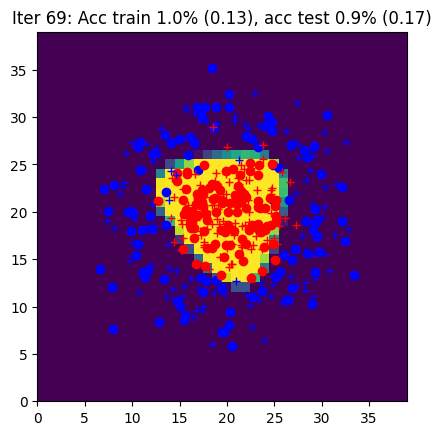

Iter 70: Acc train 1.0% (0.13), acc test 0.9% (0.16)


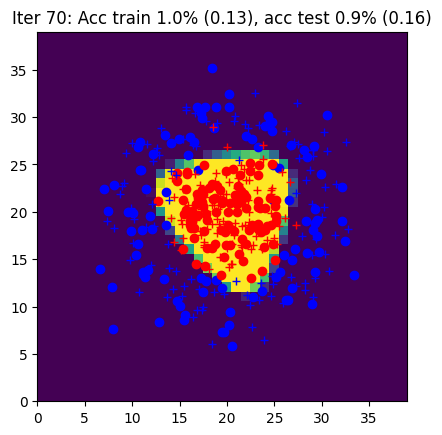

Iter 71: Acc train 0.9% (0.12), acc test 0.9% (0.19)


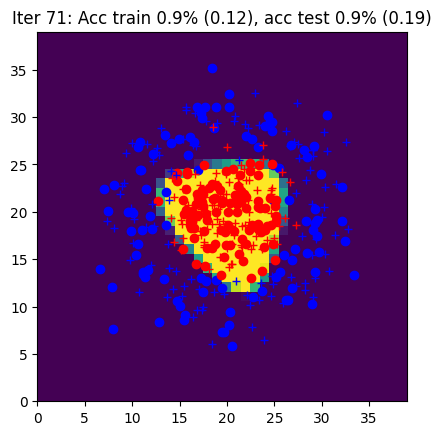

Iter 72: Acc train 0.9% (0.12), acc test 0.9% (0.18)


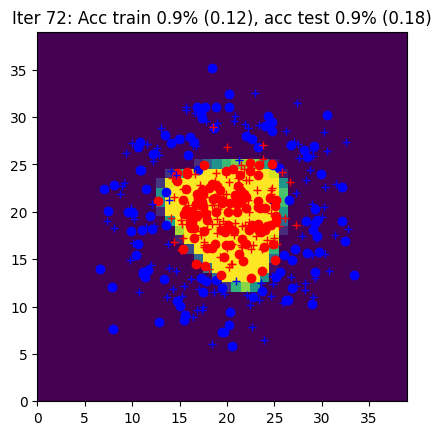

Iter 73: Acc train 0.9% (0.13), acc test 0.9% (0.20)


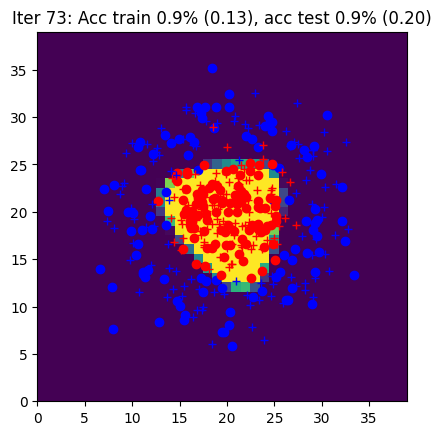

Iter 74: Acc train 1.0% (0.12), acc test 0.9% (0.17)


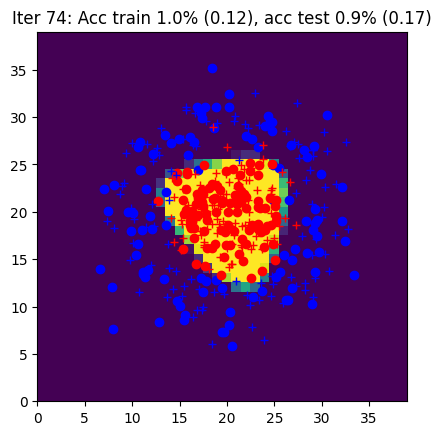

Iter 75: Acc train 1.0% (0.12), acc test 0.9% (0.19)


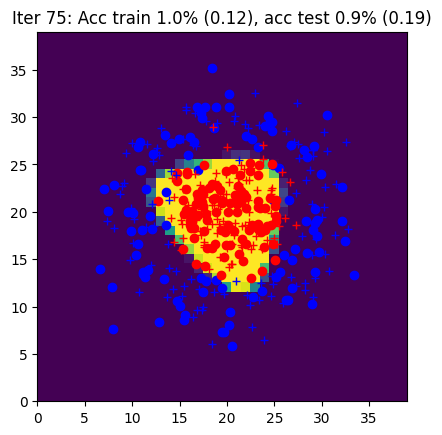

Iter 76: Acc train 1.0% (0.13), acc test 0.9% (0.17)


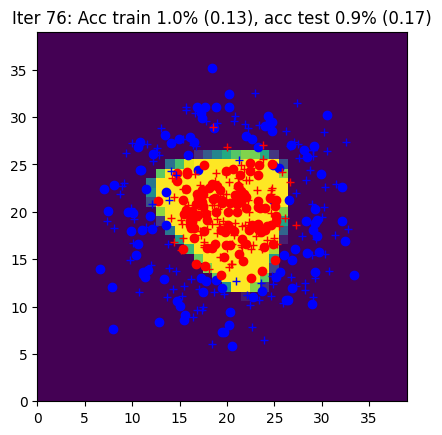

Iter 77: Acc train 1.0% (0.13), acc test 0.9% (0.19)


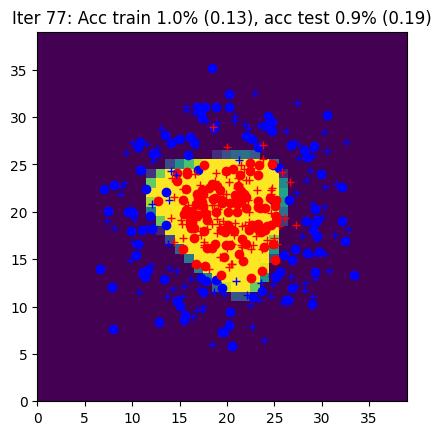

Iter 78: Acc train 1.0% (0.13), acc test 0.9% (0.17)


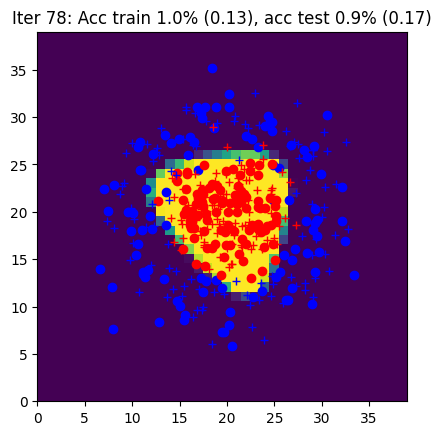

Iter 79: Acc train 0.9% (0.14), acc test 0.9% (0.19)


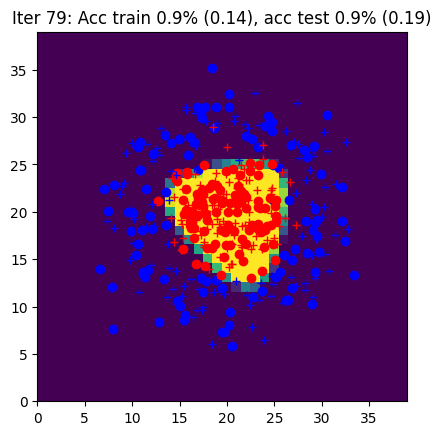

Iter 80: Acc train 0.9% (0.14), acc test 0.9% (0.22)


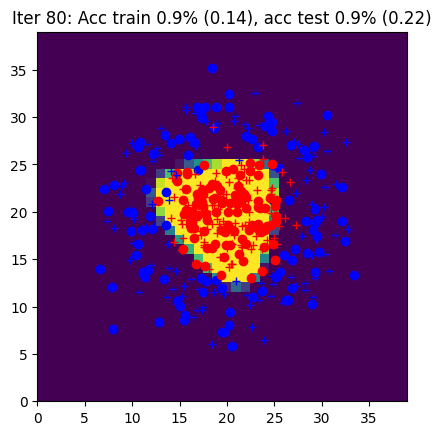

Iter 81: Acc train 0.9% (0.13), acc test 0.9% (0.17)


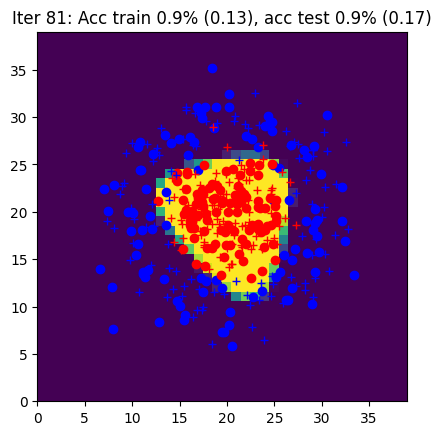

Iter 82: Acc train 1.0% (0.12), acc test 0.9% (0.17)


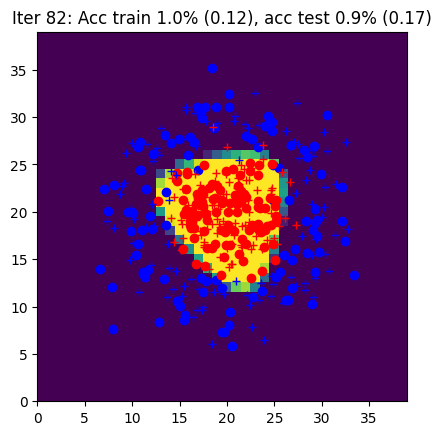

Iter 83: Acc train 1.0% (0.11), acc test 0.9% (0.17)


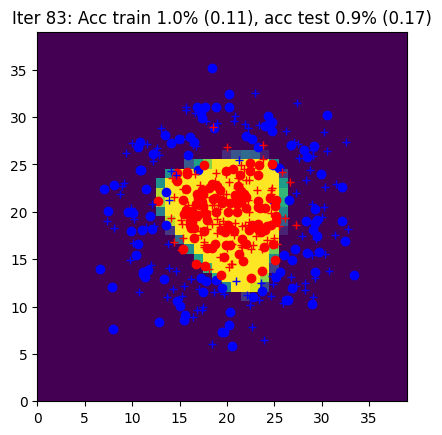

Iter 84: Acc train 1.0% (0.12), acc test 0.9% (0.17)


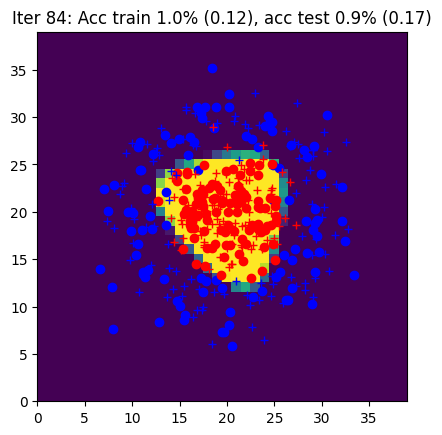

Iter 85: Acc train 1.0% (0.12), acc test 0.9% (0.17)


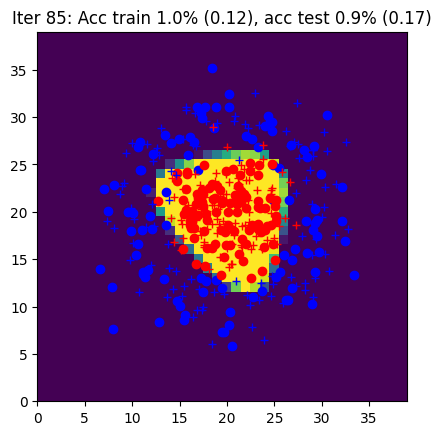

Iter 86: Acc train 0.9% (0.13), acc test 0.9% (0.21)


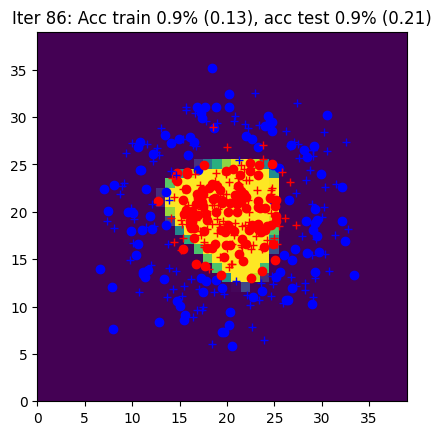

Iter 87: Acc train 1.0% (0.13), acc test 0.9% (0.17)


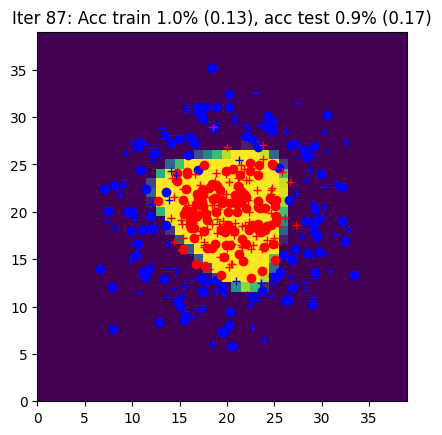

Iter 88: Acc train 0.9% (0.12), acc test 0.9% (0.17)


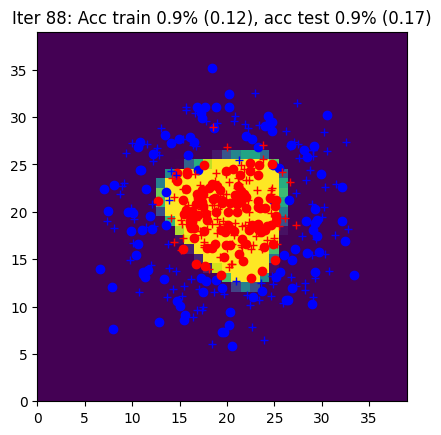

Iter 89: Acc train 0.9% (0.13), acc test 0.9% (0.19)


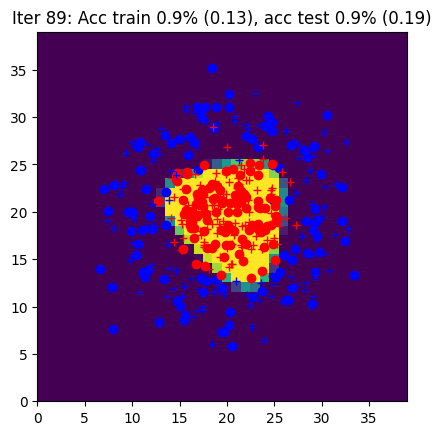

Iter 90: Acc train 0.9% (0.14), acc test 0.9% (0.22)


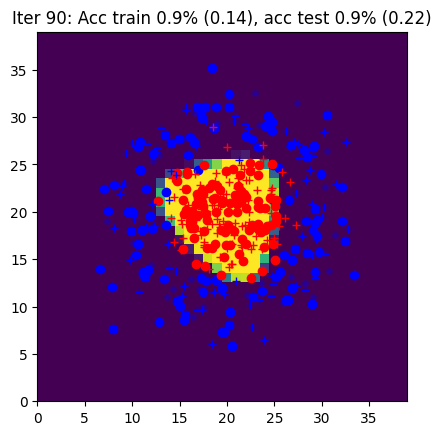

Iter 91: Acc train 1.0% (0.11), acc test 0.9% (0.18)


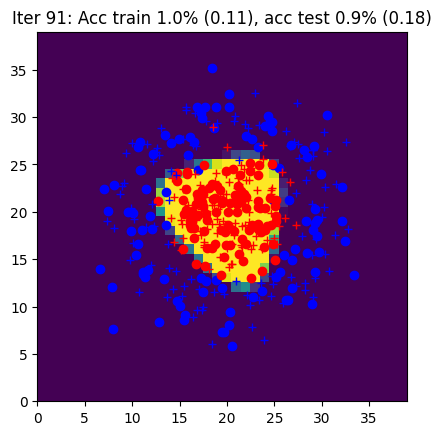

Iter 92: Acc train 0.9% (0.13), acc test 0.9% (0.20)


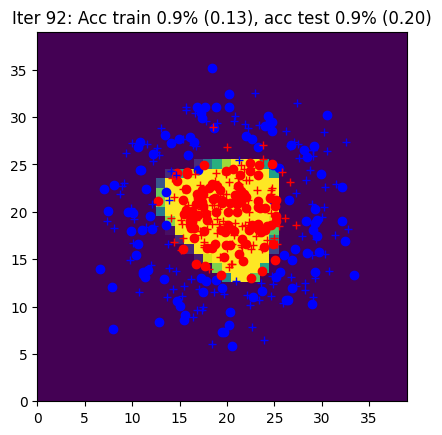

Iter 93: Acc train 0.9% (0.15), acc test 0.9% (0.18)


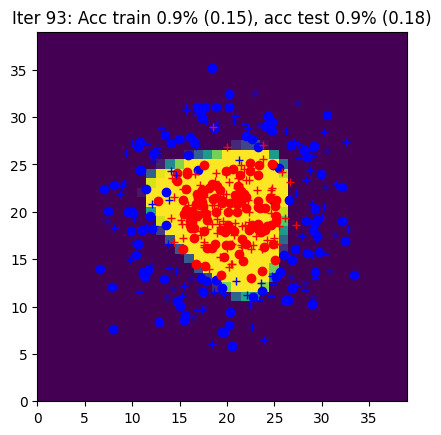

Iter 94: Acc train 1.0% (0.11), acc test 0.9% (0.17)


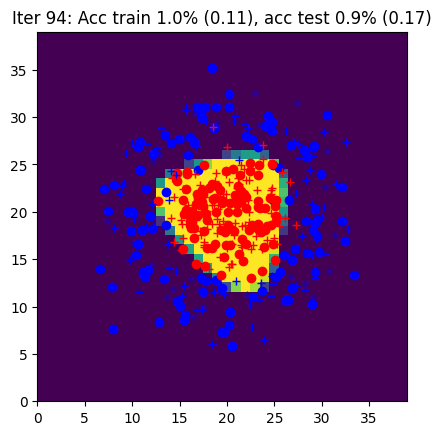

Iter 95: Acc train 0.9% (0.12), acc test 0.9% (0.19)


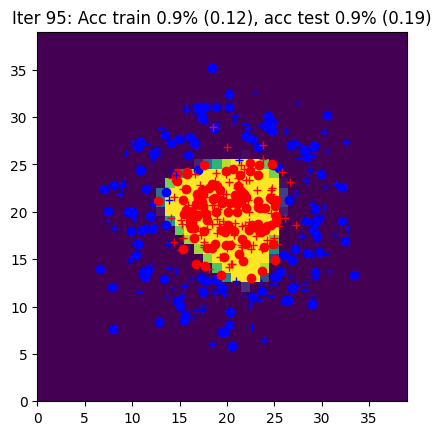

Iter 96: Acc train 1.0% (0.12), acc test 0.9% (0.18)


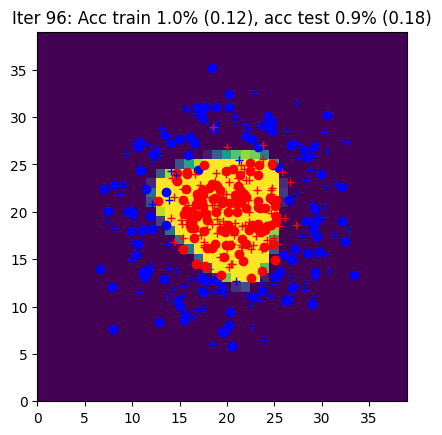

Iter 97: Acc train 1.0% (0.11), acc test 0.9% (0.18)


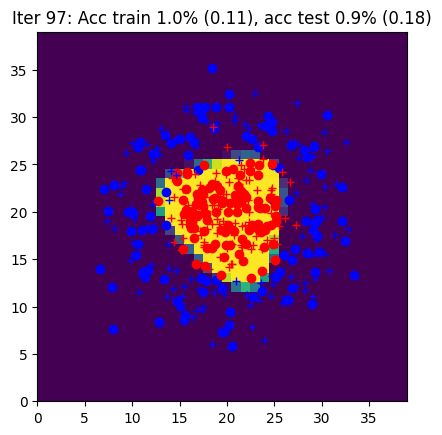

Iter 98: Acc train 0.9% (0.12), acc test 0.9% (0.21)


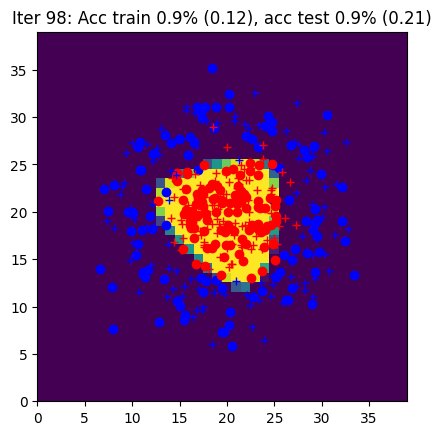

Iter 99: Acc train 1.0% (0.12), acc test 0.9% (0.16)


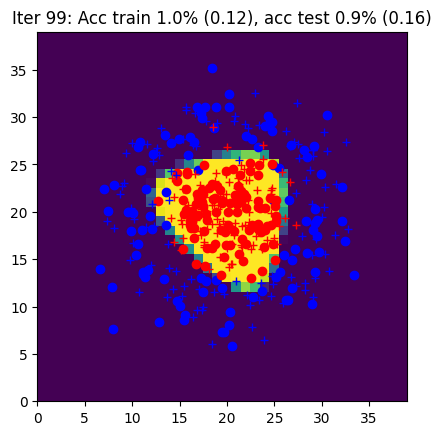

Iter 100: Acc train 1.0% (0.12), acc test 0.9% (0.17)


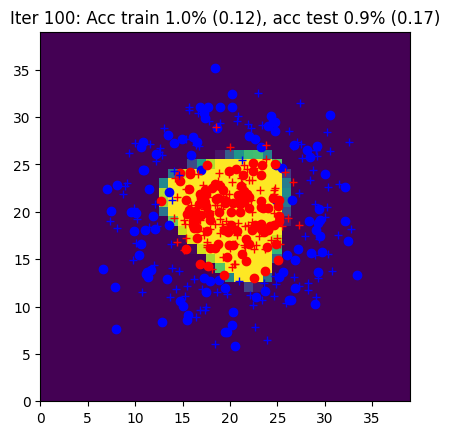

Iter 101: Acc train 1.0% (0.12), acc test 0.9% (0.16)


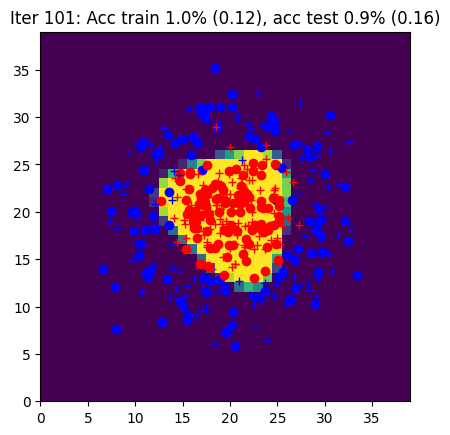

Iter 102: Acc train 0.9% (0.13), acc test 0.9% (0.22)


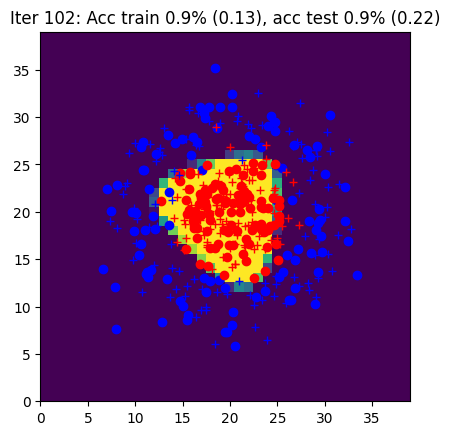

Iter 103: Acc train 1.0% (0.12), acc test 0.9% (0.17)


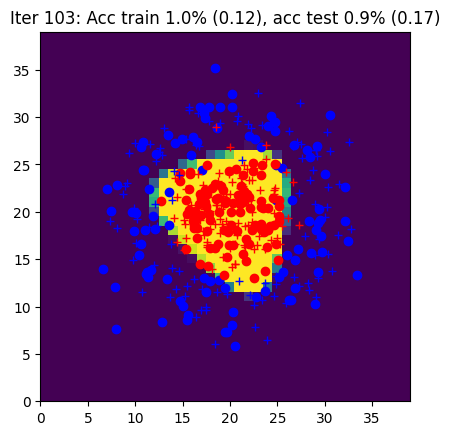

Iter 104: Acc train 1.0% (0.11), acc test 0.9% (0.16)


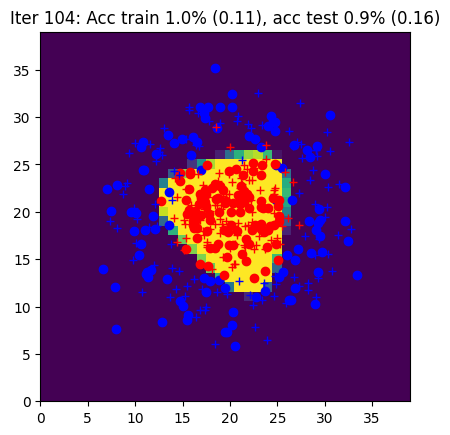

Iter 105: Acc train 1.0% (0.11), acc test 0.9% (0.17)


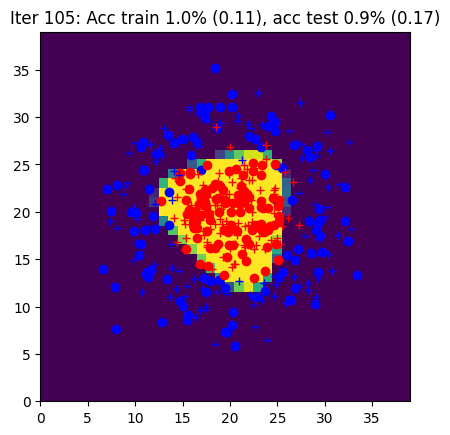

Iter 106: Acc train 1.0% (0.11), acc test 0.9% (0.17)


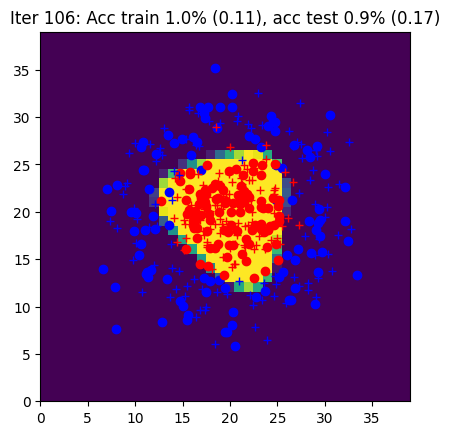

Iter 107: Acc train 1.0% (0.12), acc test 0.9% (0.17)


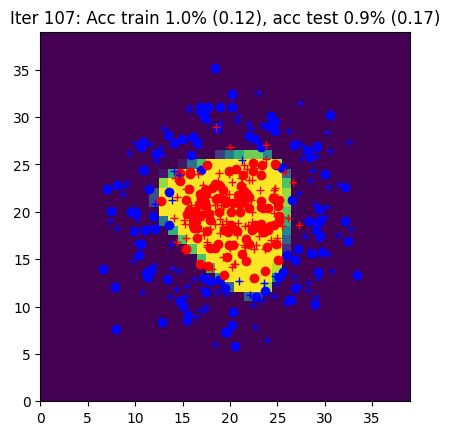

Iter 108: Acc train 0.9% (0.12), acc test 0.9% (0.20)


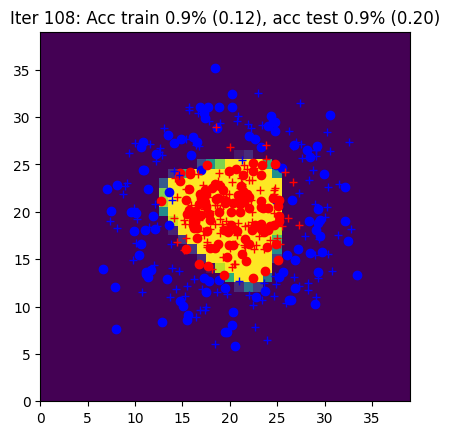

Iter 109: Acc train 1.0% (0.12), acc test 0.9% (0.21)


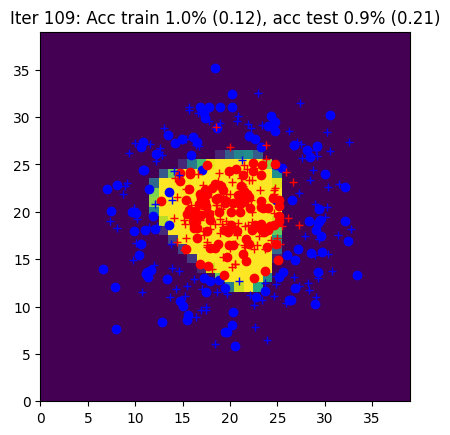

Iter 110: Acc train 1.0% (0.12), acc test 0.9% (0.18)


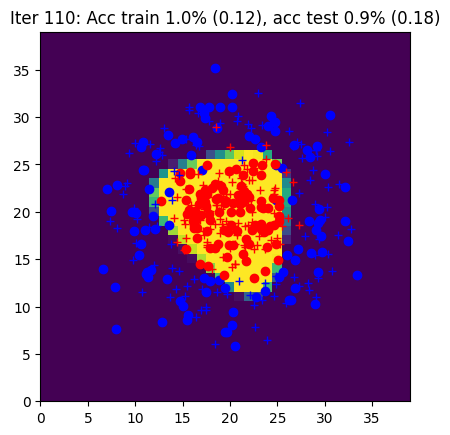

Iter 111: Acc train 0.9% (0.12), acc test 0.9% (0.18)


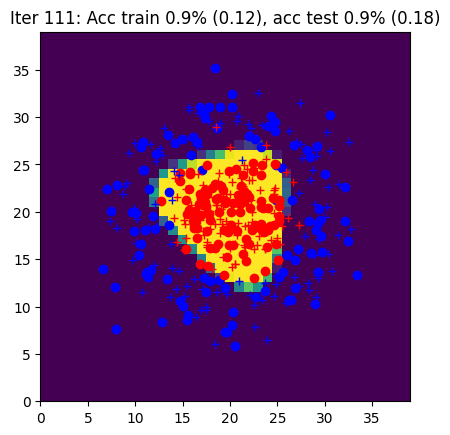

Iter 112: Acc train 0.9% (0.13), acc test 0.9% (0.17)


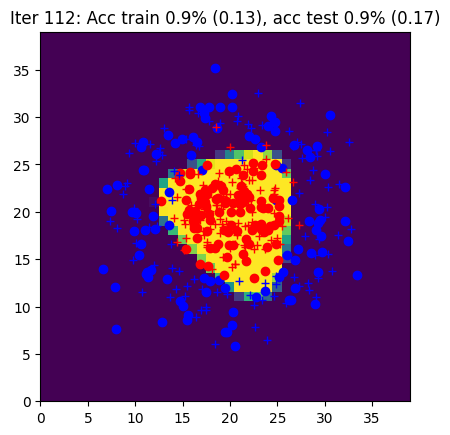

Iter 113: Acc train 1.0% (0.13), acc test 0.9% (0.16)


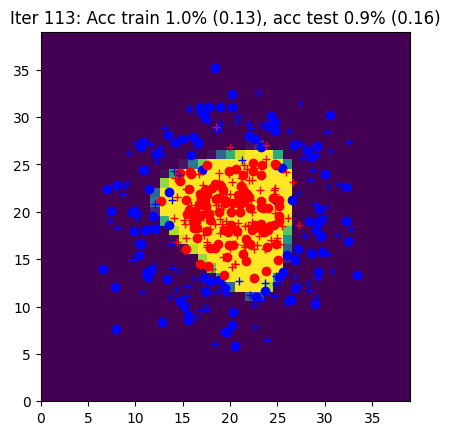

Iter 114: Acc train 0.9% (0.14), acc test 0.9% (0.20)


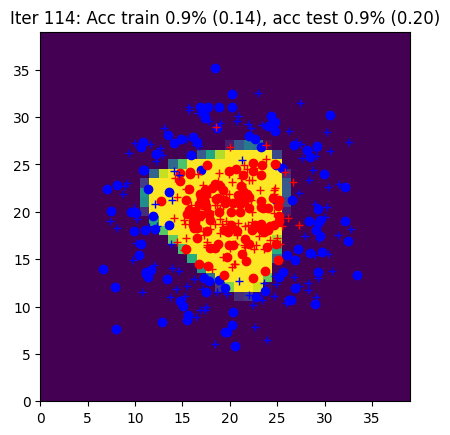

Iter 115: Acc train 1.0% (0.11), acc test 0.9% (0.19)


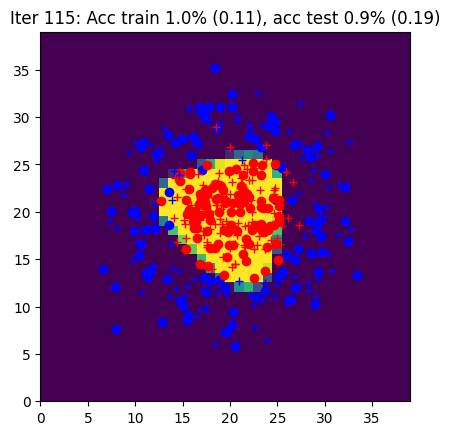

Iter 116: Acc train 0.9% (0.14), acc test 0.9% (0.18)


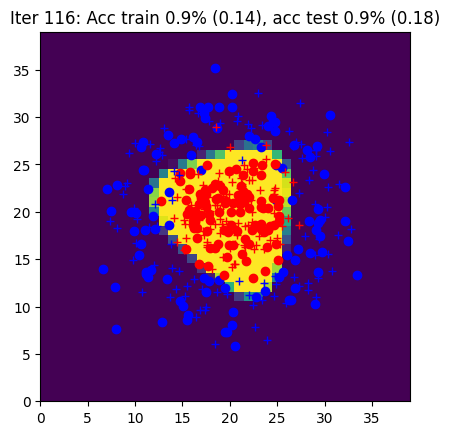

Iter 117: Acc train 0.9% (0.11), acc test 0.9% (0.18)


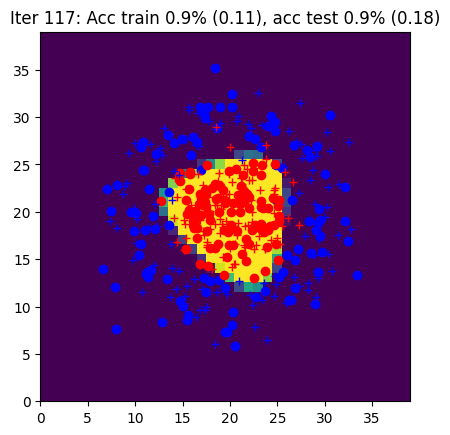

Iter 118: Acc train 1.0% (0.14), acc test 0.9% (0.17)


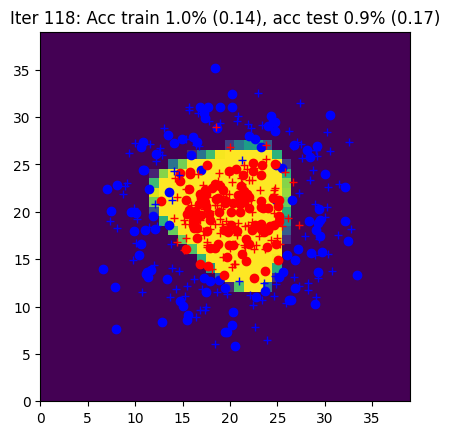

Iter 119: Acc train 0.9% (0.16), acc test 0.9% (0.22)


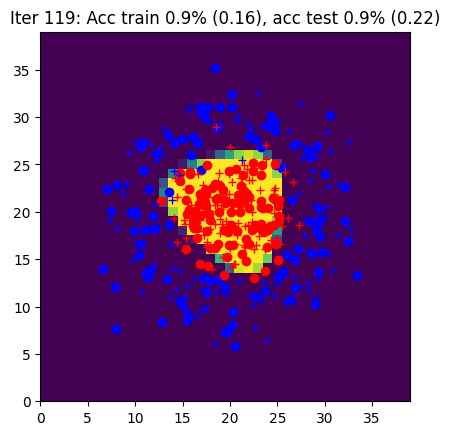

Iter 120: Acc train 0.9% (0.14), acc test 0.9% (0.24)


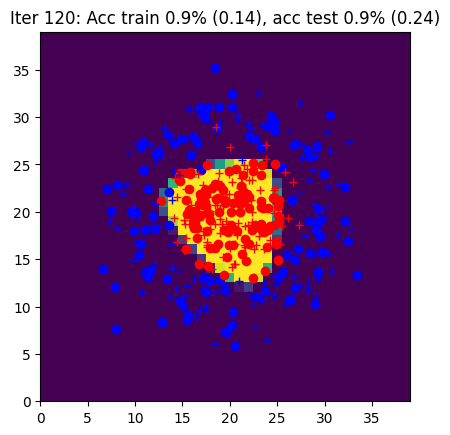

Iter 121: Acc train 1.0% (0.11), acc test 0.9% (0.21)


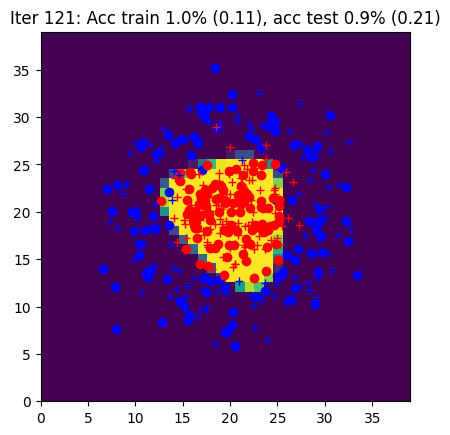

Iter 122: Acc train 1.0% (0.12), acc test 0.9% (0.18)


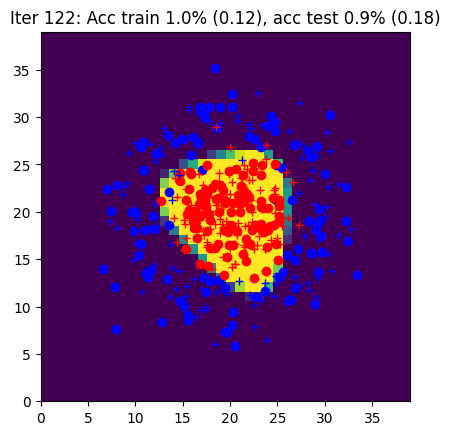

Iter 123: Acc train 0.9% (0.13), acc test 0.9% (0.20)


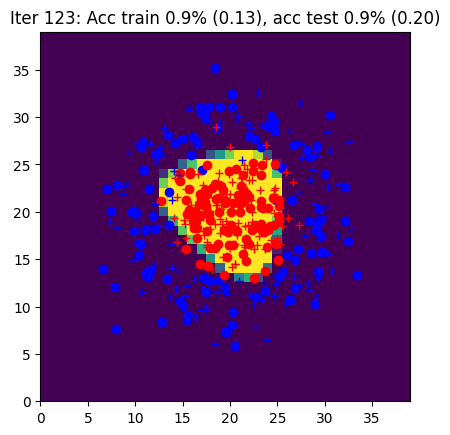

Iter 124: Acc train 1.0% (0.11), acc test 0.9% (0.20)


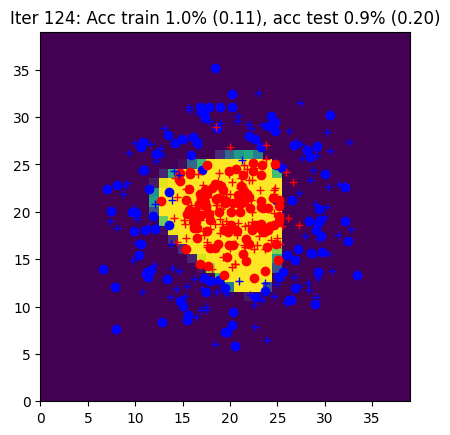

Iter 125: Acc train 1.0% (0.12), acc test 0.9% (0.20)


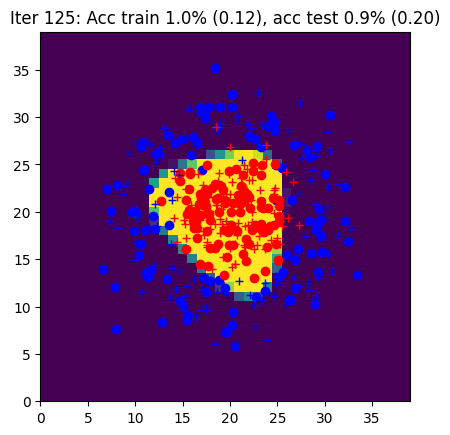

Iter 126: Acc train 1.0% (0.13), acc test 0.9% (0.20)


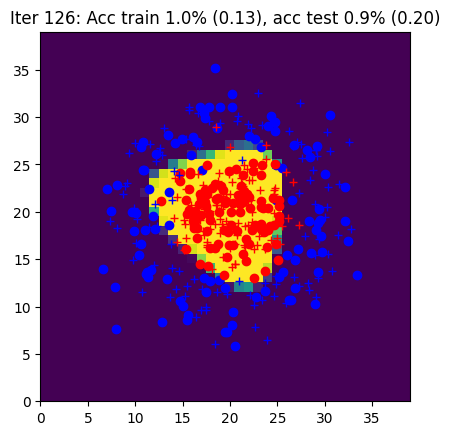

Iter 127: Acc train 1.0% (0.12), acc test 0.9% (0.16)


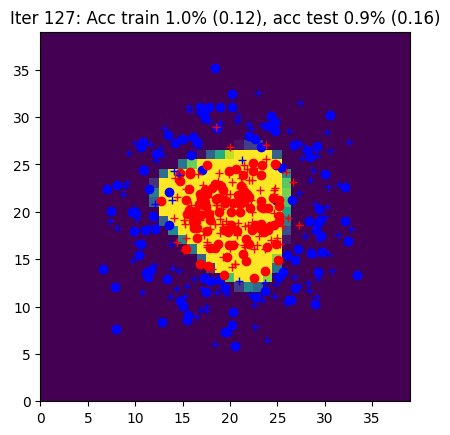

Iter 128: Acc train 0.9% (0.13), acc test 0.9% (0.23)


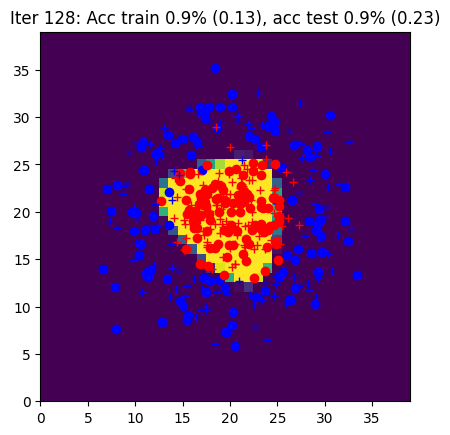

Iter 129: Acc train 1.0% (0.12), acc test 0.9% (0.18)


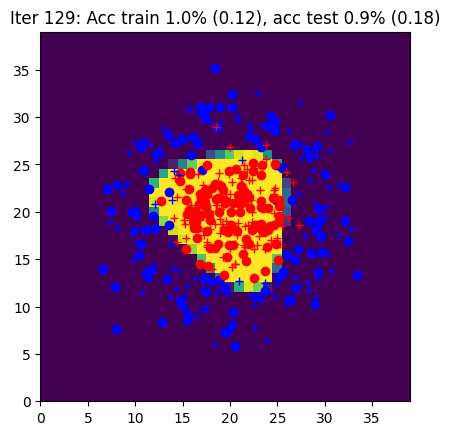

Iter 130: Acc train 0.9% (0.17), acc test 0.9% (0.27)


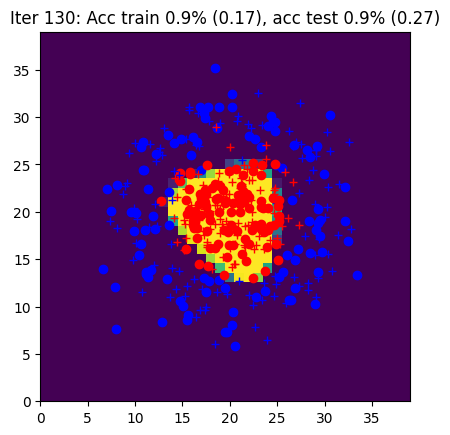

Iter 131: Acc train 1.0% (0.14), acc test 0.9% (0.18)


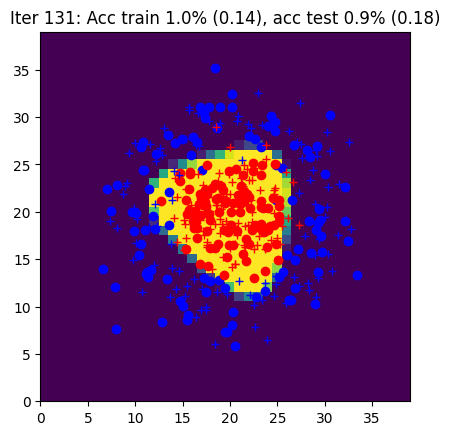

Iter 132: Acc train 0.9% (0.13), acc test 0.9% (0.22)


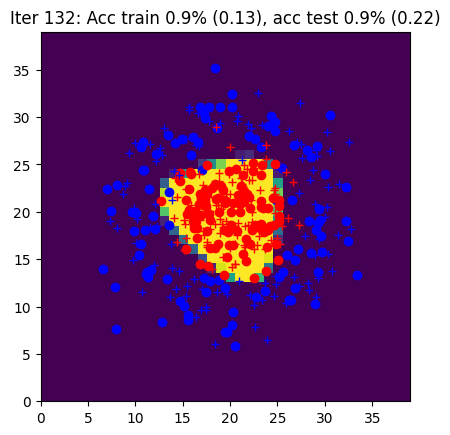

Iter 133: Acc train 0.9% (0.14), acc test 0.9% (0.16)


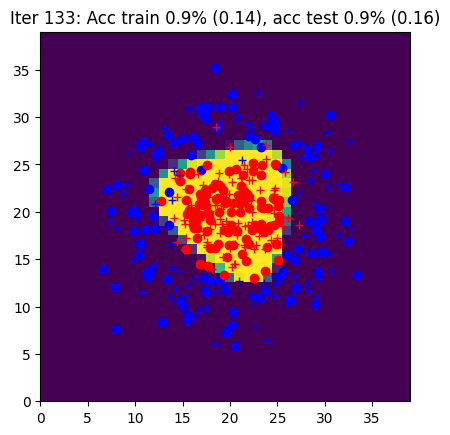

Iter 134: Acc train 1.0% (0.11), acc test 0.9% (0.18)


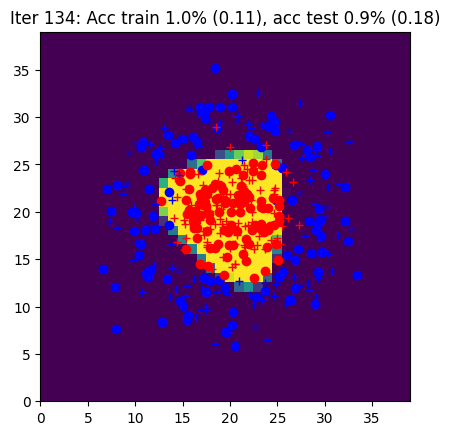

Iter 135: Acc train 0.9% (0.12), acc test 0.9% (0.17)


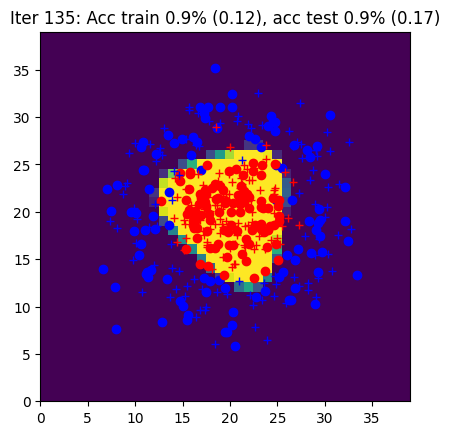

Iter 136: Acc train 1.0% (0.12), acc test 0.9% (0.19)


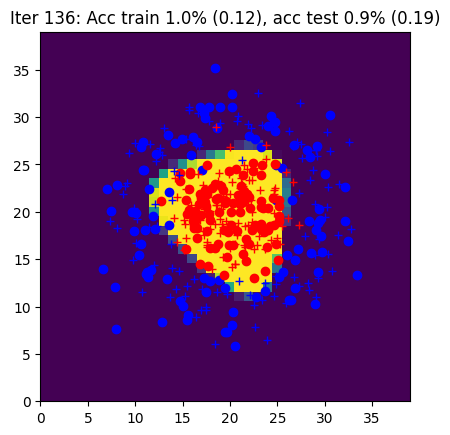

Iter 137: Acc train 1.0% (0.11), acc test 0.9% (0.18)


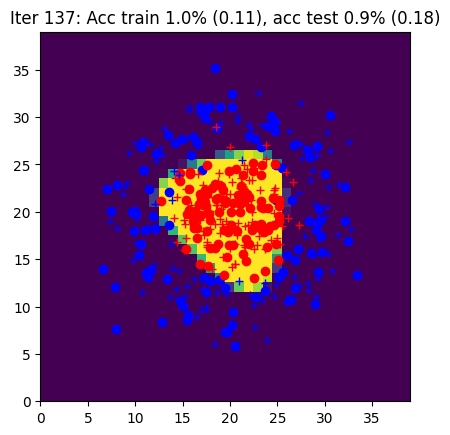

Iter 138: Acc train 0.9% (0.12), acc test 0.9% (0.22)


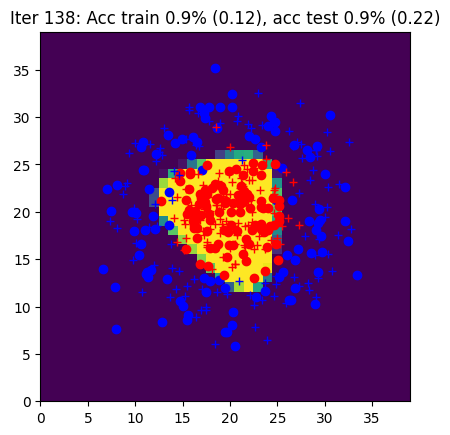

Iter 139: Acc train 0.9% (0.14), acc test 0.9% (0.19)


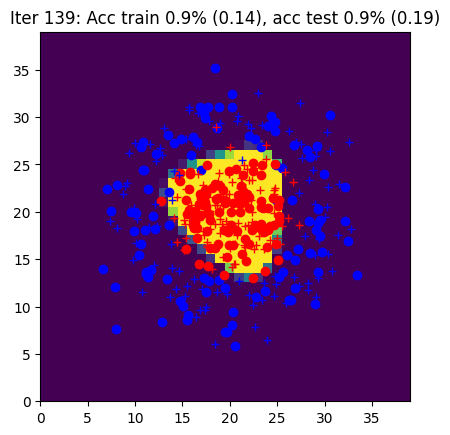

Iter 140: Acc train 1.0% (0.13), acc test 0.9% (0.16)


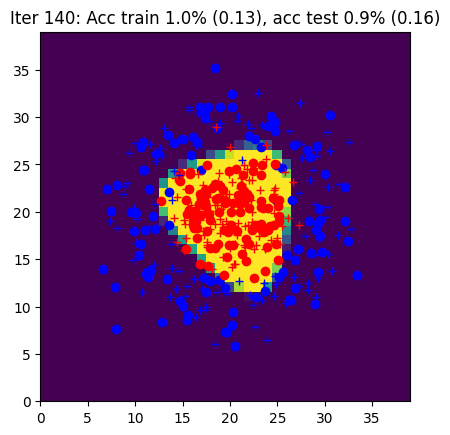

Iter 141: Acc train 0.9% (0.15), acc test 0.9% (0.22)


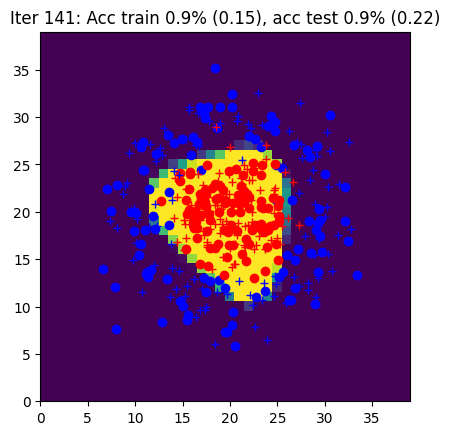

Iter 142: Acc train 0.9% (0.12), acc test 0.9% (0.19)


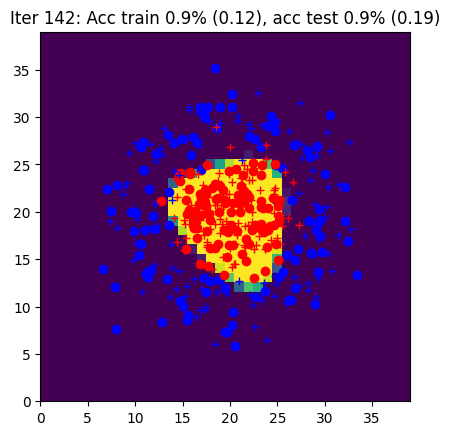

Iter 143: Acc train 1.0% (0.12), acc test 0.9% (0.16)


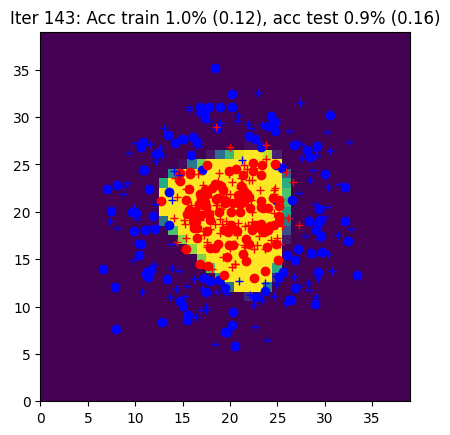

Iter 144: Acc train 0.9% (0.13), acc test 0.9% (0.22)


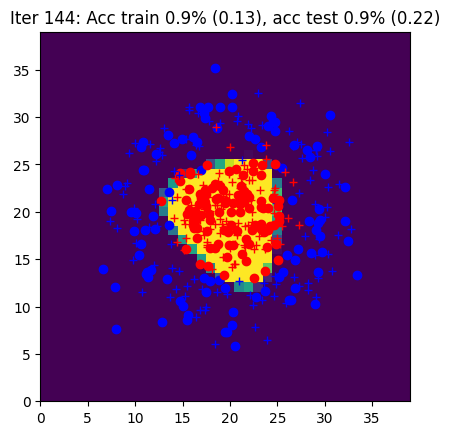

Iter 145: Acc train 1.0% (0.11), acc test 0.9% (0.18)


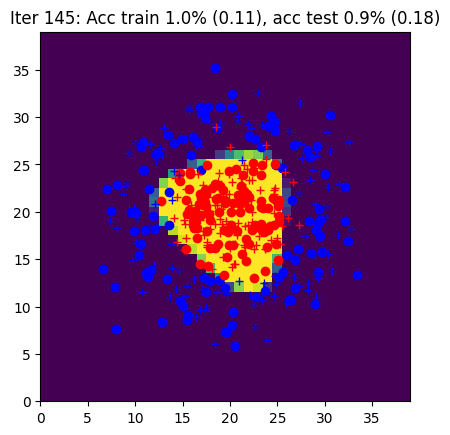

Iter 146: Acc train 0.9% (0.12), acc test 0.9% (0.20)


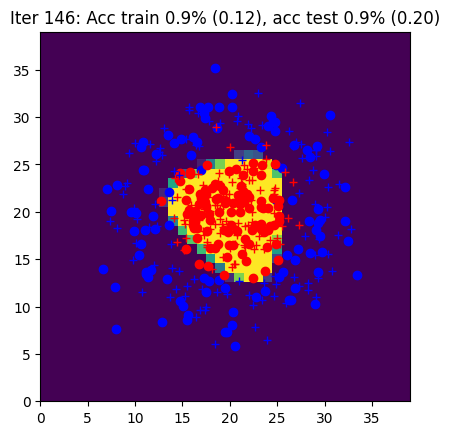

Iter 147: Acc train 1.0% (0.11), acc test 0.9% (0.17)


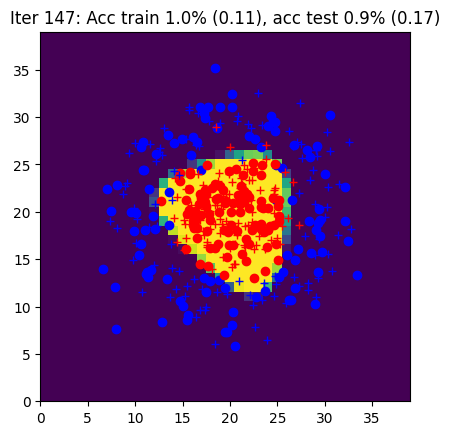

Iter 148: Acc train 1.0% (0.12), acc test 0.9% (0.19)


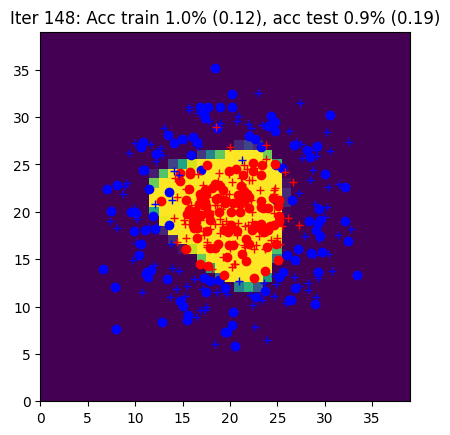

Iter 149: Acc train 0.9% (0.12), acc test 0.9% (0.18)


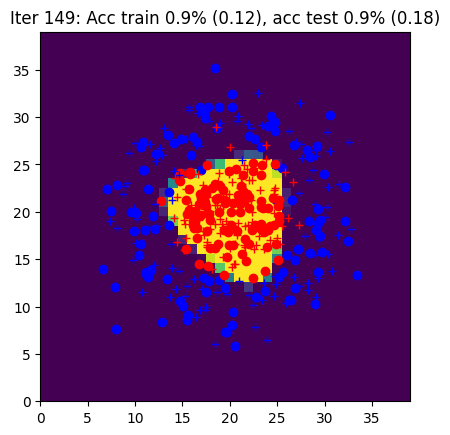

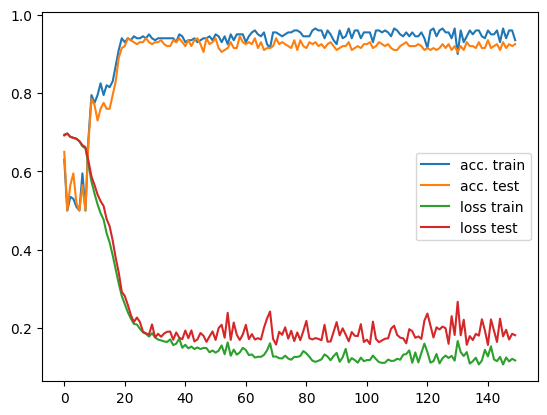

In [ ]:
# init


data = CirclesData()
data.plot_data()
N = data.Xtrain.shape[0]
Nbatch = 10
nx = data.Xtrain.shape[1]
nh = 10
ny = data.Ytrain.shape[1]
eta = 0.03

params = init_params(nx, nh, ny)

curves = [[],[], [], []]

# epoch
for iteration in range(150):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    #####################
    ## Your code here  ##
    #####################
    # batches
    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j+1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]

        # write the optimization algorithm on the batch (X,Y)
        # using the functions: forward, loss_accuracy, backward, sgd
        yhat, outputs = forward(params, X)


        Loss, Acc = loss_accuracy(yhat, Y)


        grads = backward(params, outputs, Y)


        params = sgd(params, grads, eta)


    ####################
    ##      END        #
    ####################


    Yhat_train, _ = forward(params, data.Xtrain)
    Yhat_test, _ = forward(params, data.Xtest)
    Ltrain, acctrain = loss_accuracy(Yhat_train, data.Ytrain)
    Ltest, acctest = loss_accuracy(Yhat_test, data.Ytest)
    Ygrid, _ = forward(params, data.Xgrid)

    title = 'Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})'.format(iteration, acctrain, Ltrain, acctest, Ltest)
    print(title)
    data.plot_data_with_grid(Ygrid, title)

    curves[0].append(acctrain)
    curves[1].append(acctest)
    curves[2].append(Ltrain)
    curves[3].append(Ltest)

fig = plt.figure()
plt.plot(curves[0], label="acc. train")
plt.plot(curves[1], label="acc. test")
plt.plot(curves[2], label="loss train")
plt.plot(curves[3], label="loss test")
plt.legend()
plt.show()

## Effects of differents batch size and learning rate

In [1]:
def train_model(data, nx, nh, ny, num_epochs=150, Nbatch=10, eta=0.03):
    """
    Train a model with specified batch size and learning rate.

    Parameters:
    - data: Dataset object containing Xtrain, Ytrain, Xtest, Ytest, Xgrid.
    - nx: Number of input features.
    - nh: Number of hidden units.
    - ny: Number of output features.
    - num_epochs: Number of training iterations.
    - Nbatch: Batch size for training.
    - eta: Learning rate for the SGD optimizer.

    Returns:
    - params: Trained parameters.
    - curves: Training curves for accuracy and loss.
    """
    N = data.Xtrain.shape[0]
    params = init_params(nx, nh, ny)
    curves = [[], [], [], []]

    for iteration in range(num_epochs):
        # Shuffle the data
        perm = np.random.permutation(N)
        Xtrain = data.Xtrain[perm, :]
        Ytrain = data.Ytrain[perm, :]

        # Process each batch
        for j in range(N // Nbatch):
            indsBatch = range(j * Nbatch, (j + 1) * Nbatch)
            X = Xtrain[indsBatch, :]
            Y = Ytrain[indsBatch, :]

            # Forward pass
            yhat, outputs = forward(params, X)
            Loss, Acc = loss_accuracy(yhat, Y)

            # Backward pass and update parameters
            grads = backward(params, outputs, Y)
            params = sgd(params, grads, eta)

        # Track metrics for train and test
        Yhat_train, _ = forward(params, data.Xtrain)
        Yhat_test, _ = forward(params, data.Xtest)
        Ltrain, acctrain = loss_accuracy(Yhat_train, data.Ytrain)
        Ltest, acctest = loss_accuracy(Yhat_test, data.Ytest)
        Ygrid, _ = forward(params, data.Xgrid)

        title = f'Iter {iteration}: Acc train {acctrain:.1f}% ({Ltrain:.2f}), acc test {acctest:.1f}% ({Ltest:.2f})'
        print(title)
        data.plot_data_with_grid(Ygrid, title)

        curves[0].append(acctrain)
        curves[1].append(acctest)
        curves[2].append(Ltrain)
        curves[3].append(Ltest)

    # Plot training curves
    plt.figure()
    plt.plot(curves[0], label="acc. train")
    plt.plot(curves[1], label="acc. test")
    plt.plot(curves[2], label="loss train")
    plt.plot(curves[3], label="loss test")
    plt.legend()
    plt.show()


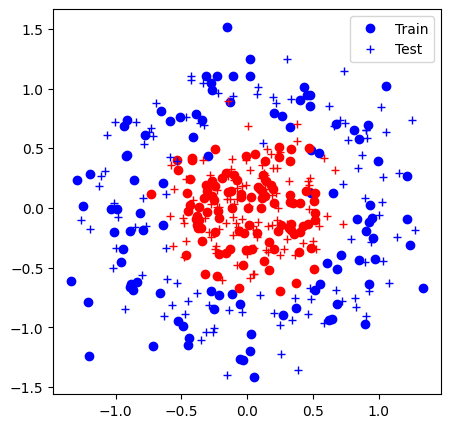

Iter 0: Acc train 0.7% (0.70), acc test 0.6% (0.70)


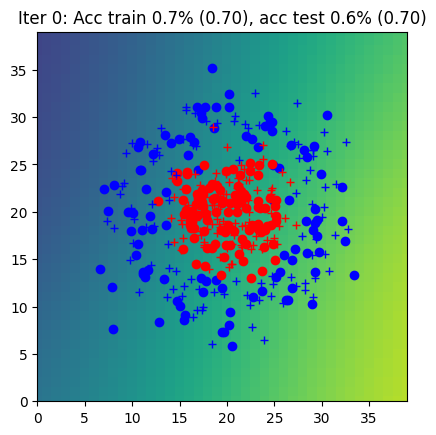

Iter 1: Acc train 0.6% (0.69), acc test 0.6% (0.70)


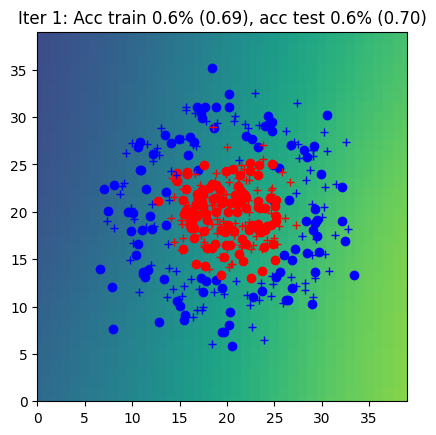

Iter 2: Acc train 0.5% (0.69), acc test 0.5% (0.70)


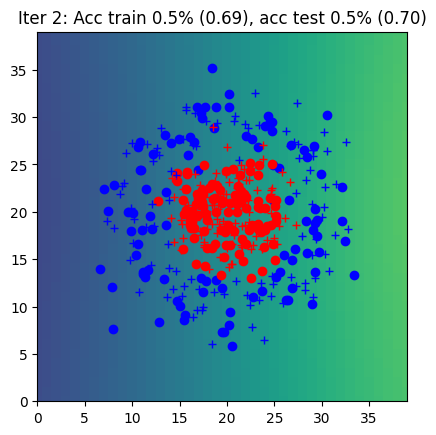

Iter 3: Acc train 0.6% (0.69), acc test 0.6% (0.70)


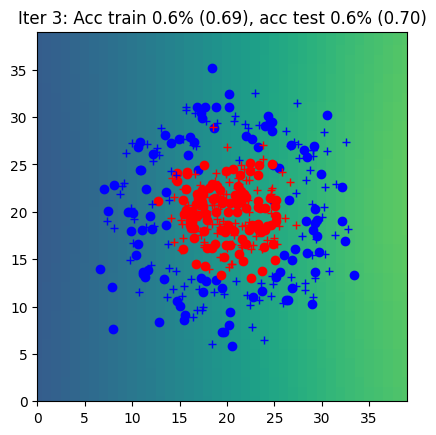

Iter 4: Acc train 0.6% (0.69), acc test 0.5% (0.69)


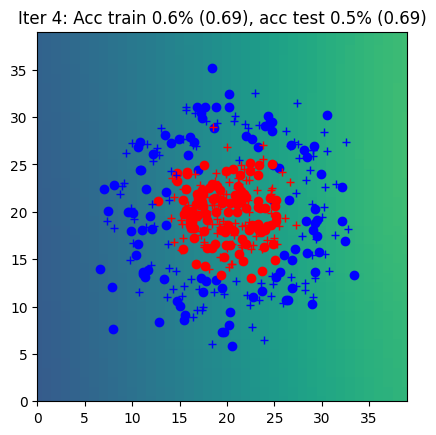

Iter 5: Acc train 0.6% (0.69), acc test 0.6% (0.69)


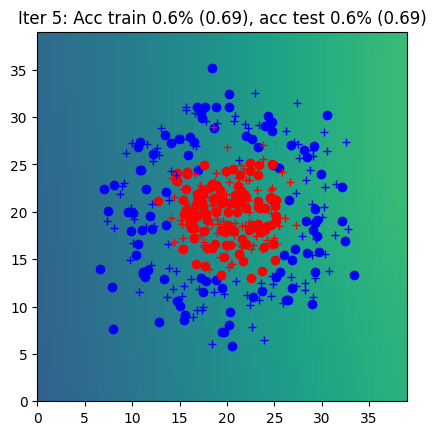

Iter 6: Acc train 0.6% (0.69), acc test 0.6% (0.69)


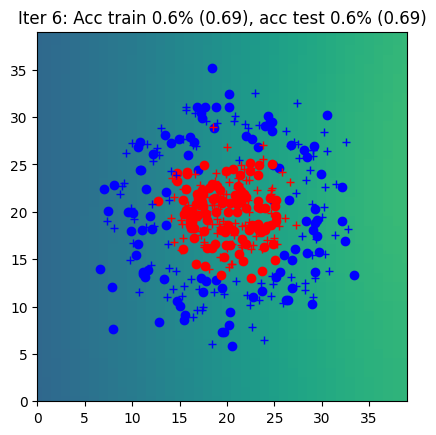

Iter 7: Acc train 0.6% (0.69), acc test 0.5% (0.69)


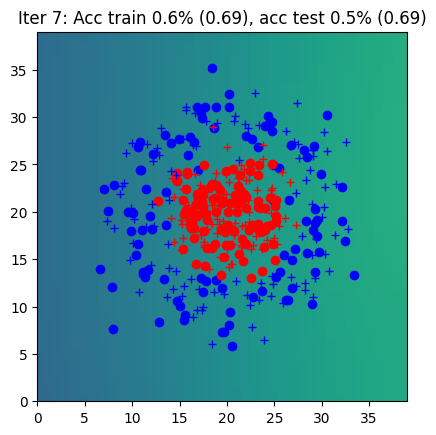

Iter 8: Acc train 0.5% (0.69), acc test 0.5% (0.69)


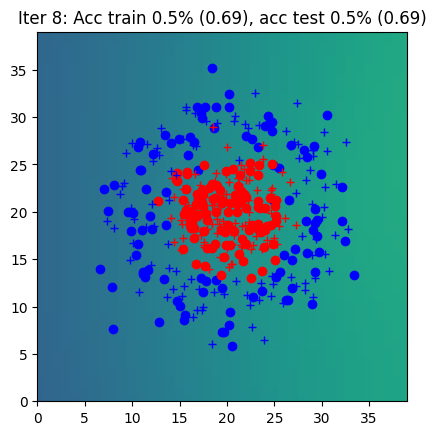

Iter 9: Acc train 0.5% (0.69), acc test 0.5% (0.69)


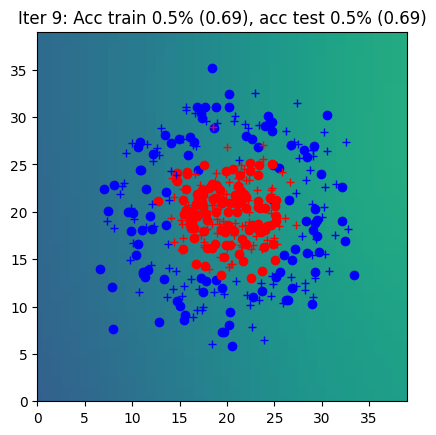

Iter 10: Acc train 0.4% (0.69), acc test 0.4% (0.69)


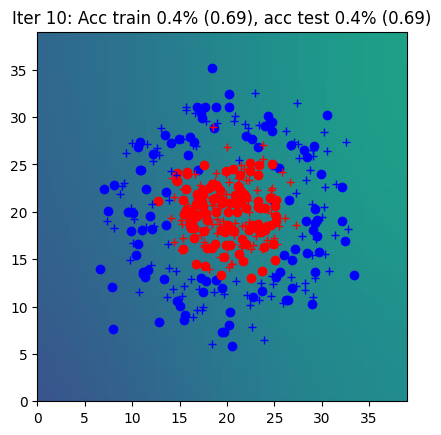

Iter 11: Acc train 0.6% (0.69), acc test 0.6% (0.69)


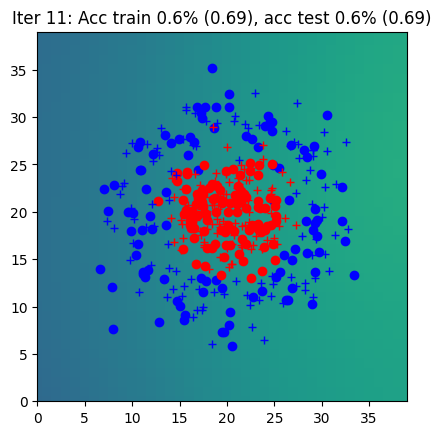

Iter 12: Acc train 0.5% (0.69), acc test 0.5% (0.70)


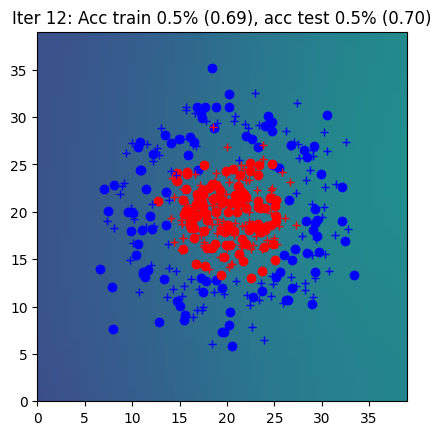

Iter 13: Acc train 0.4% (0.69), acc test 0.4% (0.69)


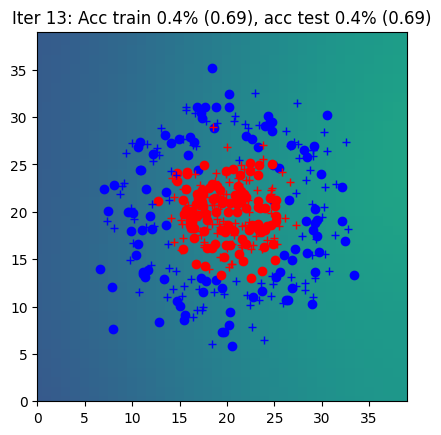

Iter 14: Acc train 0.6% (0.69), acc test 0.6% (0.69)


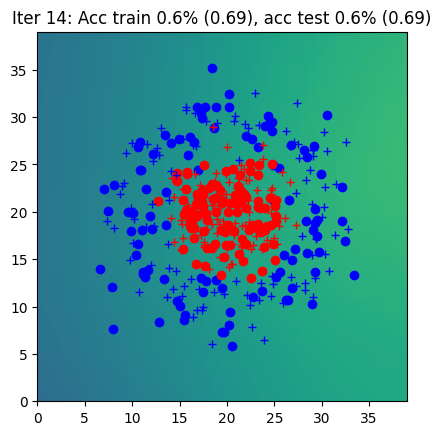

Iter 15: Acc train 0.7% (0.69), acc test 0.7% (0.69)


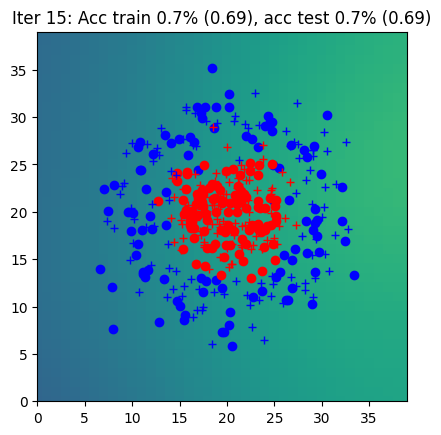

Iter 16: Acc train 0.7% (0.69), acc test 0.7% (0.69)


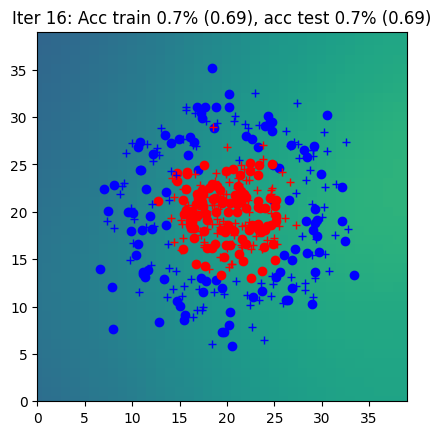

Iter 17: Acc train 0.6% (0.69), acc test 0.5% (0.69)


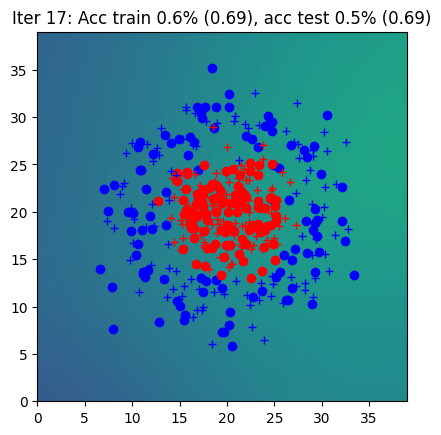

Iter 18: Acc train 0.5% (0.69), acc test 0.5% (0.69)


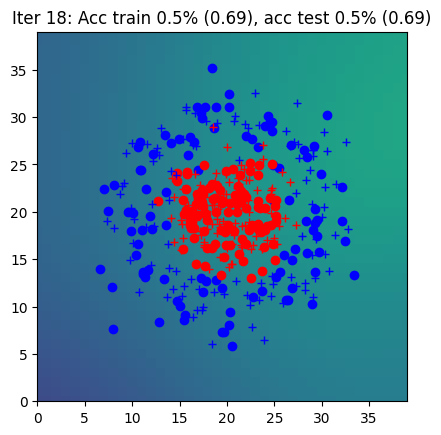

Iter 19: Acc train 0.6% (0.68), acc test 0.6% (0.68)


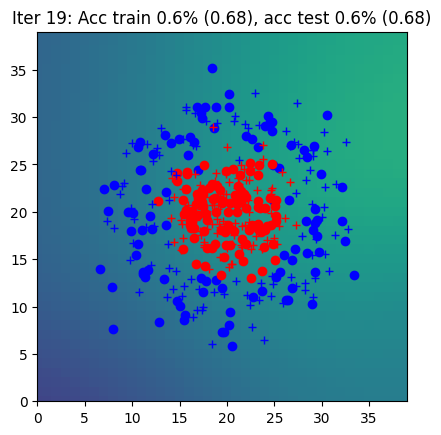

Iter 20: Acc train 0.7% (0.68), acc test 0.7% (0.68)


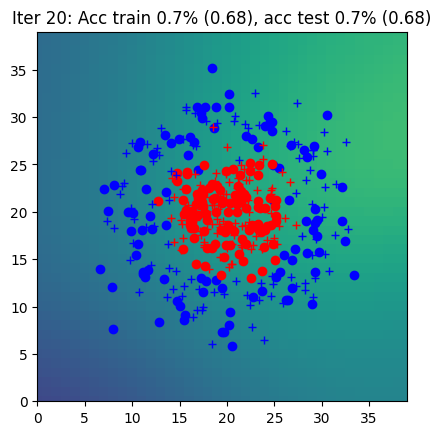

Iter 21: Acc train 0.6% (0.68), acc test 0.6% (0.68)


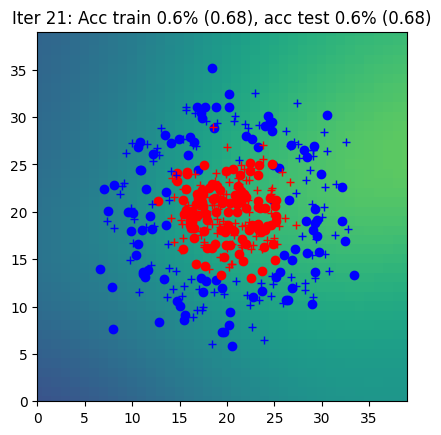

Iter 22: Acc train 0.7% (0.68), acc test 0.7% (0.68)


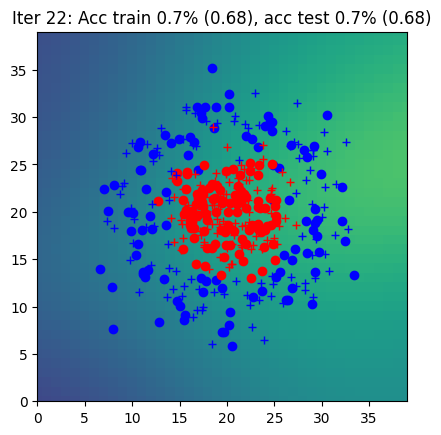

Iter 23: Acc train 0.7% (0.67), acc test 0.7% (0.68)


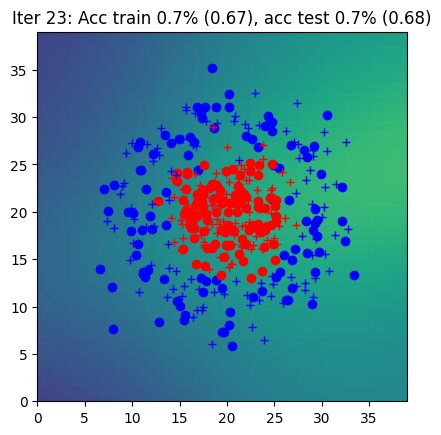

Iter 24: Acc train 0.7% (0.67), acc test 0.7% (0.67)


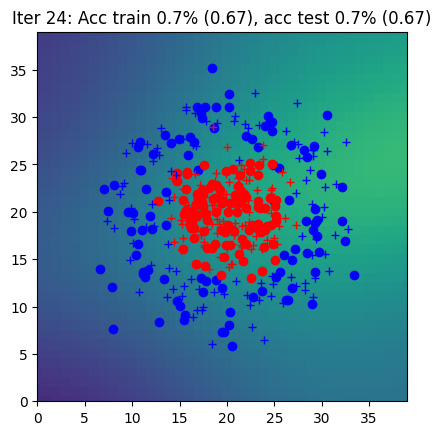

Iter 25: Acc train 0.5% (0.67), acc test 0.5% (0.67)


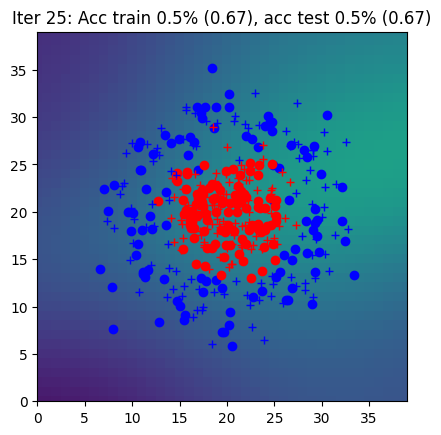

Iter 26: Acc train 0.7% (0.66), acc test 0.6% (0.67)


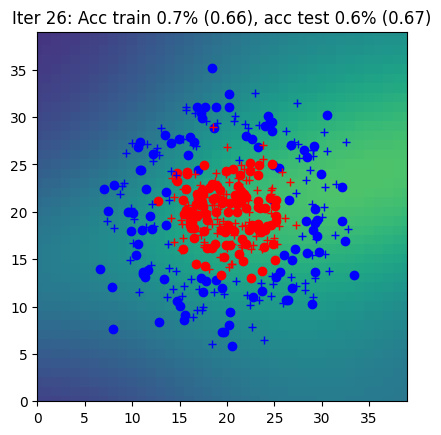

Iter 27: Acc train 0.8% (0.66), acc test 0.8% (0.66)


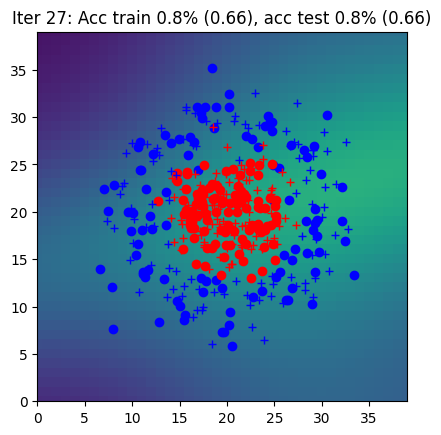

Iter 28: Acc train 0.7% (0.65), acc test 0.7% (0.66)


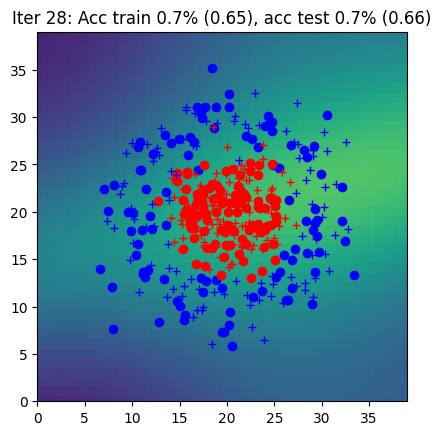

Iter 29: Acc train 0.8% (0.65), acc test 0.8% (0.65)


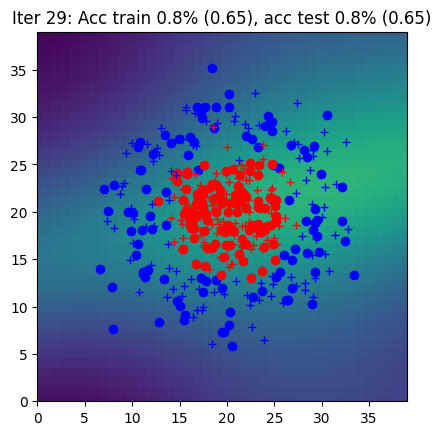

Iter 30: Acc train 0.8% (0.64), acc test 0.8% (0.64)


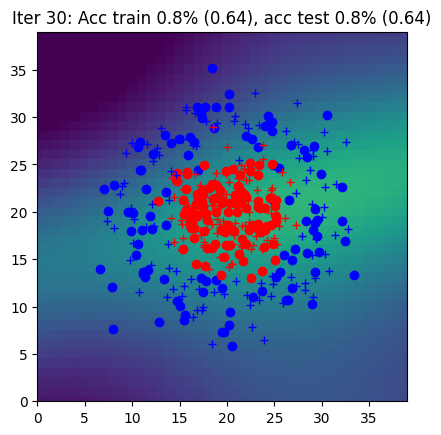

Iter 31: Acc train 0.8% (0.63), acc test 0.8% (0.63)


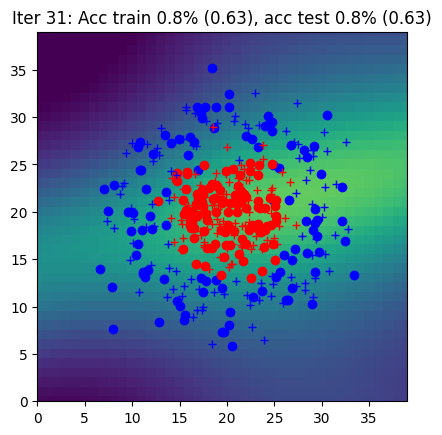

Iter 32: Acc train 0.8% (0.62), acc test 0.8% (0.62)


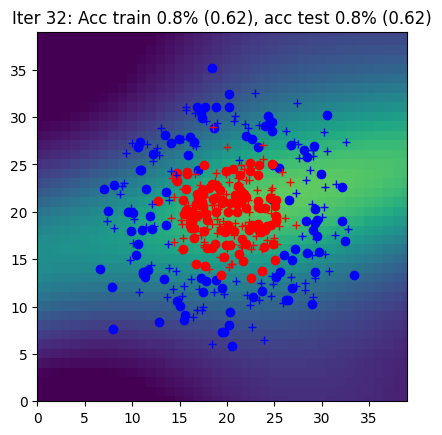

Iter 33: Acc train 0.8% (0.61), acc test 0.8% (0.61)


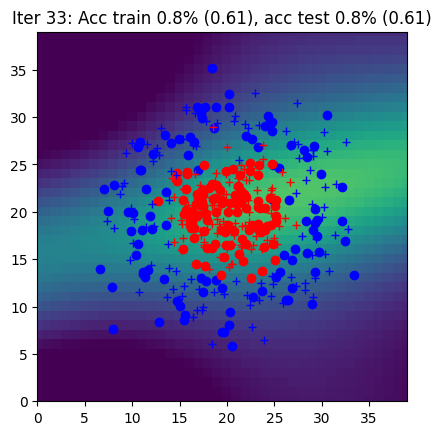

Iter 34: Acc train 0.7% (0.60), acc test 0.8% (0.60)


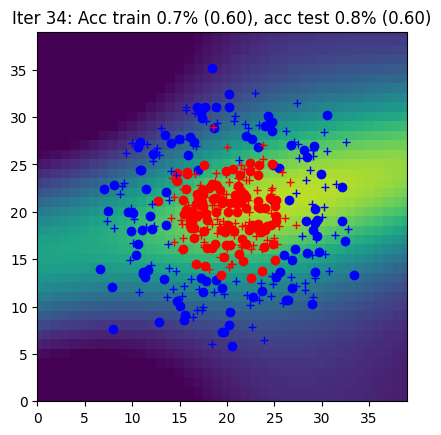

Iter 35: Acc train 0.8% (0.59), acc test 0.8% (0.59)


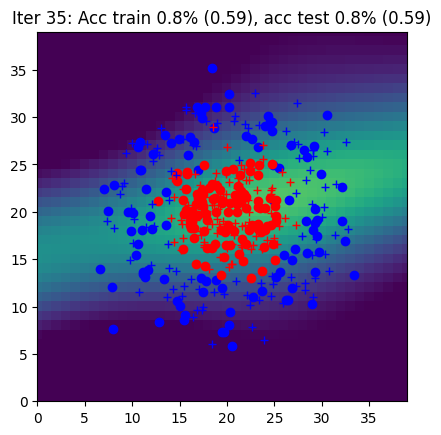

Iter 36: Acc train 0.7% (0.58), acc test 0.8% (0.58)


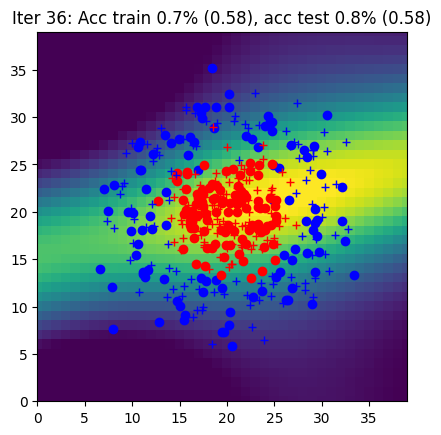

Iter 37: Acc train 0.8% (0.56), acc test 0.8% (0.56)


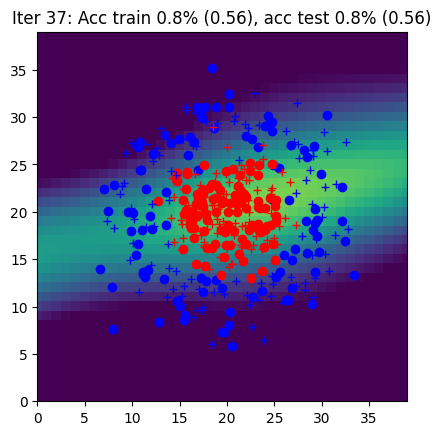

Iter 38: Acc train 0.8% (0.55), acc test 0.8% (0.55)


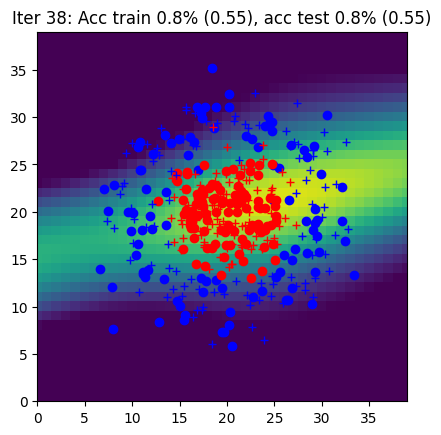

Iter 39: Acc train 0.8% (0.54), acc test 0.8% (0.54)


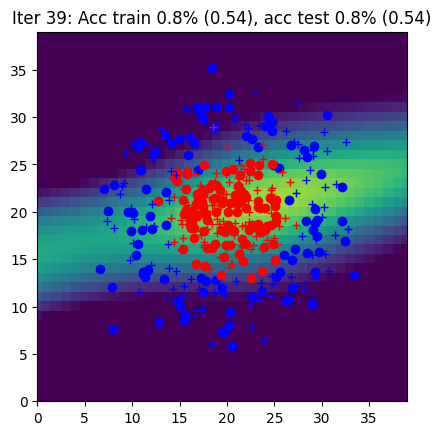

Iter 40: Acc train 0.8% (0.52), acc test 0.8% (0.52)


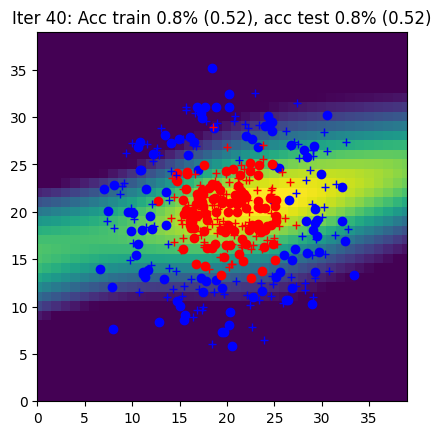

Iter 41: Acc train 0.8% (0.51), acc test 0.8% (0.51)


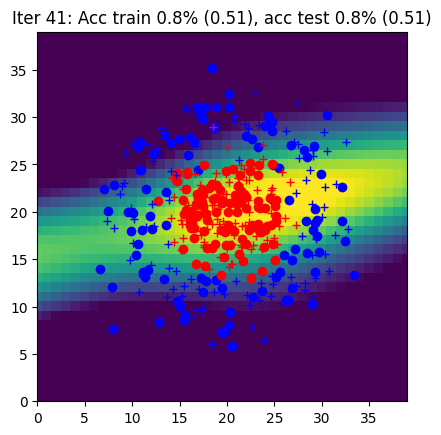

Iter 42: Acc train 0.8% (0.50), acc test 0.8% (0.50)


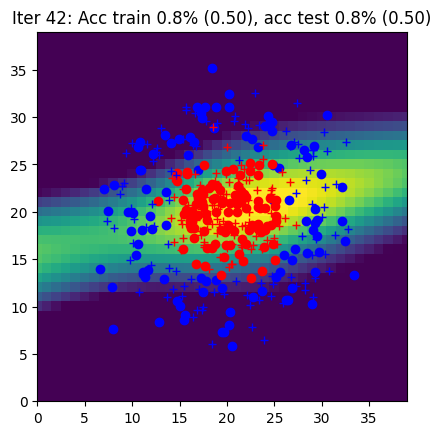

Iter 43: Acc train 0.8% (0.49), acc test 0.8% (0.49)


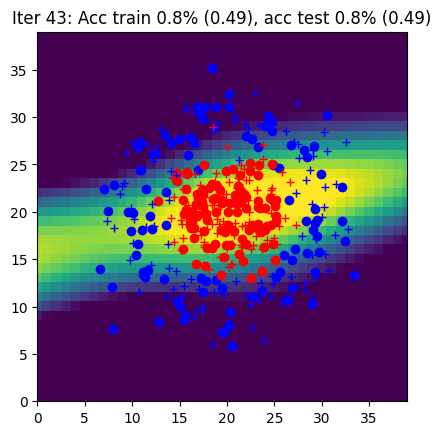

Iter 44: Acc train 0.8% (0.47), acc test 0.9% (0.47)


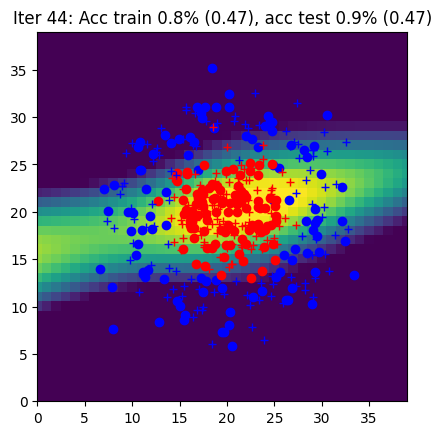

Iter 45: Acc train 0.8% (0.46), acc test 0.8% (0.46)


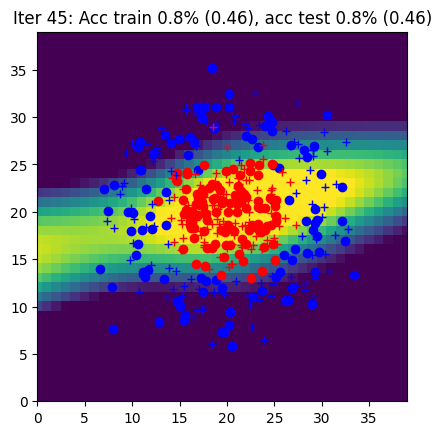

Iter 46: Acc train 0.8% (0.46), acc test 0.8% (0.46)


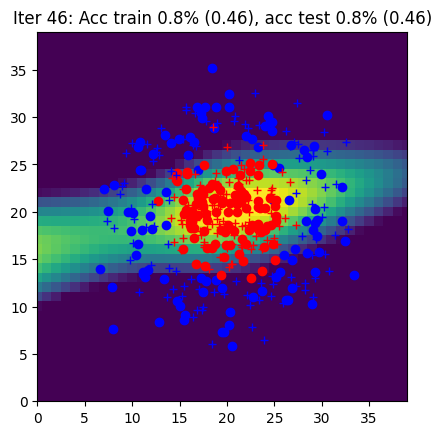

Iter 47: Acc train 0.8% (0.44), acc test 0.9% (0.44)


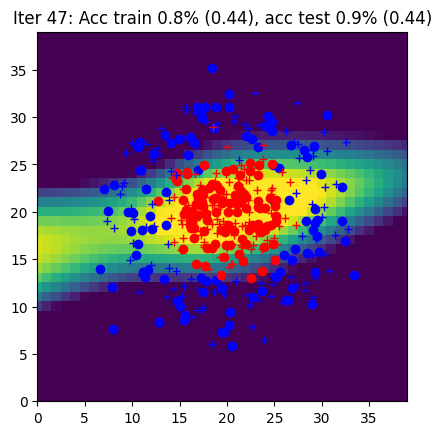

Iter 48: Acc train 0.8% (0.43), acc test 0.9% (0.43)


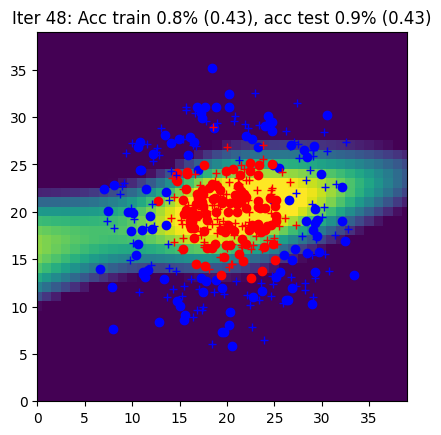

Iter 49: Acc train 0.8% (0.42), acc test 0.9% (0.42)


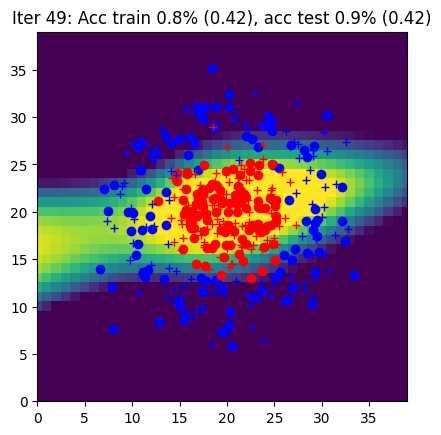

Iter 50: Acc train 0.8% (0.41), acc test 0.9% (0.41)


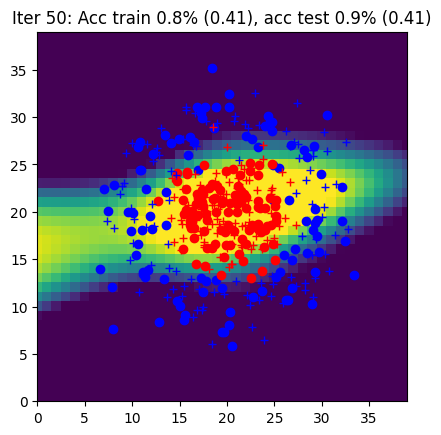

Iter 51: Acc train 0.9% (0.40), acc test 0.9% (0.40)


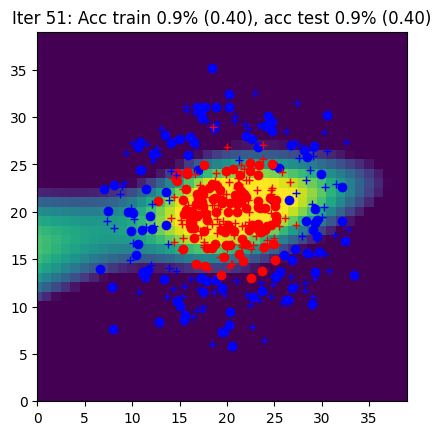

Iter 52: Acc train 0.9% (0.39), acc test 0.9% (0.39)


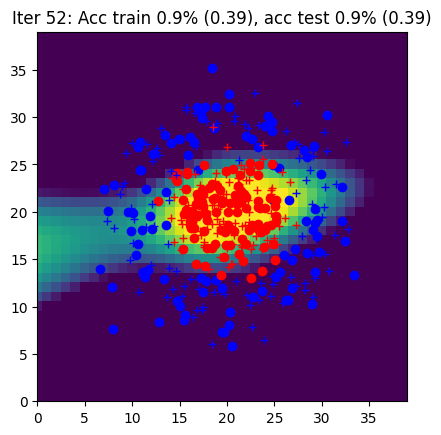

Iter 53: Acc train 0.9% (0.37), acc test 0.9% (0.37)


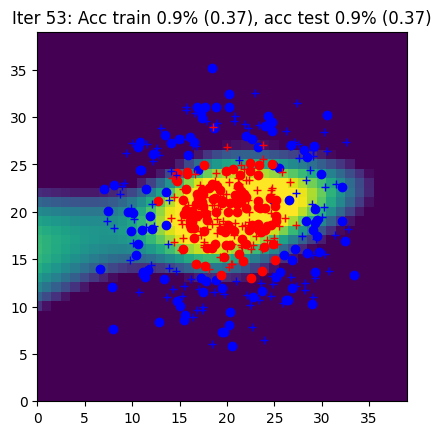

Iter 54: Acc train 0.9% (0.36), acc test 0.9% (0.36)


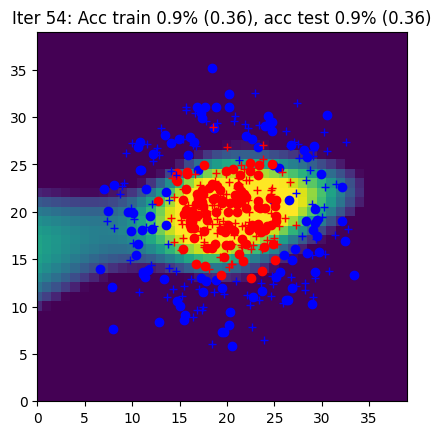

Iter 55: Acc train 0.9% (0.35), acc test 0.9% (0.34)


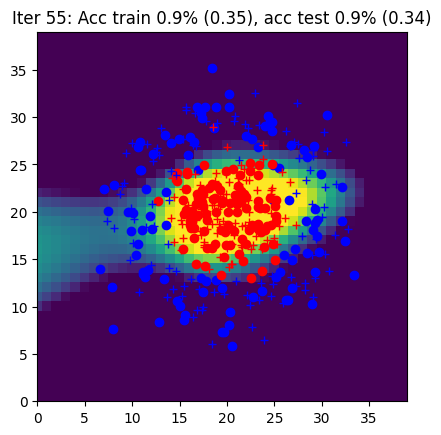

Iter 56: Acc train 0.9% (0.34), acc test 0.9% (0.33)


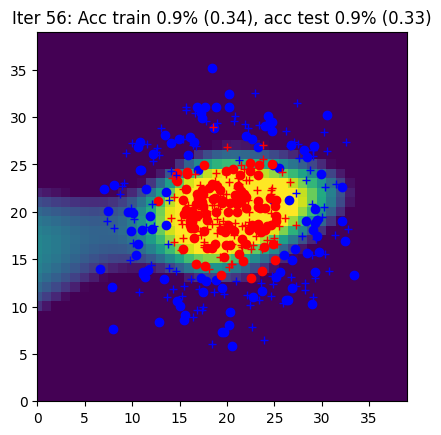

Iter 57: Acc train 0.9% (0.32), acc test 0.9% (0.32)


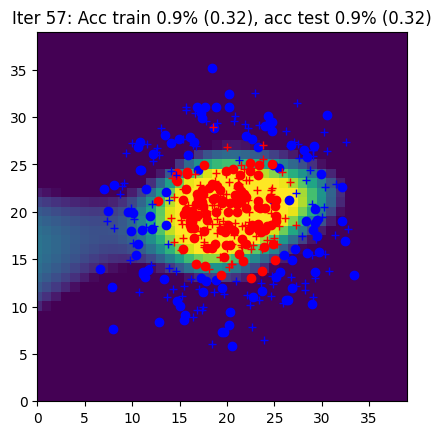

Iter 58: Acc train 0.9% (0.34), acc test 0.9% (0.33)


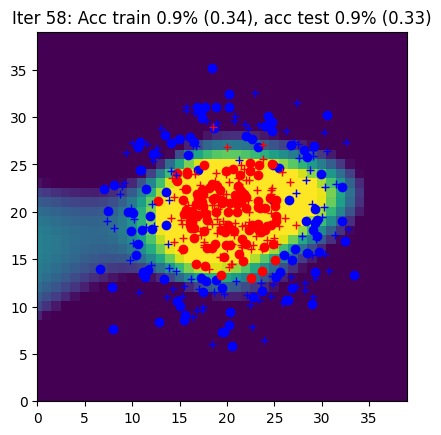

Iter 59: Acc train 0.9% (0.31), acc test 0.9% (0.30)


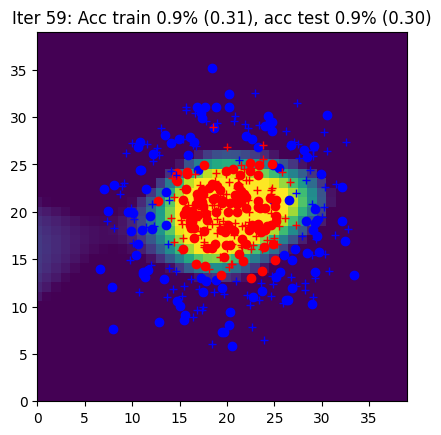

Iter 60: Acc train 0.9% (0.30), acc test 0.9% (0.29)


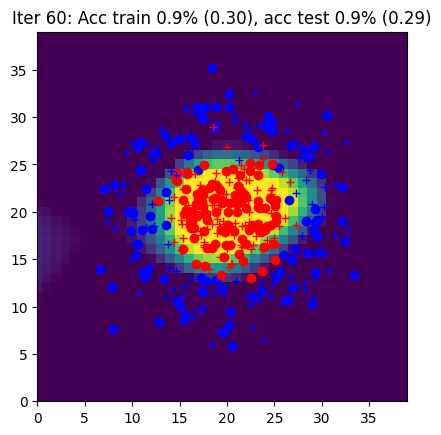

Iter 61: Acc train 0.9% (0.28), acc test 0.9% (0.28)


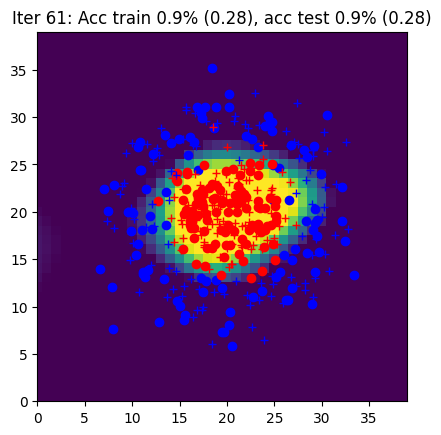

Iter 62: Acc train 0.9% (0.28), acc test 0.9% (0.27)


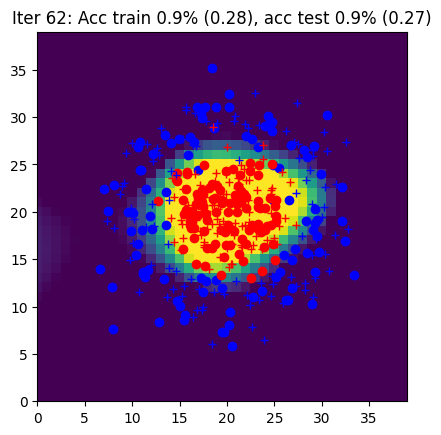

Iter 63: Acc train 0.9% (0.27), acc test 1.0% (0.26)


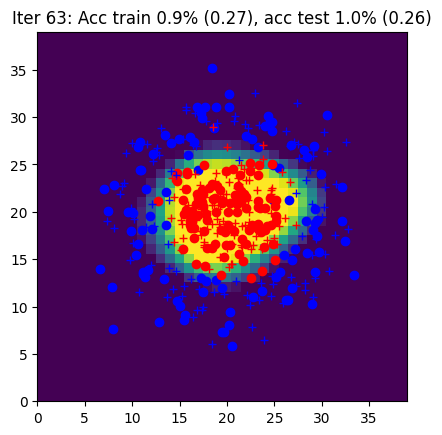

Iter 64: Acc train 0.9% (0.26), acc test 1.0% (0.26)


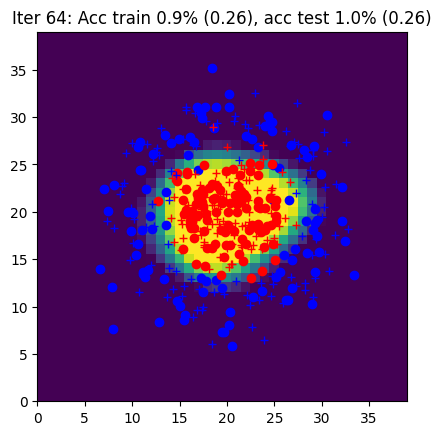

Iter 65: Acc train 0.9% (0.25), acc test 1.0% (0.25)


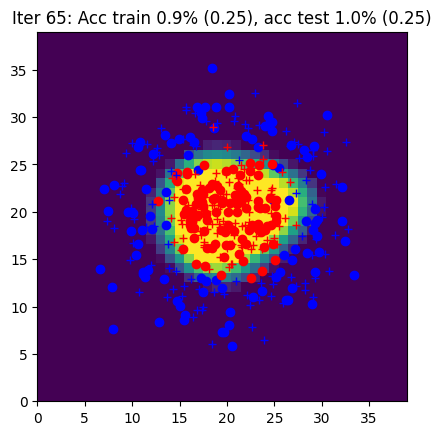

Iter 66: Acc train 0.9% (0.25), acc test 1.0% (0.24)


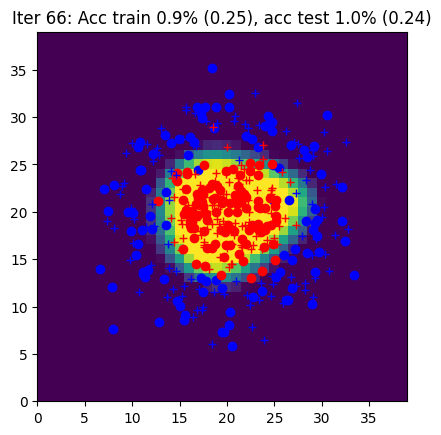

Iter 67: Acc train 0.9% (0.24), acc test 1.0% (0.24)


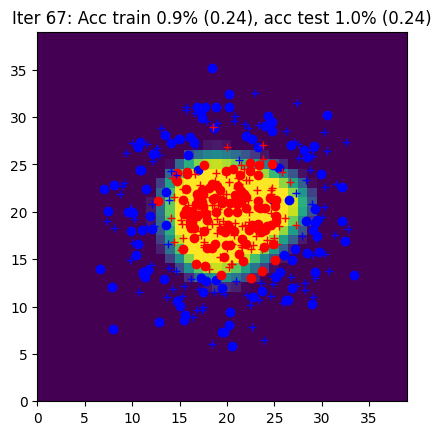

Iter 68: Acc train 0.9% (0.24), acc test 0.9% (0.24)


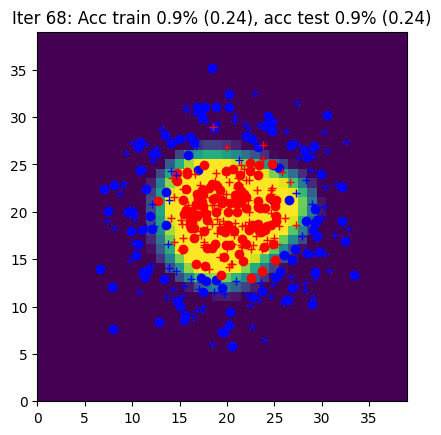

Iter 69: Acc train 0.9% (0.23), acc test 1.0% (0.23)


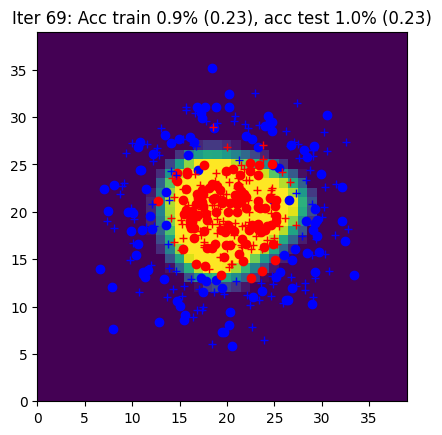

Iter 70: Acc train 1.0% (0.23), acc test 0.9% (0.23)


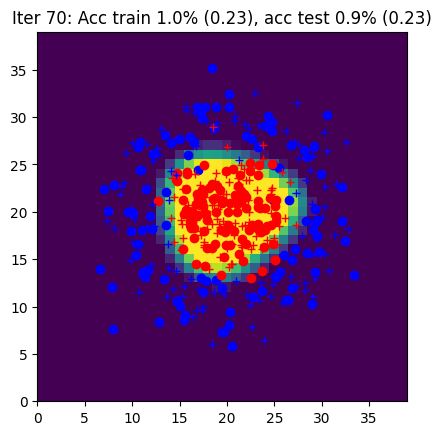

Iter 71: Acc train 0.9% (0.22), acc test 0.9% (0.23)


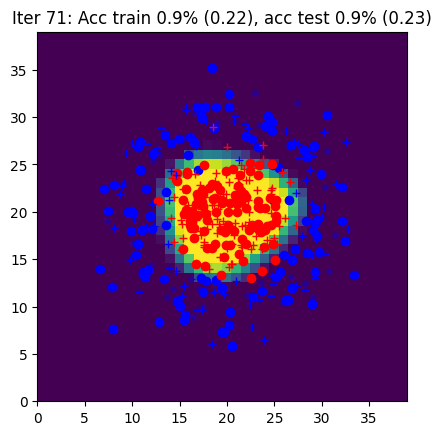

Iter 72: Acc train 0.9% (0.23), acc test 0.9% (0.23)


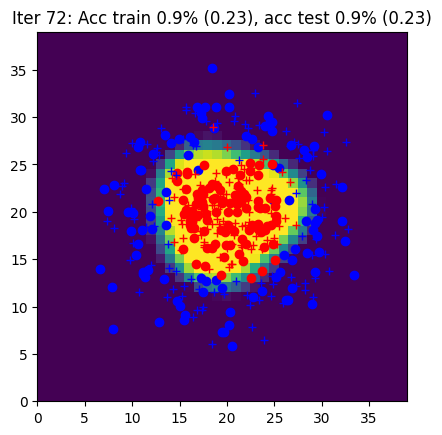

Iter 73: Acc train 0.9% (0.22), acc test 1.0% (0.21)


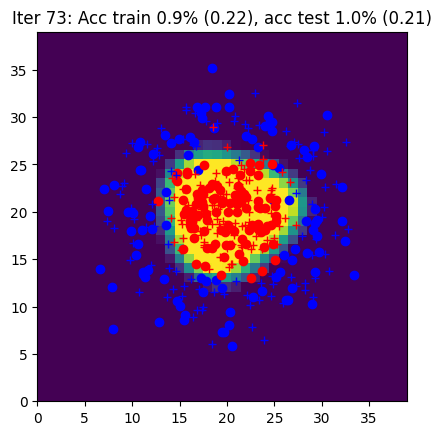

Iter 74: Acc train 0.9% (0.21), acc test 0.9% (0.21)


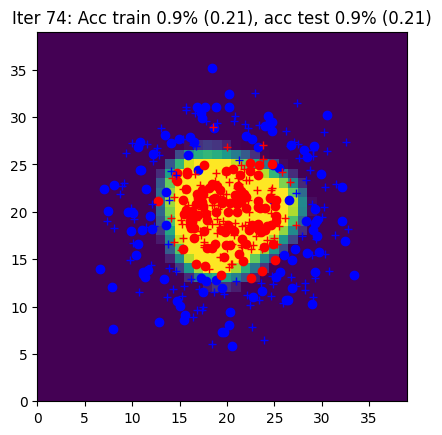

Iter 75: Acc train 0.9% (0.21), acc test 1.0% (0.21)


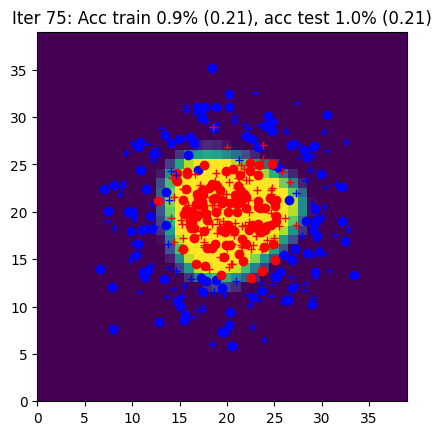

Iter 76: Acc train 0.9% (0.21), acc test 0.9% (0.21)


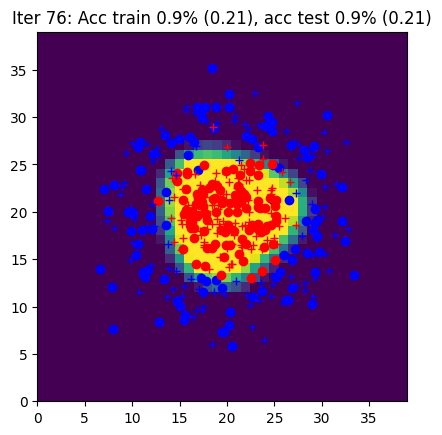

Iter 77: Acc train 0.9% (0.21), acc test 0.9% (0.21)


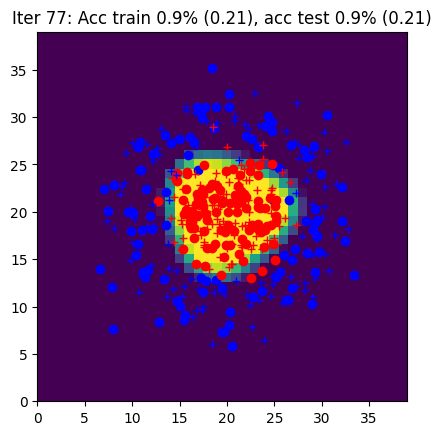

Iter 78: Acc train 0.9% (0.20), acc test 0.9% (0.20)


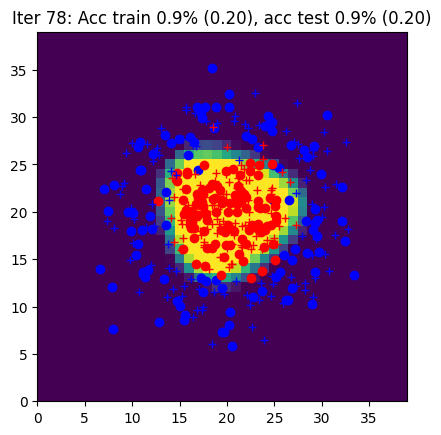

Iter 79: Acc train 1.0% (0.20), acc test 0.9% (0.20)


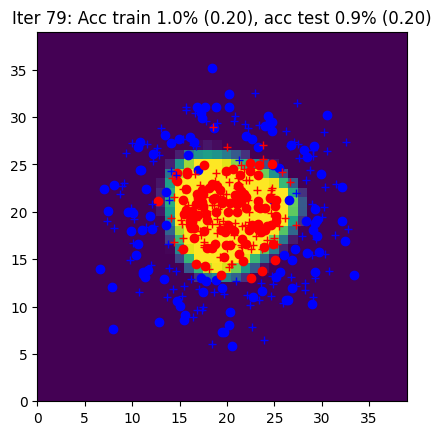

Iter 80: Acc train 0.9% (0.20), acc test 0.9% (0.20)


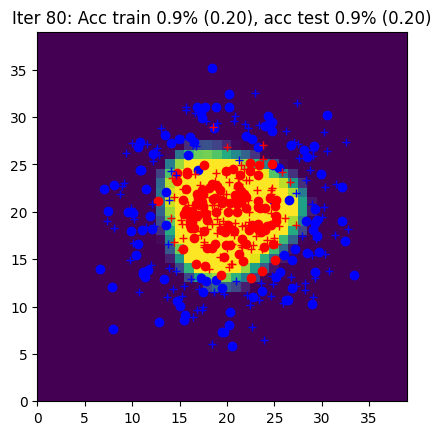

Iter 81: Acc train 0.9% (0.20), acc test 0.9% (0.19)


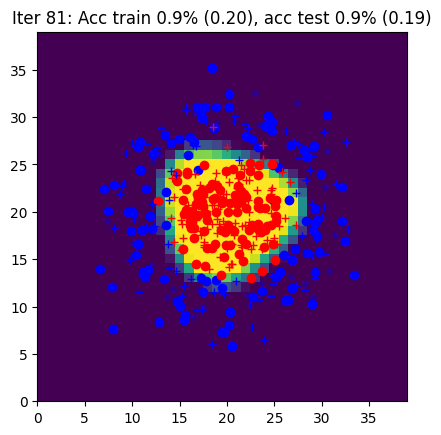

Iter 82: Acc train 0.9% (0.19), acc test 0.9% (0.20)


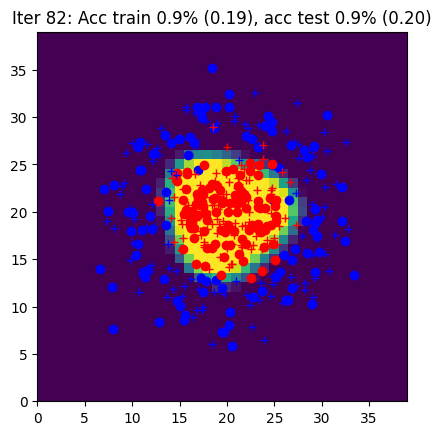

Iter 83: Acc train 0.9% (0.19), acc test 0.9% (0.19)


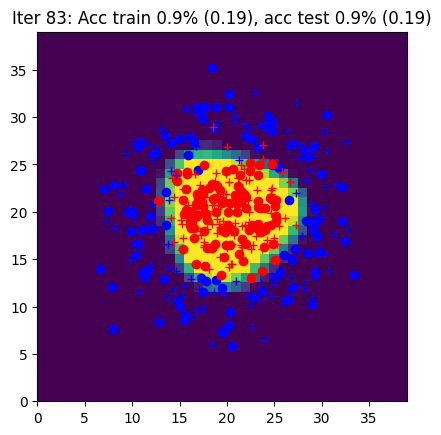

Iter 84: Acc train 0.9% (0.20), acc test 0.9% (0.20)


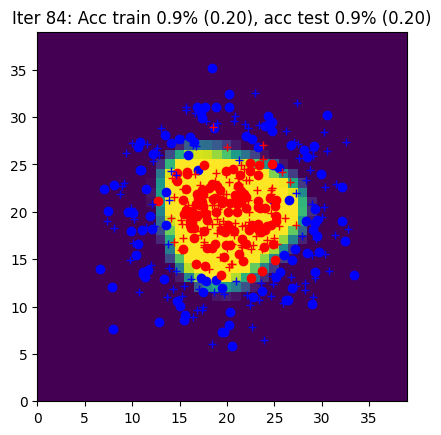

Iter 85: Acc train 0.9% (0.19), acc test 0.9% (0.19)


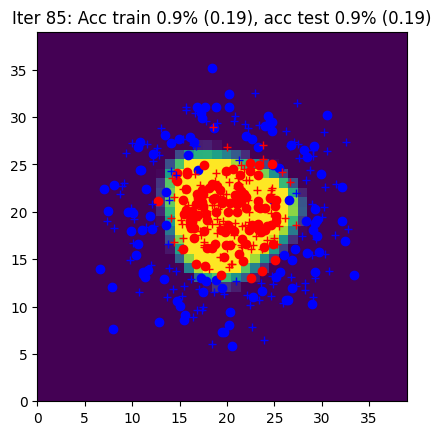

Iter 86: Acc train 0.9% (0.19), acc test 0.9% (0.19)


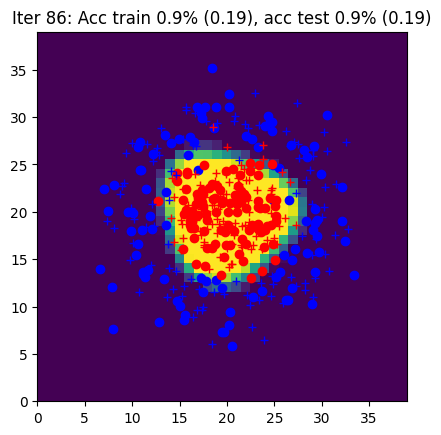

Iter 87: Acc train 0.9% (0.18), acc test 0.9% (0.18)


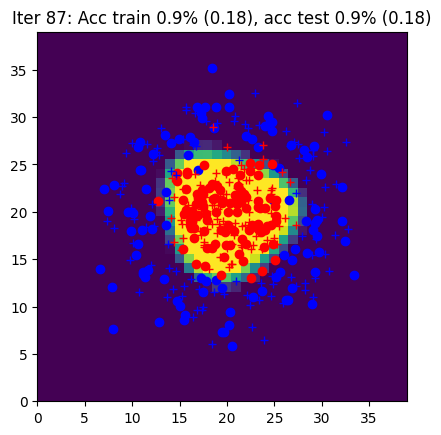

Iter 88: Acc train 0.9% (0.19), acc test 0.9% (0.18)


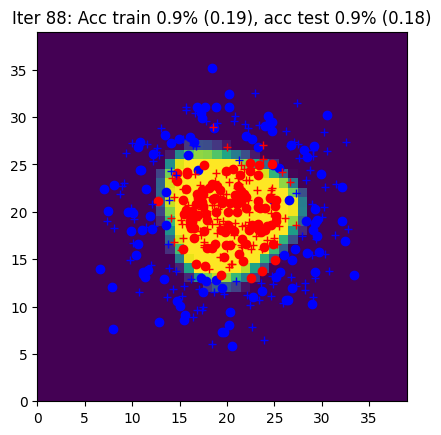

Iter 89: Acc train 0.9% (0.19), acc test 0.9% (0.20)


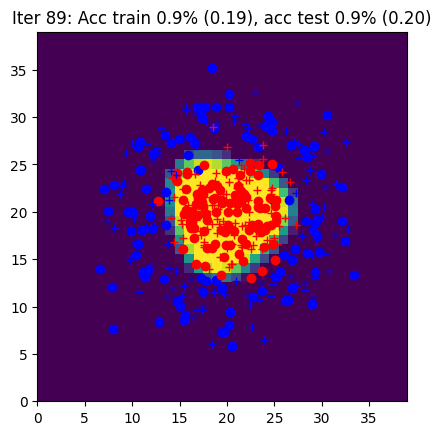

Iter 90: Acc train 0.9% (0.18), acc test 0.9% (0.18)


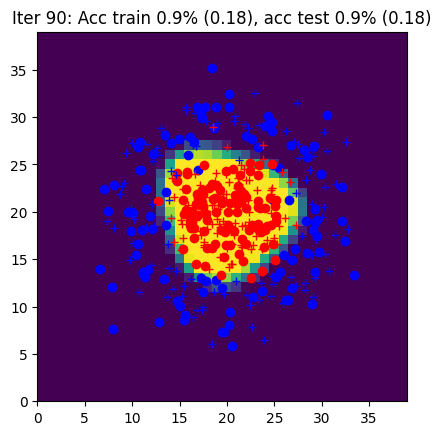

Iter 91: Acc train 0.9% (0.18), acc test 0.9% (0.19)


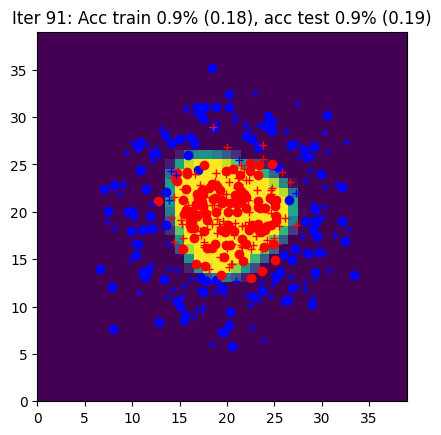

Iter 92: Acc train 0.9% (0.18), acc test 0.9% (0.18)


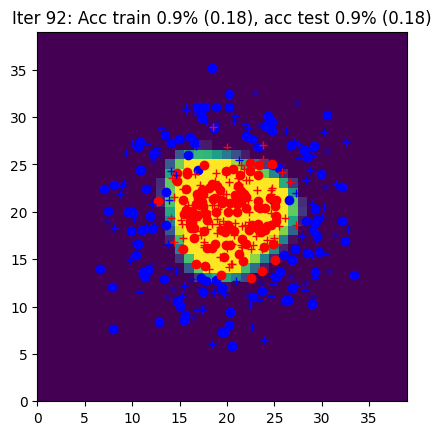

Iter 93: Acc train 0.9% (0.18), acc test 0.9% (0.18)


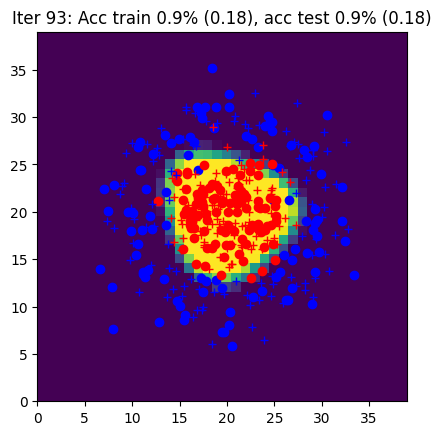

Iter 94: Acc train 0.9% (0.18), acc test 0.9% (0.18)


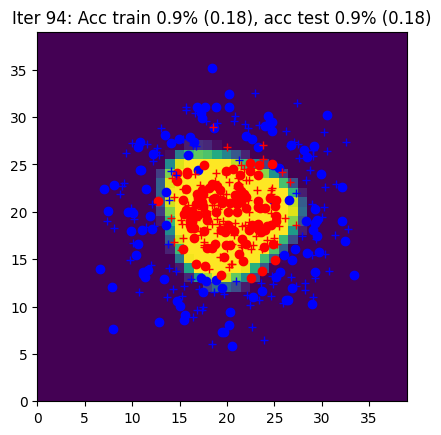

Iter 95: Acc train 0.9% (0.18), acc test 0.9% (0.18)


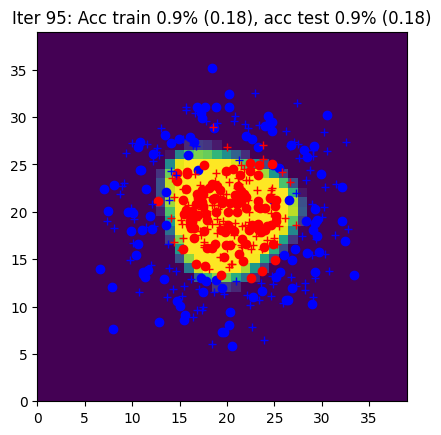

Iter 96: Acc train 0.9% (0.17), acc test 0.9% (0.18)


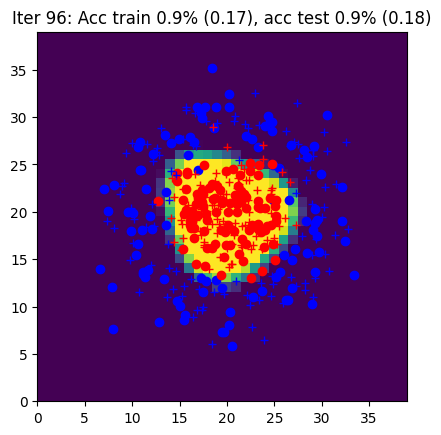

Iter 97: Acc train 0.9% (0.18), acc test 0.9% (0.18)


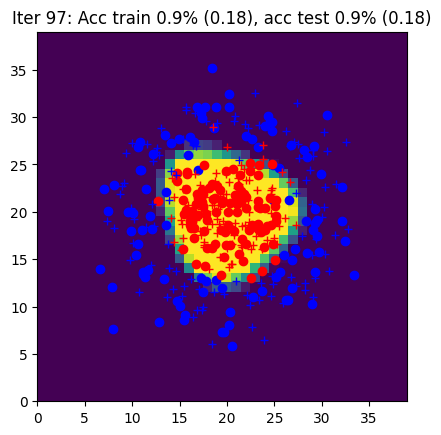

Iter 98: Acc train 0.9% (0.17), acc test 0.9% (0.18)


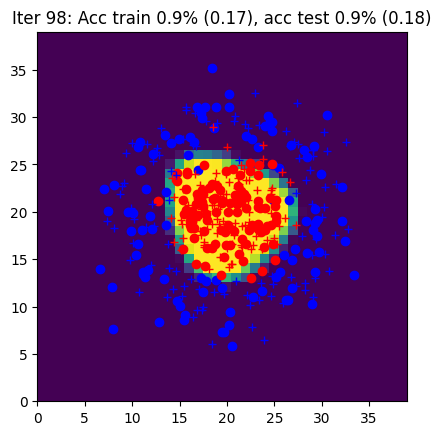

Iter 99: Acc train 0.9% (0.17), acc test 0.9% (0.17)


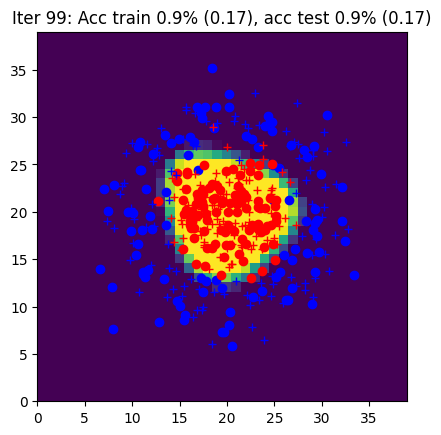

Iter 100: Acc train 0.9% (0.17), acc test 0.9% (0.18)


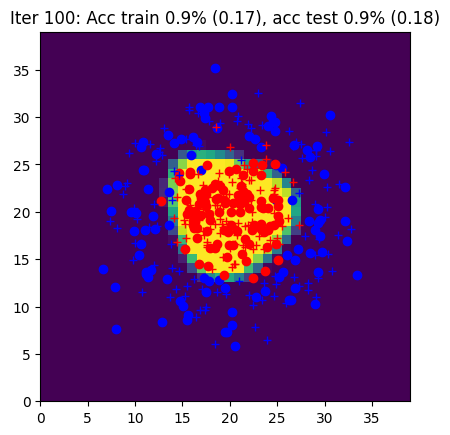

Iter 101: Acc train 0.9% (0.17), acc test 0.9% (0.18)


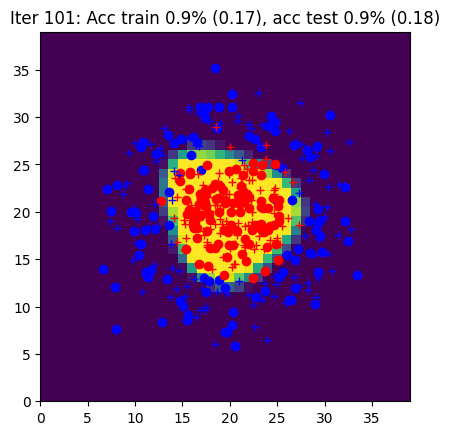

Iter 102: Acc train 0.9% (0.17), acc test 0.9% (0.18)


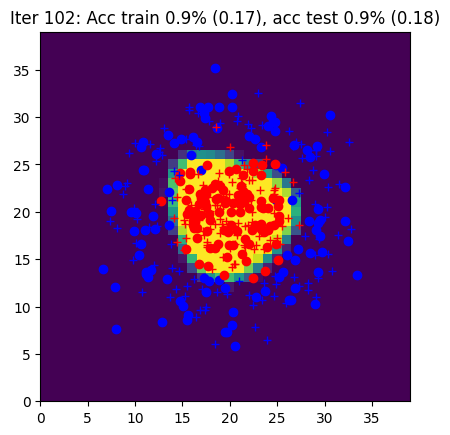

Iter 103: Acc train 0.9% (0.17), acc test 0.9% (0.17)


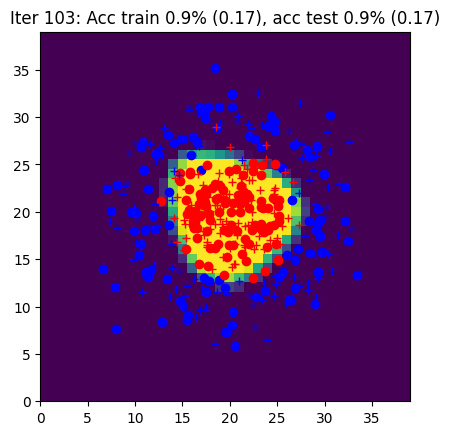

Iter 104: Acc train 0.9% (0.17), acc test 0.9% (0.17)


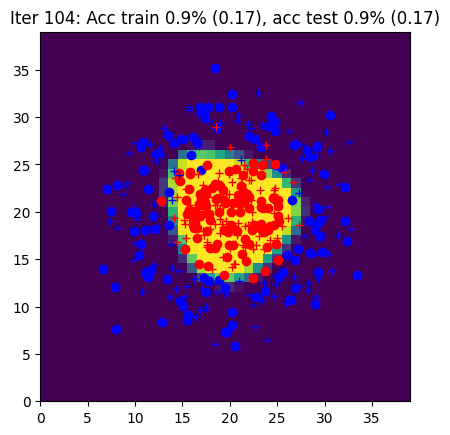

Iter 105: Acc train 0.9% (0.17), acc test 0.9% (0.17)


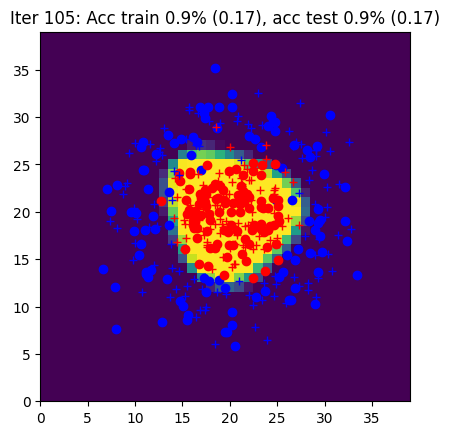

Iter 106: Acc train 0.9% (0.17), acc test 0.9% (0.18)


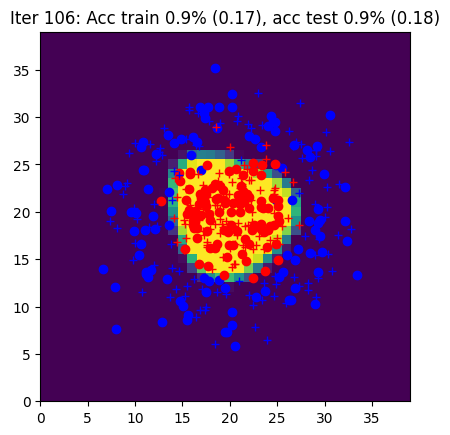

Iter 107: Acc train 0.9% (0.17), acc test 0.9% (0.18)


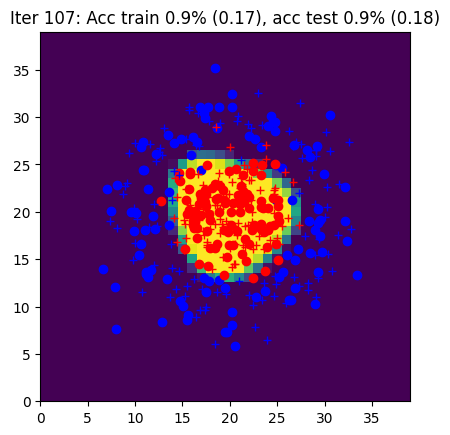

Iter 108: Acc train 0.9% (0.18), acc test 0.9% (0.17)


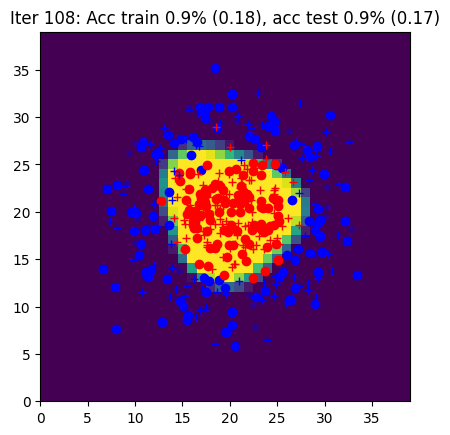

Iter 109: Acc train 0.9% (0.17), acc test 0.9% (0.18)


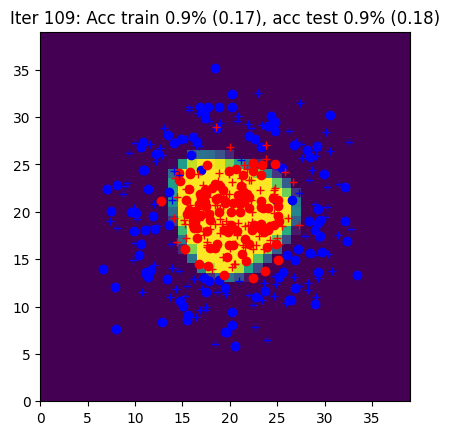

Iter 110: Acc train 0.9% (0.16), acc test 0.9% (0.17)


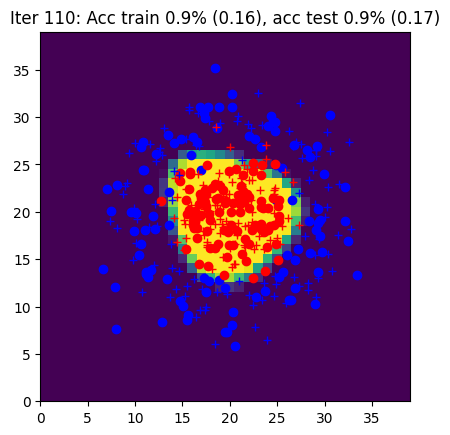

Iter 111: Acc train 0.9% (0.17), acc test 0.9% (0.17)


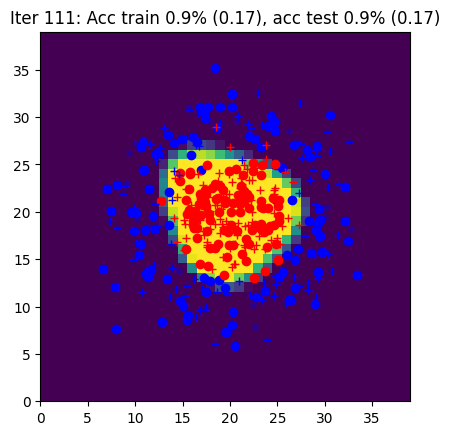

Iter 112: Acc train 0.9% (0.16), acc test 0.9% (0.18)


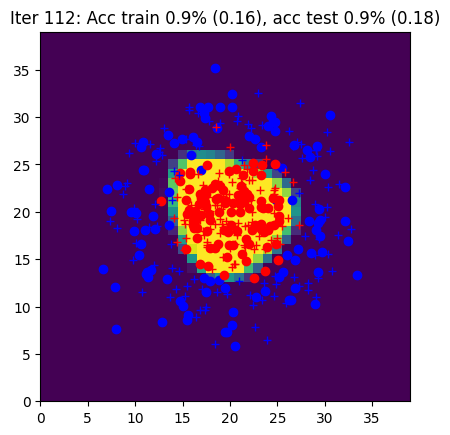

Iter 113: Acc train 0.9% (0.16), acc test 0.9% (0.17)


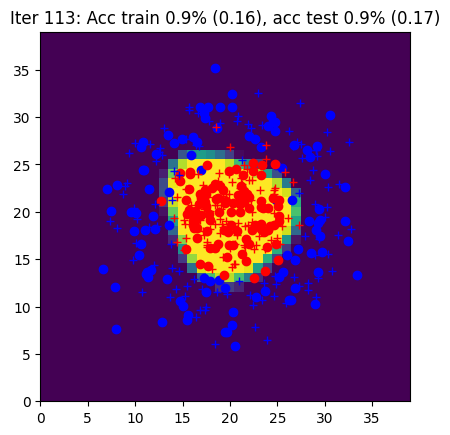

Iter 114: Acc train 0.9% (0.16), acc test 0.9% (0.17)


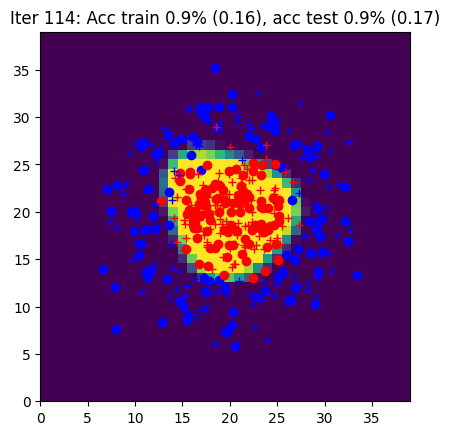

Iter 115: Acc train 0.9% (0.16), acc test 0.9% (0.18)


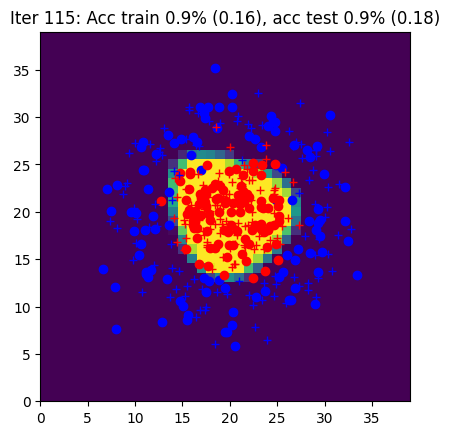

Iter 116: Acc train 0.9% (0.16), acc test 0.9% (0.17)


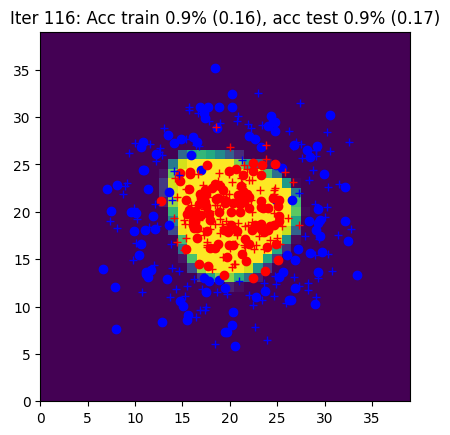

Iter 117: Acc train 0.9% (0.16), acc test 0.9% (0.16)


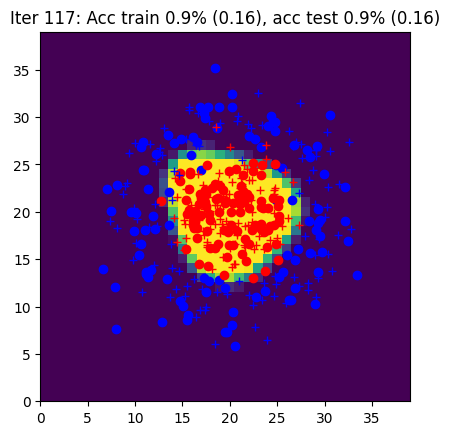

Iter 118: Acc train 0.9% (0.16), acc test 0.9% (0.17)


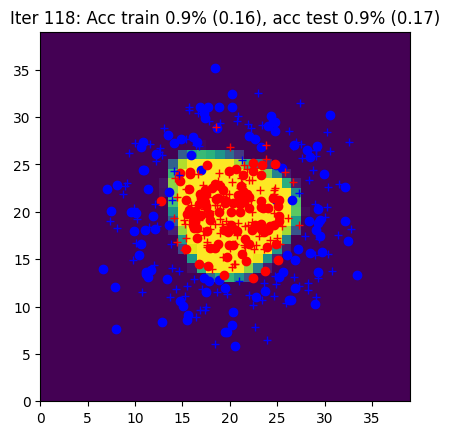

Iter 119: Acc train 0.9% (0.16), acc test 0.9% (0.17)


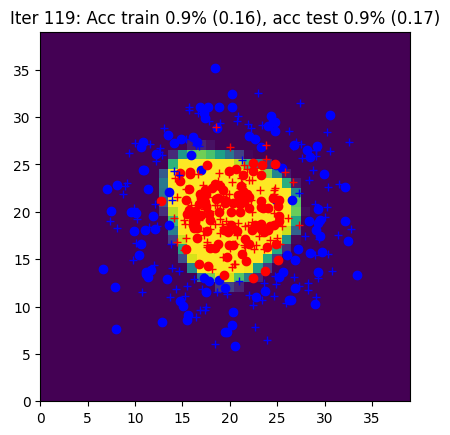

Iter 120: Acc train 0.9% (0.16), acc test 0.9% (0.16)


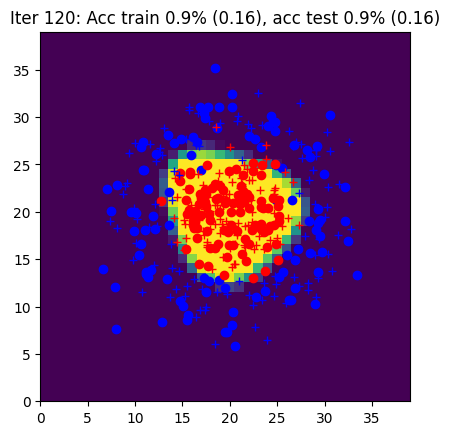

Iter 121: Acc train 0.9% (0.16), acc test 0.9% (0.17)


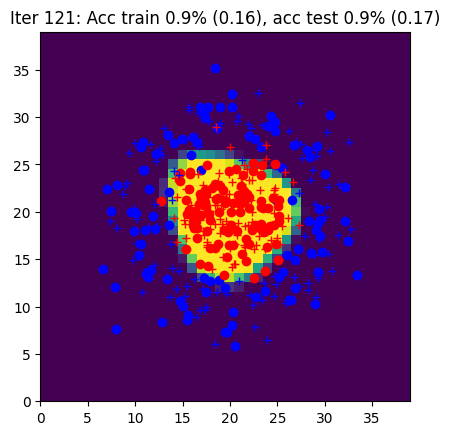

Iter 122: Acc train 0.9% (0.16), acc test 0.9% (0.18)


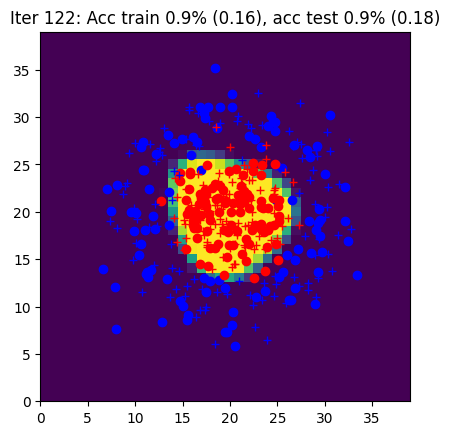

Iter 123: Acc train 0.9% (0.16), acc test 0.9% (0.16)


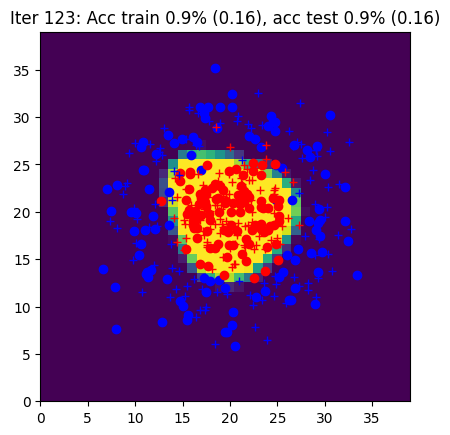

Iter 124: Acc train 0.9% (0.16), acc test 0.9% (0.16)


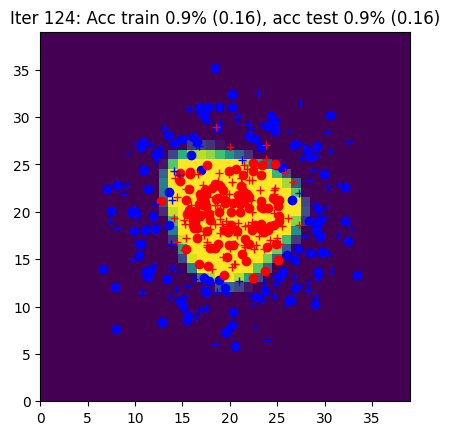

Iter 125: Acc train 0.9% (0.16), acc test 0.9% (0.17)


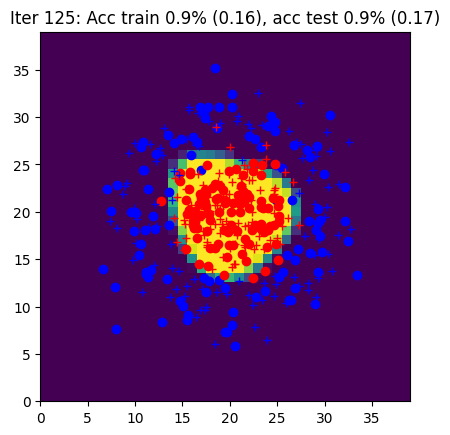

Iter 126: Acc train 0.9% (0.16), acc test 0.9% (0.16)


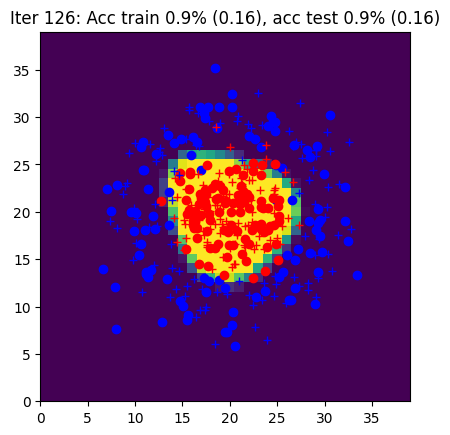

Iter 127: Acc train 0.9% (0.16), acc test 0.9% (0.17)


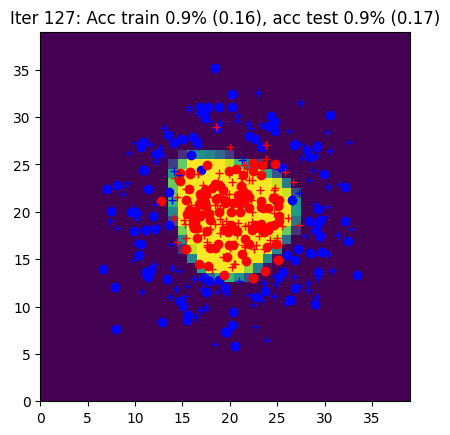

Iter 128: Acc train 0.9% (0.16), acc test 0.9% (0.17)


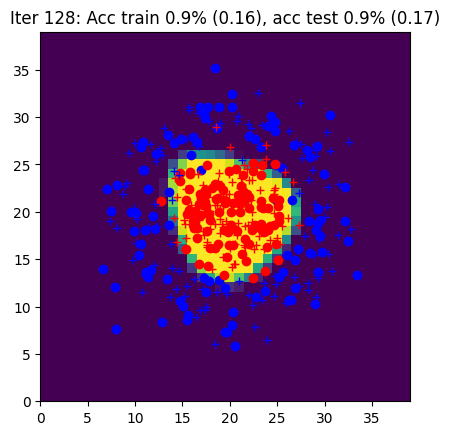

Iter 129: Acc train 0.9% (0.16), acc test 0.9% (0.16)


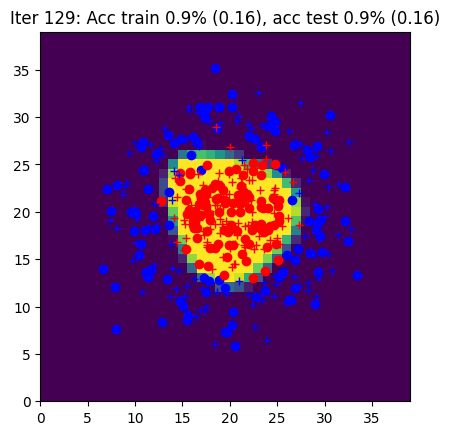

Iter 130: Acc train 0.9% (0.15), acc test 0.9% (0.17)


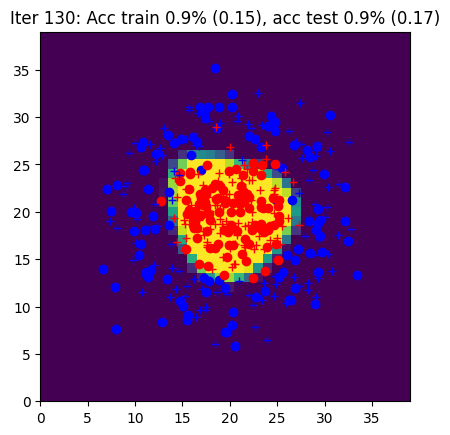

Iter 131: Acc train 0.9% (0.16), acc test 0.9% (0.16)


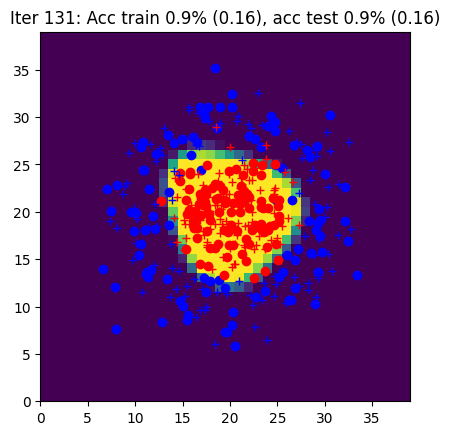

Iter 132: Acc train 0.9% (0.15), acc test 0.9% (0.16)


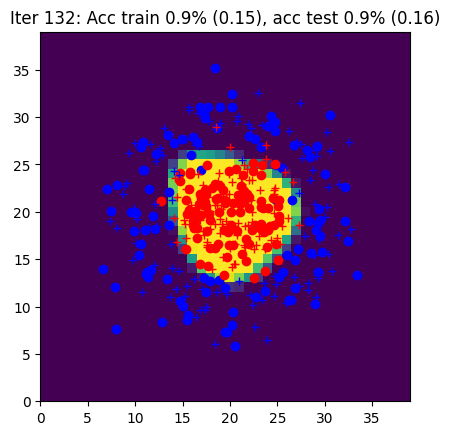

Iter 133: Acc train 0.9% (0.16), acc test 0.9% (0.17)


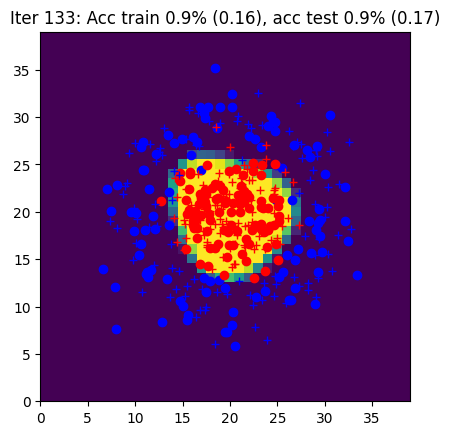

Iter 134: Acc train 0.9% (0.15), acc test 0.9% (0.17)


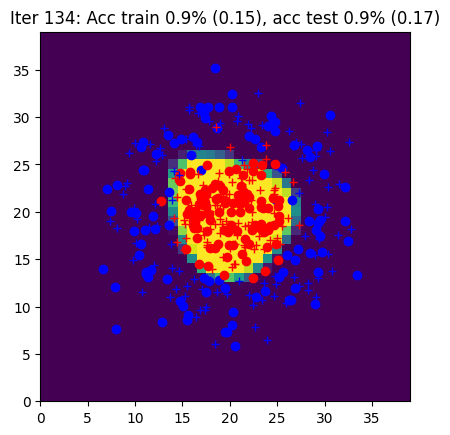

Iter 135: Acc train 0.9% (0.15), acc test 0.9% (0.16)


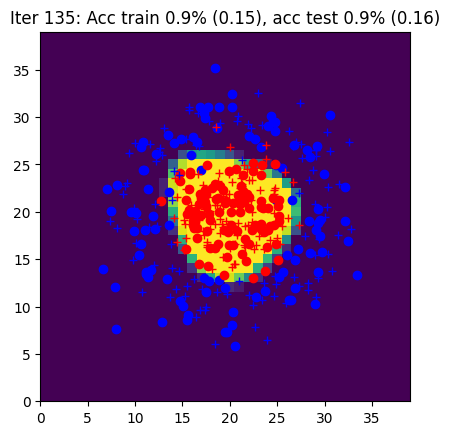

Iter 136: Acc train 0.9% (0.15), acc test 0.9% (0.17)


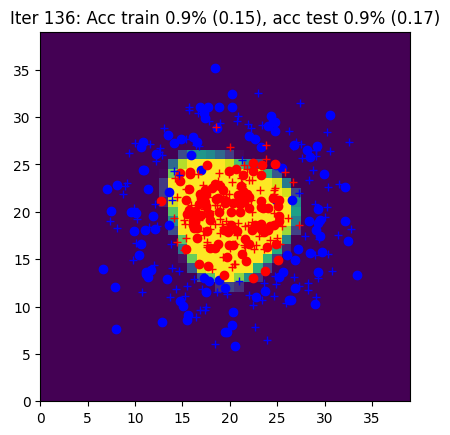

Iter 137: Acc train 0.9% (0.15), acc test 0.9% (0.16)


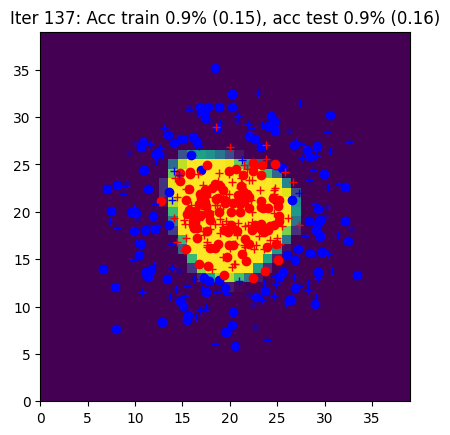

Iter 138: Acc train 0.9% (0.16), acc test 0.9% (0.17)


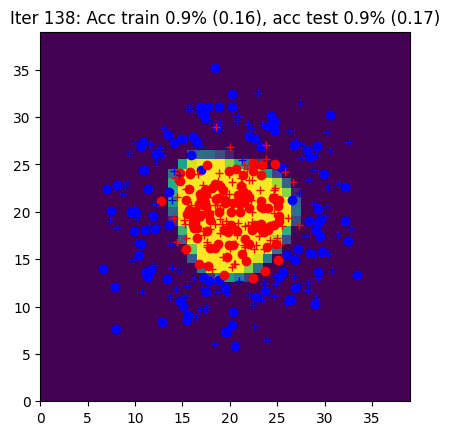

Iter 139: Acc train 0.9% (0.15), acc test 0.9% (0.16)


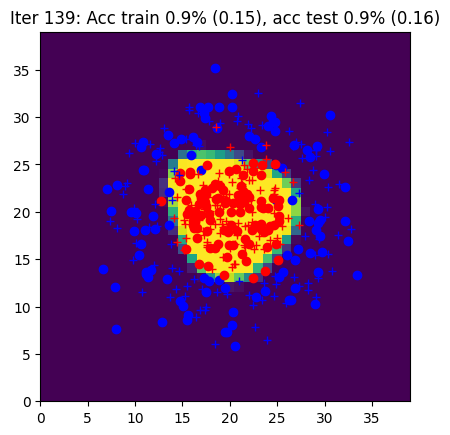

Iter 140: Acc train 0.9% (0.15), acc test 0.9% (0.16)


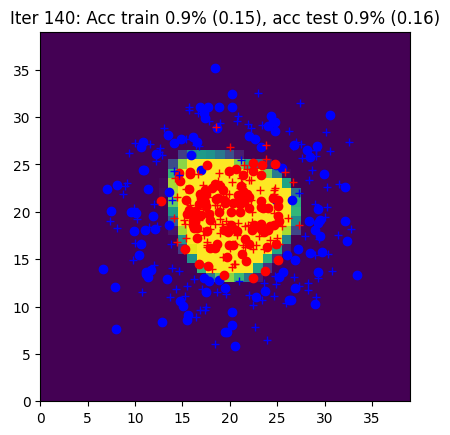

Iter 141: Acc train 0.9% (0.15), acc test 0.9% (0.17)


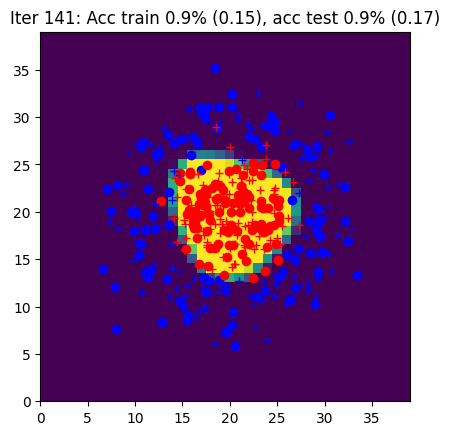

Iter 142: Acc train 0.9% (0.15), acc test 0.9% (0.16)


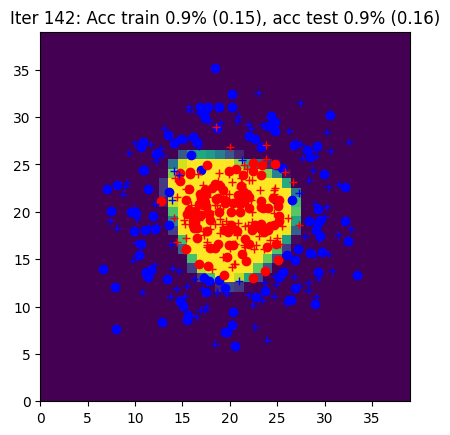

Iter 143: Acc train 0.9% (0.15), acc test 0.9% (0.16)


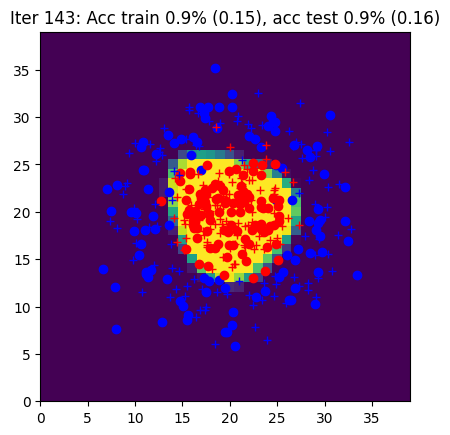

Iter 144: Acc train 0.9% (0.15), acc test 0.9% (0.17)


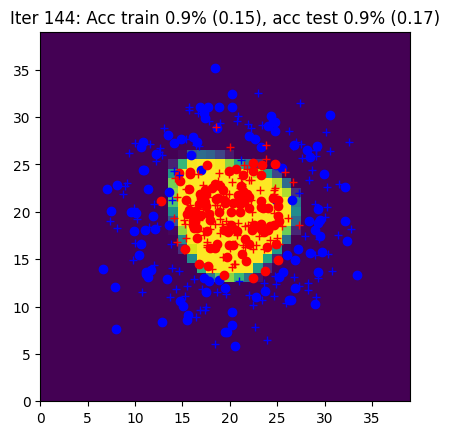

Iter 145: Acc train 0.9% (0.15), acc test 0.9% (0.16)


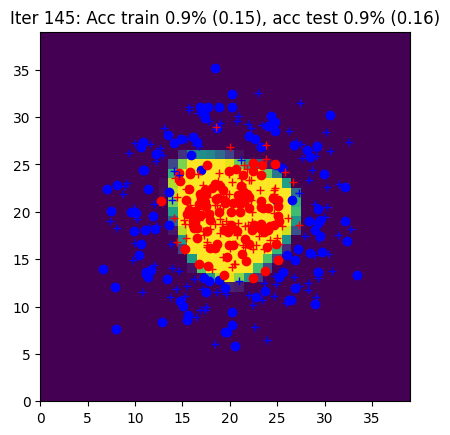

Iter 146: Acc train 0.9% (0.15), acc test 0.9% (0.16)


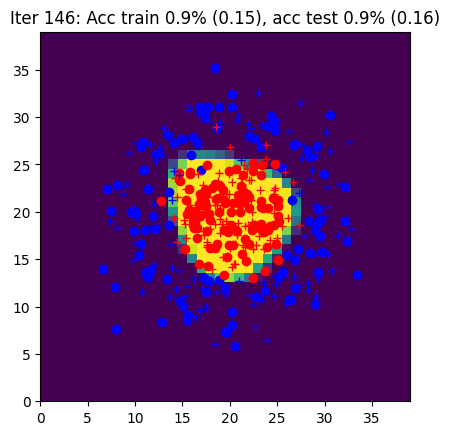

Iter 147: Acc train 0.9% (0.15), acc test 0.9% (0.16)


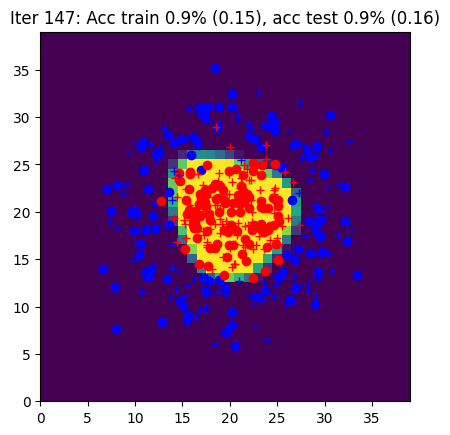

Iter 148: Acc train 0.9% (0.15), acc test 0.9% (0.18)


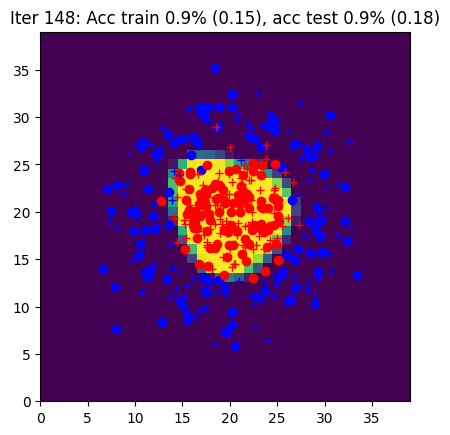

Iter 149: Acc train 0.9% (0.15), acc test 0.9% (0.16)


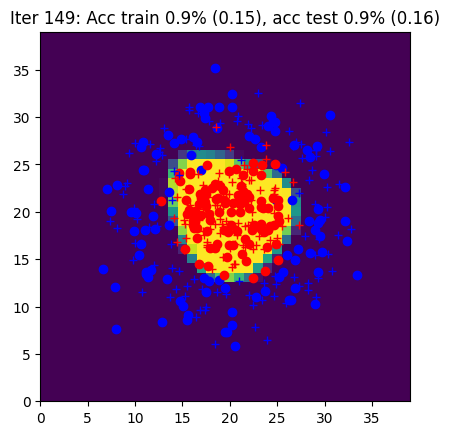

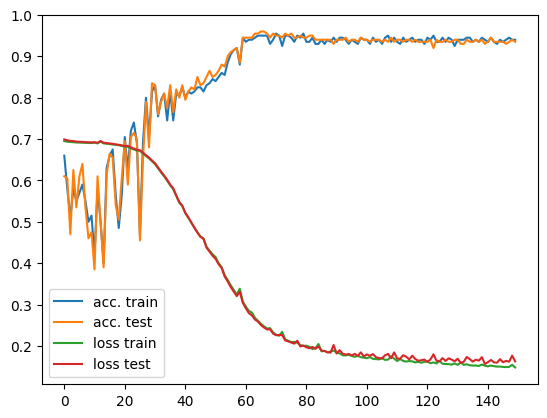

In [13]:
# init


data = CirclesData()
data.plot_data()
N = data.Xtrain.shape[0]
nx = data.Xtrain.shape[1]
nh = 10
ny = data.Ytrain.shape[1]
num_epochs = 150
Nbatch=64
eta=0.01
train_model(data, nx, nh, ny, num_epochs, Nbatch, eta)

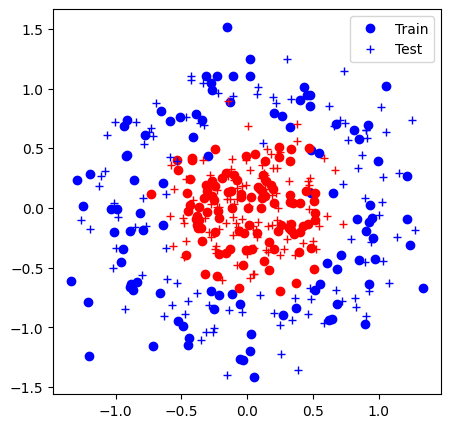

Iter 0: Acc train 0.4% (0.70), acc test 0.4% (0.70)


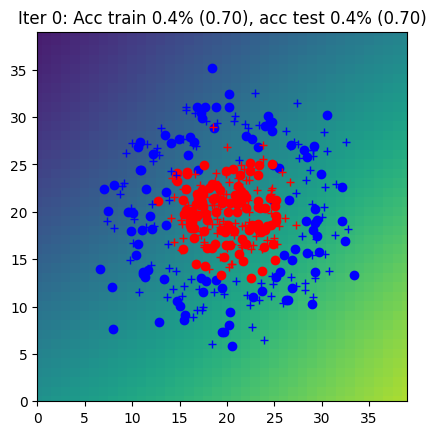

Iter 1: Acc train 0.5% (0.69), acc test 0.4% (0.70)


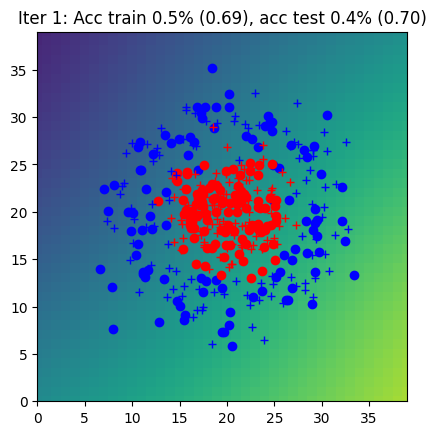

Iter 2: Acc train 0.5% (0.69), acc test 0.5% (0.70)


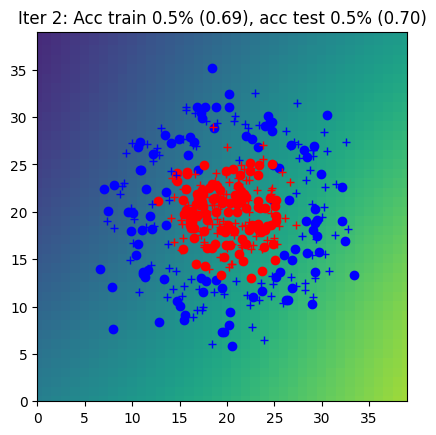

Iter 3: Acc train 0.4% (0.69), acc test 0.4% (0.70)


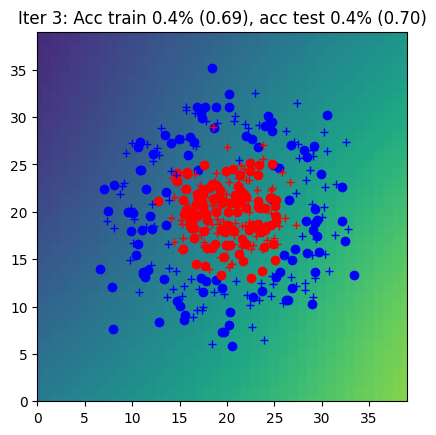

Iter 4: Acc train 0.4% (0.69), acc test 0.4% (0.70)


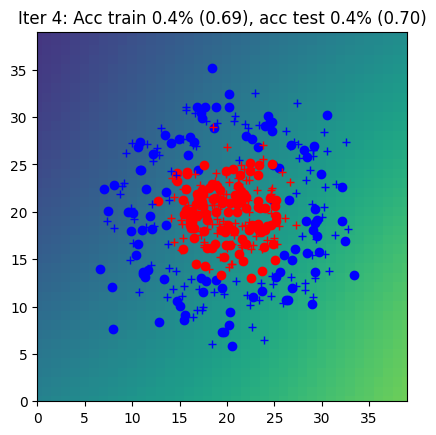

Iter 5: Acc train 0.6% (0.69), acc test 0.6% (0.70)


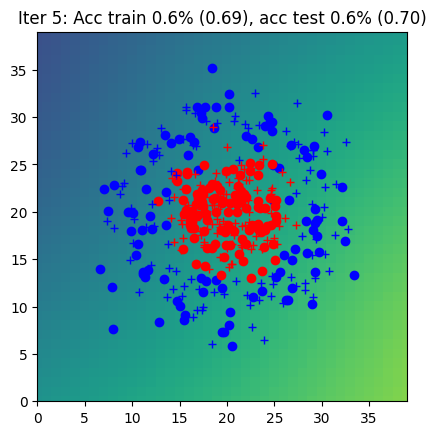

Iter 6: Acc train 0.5% (0.69), acc test 0.4% (0.70)


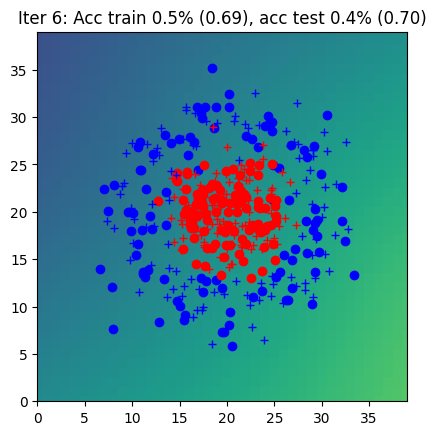

Iter 7: Acc train 0.6% (0.69), acc test 0.6% (0.70)


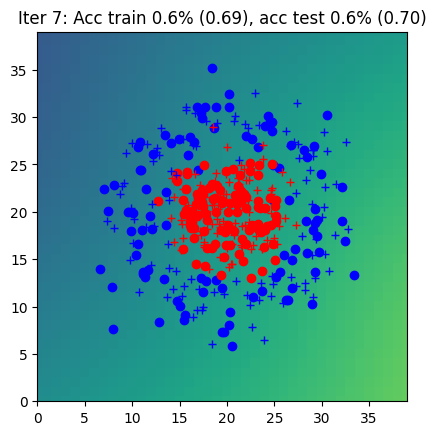

Iter 8: Acc train 0.7% (0.69), acc test 0.6% (0.69)


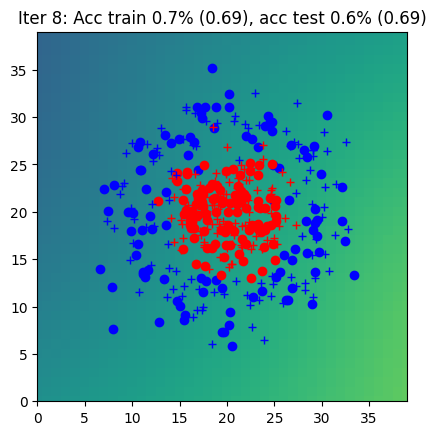

Iter 9: Acc train 0.6% (0.69), acc test 0.6% (0.70)


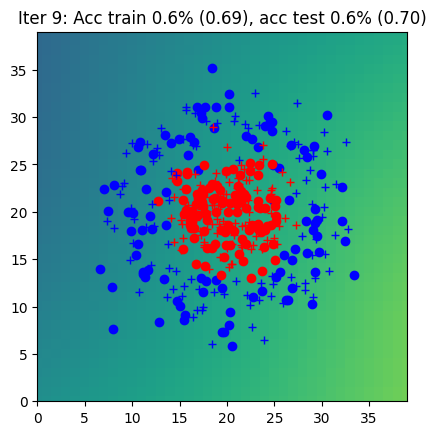

Iter 10: Acc train 0.6% (0.69), acc test 0.6% (0.70)


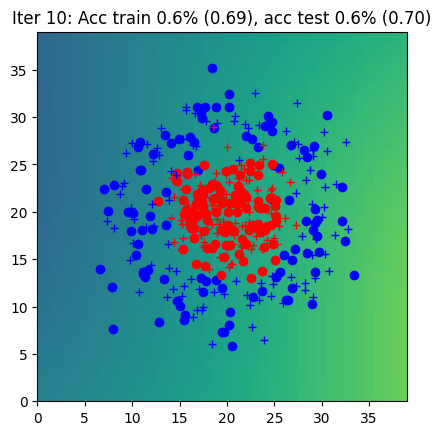

Iter 11: Acc train 0.6% (0.69), acc test 0.6% (0.70)


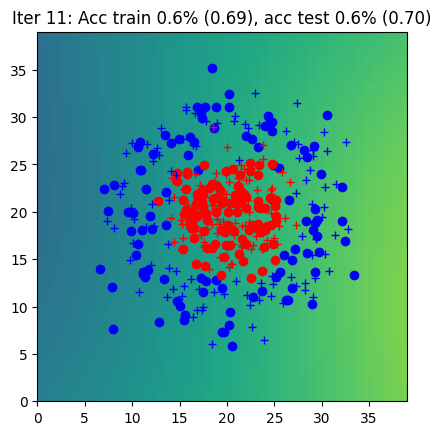

Iter 12: Acc train 0.6% (0.69), acc test 0.6% (0.70)


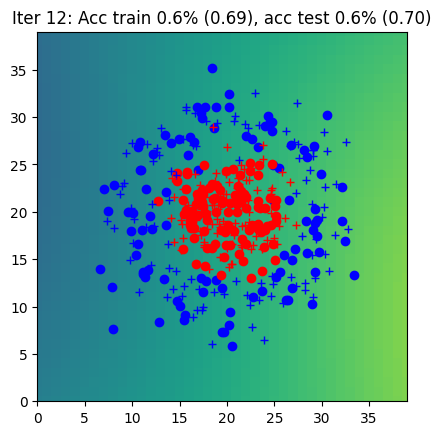

Iter 13: Acc train 0.6% (0.69), acc test 0.6% (0.69)


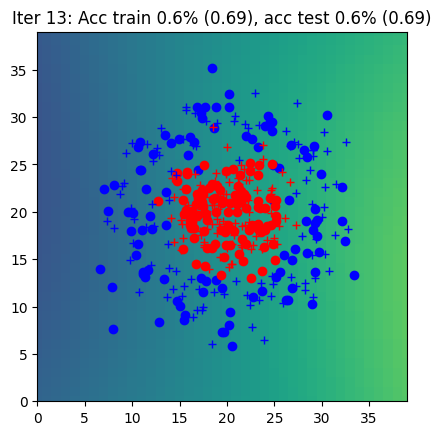

Iter 14: Acc train 0.5% (0.69), acc test 0.5% (0.69)


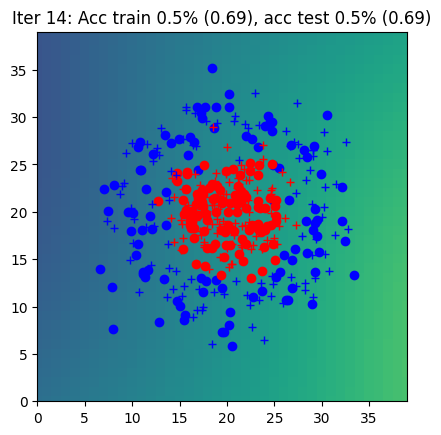

Iter 15: Acc train 0.5% (0.69), acc test 0.5% (0.69)


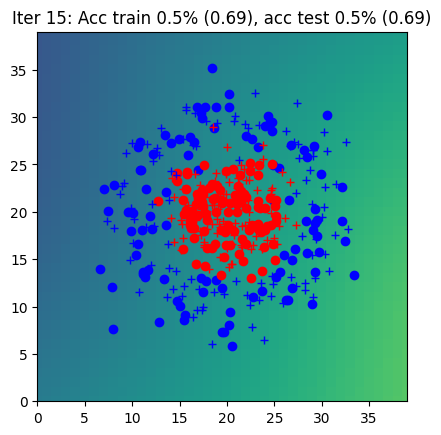

Iter 16: Acc train 0.5% (0.69), acc test 0.4% (0.69)


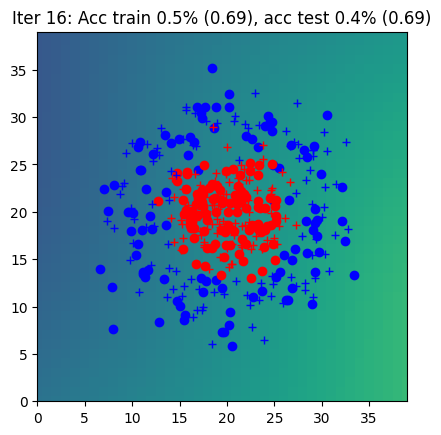

Iter 17: Acc train 0.6% (0.69), acc test 0.5% (0.69)


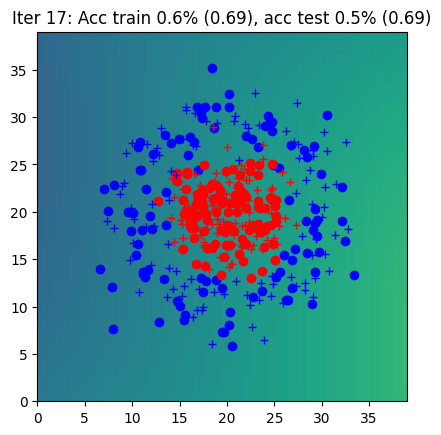

Iter 18: Acc train 0.6% (0.69), acc test 0.6% (0.69)


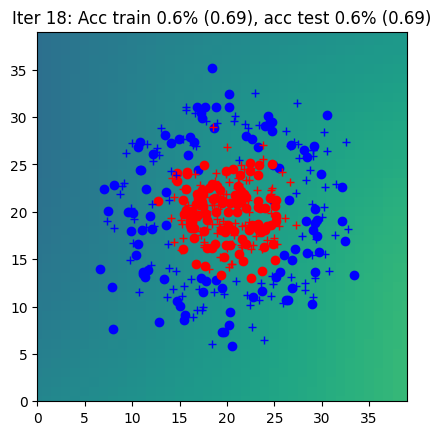

Iter 19: Acc train 0.4% (0.69), acc test 0.4% (0.69)


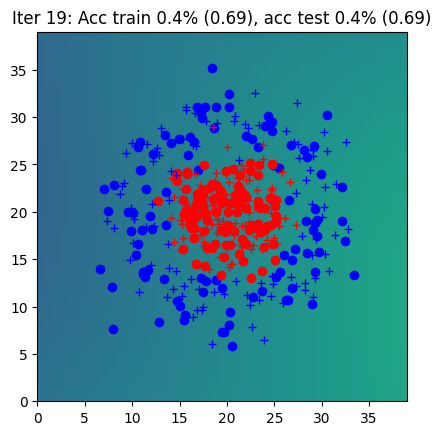

Iter 20: Acc train 0.4% (0.69), acc test 0.4% (0.69)


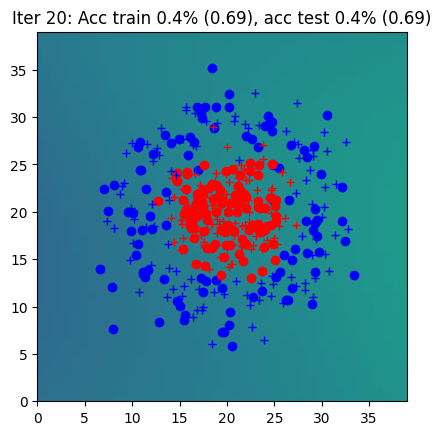

Iter 21: Acc train 0.4% (0.69), acc test 0.4% (0.69)


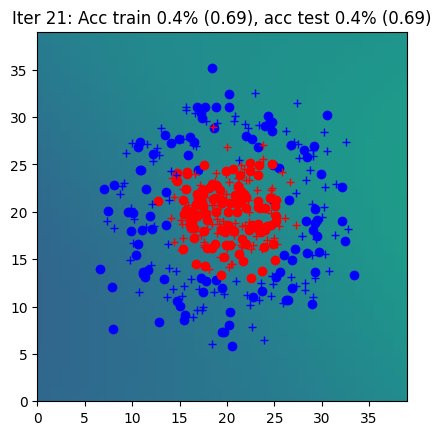

Iter 22: Acc train 0.4% (0.69), acc test 0.4% (0.69)


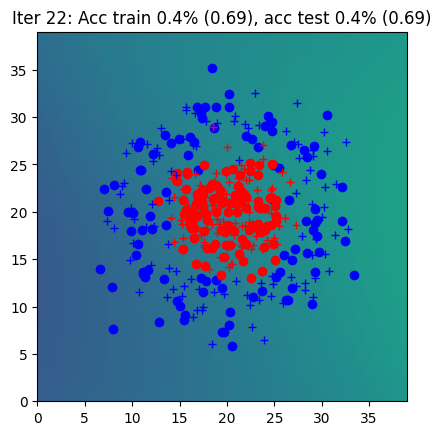

Iter 23: Acc train 0.4% (0.69), acc test 0.4% (0.69)


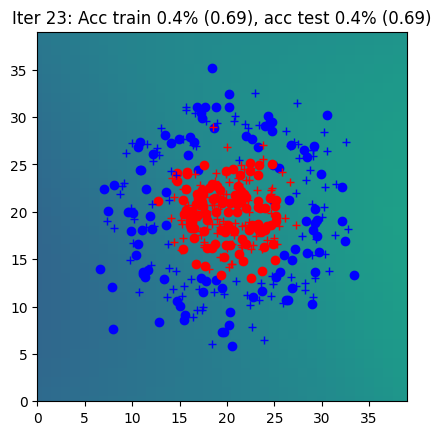

Iter 24: Acc train 0.5% (0.69), acc test 0.5% (0.69)


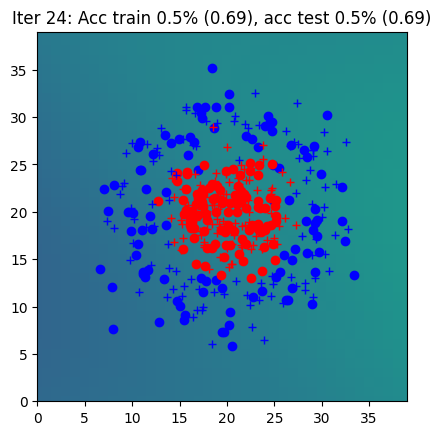

Iter 25: Acc train 0.5% (0.69), acc test 0.5% (0.69)


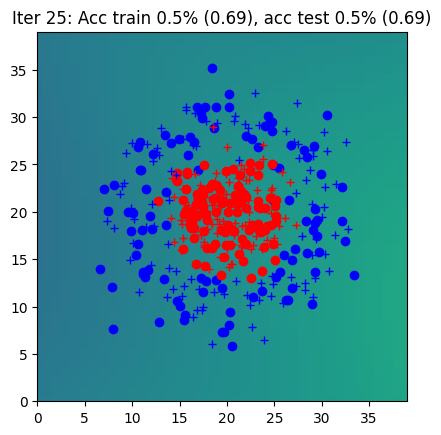

Iter 26: Acc train 0.5% (0.69), acc test 0.5% (0.69)


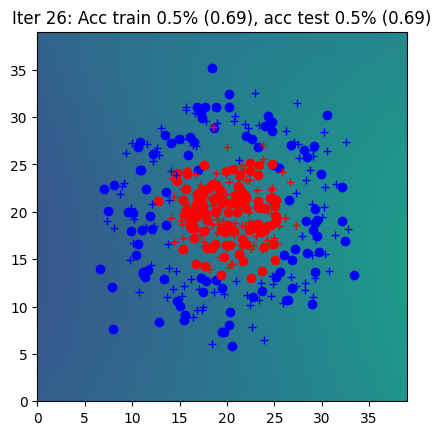

Iter 27: Acc train 0.5% (0.69), acc test 0.5% (0.69)


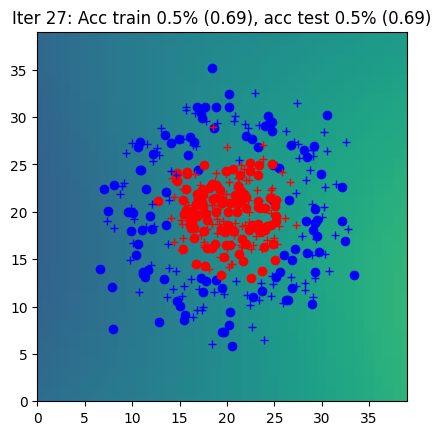

Iter 28: Acc train 0.6% (0.69), acc test 0.5% (0.69)


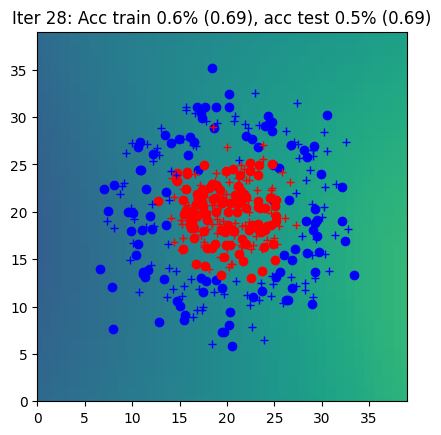

Iter 29: Acc train 0.6% (0.69), acc test 0.6% (0.69)


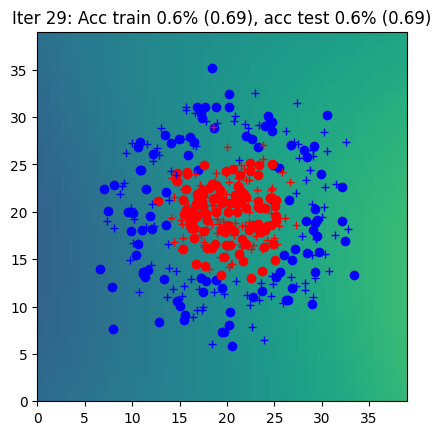

Iter 30: Acc train 0.5% (0.69), acc test 0.4% (0.69)


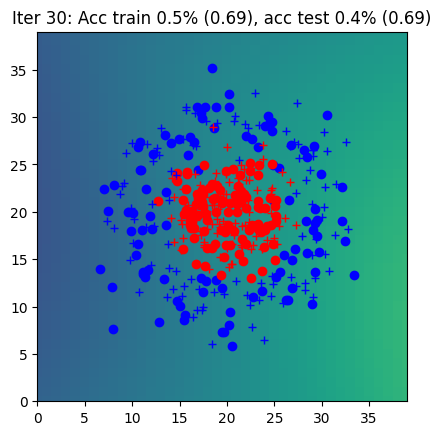

Iter 31: Acc train 0.4% (0.69), acc test 0.4% (0.69)


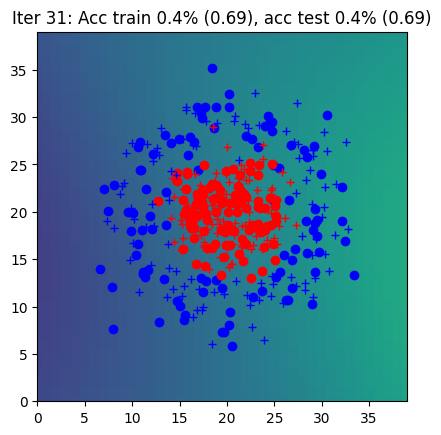

Iter 32: Acc train 0.4% (0.69), acc test 0.4% (0.69)


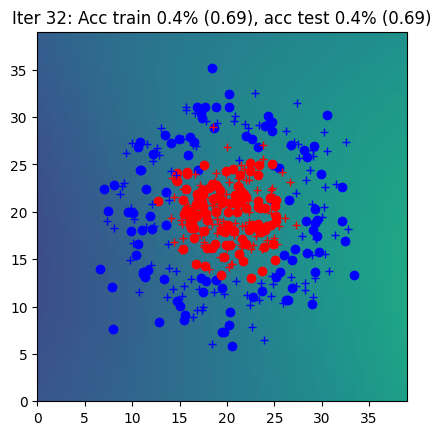

Iter 33: Acc train 0.7% (0.69), acc test 0.6% (0.69)


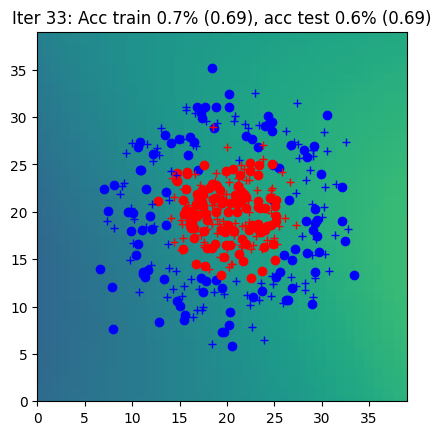

Iter 34: Acc train 0.6% (0.69), acc test 0.6% (0.69)


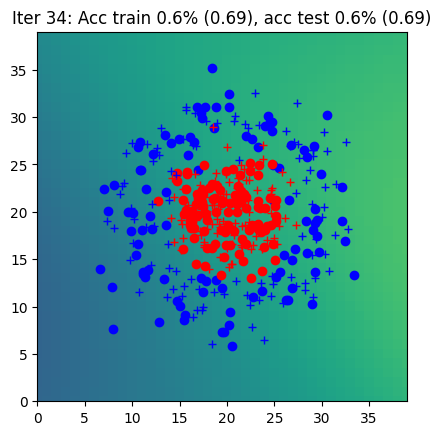

Iter 35: Acc train 0.6% (0.69), acc test 0.6% (0.69)


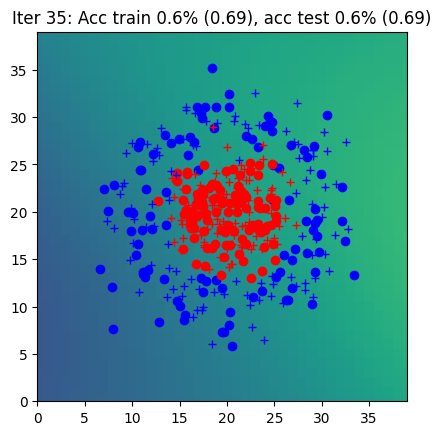

Iter 36: Acc train 0.6% (0.69), acc test 0.6% (0.69)


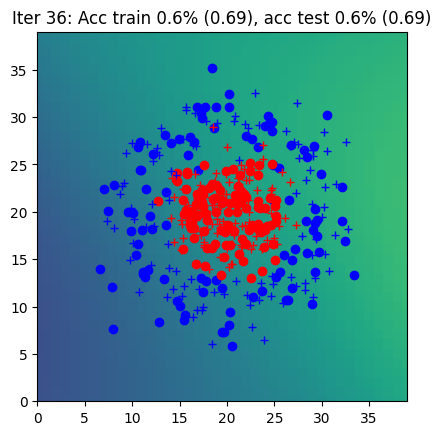

Iter 37: Acc train 0.4% (0.69), acc test 0.4% (0.69)


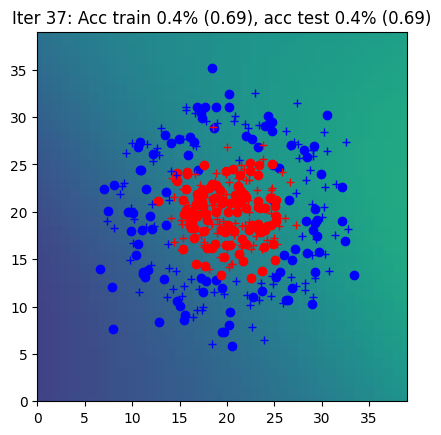

Iter 38: Acc train 0.6% (0.69), acc test 0.6% (0.69)


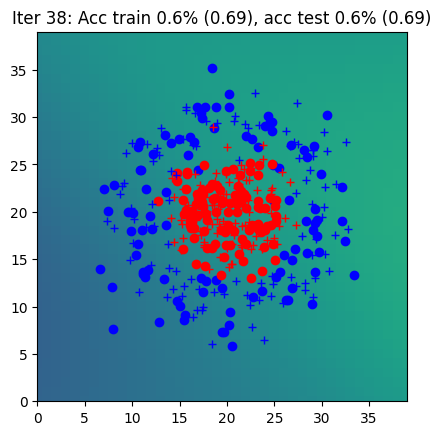

Iter 39: Acc train 0.6% (0.69), acc test 0.6% (0.69)


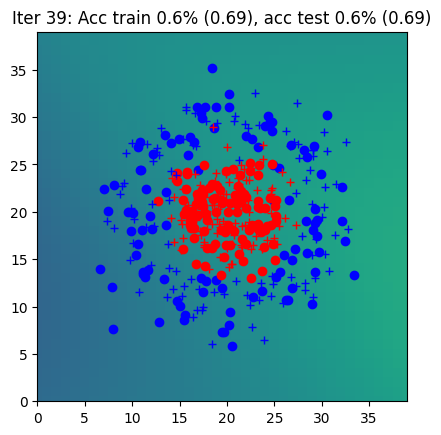

Iter 40: Acc train 0.6% (0.69), acc test 0.6% (0.69)


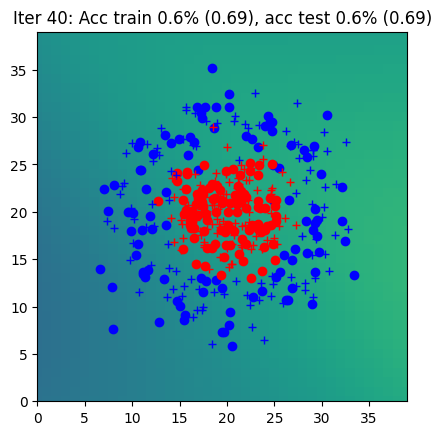

Iter 41: Acc train 0.6% (0.69), acc test 0.6% (0.69)


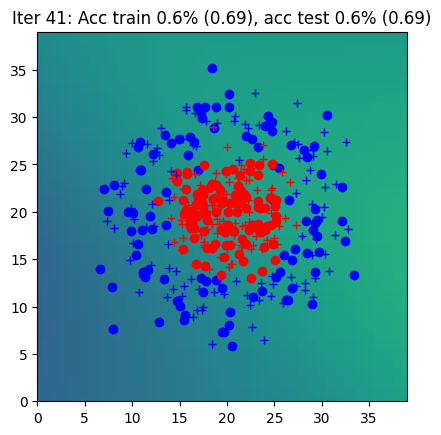

Iter 42: Acc train 0.6% (0.69), acc test 0.6% (0.69)


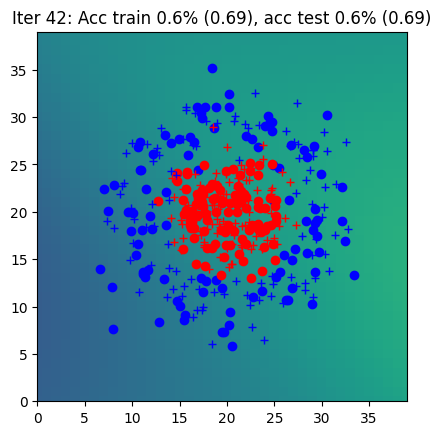

Iter 43: Acc train 0.5% (0.69), acc test 0.5% (0.69)


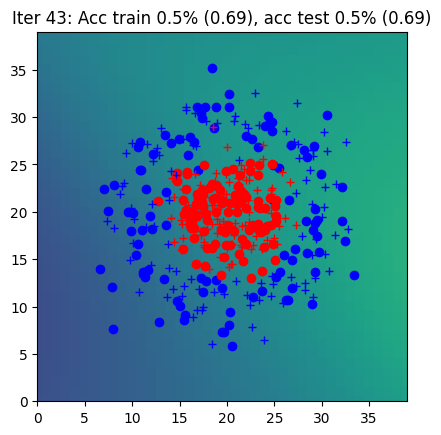

Iter 44: Acc train 0.6% (0.69), acc test 0.6% (0.69)


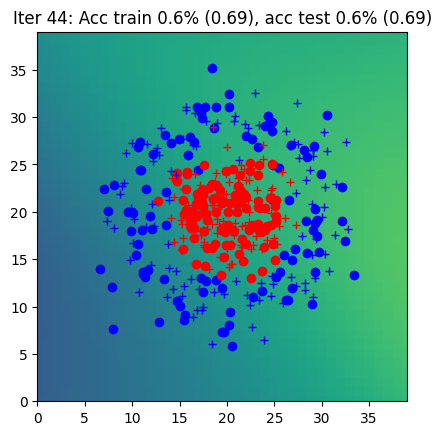

Iter 45: Acc train 0.6% (0.69), acc test 0.6% (0.69)


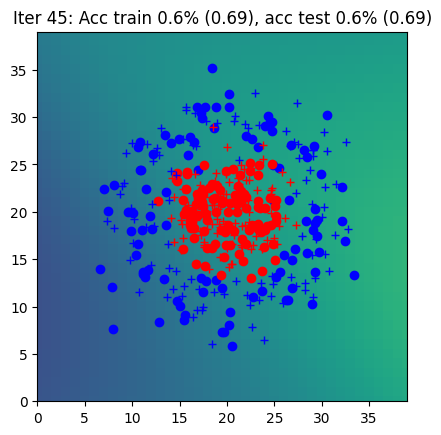

Iter 46: Acc train 0.6% (0.69), acc test 0.6% (0.69)


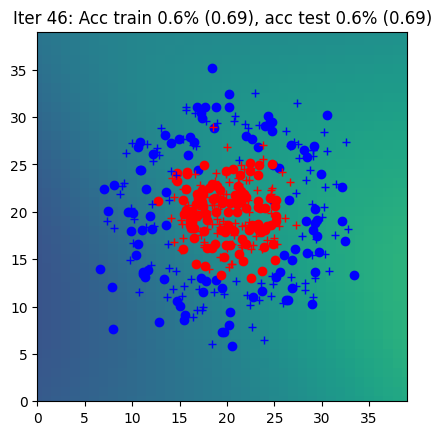

Iter 47: Acc train 0.4% (0.69), acc test 0.4% (0.69)


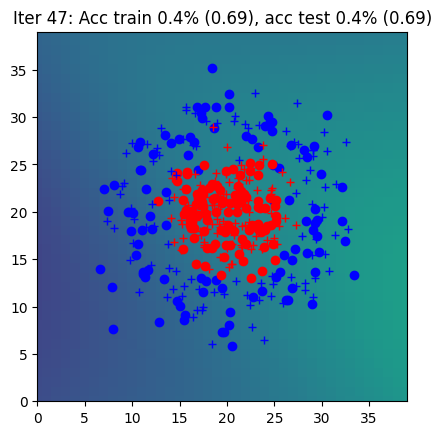

Iter 48: Acc train 0.4% (0.69), acc test 0.4% (0.69)


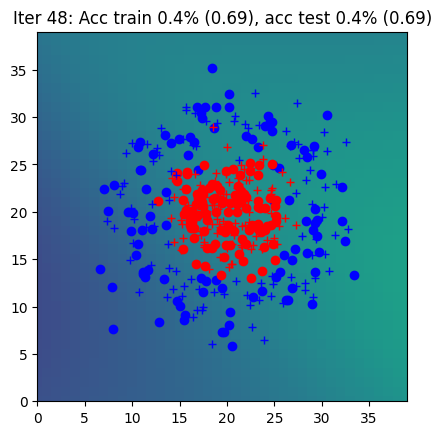

Iter 49: Acc train 0.5% (0.69), acc test 0.5% (0.69)


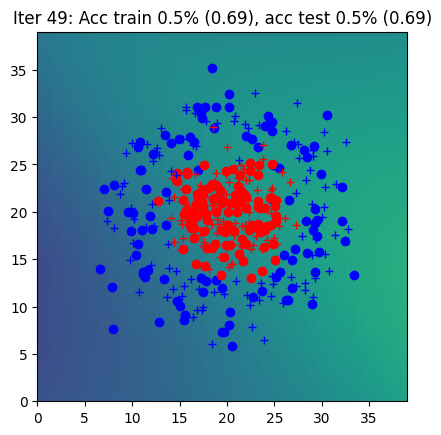

Iter 50: Acc train 0.4% (0.69), acc test 0.4% (0.69)


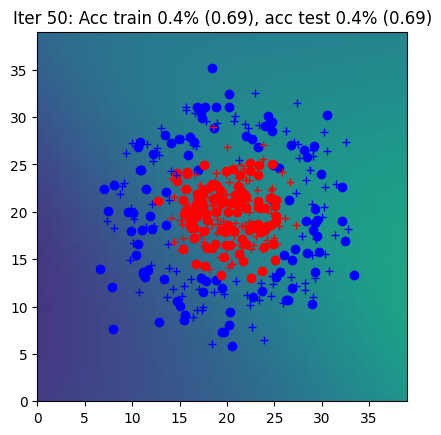

Iter 51: Acc train 0.4% (0.69), acc test 0.4% (0.69)


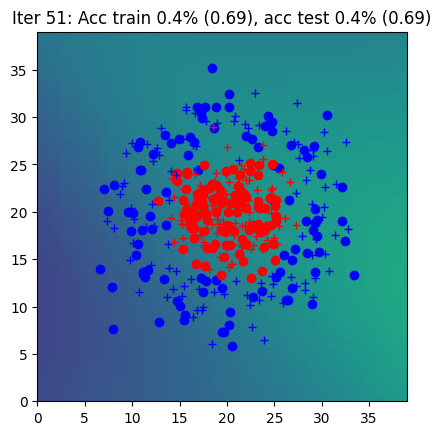

Iter 52: Acc train 0.5% (0.68), acc test 0.5% (0.69)


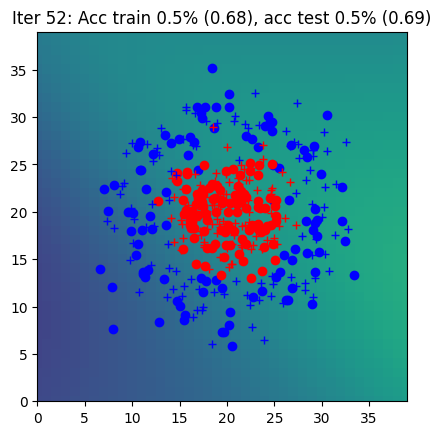

Iter 53: Acc train 0.5% (0.68), acc test 0.6% (0.68)


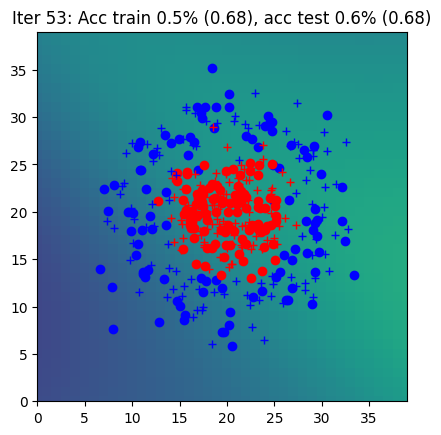

Iter 54: Acc train 0.5% (0.68), acc test 0.6% (0.68)


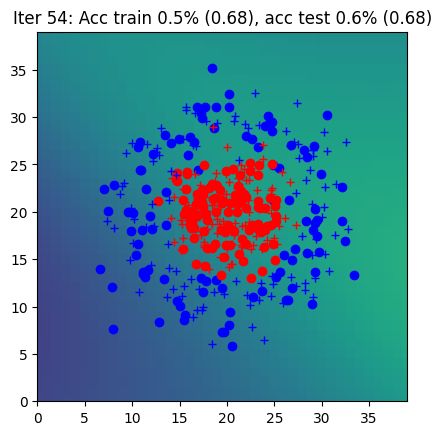

Iter 55: Acc train 0.6% (0.68), acc test 0.6% (0.68)


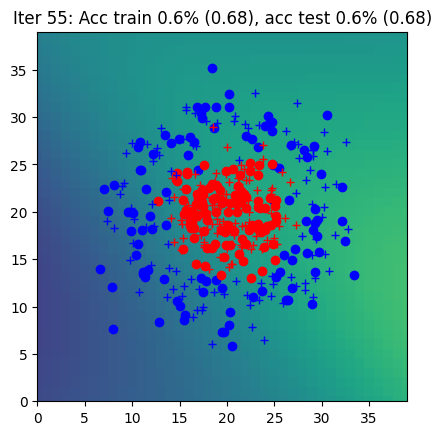

Iter 56: Acc train 0.5% (0.68), acc test 0.5% (0.68)


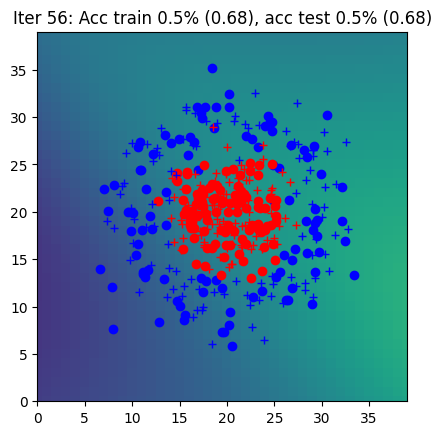

Iter 57: Acc train 0.6% (0.68), acc test 0.6% (0.68)


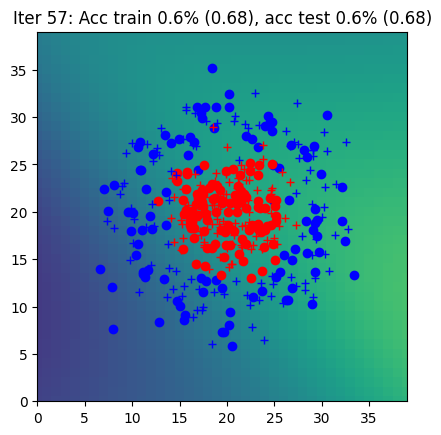

Iter 58: Acc train 0.6% (0.68), acc test 0.6% (0.68)


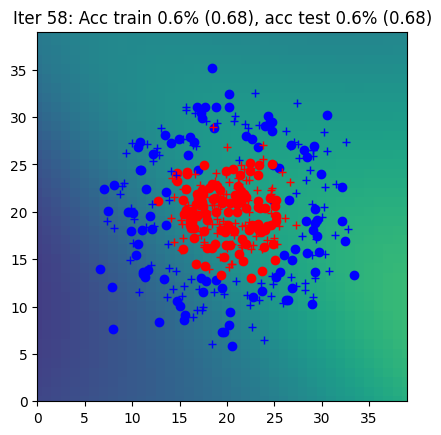

Iter 59: Acc train 0.6% (0.68), acc test 0.6% (0.68)


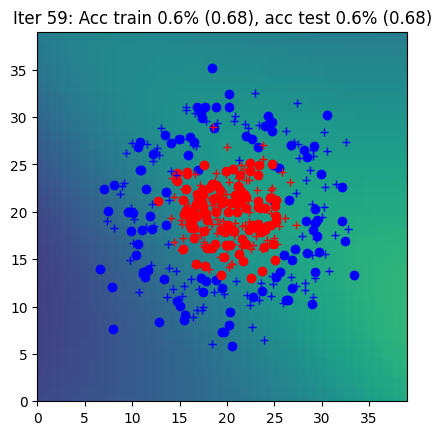

Iter 60: Acc train 0.6% (0.68), acc test 0.5% (0.68)


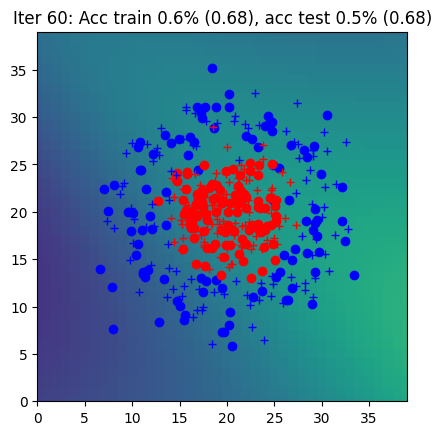

Iter 61: Acc train 0.4% (0.68), acc test 0.4% (0.68)


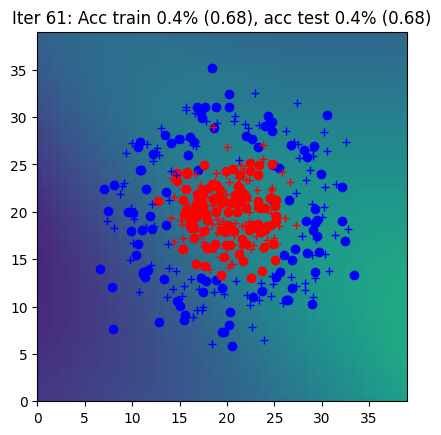

Iter 62: Acc train 0.6% (0.68), acc test 0.6% (0.68)


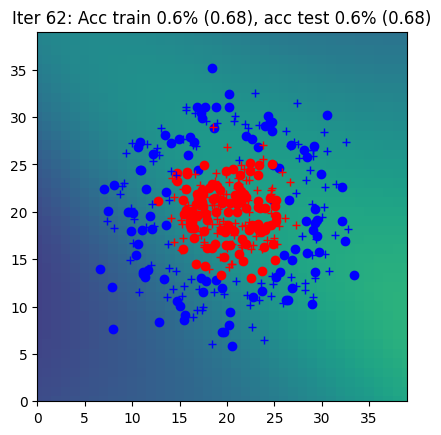

Iter 63: Acc train 0.6% (0.68), acc test 0.6% (0.68)


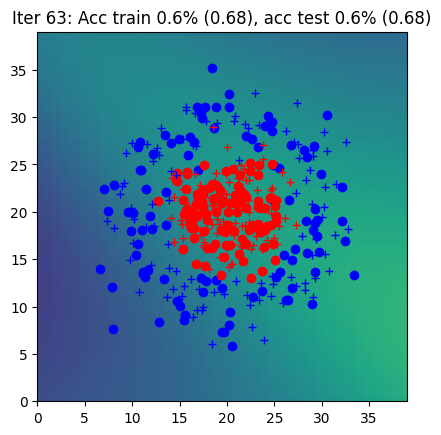

Iter 64: Acc train 0.7% (0.67), acc test 0.6% (0.68)


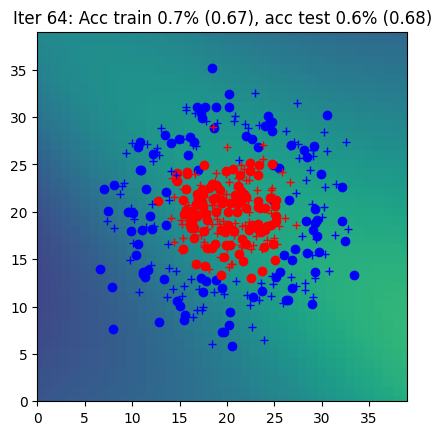

Iter 65: Acc train 0.6% (0.67), acc test 0.6% (0.68)


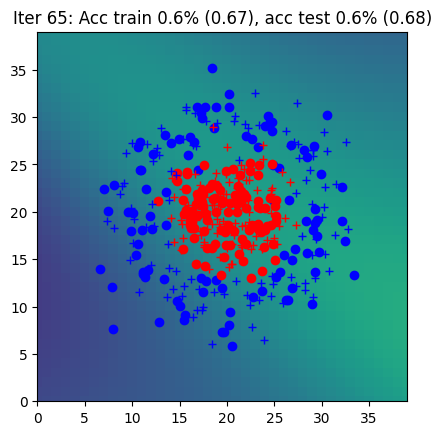

Iter 66: Acc train 0.5% (0.67), acc test 0.6% (0.68)


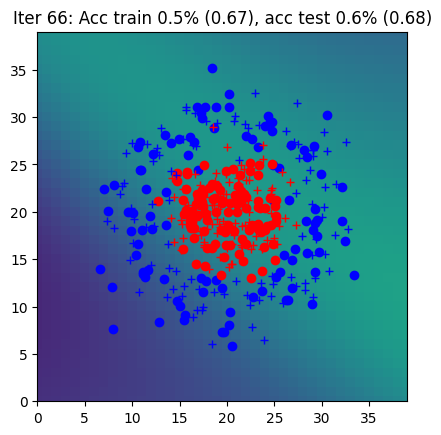

Iter 67: Acc train 0.6% (0.67), acc test 0.6% (0.67)


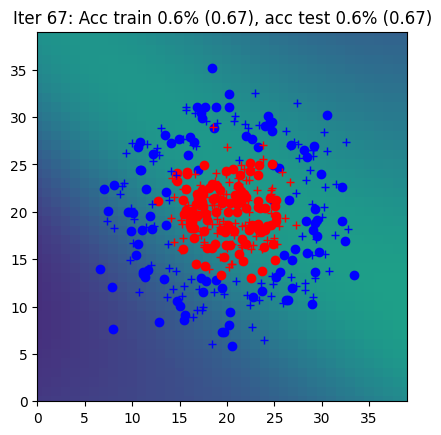

Iter 68: Acc train 0.6% (0.67), acc test 0.6% (0.67)


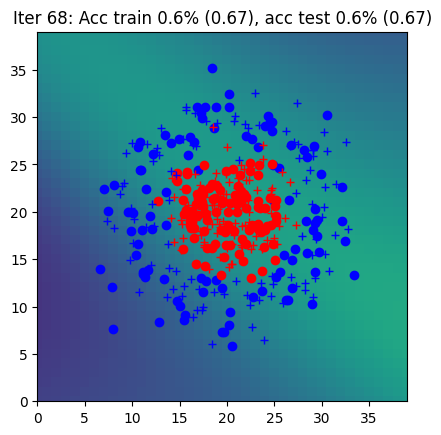

Iter 69: Acc train 0.7% (0.67), acc test 0.7% (0.67)


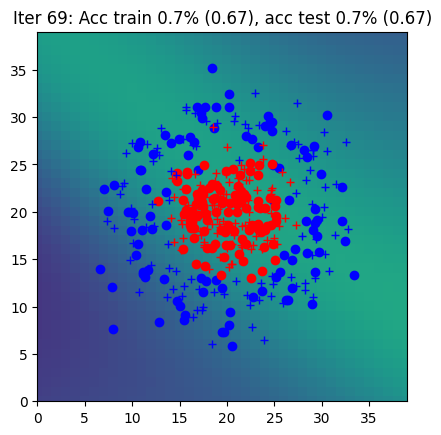

Iter 70: Acc train 0.7% (0.67), acc test 0.7% (0.67)


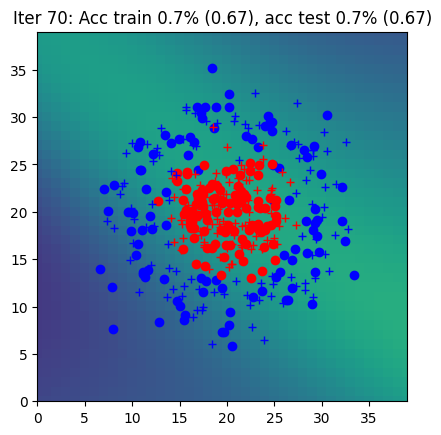

Iter 71: Acc train 0.7% (0.67), acc test 0.7% (0.67)


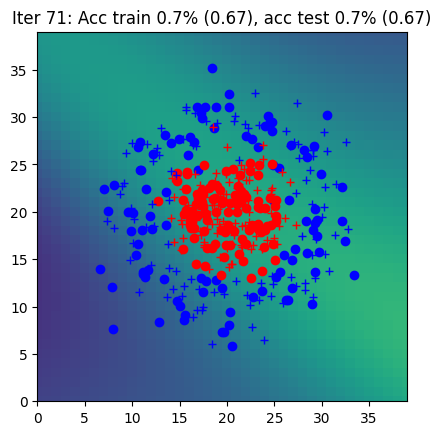

Iter 72: Acc train 0.7% (0.66), acc test 0.7% (0.67)


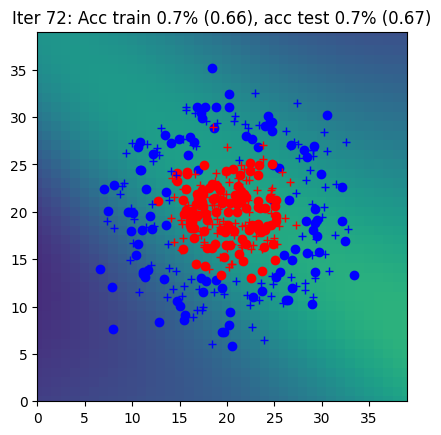

Iter 73: Acc train 0.7% (0.66), acc test 0.7% (0.67)


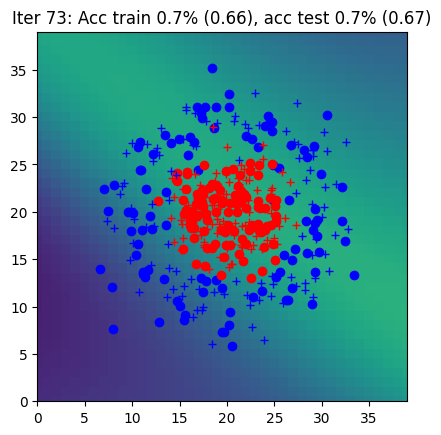

Iter 74: Acc train 0.7% (0.66), acc test 0.6% (0.66)


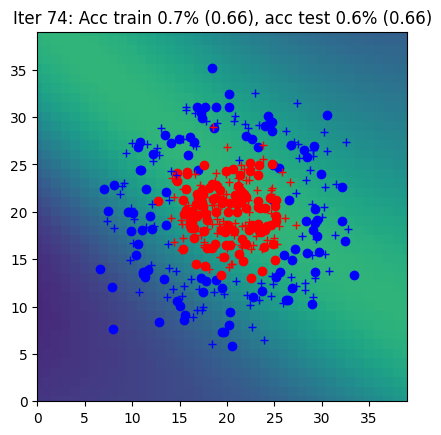

Iter 75: Acc train 0.7% (0.66), acc test 0.7% (0.66)


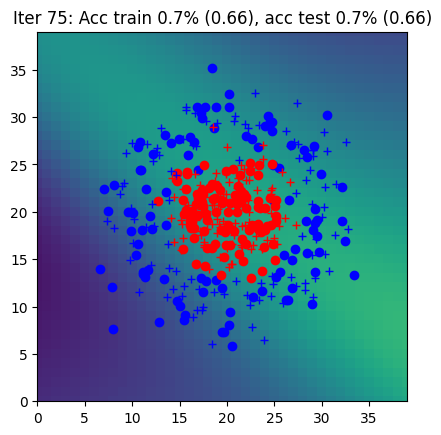

Iter 76: Acc train 0.7% (0.66), acc test 0.7% (0.66)


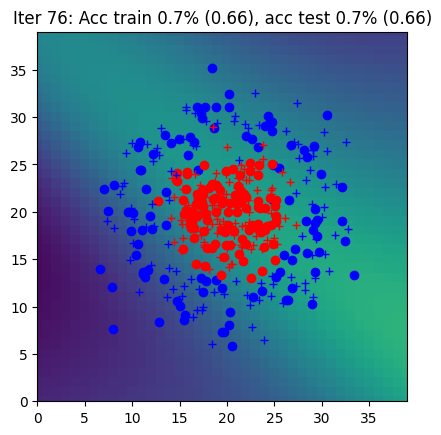

Iter 77: Acc train 0.7% (0.66), acc test 0.7% (0.66)


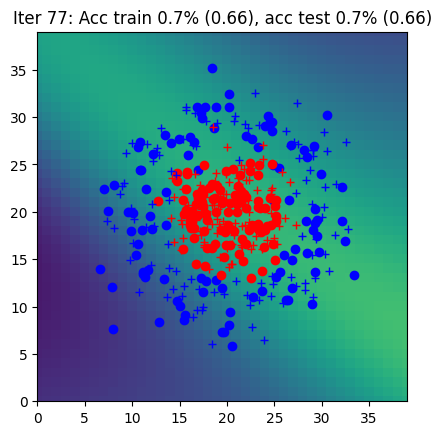

Iter 78: Acc train 0.7% (0.65), acc test 0.7% (0.66)


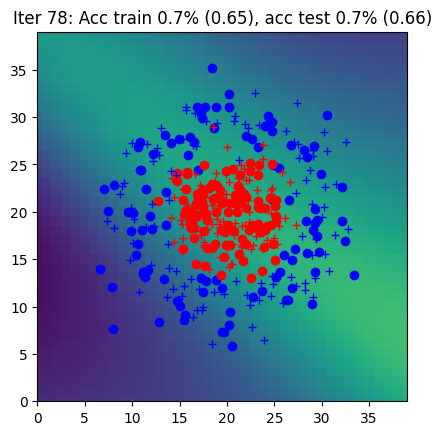

Iter 79: Acc train 0.7% (0.65), acc test 0.7% (0.66)


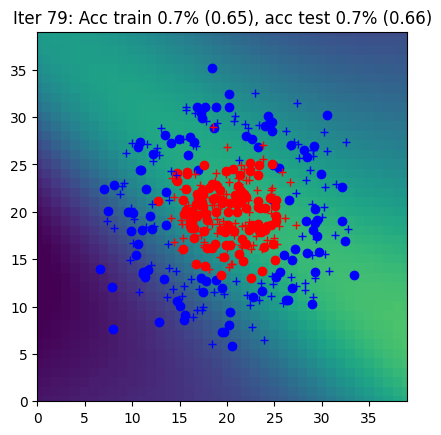

Iter 80: Acc train 0.7% (0.65), acc test 0.7% (0.66)


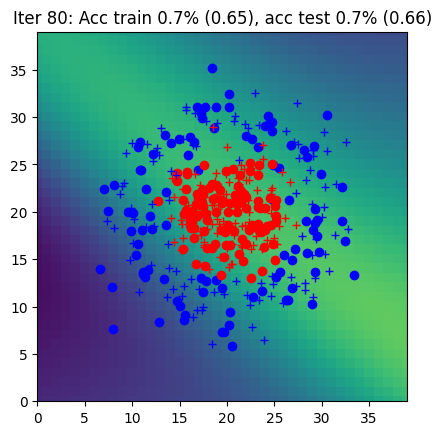

Iter 81: Acc train 0.7% (0.65), acc test 0.7% (0.65)


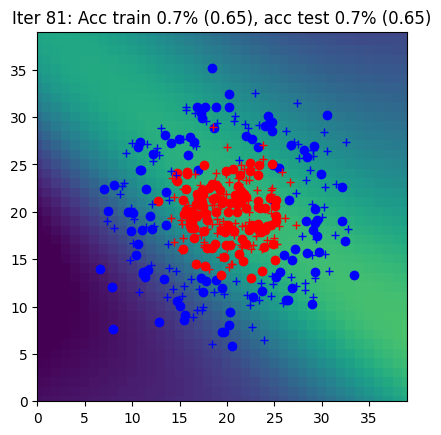

Iter 82: Acc train 0.7% (0.64), acc test 0.7% (0.65)


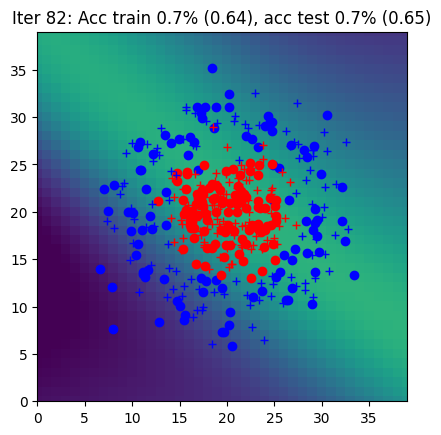

Iter 83: Acc train 0.7% (0.64), acc test 0.7% (0.65)


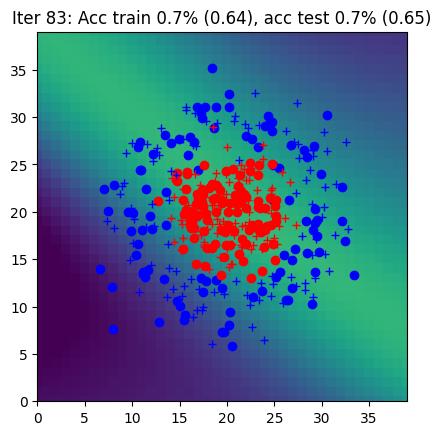

Iter 84: Acc train 0.7% (0.64), acc test 0.7% (0.64)


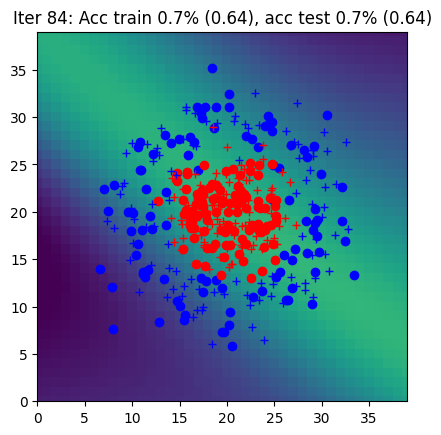

Iter 85: Acc train 0.7% (0.63), acc test 0.7% (0.64)


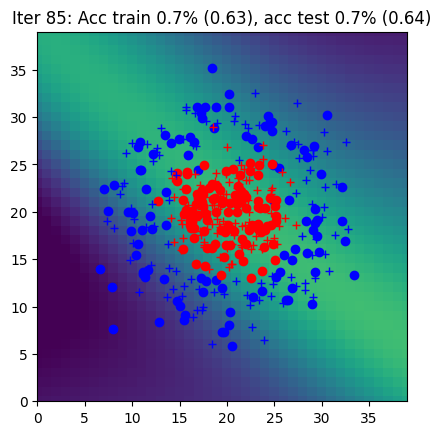

Iter 86: Acc train 0.7% (0.63), acc test 0.7% (0.64)


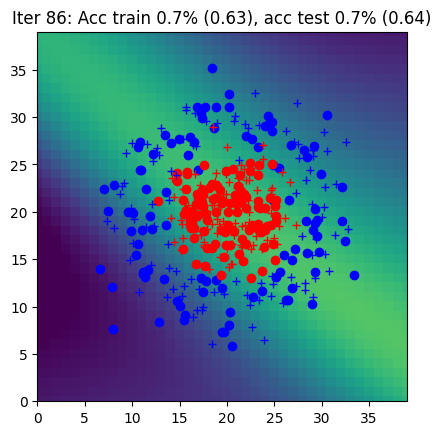

Iter 87: Acc train 0.8% (0.63), acc test 0.8% (0.64)


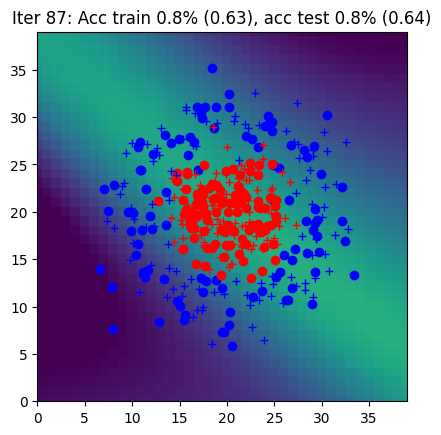

Iter 88: Acc train 0.8% (0.63), acc test 0.8% (0.63)


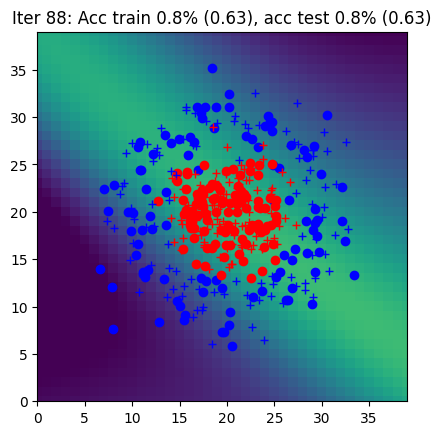

Iter 89: Acc train 0.8% (0.62), acc test 0.8% (0.63)


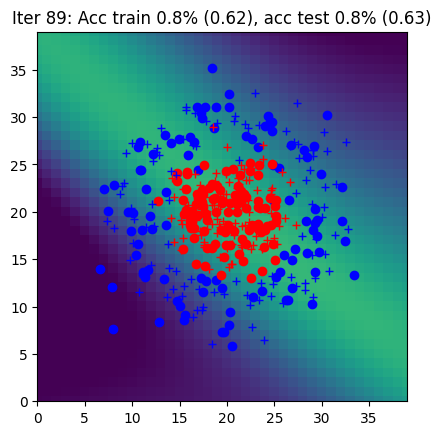

Iter 90: Acc train 0.8% (0.62), acc test 0.8% (0.63)


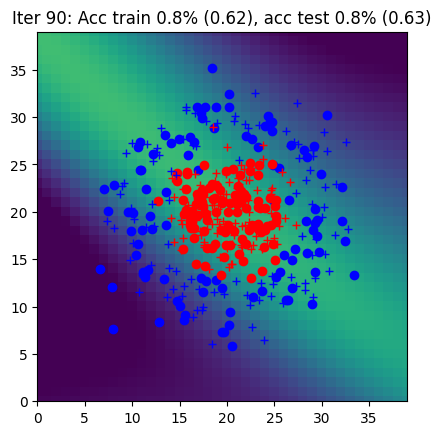

Iter 91: Acc train 0.8% (0.62), acc test 0.8% (0.63)


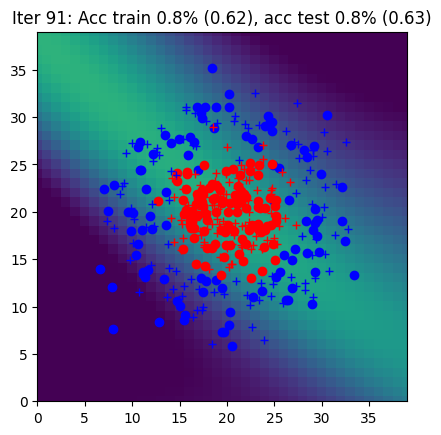

Iter 92: Acc train 0.8% (0.61), acc test 0.8% (0.62)


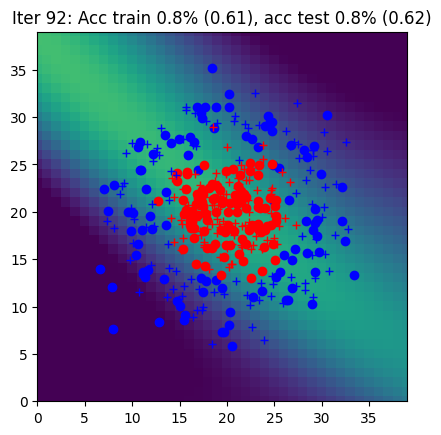

Iter 93: Acc train 0.8% (0.61), acc test 0.7% (0.62)


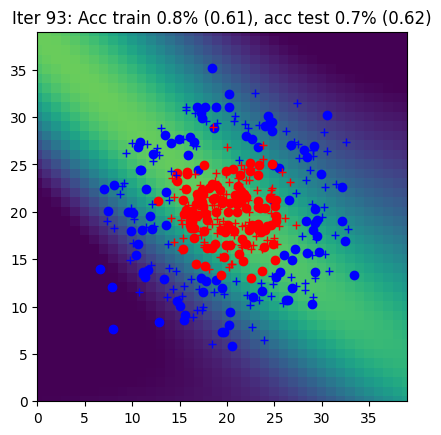

Iter 94: Acc train 0.7% (0.61), acc test 0.7% (0.62)


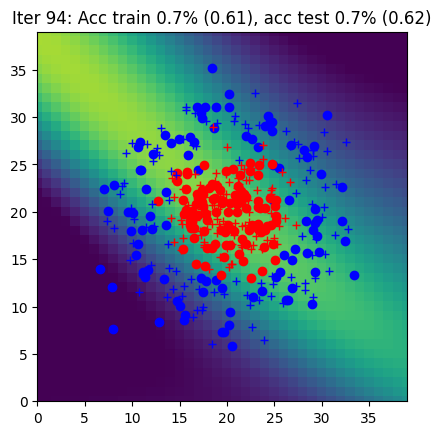

Iter 95: Acc train 0.8% (0.60), acc test 0.7% (0.61)


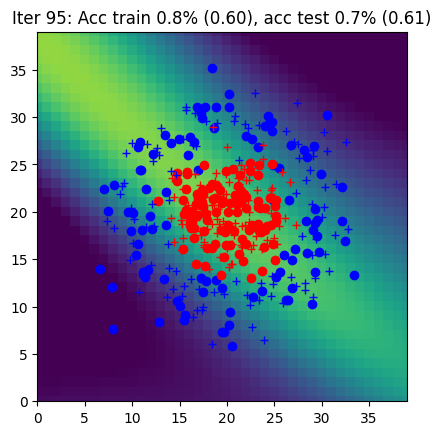

Iter 96: Acc train 0.8% (0.60), acc test 0.8% (0.61)


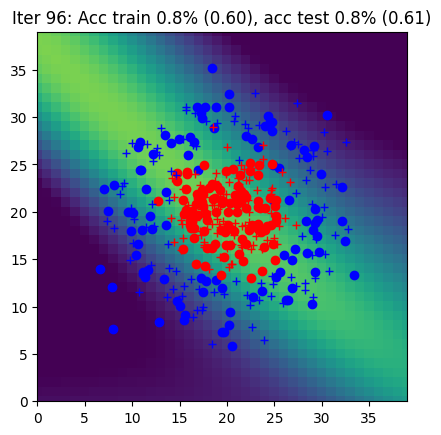

Iter 97: Acc train 0.7% (0.60), acc test 0.7% (0.61)


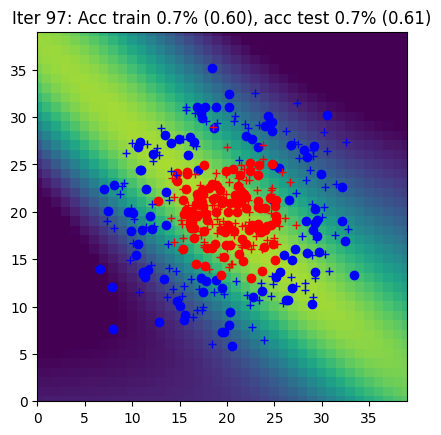

Iter 98: Acc train 0.8% (0.59), acc test 0.8% (0.61)


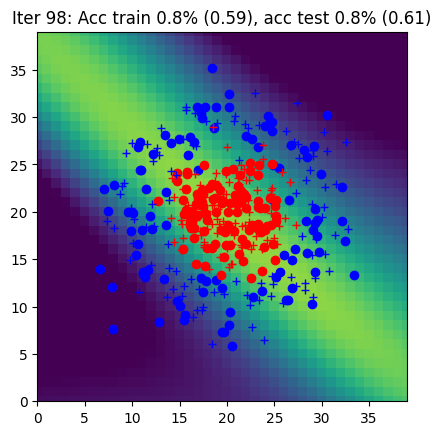

Iter 99: Acc train 0.8% (0.59), acc test 0.8% (0.60)


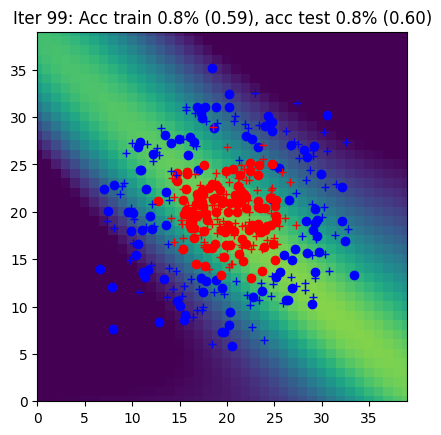

Iter 100: Acc train 0.8% (0.58), acc test 0.8% (0.60)


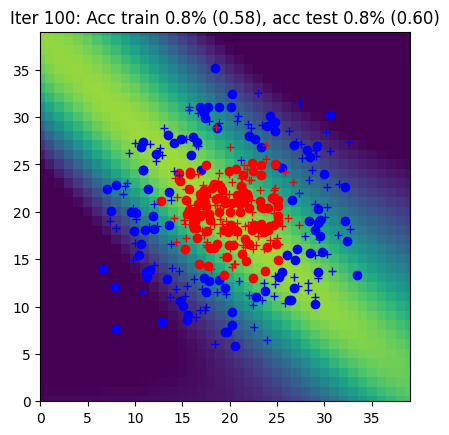

Iter 101: Acc train 0.8% (0.58), acc test 0.8% (0.59)


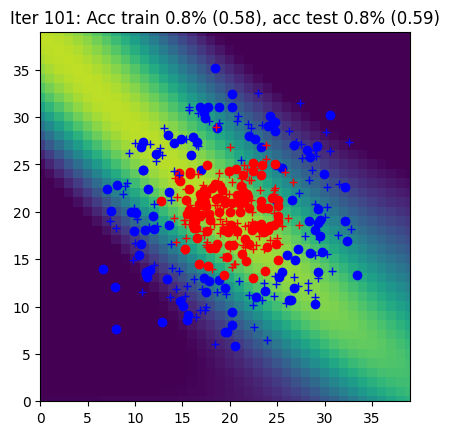

Iter 102: Acc train 0.8% (0.58), acc test 0.8% (0.59)


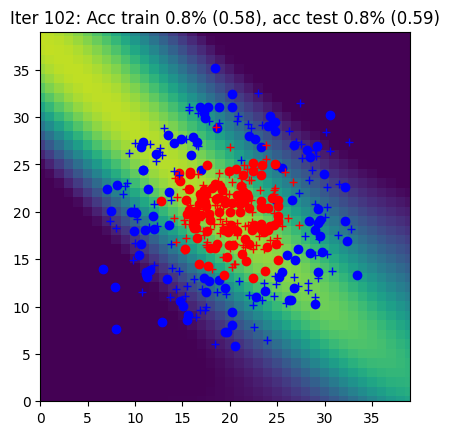

Iter 103: Acc train 0.8% (0.57), acc test 0.8% (0.59)


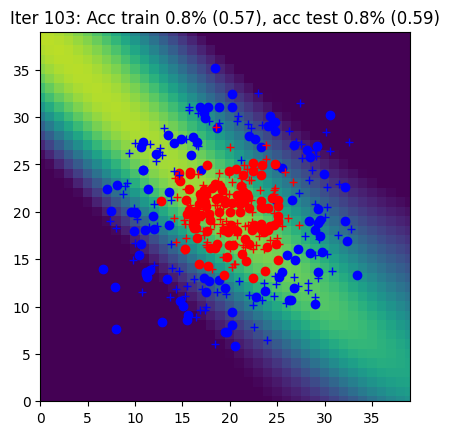

Iter 104: Acc train 0.8% (0.57), acc test 0.8% (0.58)


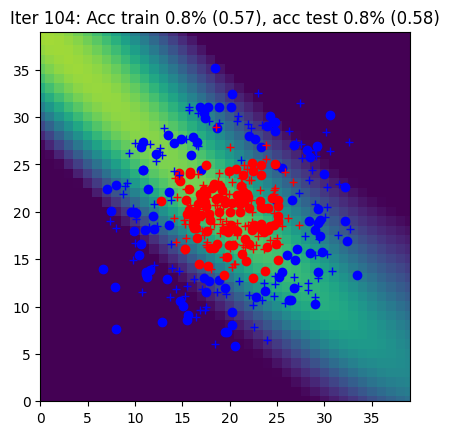

Iter 105: Acc train 0.8% (0.56), acc test 0.8% (0.58)


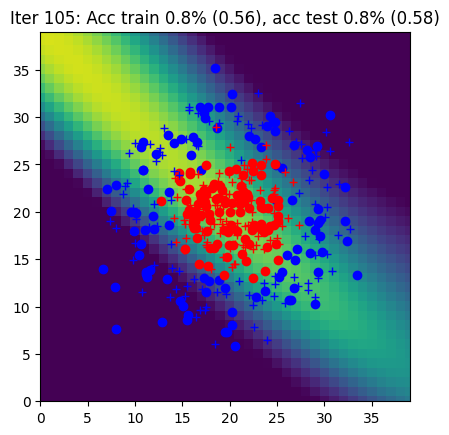

Iter 106: Acc train 0.8% (0.56), acc test 0.8% (0.57)


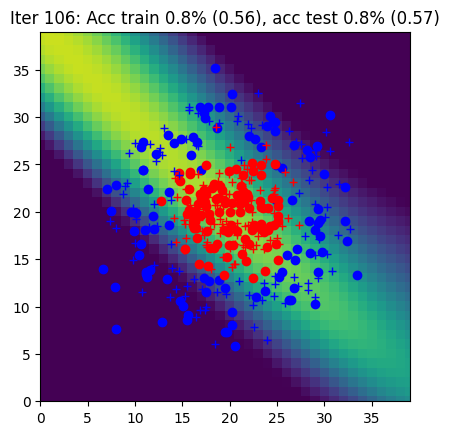

Iter 107: Acc train 0.8% (0.56), acc test 0.8% (0.58)


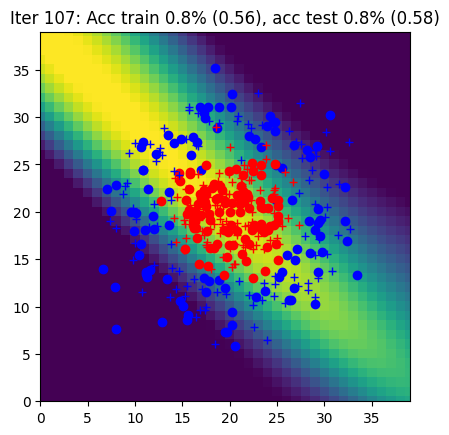

Iter 108: Acc train 0.8% (0.55), acc test 0.8% (0.57)


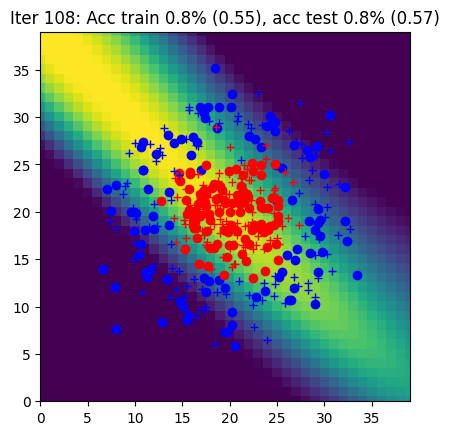

Iter 109: Acc train 0.8% (0.55), acc test 0.8% (0.57)


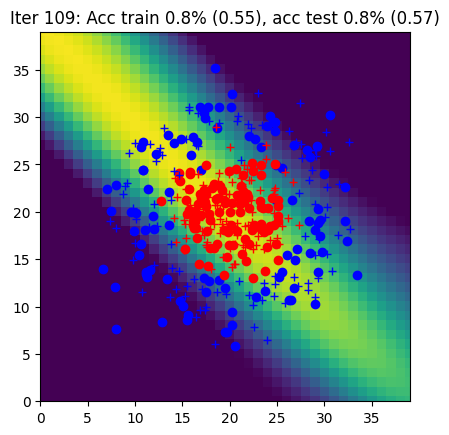

Iter 110: Acc train 0.8% (0.54), acc test 0.8% (0.56)


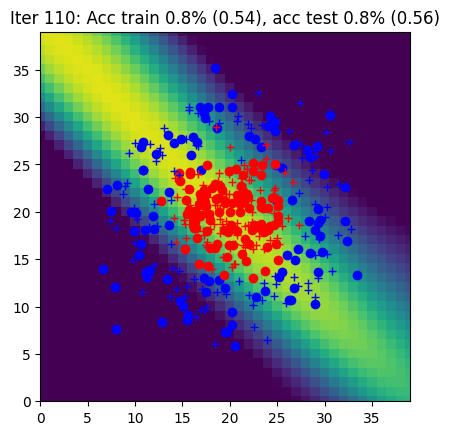

Iter 111: Acc train 0.8% (0.54), acc test 0.8% (0.56)


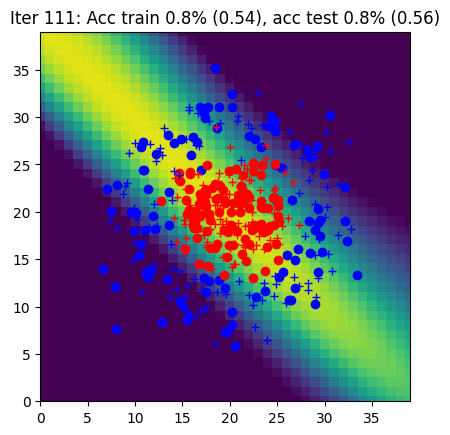

Iter 112: Acc train 0.8% (0.54), acc test 0.8% (0.56)


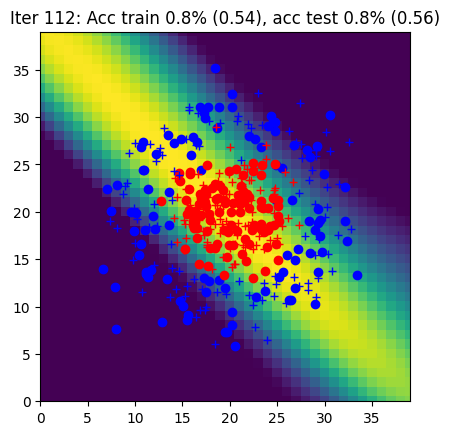

Iter 113: Acc train 0.8% (0.53), acc test 0.8% (0.56)


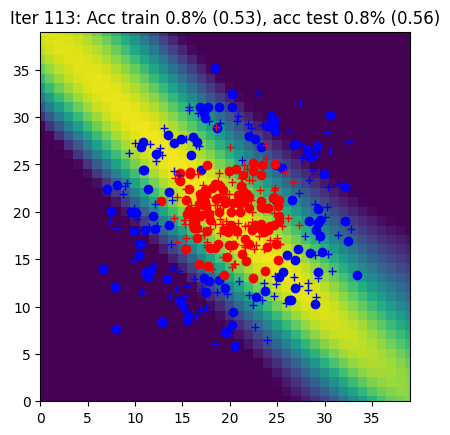

Iter 114: Acc train 0.8% (0.53), acc test 0.8% (0.56)


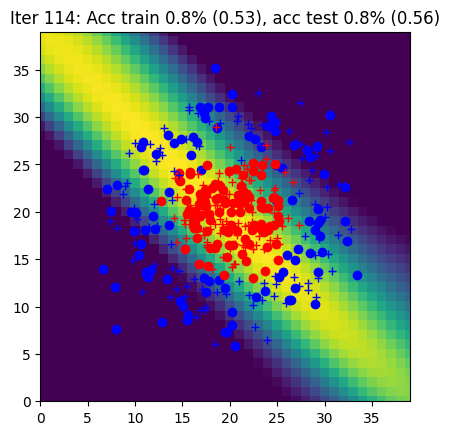

Iter 115: Acc train 0.8% (0.53), acc test 0.8% (0.55)


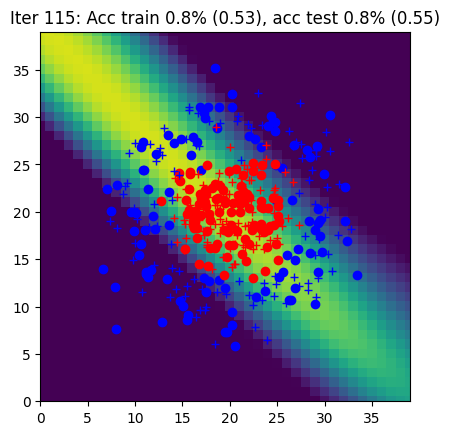

Iter 116: Acc train 0.8% (0.52), acc test 0.8% (0.55)


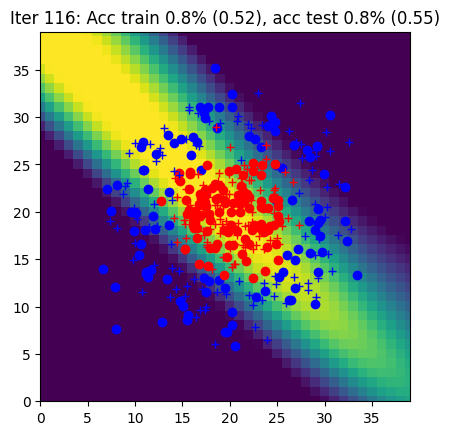

Iter 117: Acc train 0.8% (0.52), acc test 0.8% (0.54)


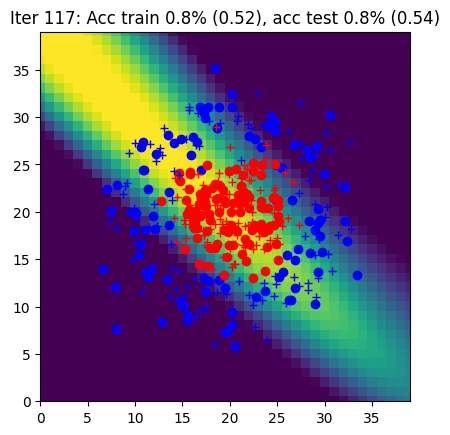

Iter 118: Acc train 0.8% (0.52), acc test 0.8% (0.55)


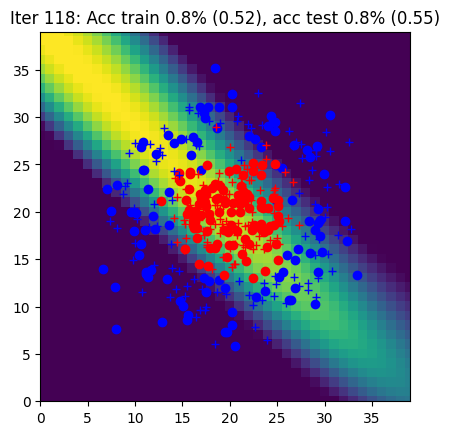

Iter 119: Acc train 0.8% (0.51), acc test 0.8% (0.54)


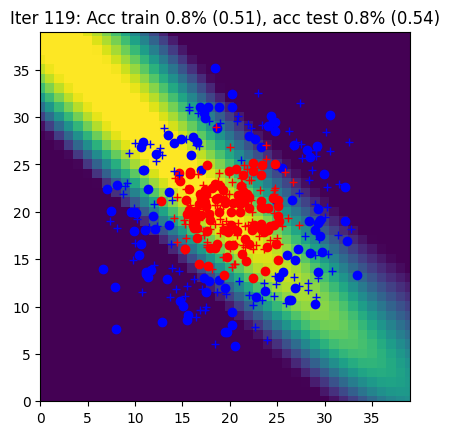

Iter 120: Acc train 0.8% (0.51), acc test 0.8% (0.54)


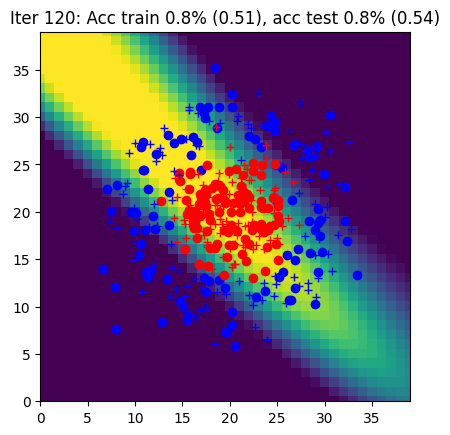

Iter 121: Acc train 0.8% (0.51), acc test 0.8% (0.54)


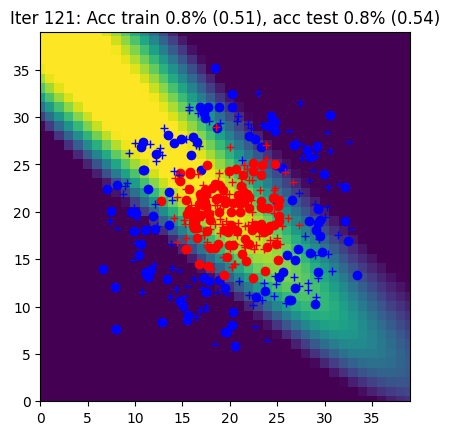

Iter 122: Acc train 0.8% (0.51), acc test 0.8% (0.53)


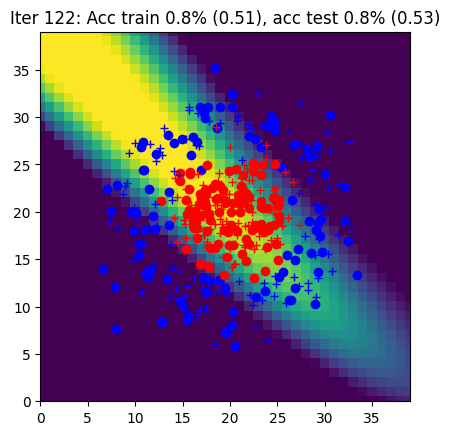

Iter 123: Acc train 0.8% (0.50), acc test 0.8% (0.53)


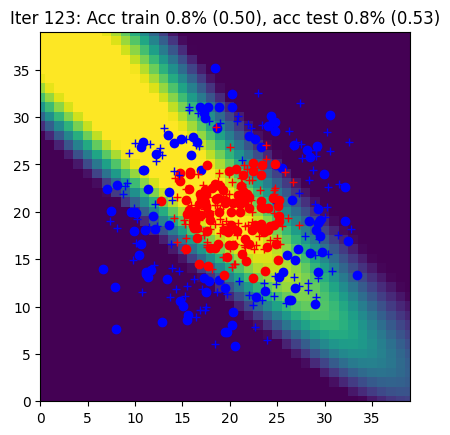

Iter 124: Acc train 0.8% (0.50), acc test 0.8% (0.53)


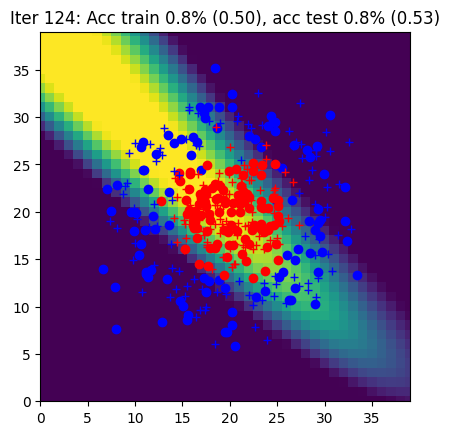

Iter 125: Acc train 0.8% (0.50), acc test 0.8% (0.53)


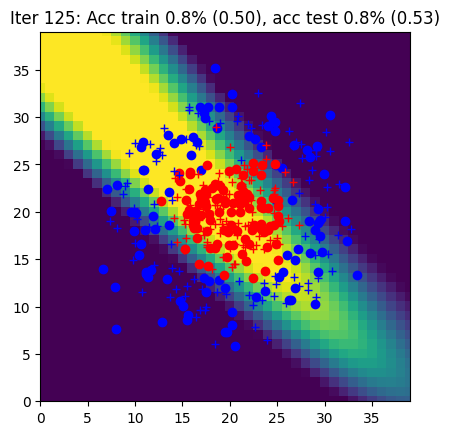

Iter 126: Acc train 0.8% (0.50), acc test 0.7% (0.53)


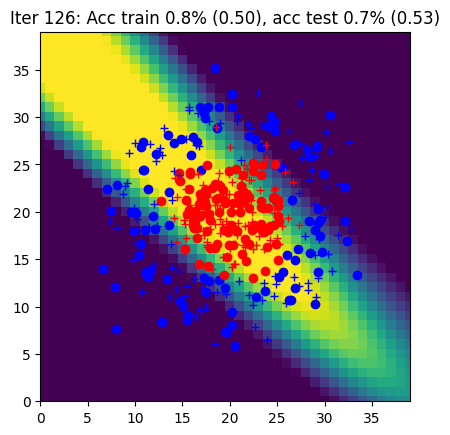

Iter 127: Acc train 0.8% (0.50), acc test 0.8% (0.53)


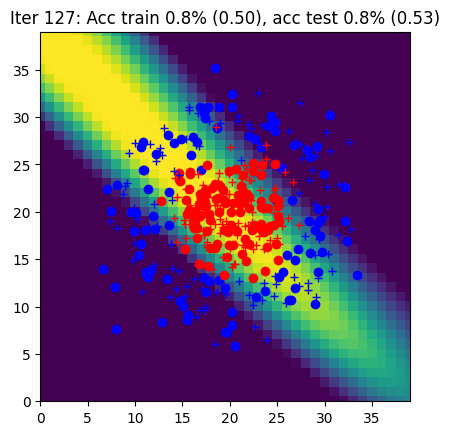

Iter 128: Acc train 0.8% (0.49), acc test 0.8% (0.53)


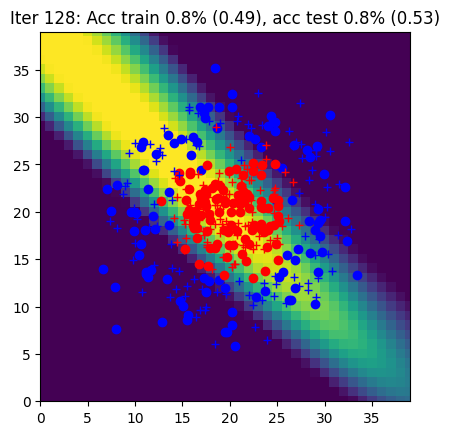

Iter 129: Acc train 0.8% (0.49), acc test 0.8% (0.52)


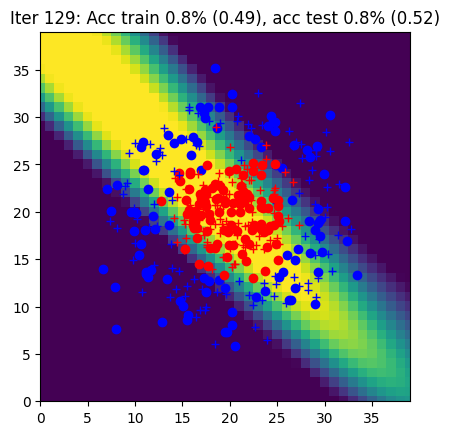

Iter 130: Acc train 0.8% (0.49), acc test 0.8% (0.52)


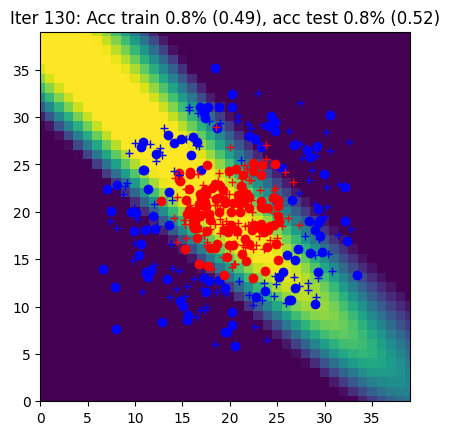

Iter 131: Acc train 0.8% (0.49), acc test 0.8% (0.52)


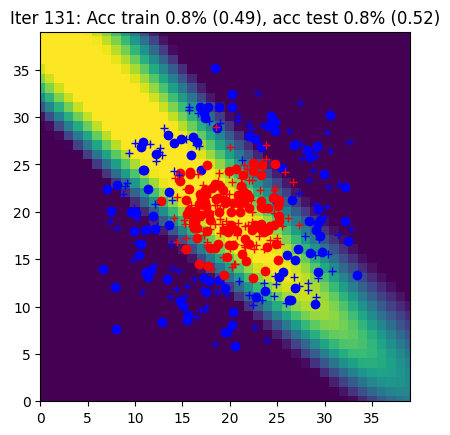

Iter 132: Acc train 0.8% (0.48), acc test 0.8% (0.52)


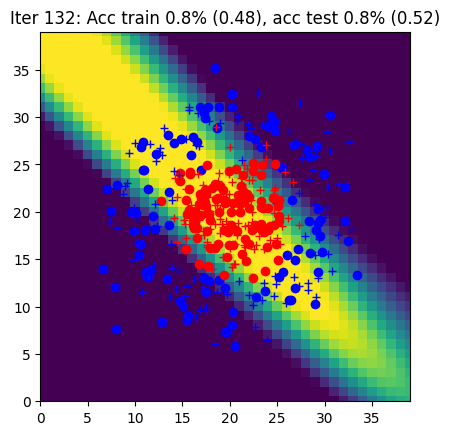

Iter 133: Acc train 0.8% (0.48), acc test 0.8% (0.52)


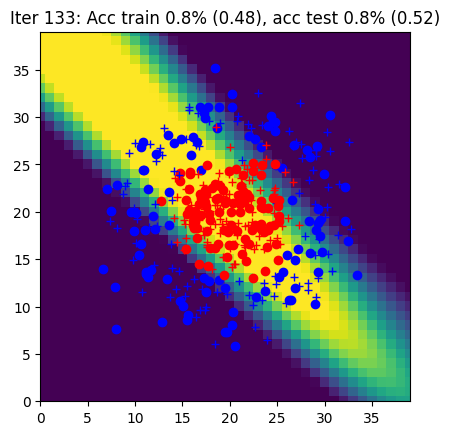

Iter 134: Acc train 0.8% (0.48), acc test 0.7% (0.52)


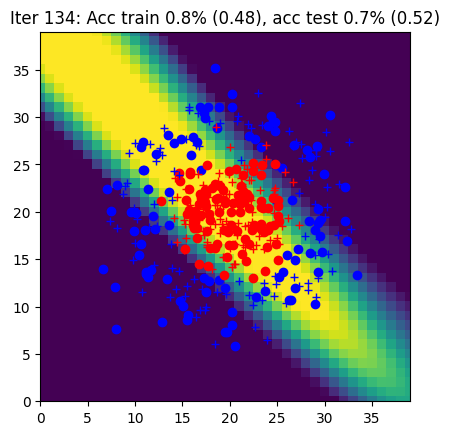

Iter 135: Acc train 0.8% (0.48), acc test 0.8% (0.51)


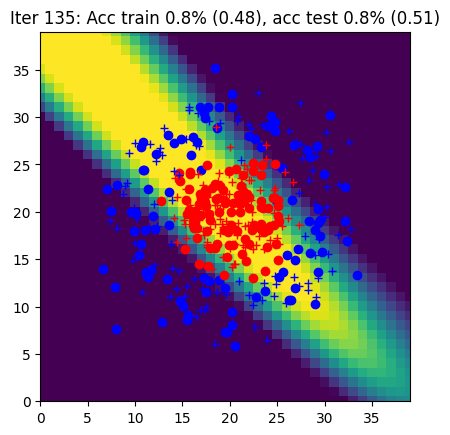

Iter 136: Acc train 0.8% (0.48), acc test 0.8% (0.52)


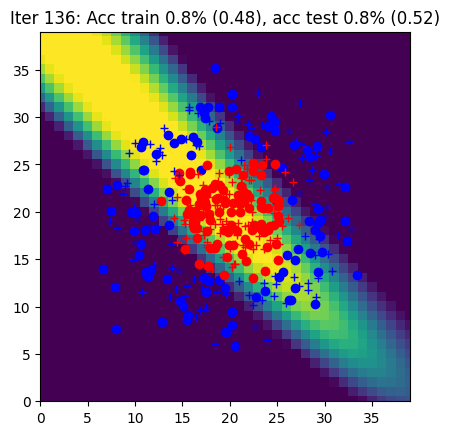

Iter 137: Acc train 0.8% (0.48), acc test 0.8% (0.51)


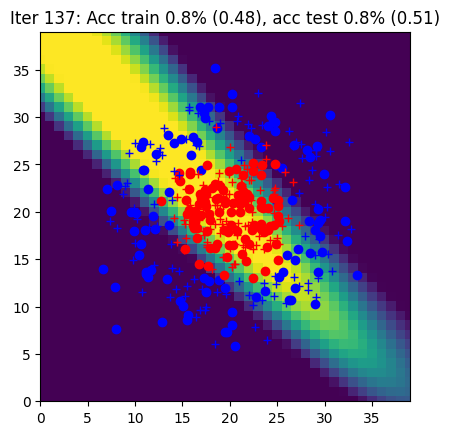

Iter 138: Acc train 0.8% (0.48), acc test 0.8% (0.51)


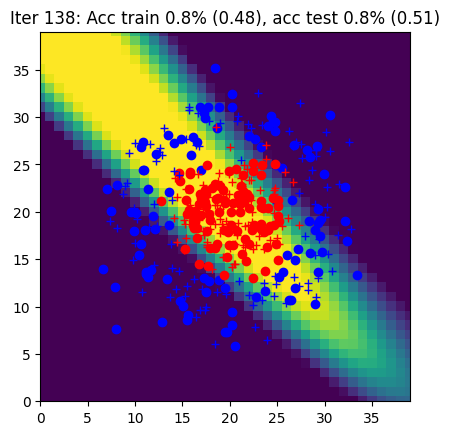

Iter 139: Acc train 0.8% (0.47), acc test 0.8% (0.51)


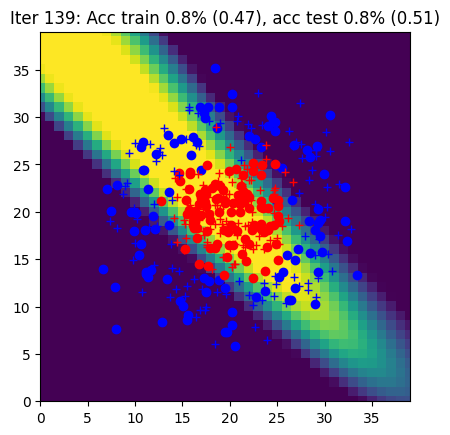

Iter 140: Acc train 0.8% (0.47), acc test 0.8% (0.51)


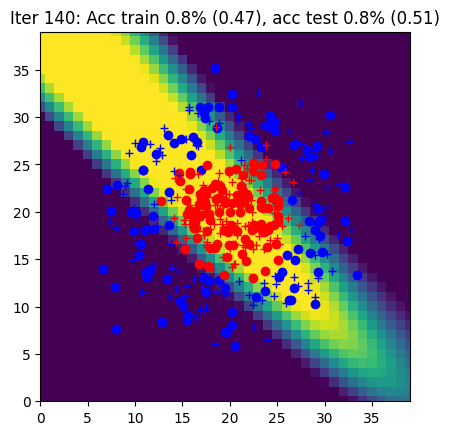

Iter 141: Acc train 0.8% (0.47), acc test 0.8% (0.51)


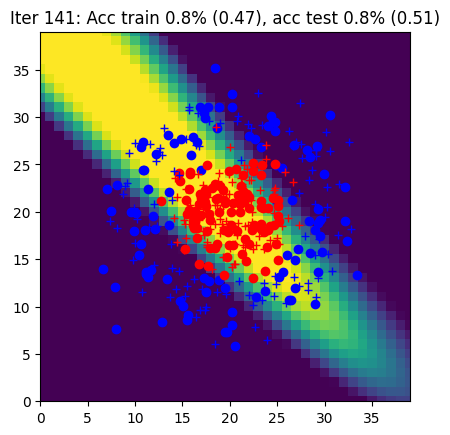

Iter 142: Acc train 0.8% (0.47), acc test 0.8% (0.51)


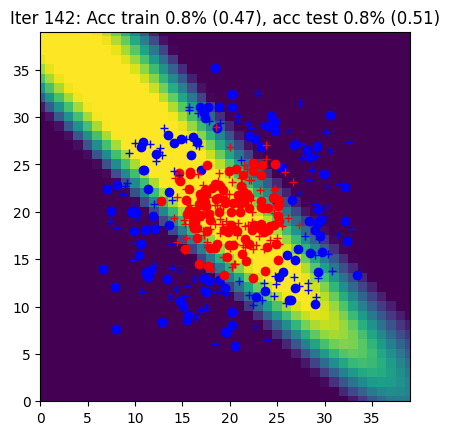

Iter 143: Acc train 0.8% (0.47), acc test 0.8% (0.51)


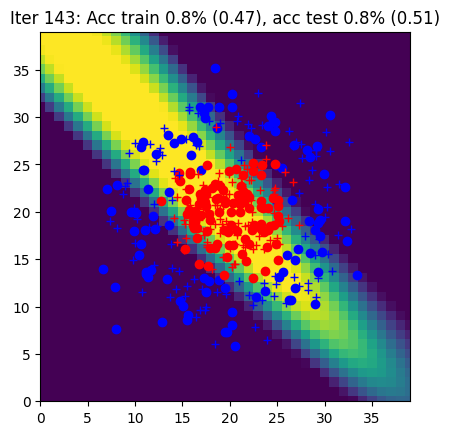

Iter 144: Acc train 0.8% (0.47), acc test 0.8% (0.51)


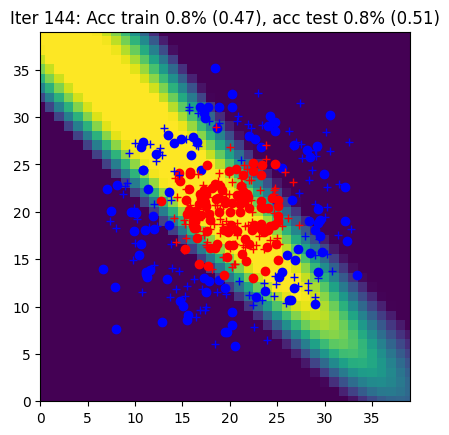

Iter 145: Acc train 0.8% (0.46), acc test 0.7% (0.51)


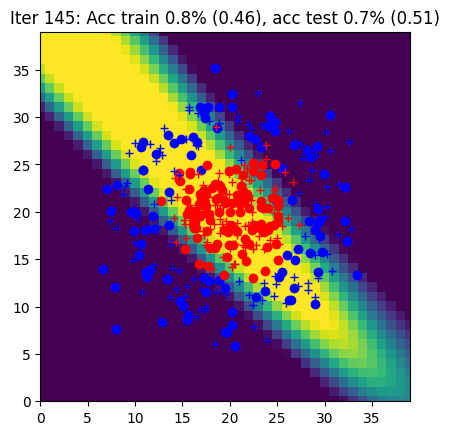

Iter 146: Acc train 0.8% (0.46), acc test 0.8% (0.51)


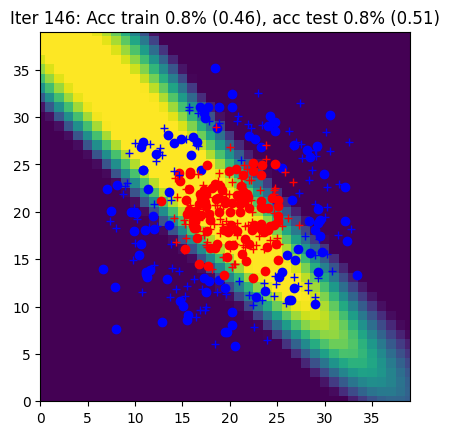

Iter 147: Acc train 0.8% (0.46), acc test 0.8% (0.51)


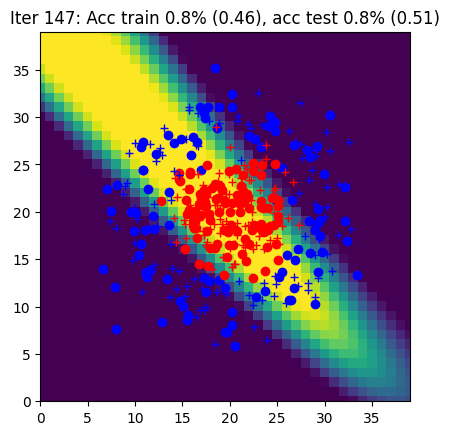

Iter 148: Acc train 0.8% (0.46), acc test 0.7% (0.51)


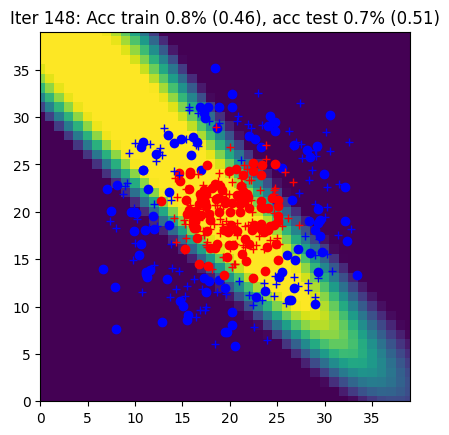

Iter 149: Acc train 0.8% (0.46), acc test 0.8% (0.51)


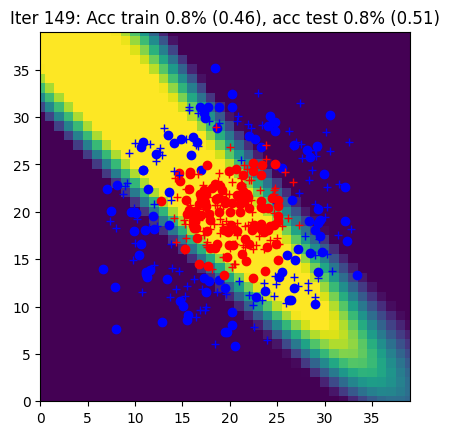

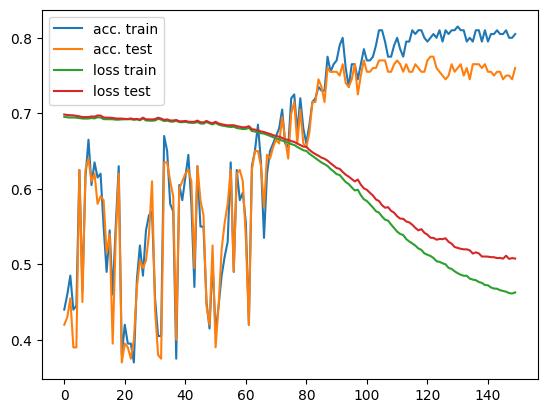

In [14]:
# init


data = CirclesData()
data.plot_data()
N = data.Xtrain.shape[0]
nx = data.Xtrain.shape[1]
nh = 10
ny = data.Ytrain.shape[1]
num_epochs = 150
Nbatch=128
eta=0.005
train_model(data, nx, nh, ny, num_epochs, Nbatch, eta)

### Experiment Analysis: Effects of Batch Size and Learning Rate

We explored three different configurations of batch size (`Nbatch`) and learning rate (`eta`) to observe their impact on training dynamics and model performance. Below is a summary of each setup's behavior:

---

#### Configuration 1: **(Nbatch=128, eta=0.005)**
- **Training Dynamics**: This setup had a slow but steady convergence due to the smaller learning rate. Both training and test accuracies improved gradually over time.
- **Effect of Large Batch Size**: With a batch size of 128, gradient updates were stable, resulting in a smooth learning curve but slower progress.
- **Final Performance**: The model reached moderate accuracy with stable loss values, but the training process was slow.

---

#### Configuration 2: **(Nbatch=64, eta=0.01)**
- **Training Dynamics**: This configuration showed faster convergence. Accuracy quickly reached high values for both training and test sets, and loss decreased consistently.
- **Effect of Moderate Batch Size**: A batch size of 64 offered a balance between stability and responsiveness, allowing for more frequent updates while maintaining gradient stability.
- **Final Performance**: Achieved high accuracy with faster convergence compared to Configuration 1, making it a more efficient choice.

---

#### Configuration 3: **(Nbatch=32, eta=0.01)**
- **Training Dynamics**: This setup had the fastest convergence, with high training and test accuracies reached within the first 20 epochs. Both training and test loss stabilized at low values early on.
- **Effect of Small Batch Size**: A batch size of 32 allowed for very frequent updates, which accelerated learning and introduced beneficial noise, helping avoid shallow local minima.
- **Final Performance**: This configuration achieved the best overall performance, with high accuracy and minimal loss fluctuations, making it the most effective and efficient setup.

# Part 2 : Simplification of the backward pass with `torch.autograd`


The function `forward` remains unchanged from previous part.

The function `backward` is no longer used because of "autograd".

In [ ]:
def sgd(params, eta):

    #####################
    ## Your code here  ##
    #####################
    # update the network weights
    # warning: use torch.no_grad()
    # and reset to zero the gradient accumulators
    with torch.no_grad():
      params["Wh"] -= eta * params["Wh"].grad
      params["Wy"] -= eta * params["Wy"].grad
      params["bh"] -= eta * params["bh"].grad
      params["by"] -= eta * params["by"].grad

      params['Wh'].grad.zero_()
      params['Wy'].grad.zero_()
      params['bh'].grad.zero_()
      params['by'].grad.zero_()

    ####################
    ##      END        #
    ####################
    return params

## Global learning procedure with autograd

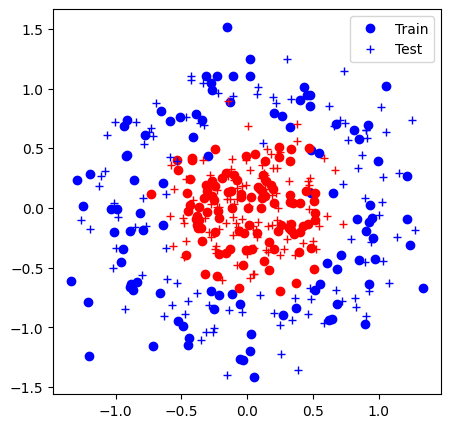

Iter 0: Acc train 0.6% (1.15), acc test 0.6% (1.15)


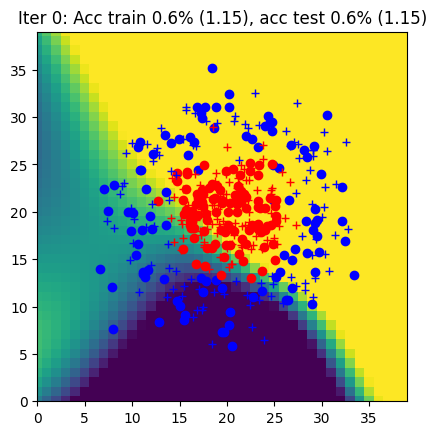

Iter 1: Acc train 0.6% (0.90), acc test 0.6% (0.90)


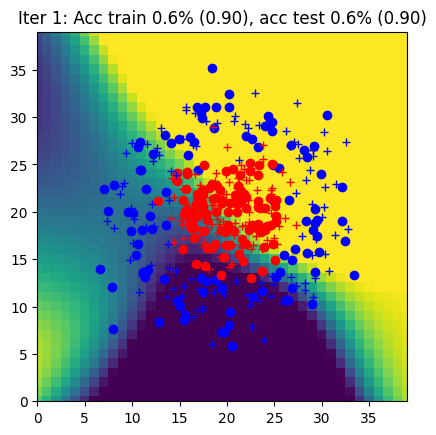

Iter 2: Acc train 0.5% (0.81), acc test 0.6% (0.80)


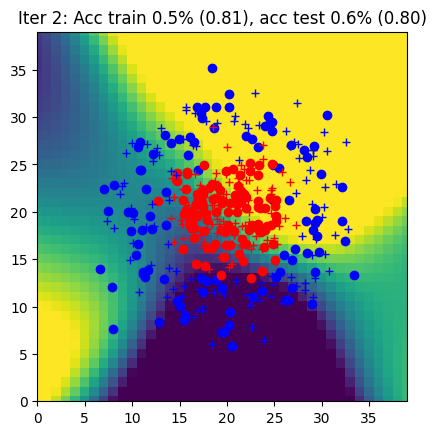

Iter 3: Acc train 0.5% (0.75), acc test 0.6% (0.74)


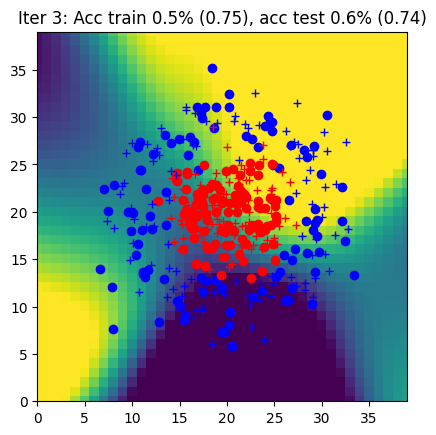

Iter 4: Acc train 0.5% (0.72), acc test 0.6% (0.70)


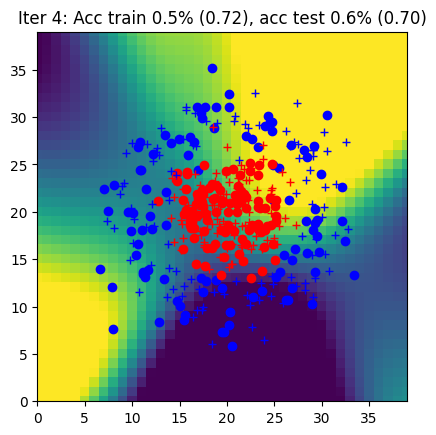

Iter 5: Acc train 0.6% (0.69), acc test 0.7% (0.68)


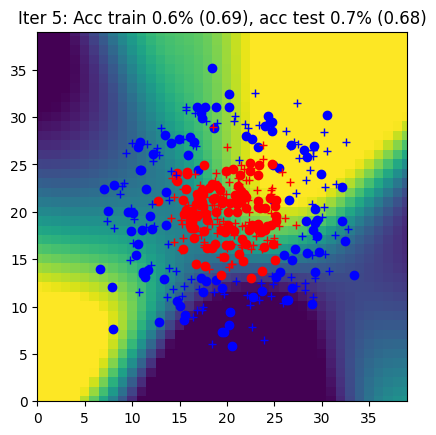

Iter 6: Acc train 0.7% (0.67), acc test 0.7% (0.65)


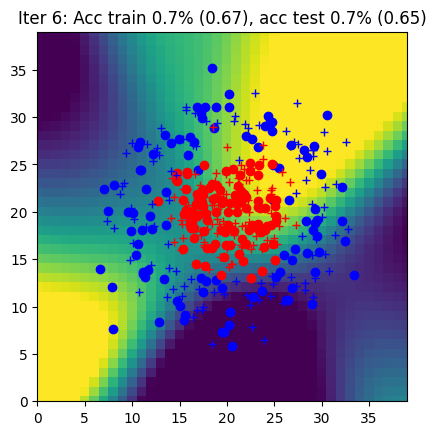

Iter 7: Acc train 0.7% (0.65), acc test 0.8% (0.63)


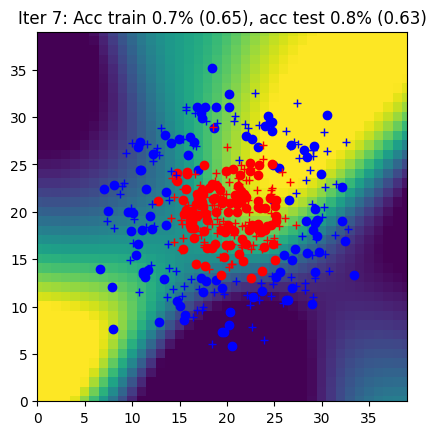

Iter 8: Acc train 0.7% (0.63), acc test 0.8% (0.61)


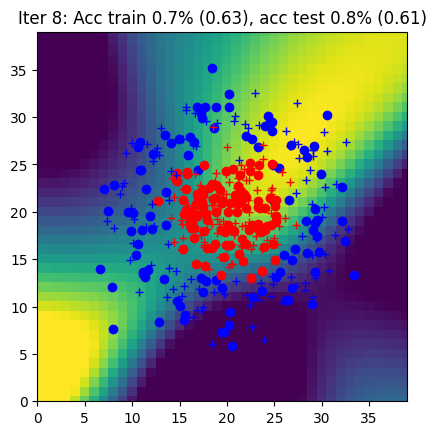

Iter 9: Acc train 0.7% (0.61), acc test 0.8% (0.60)


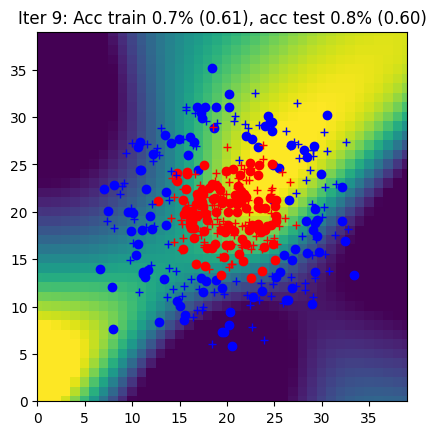

Iter 10: Acc train 0.8% (0.59), acc test 0.8% (0.58)


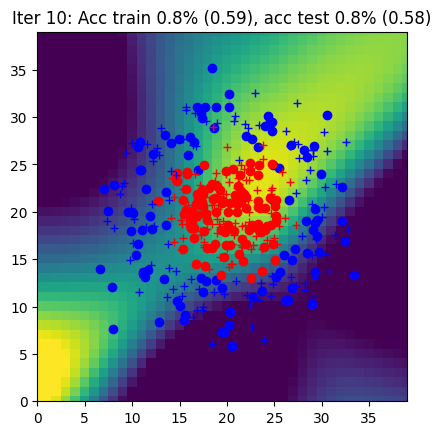

Iter 11: Acc train 0.8% (0.58), acc test 0.8% (0.57)


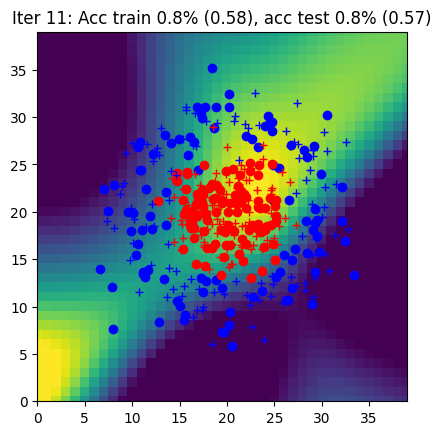

Iter 12: Acc train 0.8% (0.57), acc test 0.8% (0.55)


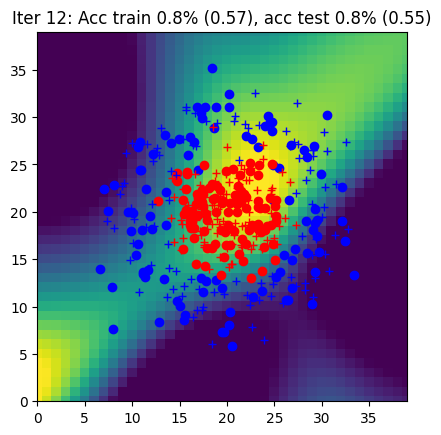

Iter 13: Acc train 0.8% (0.55), acc test 0.8% (0.54)


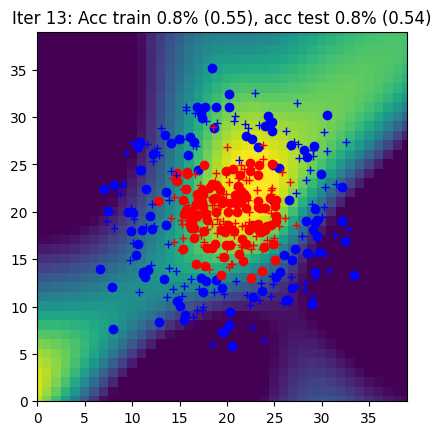

Iter 14: Acc train 0.8% (0.54), acc test 0.8% (0.53)


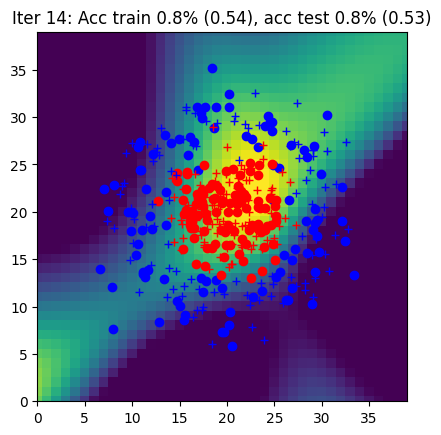

Iter 15: Acc train 0.8% (0.53), acc test 0.8% (0.52)


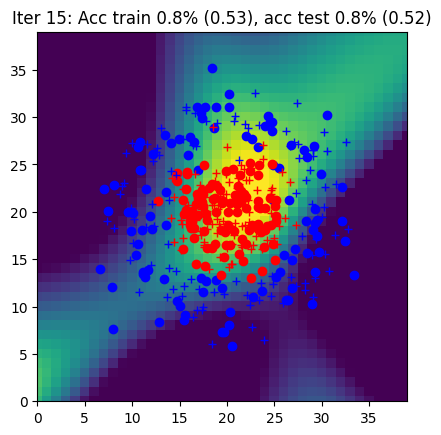

Iter 16: Acc train 0.8% (0.52), acc test 0.8% (0.50)


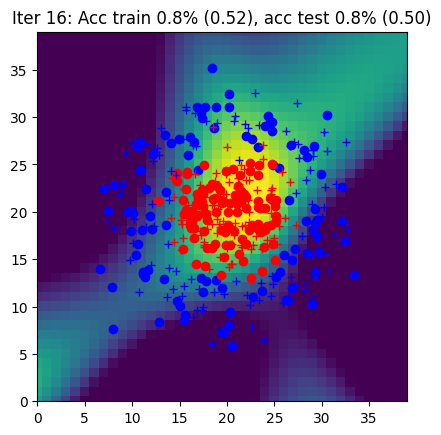

Iter 17: Acc train 0.8% (0.51), acc test 0.8% (0.49)


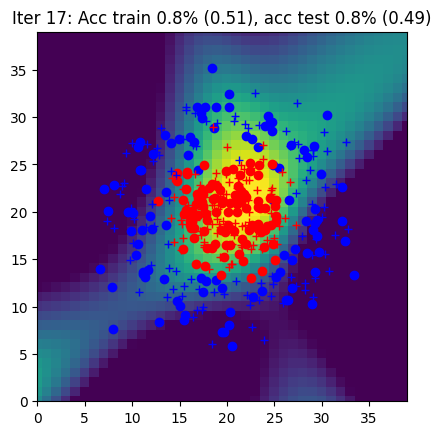

Iter 18: Acc train 0.8% (0.50), acc test 0.8% (0.48)


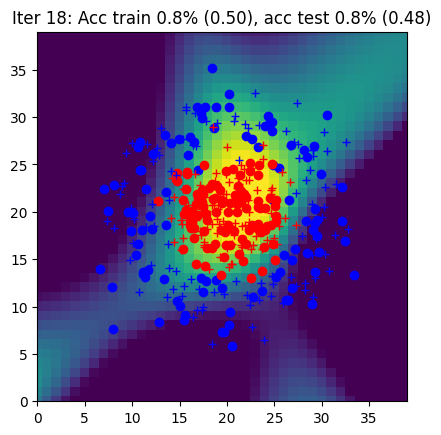

Iter 19: Acc train 0.8% (0.49), acc test 0.9% (0.47)


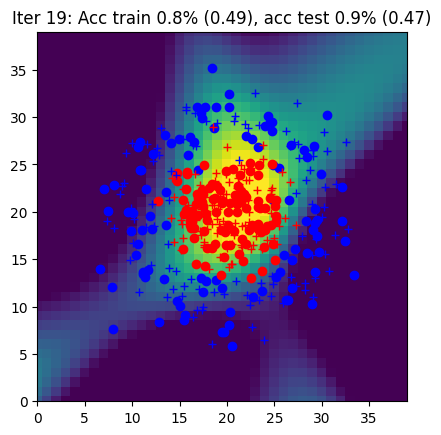

Iter 20: Acc train 0.8% (0.48), acc test 0.9% (0.47)


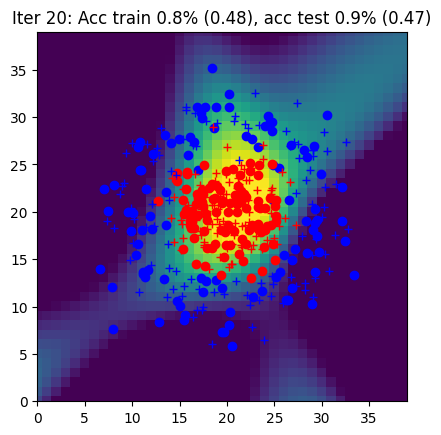

Iter 21: Acc train 0.8% (0.47), acc test 0.9% (0.46)


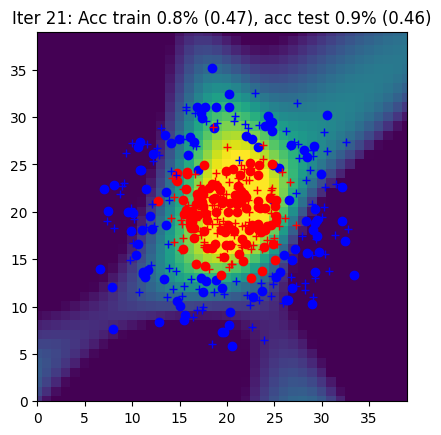

Iter 22: Acc train 0.8% (0.46), acc test 0.9% (0.45)


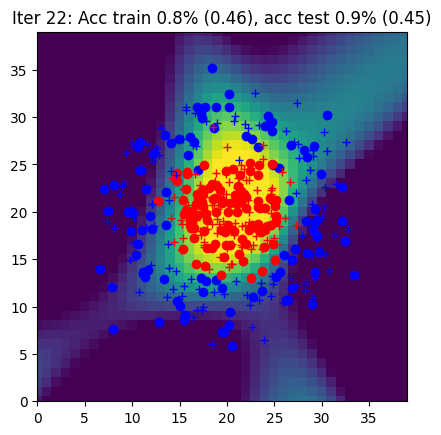

Iter 23: Acc train 0.9% (0.45), acc test 0.9% (0.44)


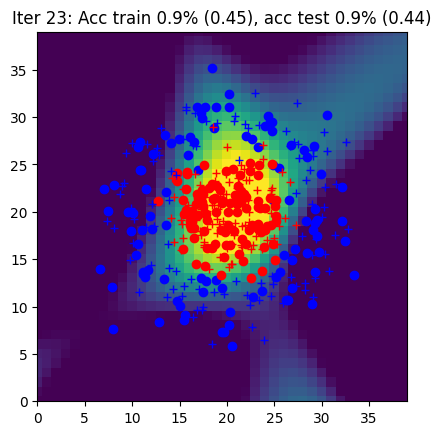

Iter 24: Acc train 0.9% (0.44), acc test 0.9% (0.43)


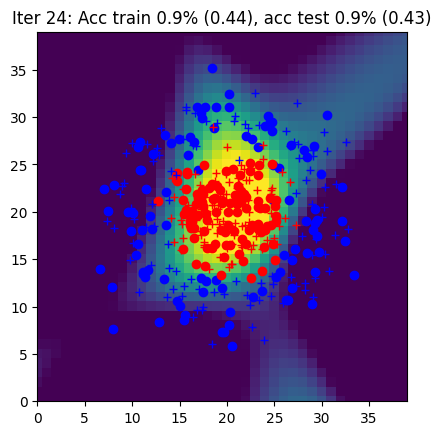

Iter 25: Acc train 0.9% (0.43), acc test 0.9% (0.43)


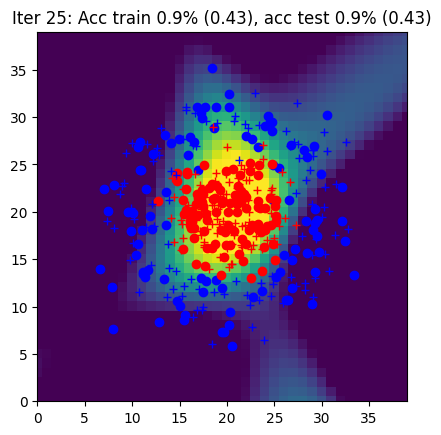

Iter 26: Acc train 0.9% (0.42), acc test 0.9% (0.42)


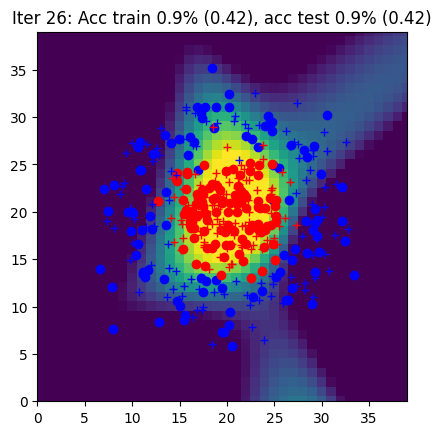

Iter 27: Acc train 0.9% (0.42), acc test 0.9% (0.41)


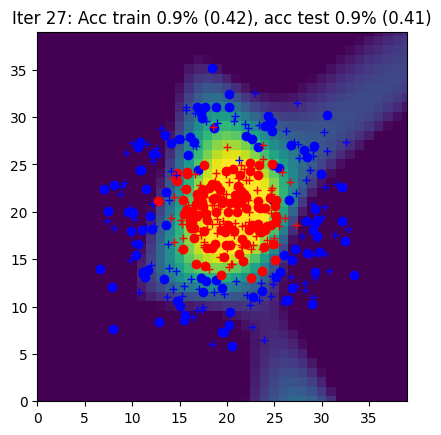

Iter 28: Acc train 0.9% (0.41), acc test 0.9% (0.41)


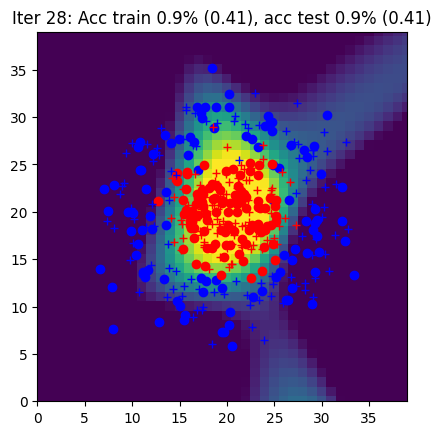

Iter 29: Acc train 0.9% (0.40), acc test 0.9% (0.40)


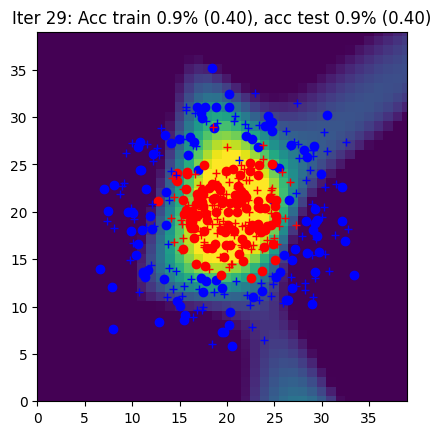

Iter 30: Acc train 0.9% (0.39), acc test 0.9% (0.39)


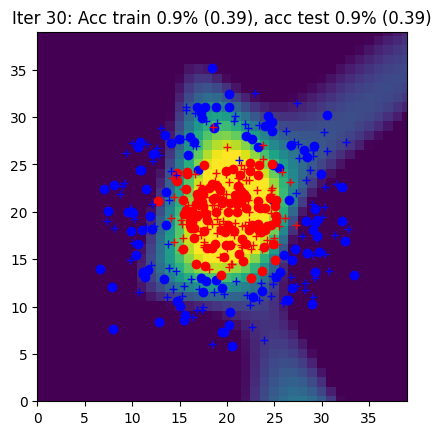

Iter 31: Acc train 0.9% (0.39), acc test 0.9% (0.39)


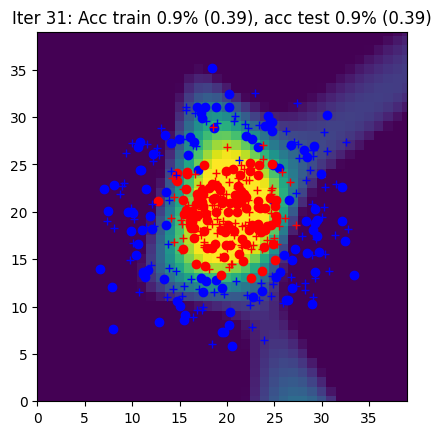

Iter 32: Acc train 0.9% (0.38), acc test 0.9% (0.38)


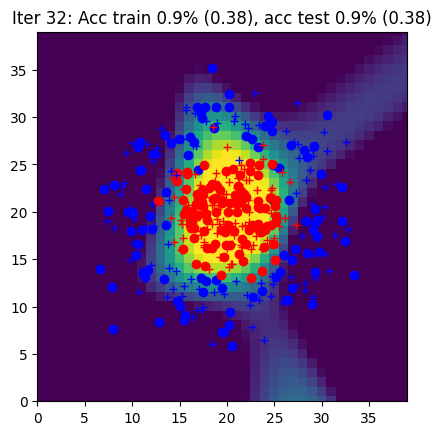

Iter 33: Acc train 0.9% (0.37), acc test 0.9% (0.38)


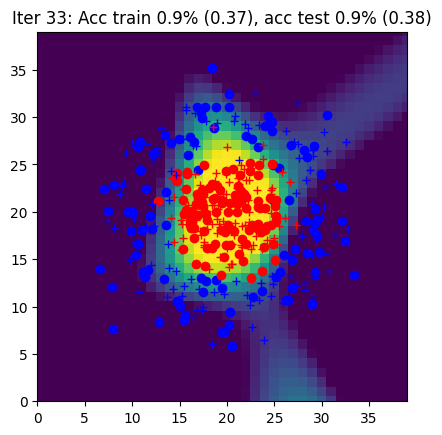

Iter 34: Acc train 0.9% (0.37), acc test 0.9% (0.37)


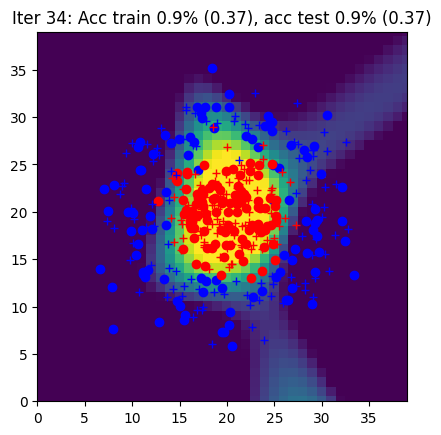

Iter 35: Acc train 0.9% (0.36), acc test 0.9% (0.37)


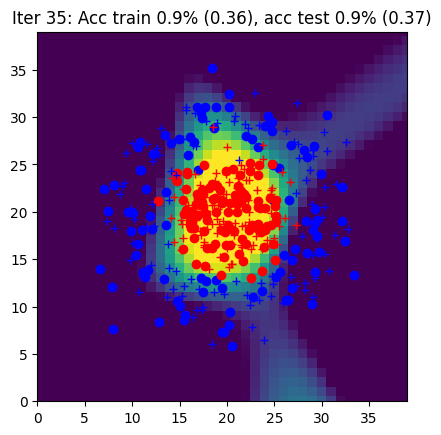

Iter 36: Acc train 0.9% (0.36), acc test 0.9% (0.36)


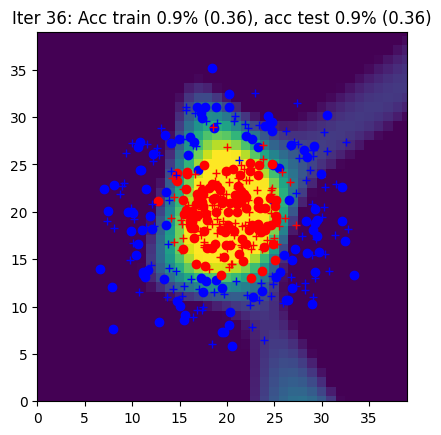

Iter 37: Acc train 0.9% (0.35), acc test 0.9% (0.36)


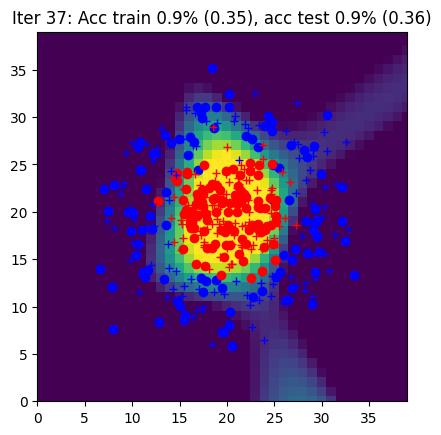

Iter 38: Acc train 0.9% (0.35), acc test 0.9% (0.35)


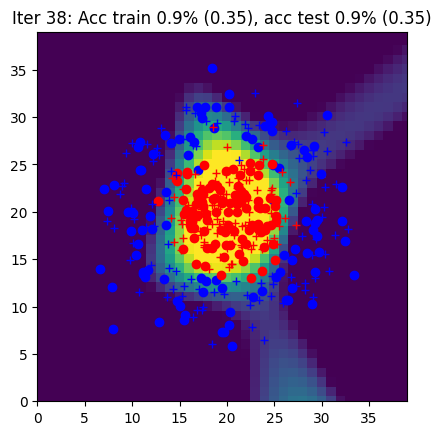

Iter 39: Acc train 0.9% (0.34), acc test 0.9% (0.35)


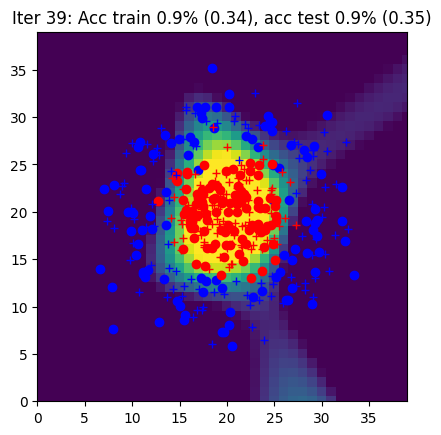

Iter 40: Acc train 0.9% (0.34), acc test 0.9% (0.34)


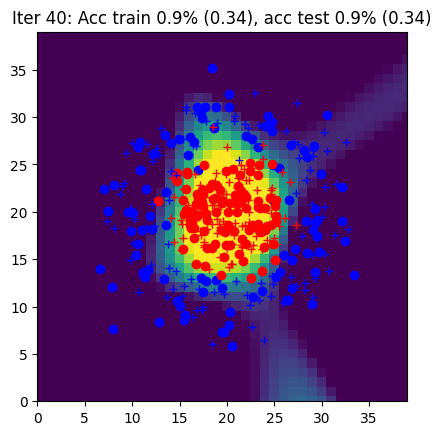

Iter 41: Acc train 0.9% (0.33), acc test 0.9% (0.34)


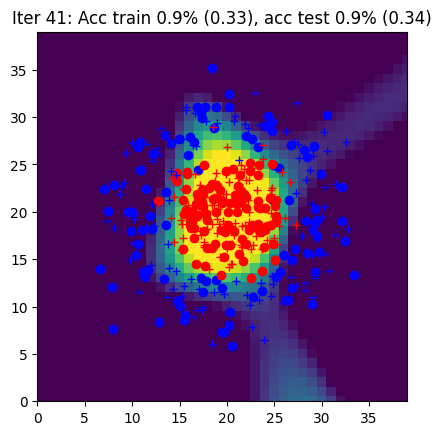

Iter 42: Acc train 0.9% (0.33), acc test 0.9% (0.33)


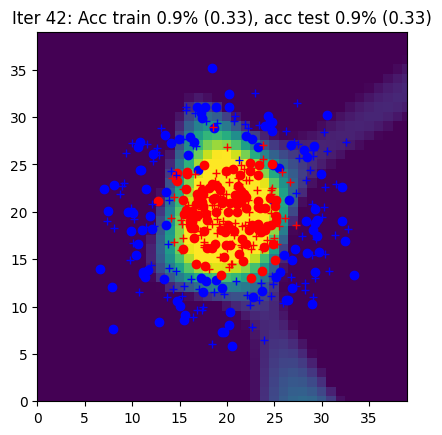

Iter 43: Acc train 0.9% (0.32), acc test 0.9% (0.33)


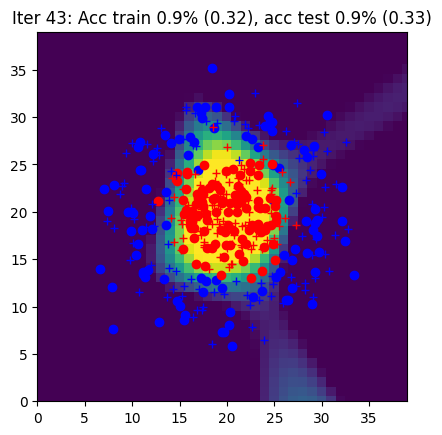

Iter 44: Acc train 0.9% (0.32), acc test 0.9% (0.33)


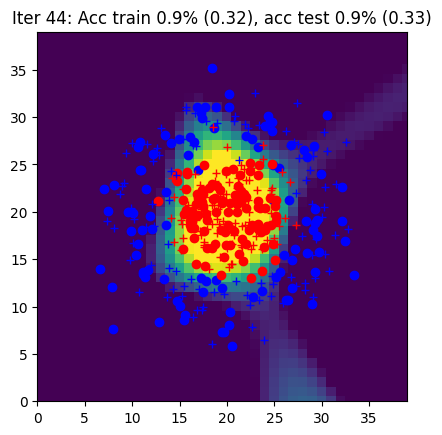

Iter 45: Acc train 0.9% (0.31), acc test 0.9% (0.32)


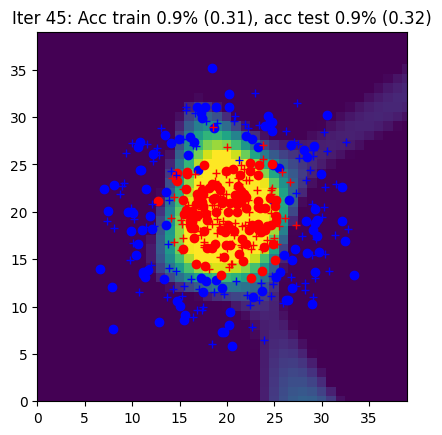

Iter 46: Acc train 0.9% (0.31), acc test 0.9% (0.32)


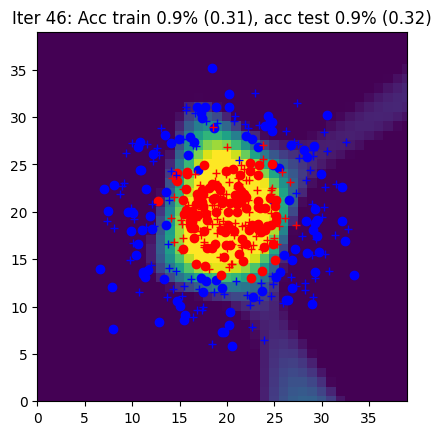

Iter 47: Acc train 0.9% (0.30), acc test 0.9% (0.31)


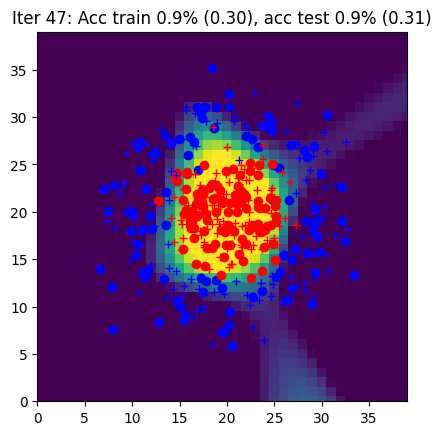

Iter 48: Acc train 0.9% (0.30), acc test 0.9% (0.31)


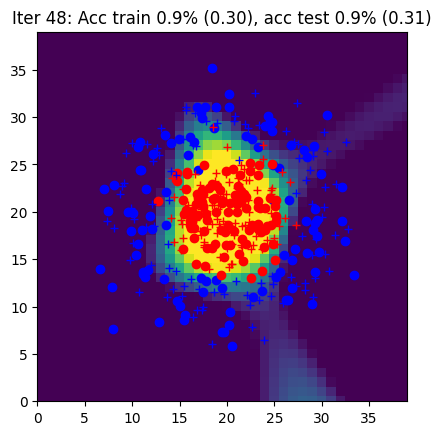

Iter 49: Acc train 0.9% (0.30), acc test 0.9% (0.31)


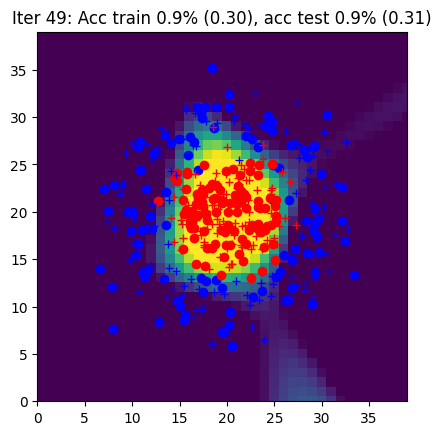

Iter 50: Acc train 0.9% (0.29), acc test 0.9% (0.30)


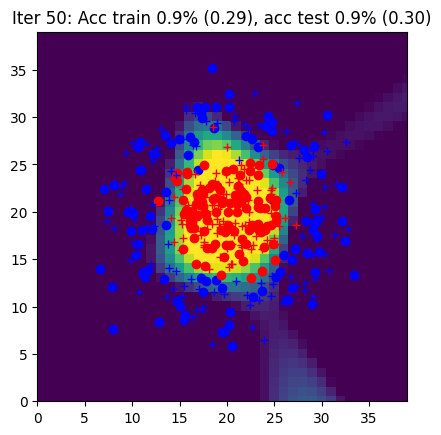

Iter 51: Acc train 0.9% (0.29), acc test 0.9% (0.30)


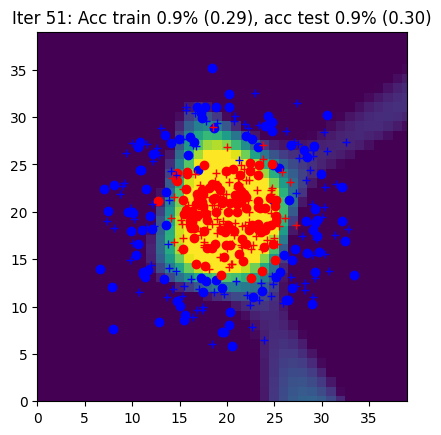

Iter 52: Acc train 0.9% (0.28), acc test 0.9% (0.30)


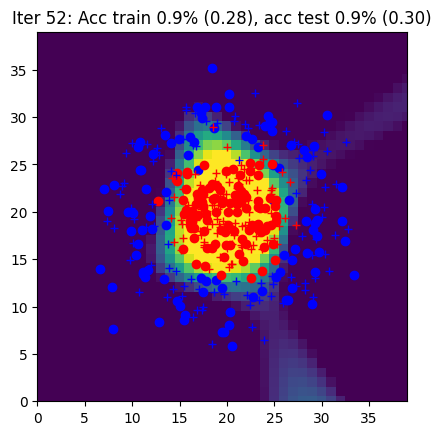

Iter 53: Acc train 0.9% (0.28), acc test 0.9% (0.29)


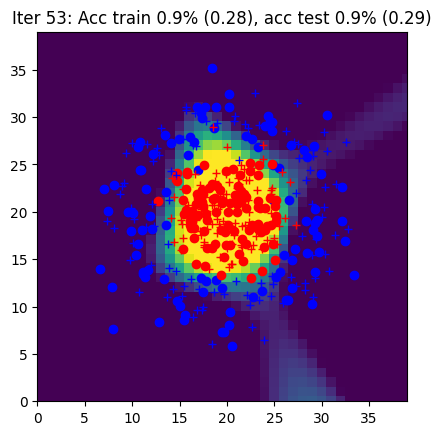

Iter 54: Acc train 0.9% (0.28), acc test 0.9% (0.29)


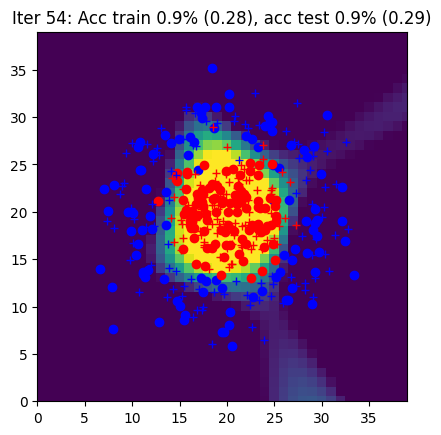

Iter 55: Acc train 0.9% (0.28), acc test 0.9% (0.29)


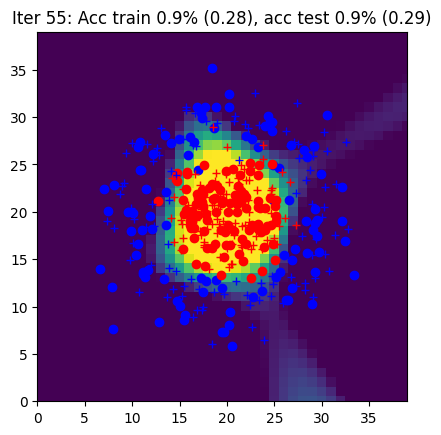

Iter 56: Acc train 0.9% (0.27), acc test 0.9% (0.28)


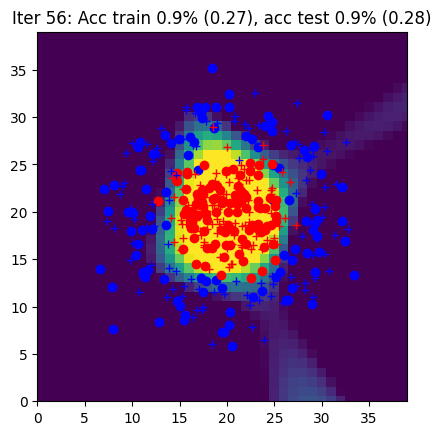

Iter 57: Acc train 0.9% (0.27), acc test 0.9% (0.28)


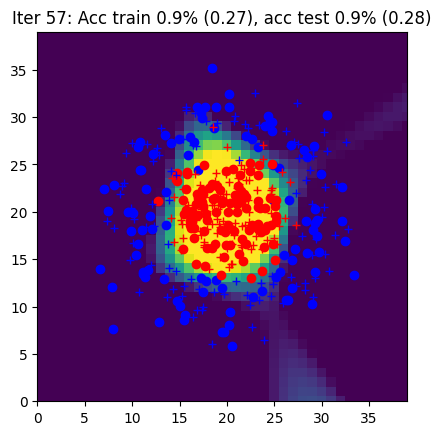

Iter 58: Acc train 0.9% (0.27), acc test 0.9% (0.28)


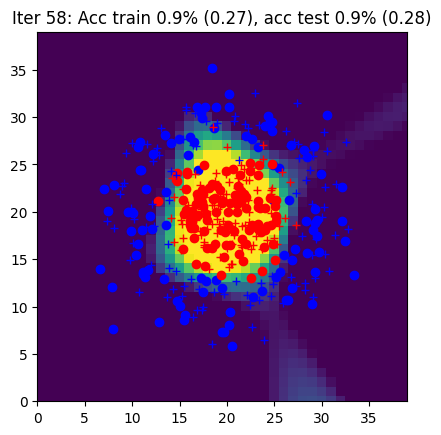

Iter 59: Acc train 0.9% (0.26), acc test 0.9% (0.28)


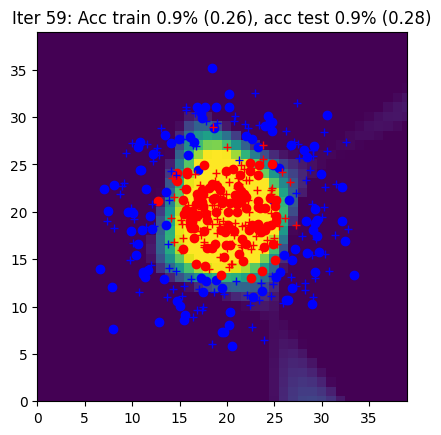

Iter 60: Acc train 0.9% (0.26), acc test 0.9% (0.27)


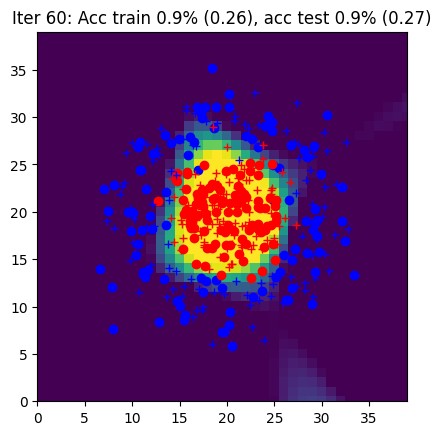

Iter 61: Acc train 0.9% (0.26), acc test 0.9% (0.27)


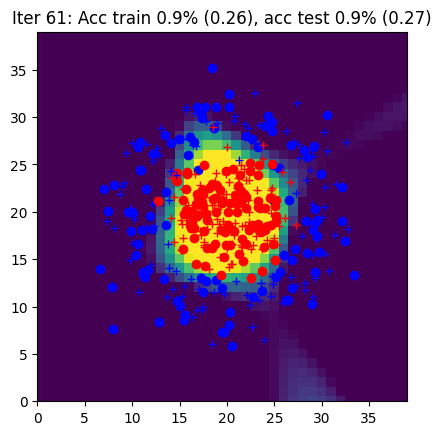

Iter 62: Acc train 0.9% (0.26), acc test 0.9% (0.27)


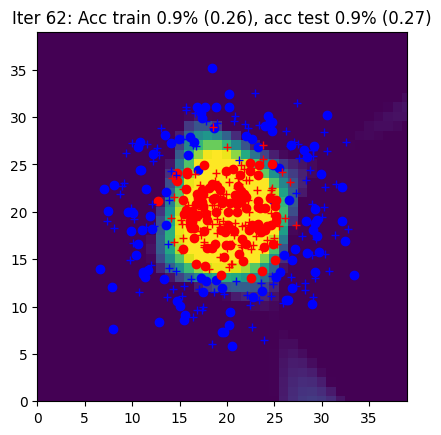

Iter 63: Acc train 0.9% (0.25), acc test 0.9% (0.27)


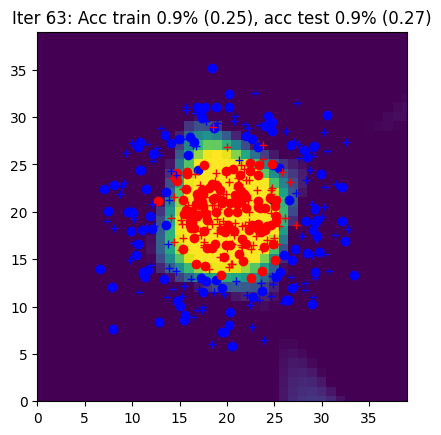

Iter 64: Acc train 1.0% (0.25), acc test 0.9% (0.26)


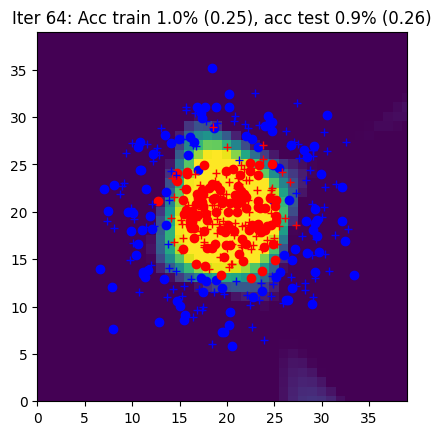

Iter 65: Acc train 0.9% (0.25), acc test 0.9% (0.26)


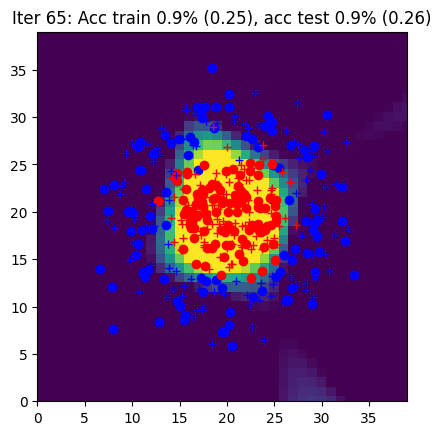

Iter 66: Acc train 1.0% (0.25), acc test 0.9% (0.26)


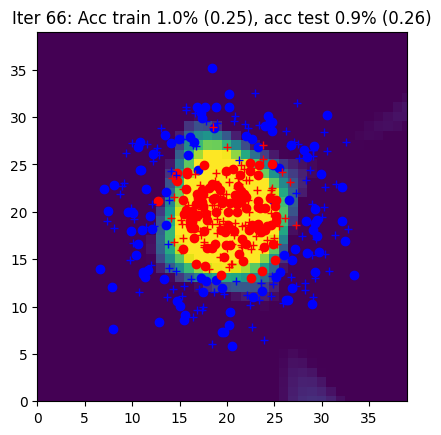

Iter 67: Acc train 0.9% (0.24), acc test 0.9% (0.26)


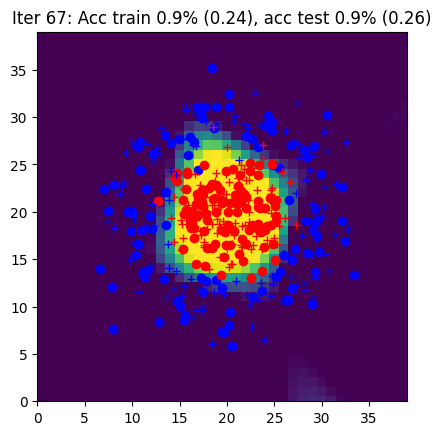

Iter 68: Acc train 1.0% (0.24), acc test 0.9% (0.26)


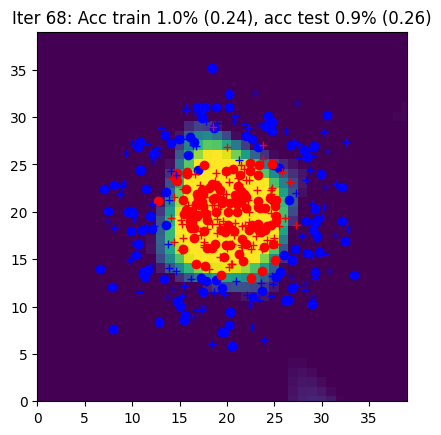

Iter 69: Acc train 0.9% (0.24), acc test 0.9% (0.25)


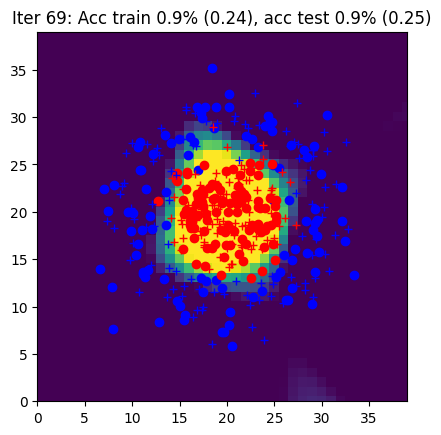

Iter 70: Acc train 1.0% (0.24), acc test 0.9% (0.25)


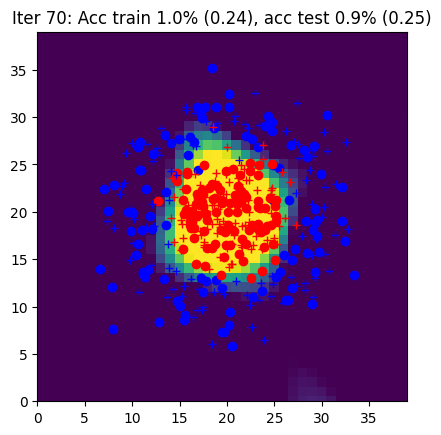

Iter 71: Acc train 1.0% (0.24), acc test 0.9% (0.25)


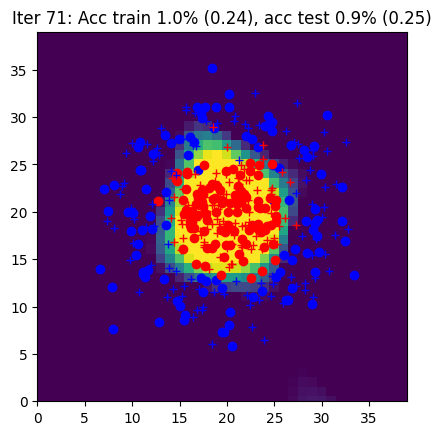

Iter 72: Acc train 0.9% (0.23), acc test 0.9% (0.25)


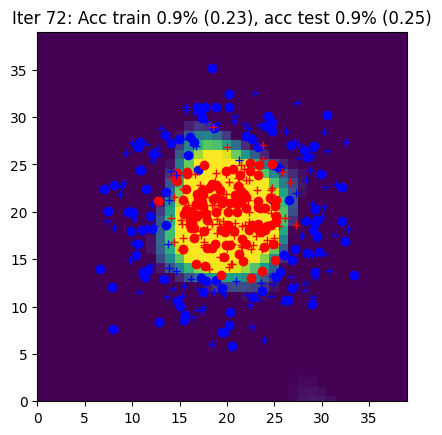

Iter 73: Acc train 1.0% (0.23), acc test 0.9% (0.25)


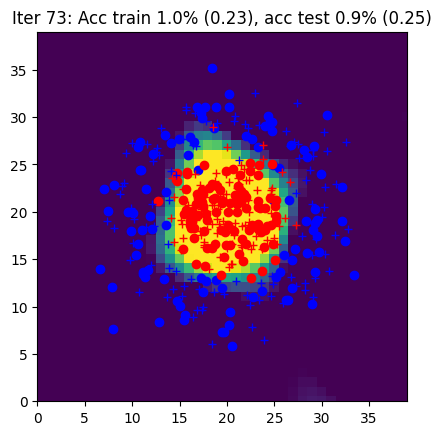

Iter 74: Acc train 0.9% (0.23), acc test 0.9% (0.25)


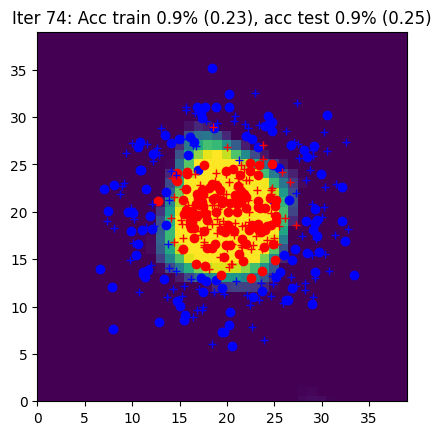

Iter 75: Acc train 0.9% (0.23), acc test 0.9% (0.24)


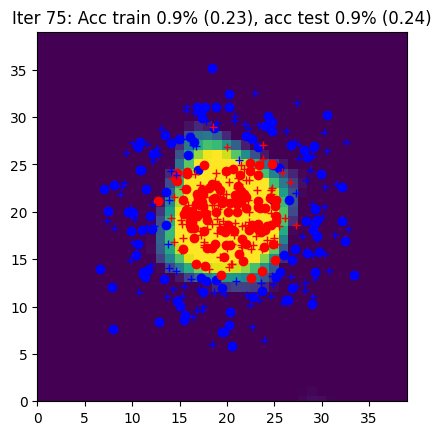

Iter 76: Acc train 1.0% (0.23), acc test 0.9% (0.24)


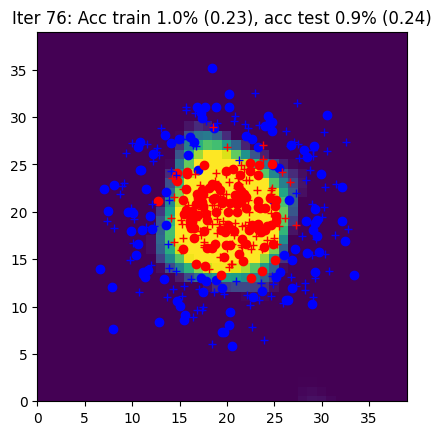

Iter 77: Acc train 1.0% (0.22), acc test 0.9% (0.24)


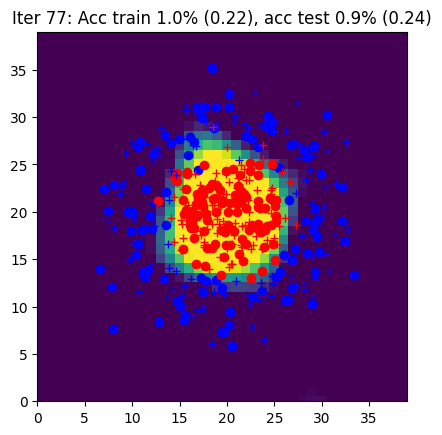

Iter 78: Acc train 1.0% (0.22), acc test 0.9% (0.24)


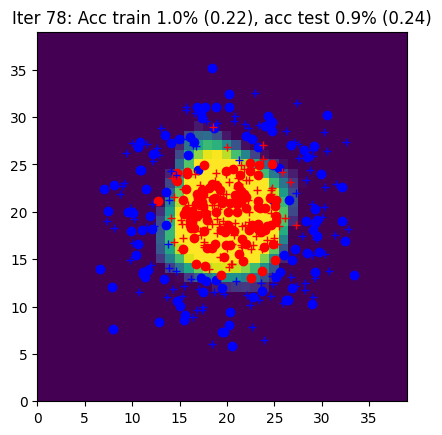

Iter 79: Acc train 0.9% (0.22), acc test 0.9% (0.24)


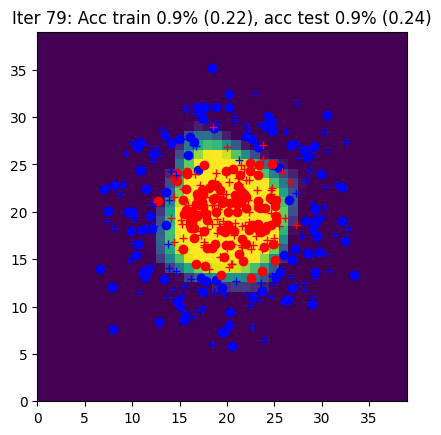

Iter 80: Acc train 0.9% (0.22), acc test 0.9% (0.23)


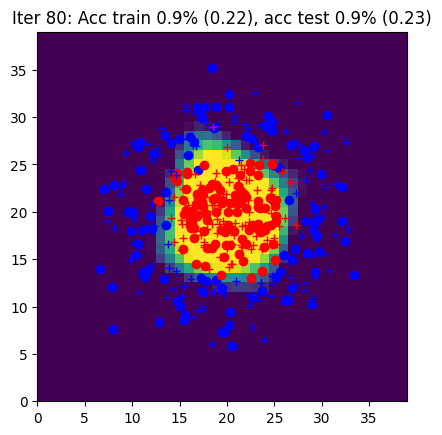

Iter 81: Acc train 1.0% (0.22), acc test 0.9% (0.23)


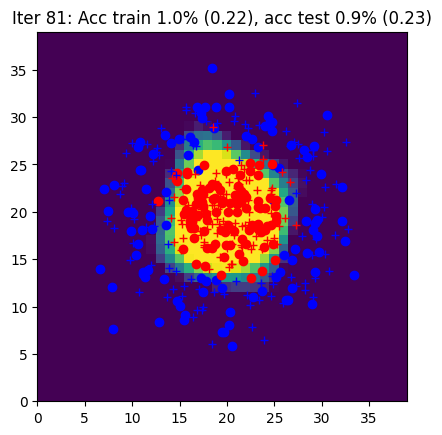

Iter 82: Acc train 0.9% (0.22), acc test 0.9% (0.23)


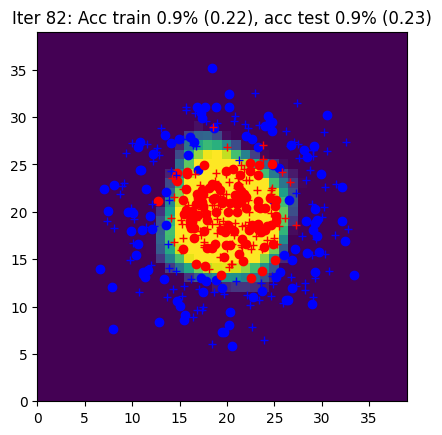

Iter 83: Acc train 0.9% (0.22), acc test 0.9% (0.23)


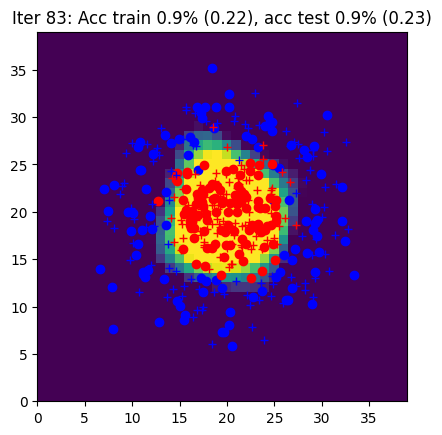

Iter 84: Acc train 1.0% (0.21), acc test 0.9% (0.23)


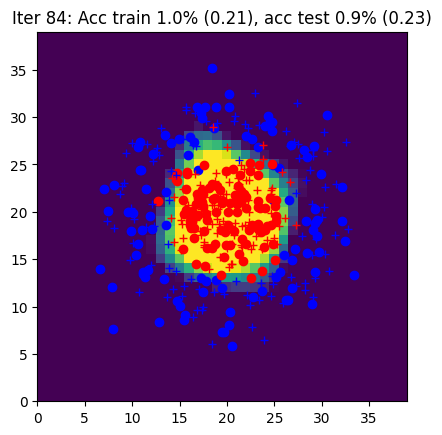

Iter 85: Acc train 0.9% (0.21), acc test 0.9% (0.23)


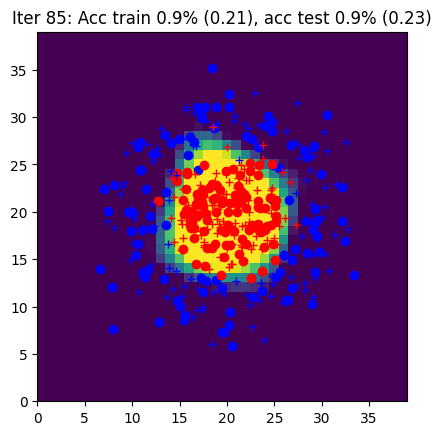

Iter 86: Acc train 0.9% (0.21), acc test 0.9% (0.23)


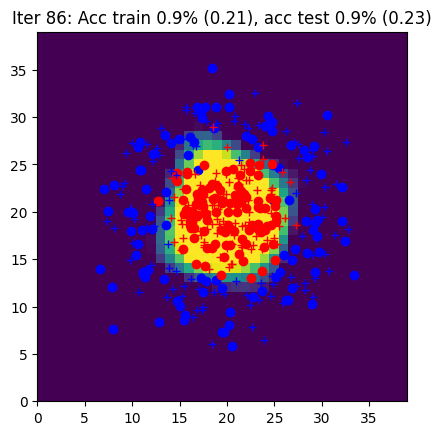

Iter 87: Acc train 1.0% (0.21), acc test 0.9% (0.22)


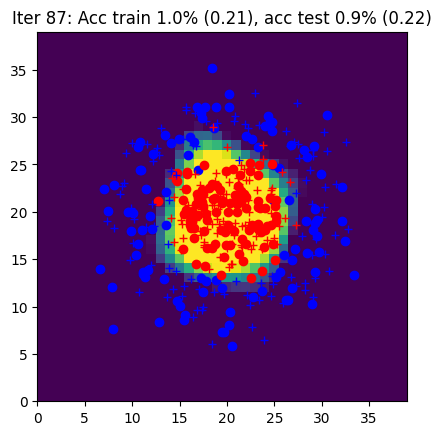

Iter 88: Acc train 0.9% (0.21), acc test 0.9% (0.22)


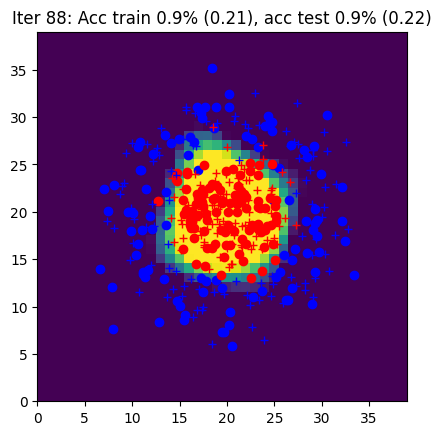

Iter 89: Acc train 0.9% (0.21), acc test 0.9% (0.22)


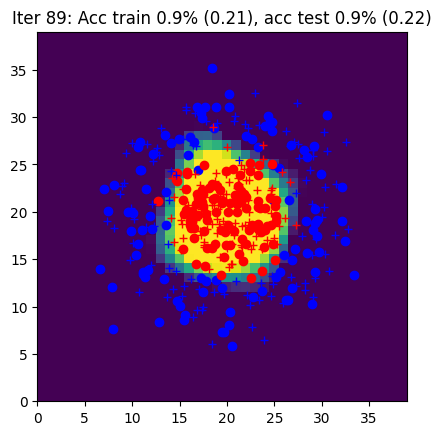

Iter 90: Acc train 0.9% (0.21), acc test 0.9% (0.22)


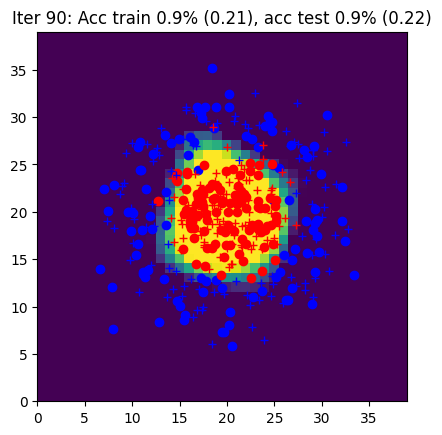

Iter 91: Acc train 0.9% (0.20), acc test 0.9% (0.22)


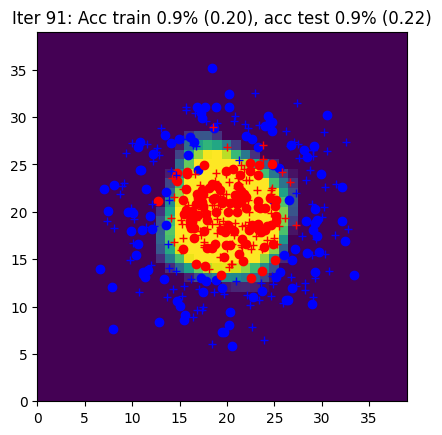

Iter 92: Acc train 0.9% (0.20), acc test 0.9% (0.22)


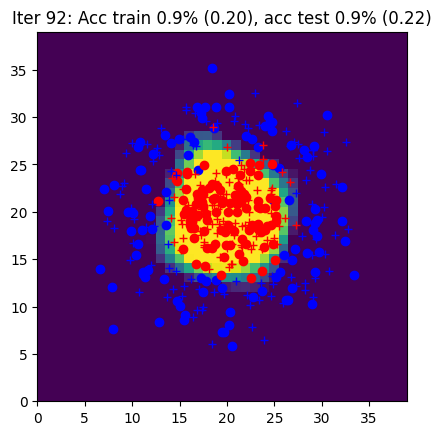

Iter 93: Acc train 0.9% (0.20), acc test 0.9% (0.22)


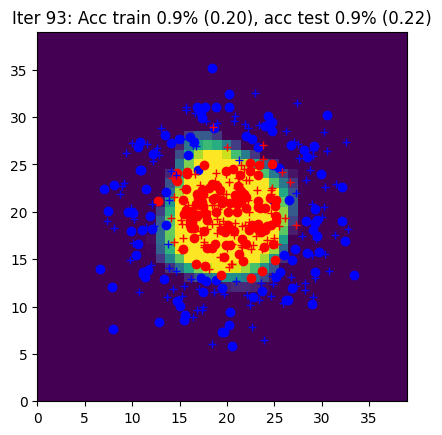

Iter 94: Acc train 0.9% (0.20), acc test 0.9% (0.22)


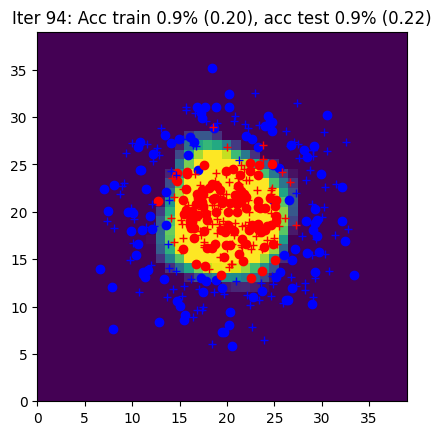

Iter 95: Acc train 0.9% (0.20), acc test 0.9% (0.22)


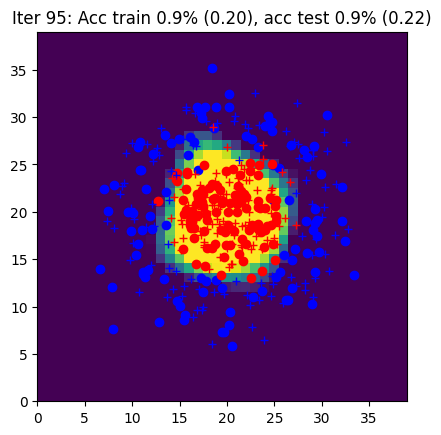

Iter 96: Acc train 0.9% (0.20), acc test 0.9% (0.21)


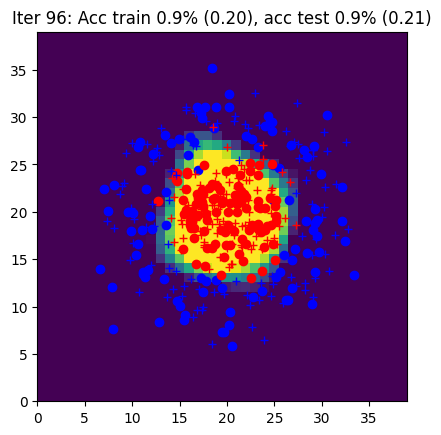

Iter 97: Acc train 0.9% (0.20), acc test 0.9% (0.21)


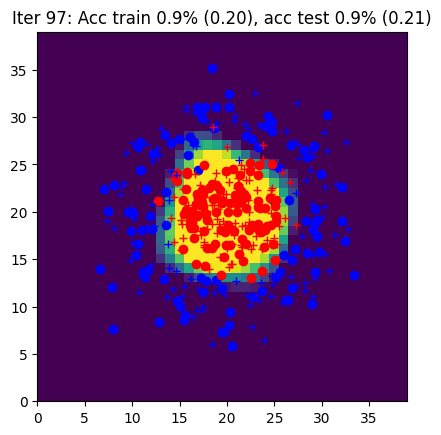

Iter 98: Acc train 0.9% (0.20), acc test 0.9% (0.21)


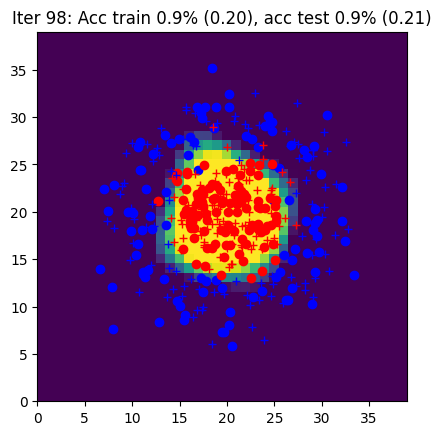

Iter 99: Acc train 0.9% (0.20), acc test 0.9% (0.21)


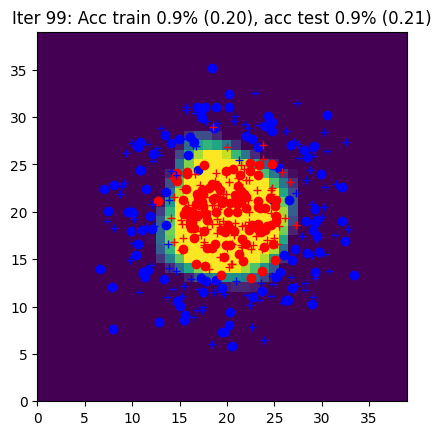

Iter 100: Acc train 0.9% (0.20), acc test 0.9% (0.21)


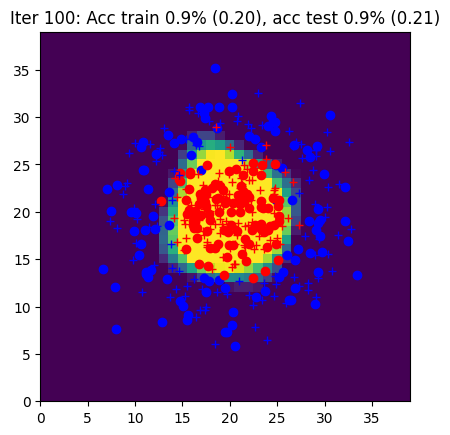

Iter 101: Acc train 0.9% (0.19), acc test 0.9% (0.21)


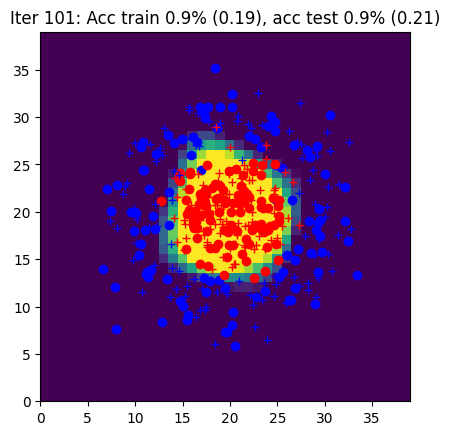

Iter 102: Acc train 0.9% (0.19), acc test 0.9% (0.21)


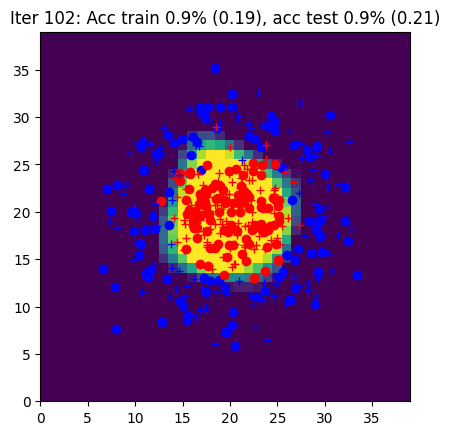

Iter 103: Acc train 0.9% (0.19), acc test 0.9% (0.21)


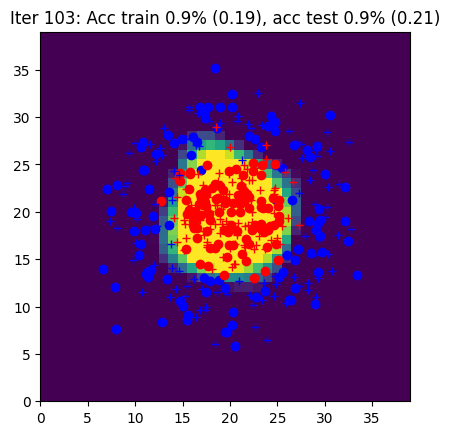

Iter 104: Acc train 0.9% (0.19), acc test 0.9% (0.21)


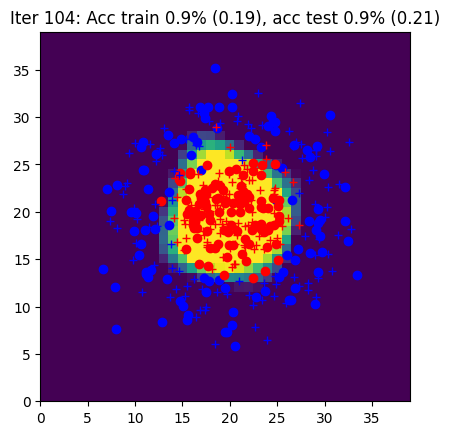

Iter 105: Acc train 0.9% (0.19), acc test 0.9% (0.21)


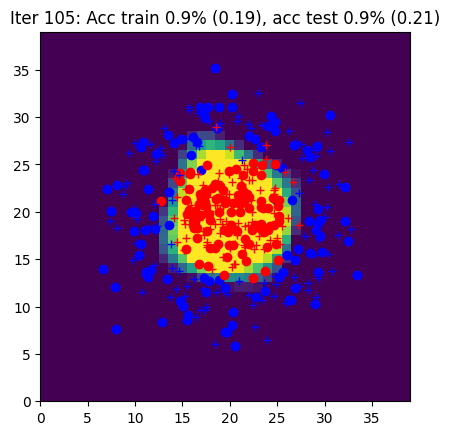

Iter 106: Acc train 0.9% (0.19), acc test 0.9% (0.20)


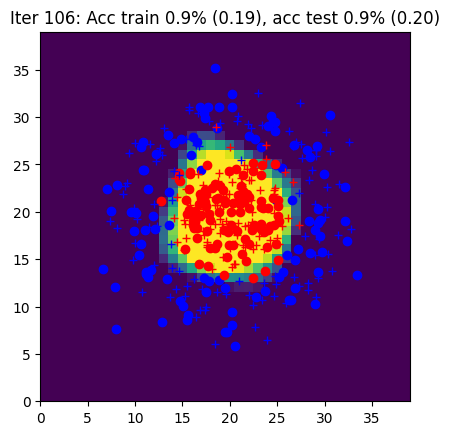

Iter 107: Acc train 0.9% (0.19), acc test 0.9% (0.20)


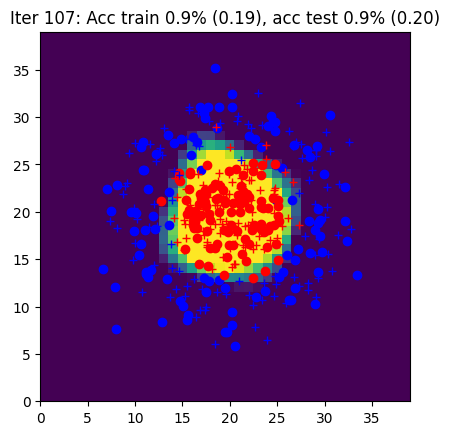

Iter 108: Acc train 0.9% (0.19), acc test 0.9% (0.20)


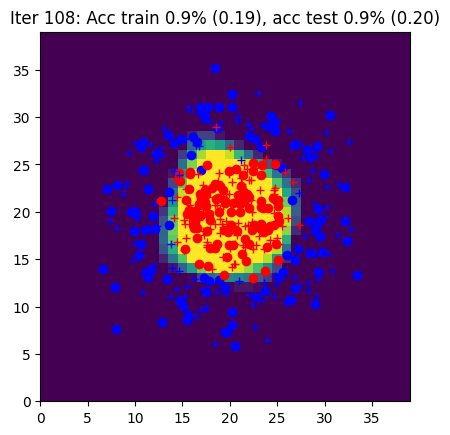

Iter 109: Acc train 0.9% (0.19), acc test 0.9% (0.20)


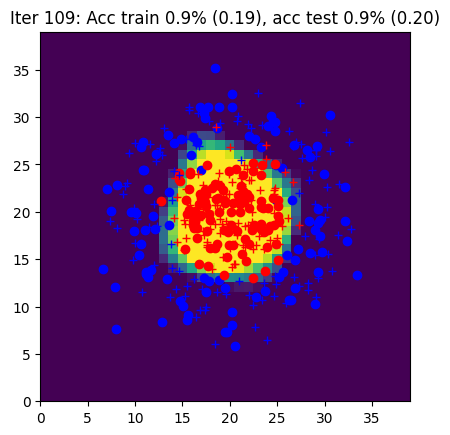

Iter 110: Acc train 0.9% (0.19), acc test 0.9% (0.20)


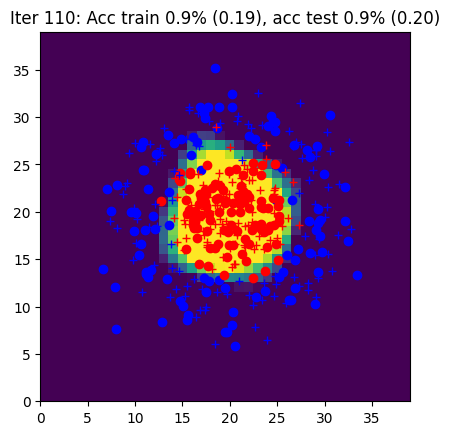

Iter 111: Acc train 0.9% (0.19), acc test 0.9% (0.20)


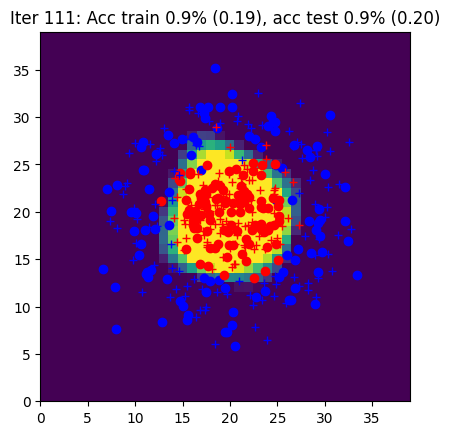

Iter 112: Acc train 0.9% (0.18), acc test 0.9% (0.20)


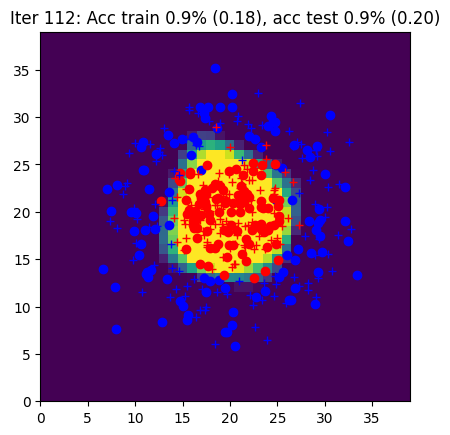

Iter 113: Acc train 0.9% (0.18), acc test 0.9% (0.20)


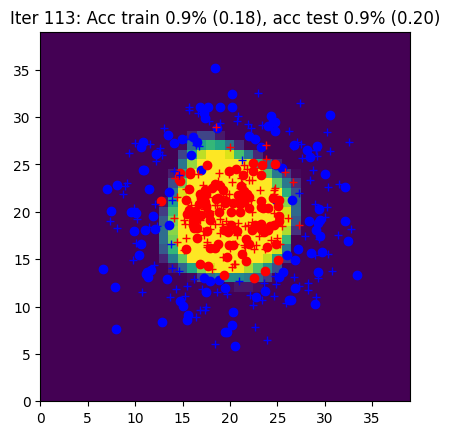

Iter 114: Acc train 0.9% (0.18), acc test 0.9% (0.20)


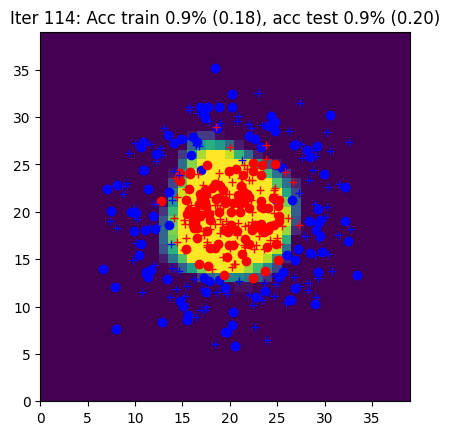

Iter 115: Acc train 0.9% (0.18), acc test 0.9% (0.20)


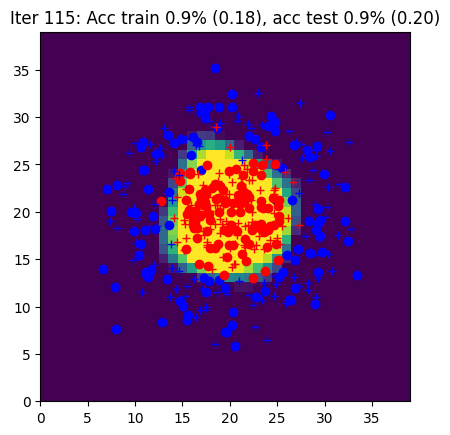

Iter 116: Acc train 0.9% (0.18), acc test 0.9% (0.20)


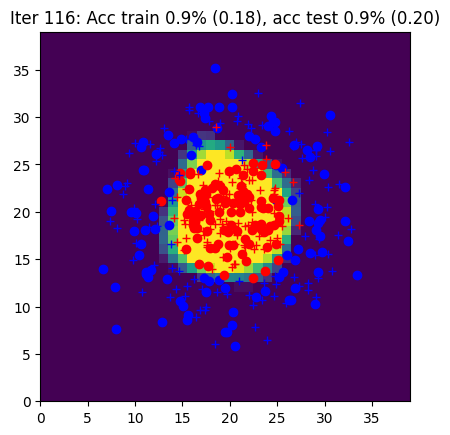

Iter 117: Acc train 0.9% (0.18), acc test 0.9% (0.20)


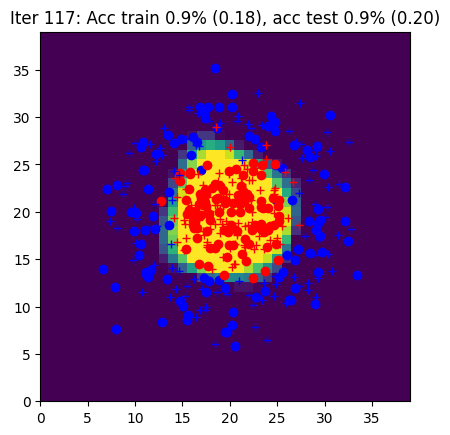

Iter 118: Acc train 0.9% (0.18), acc test 0.9% (0.20)


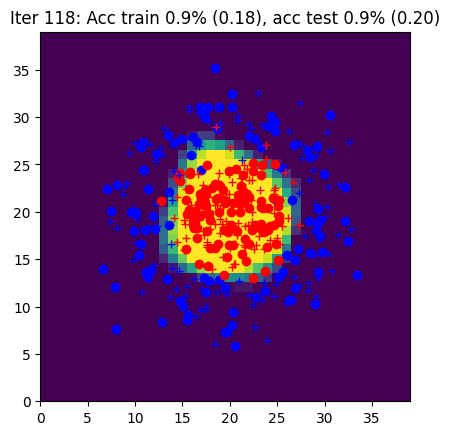

Iter 119: Acc train 0.9% (0.18), acc test 0.9% (0.20)


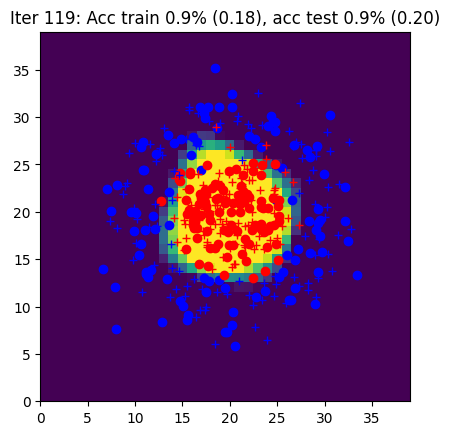

Iter 120: Acc train 0.9% (0.18), acc test 0.9% (0.19)


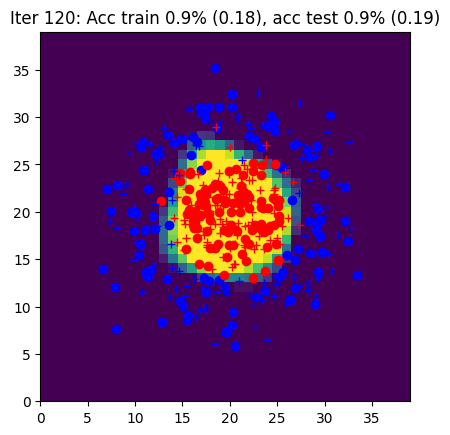

Iter 121: Acc train 0.9% (0.18), acc test 0.9% (0.19)


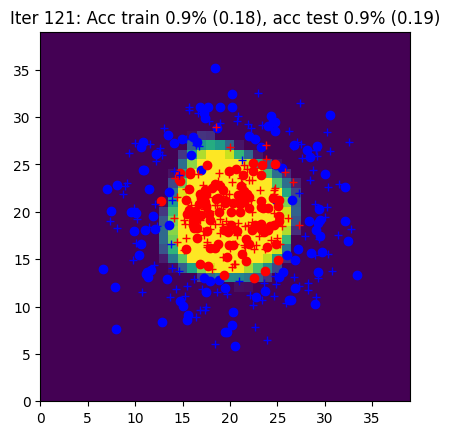

Iter 122: Acc train 0.9% (0.18), acc test 0.9% (0.19)


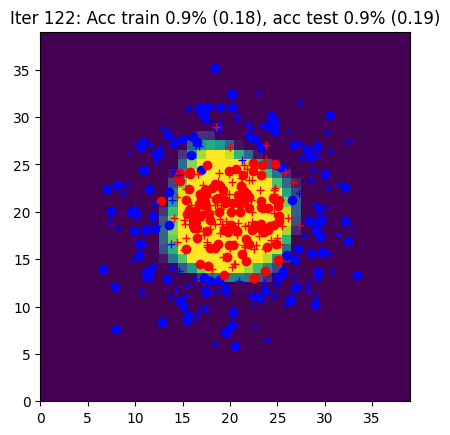

Iter 123: Acc train 0.9% (0.18), acc test 0.9% (0.19)


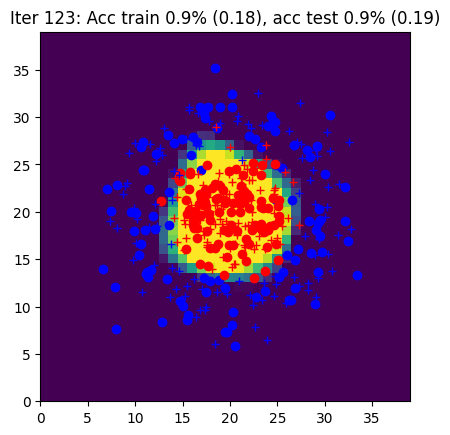

Iter 124: Acc train 0.9% (0.18), acc test 0.9% (0.19)


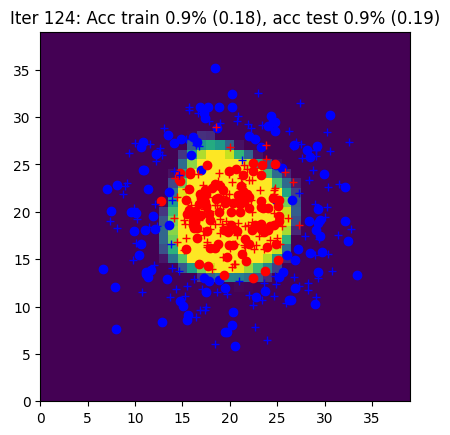

Iter 125: Acc train 0.9% (0.18), acc test 0.9% (0.19)


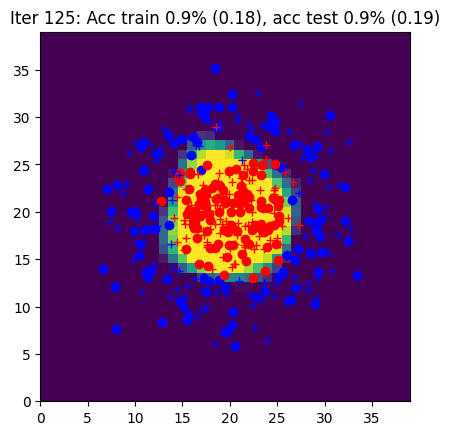

Iter 126: Acc train 0.9% (0.18), acc test 0.9% (0.19)


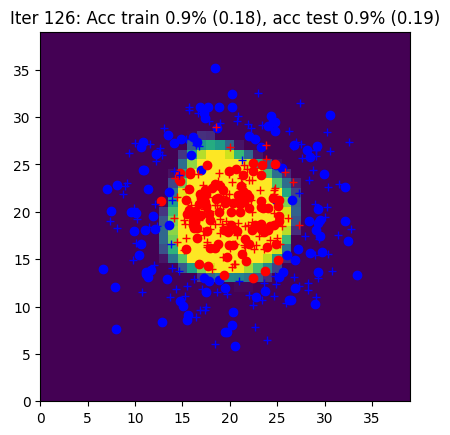

Iter 127: Acc train 0.9% (0.18), acc test 0.9% (0.19)


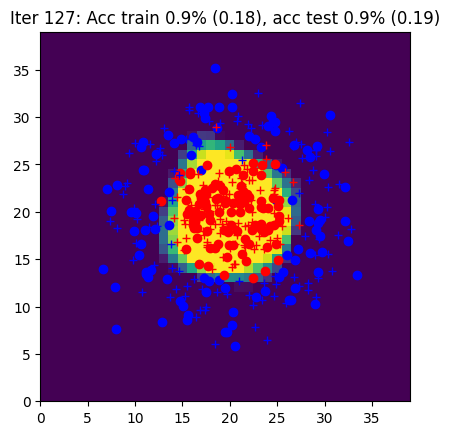

Iter 128: Acc train 0.9% (0.17), acc test 0.9% (0.19)


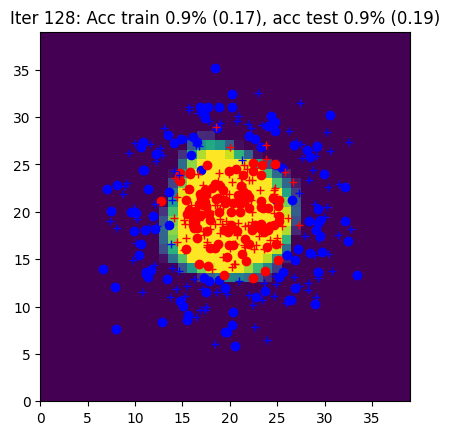

Iter 129: Acc train 0.9% (0.17), acc test 0.9% (0.19)


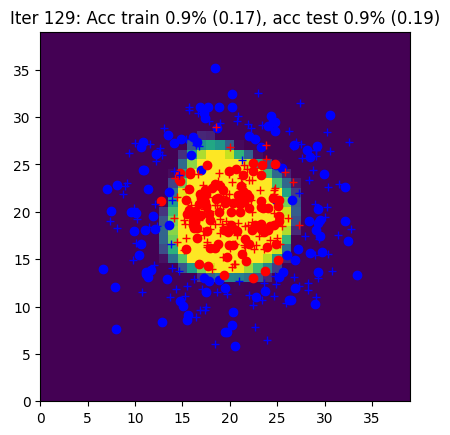

Iter 130: Acc train 0.9% (0.17), acc test 0.9% (0.19)


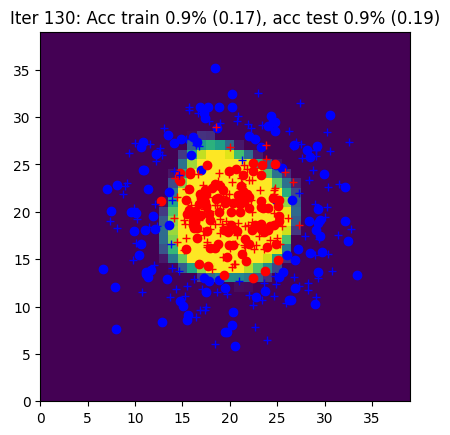

Iter 131: Acc train 0.9% (0.17), acc test 0.9% (0.19)


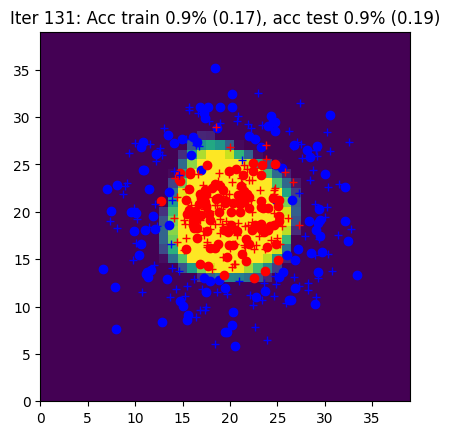

Iter 132: Acc train 0.9% (0.17), acc test 0.9% (0.19)


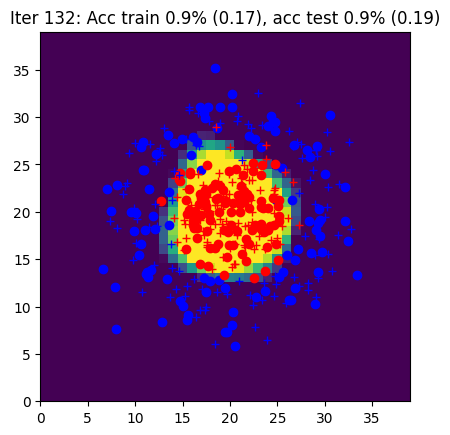

Iter 133: Acc train 0.9% (0.17), acc test 0.9% (0.19)


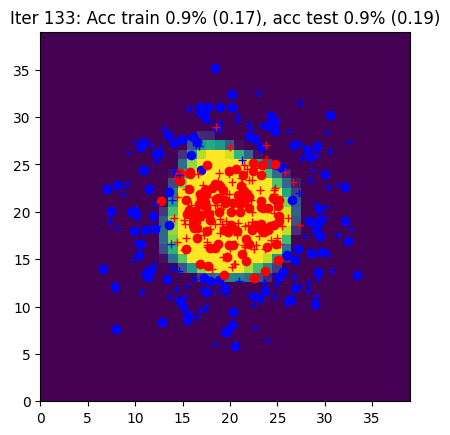

Iter 134: Acc train 0.9% (0.17), acc test 0.9% (0.19)


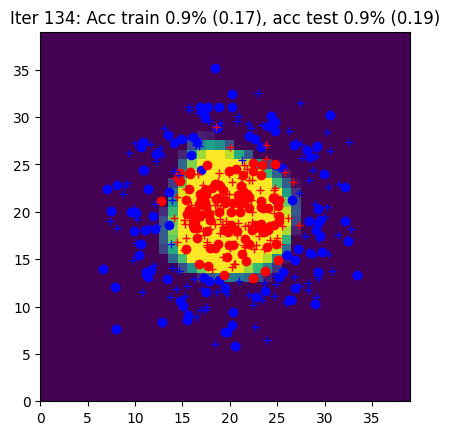

Iter 135: Acc train 0.9% (0.17), acc test 0.9% (0.19)


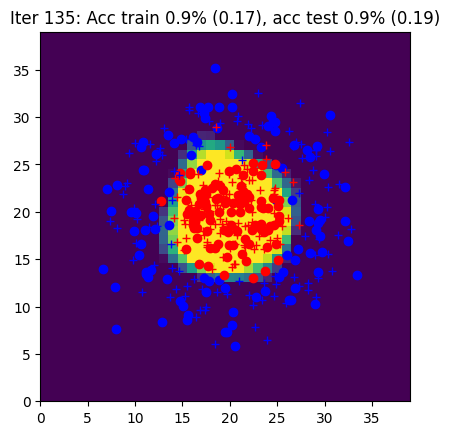

Iter 136: Acc train 0.9% (0.17), acc test 0.9% (0.19)


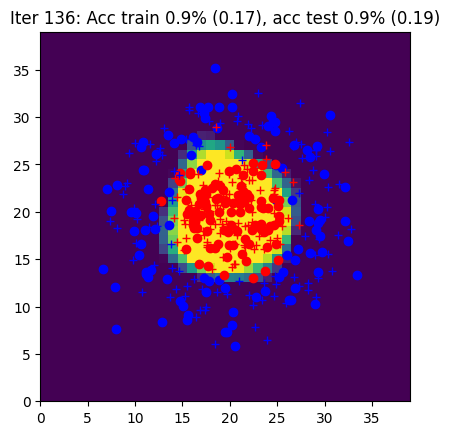

Iter 137: Acc train 0.9% (0.17), acc test 0.9% (0.19)


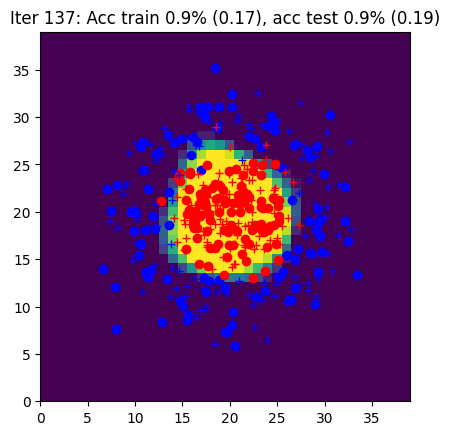

Iter 138: Acc train 0.9% (0.17), acc test 0.9% (0.18)


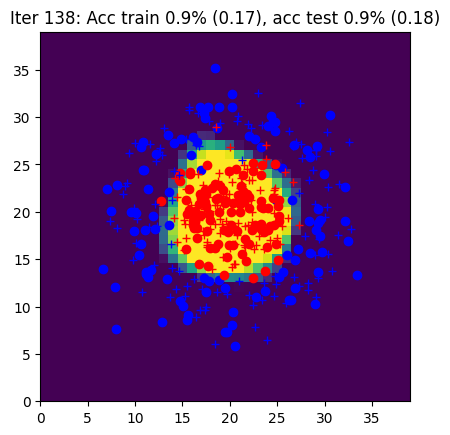

Iter 139: Acc train 0.9% (0.17), acc test 0.9% (0.18)


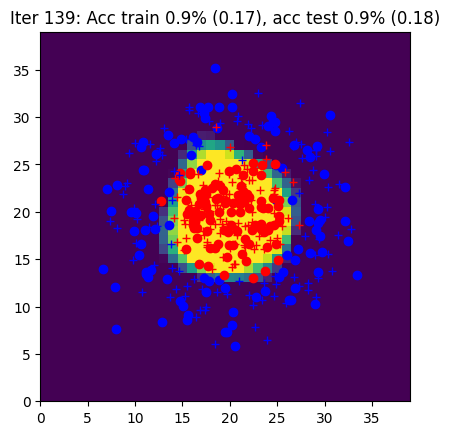

Iter 140: Acc train 0.9% (0.17), acc test 0.9% (0.18)


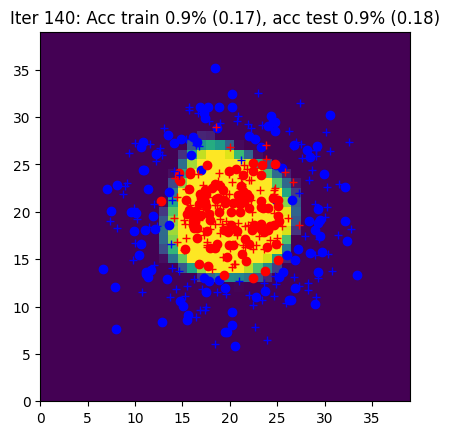

Iter 141: Acc train 0.9% (0.17), acc test 0.9% (0.18)


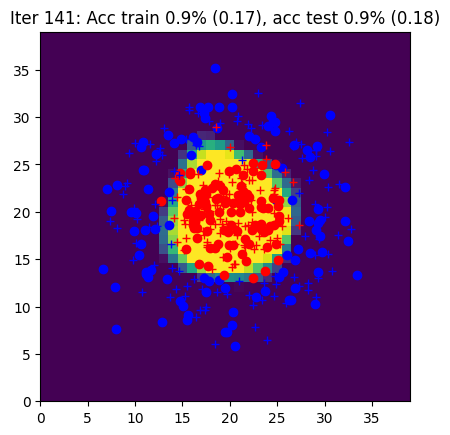

Iter 142: Acc train 0.9% (0.17), acc test 0.9% (0.18)


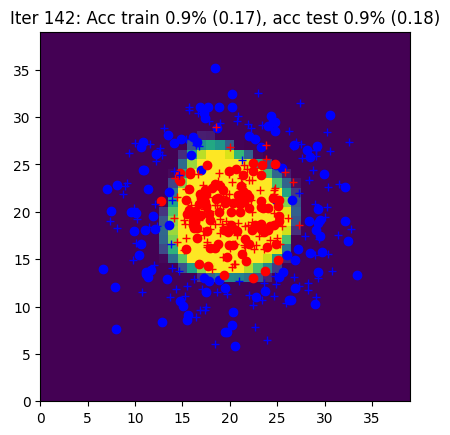

Iter 143: Acc train 0.9% (0.17), acc test 0.9% (0.18)


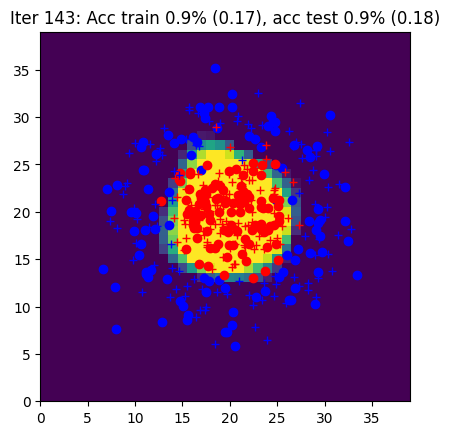

Iter 144: Acc train 0.9% (0.17), acc test 0.9% (0.18)


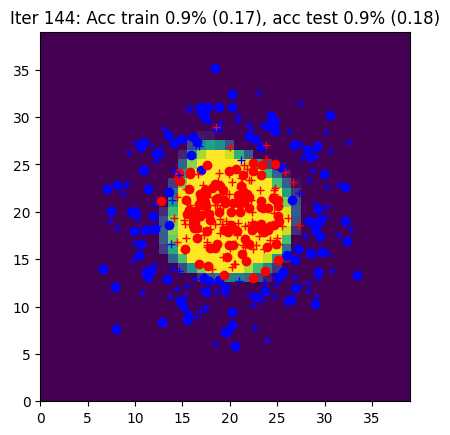

Iter 145: Acc train 0.9% (0.17), acc test 0.9% (0.18)


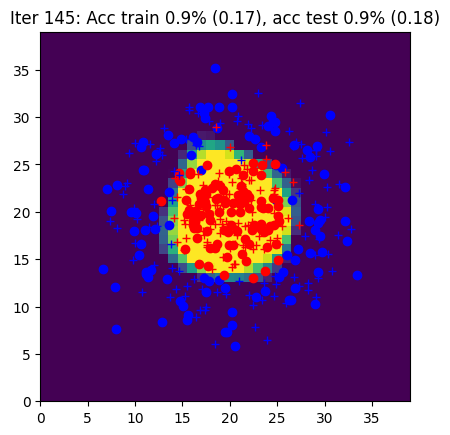

Iter 146: Acc train 0.9% (0.17), acc test 0.9% (0.18)


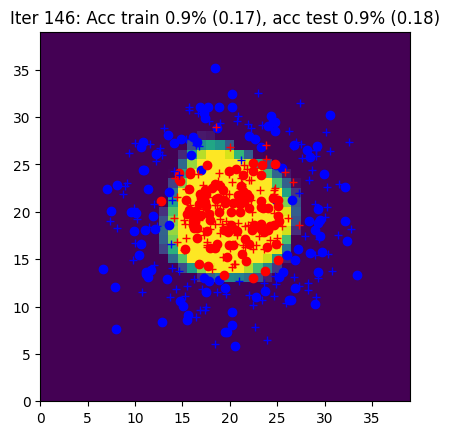

Iter 147: Acc train 0.9% (0.17), acc test 0.9% (0.18)


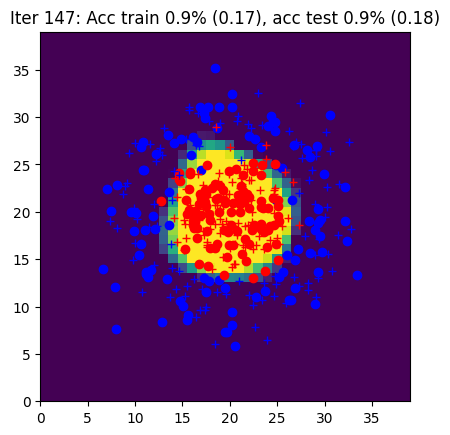

Iter 148: Acc train 0.9% (0.16), acc test 0.9% (0.18)


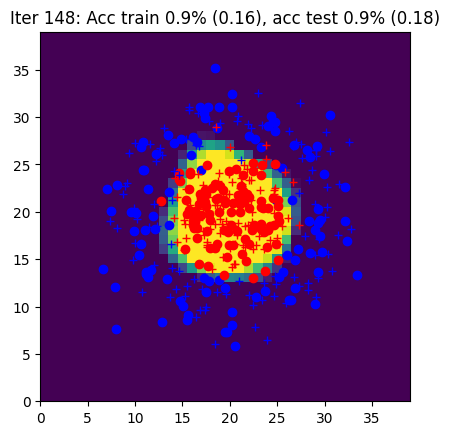

Iter 149: Acc train 0.9% (0.16), acc test 0.9% (0.18)


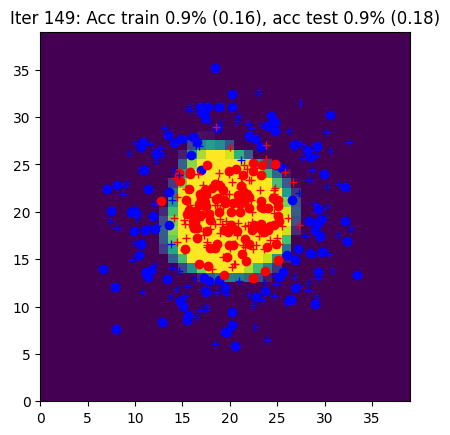

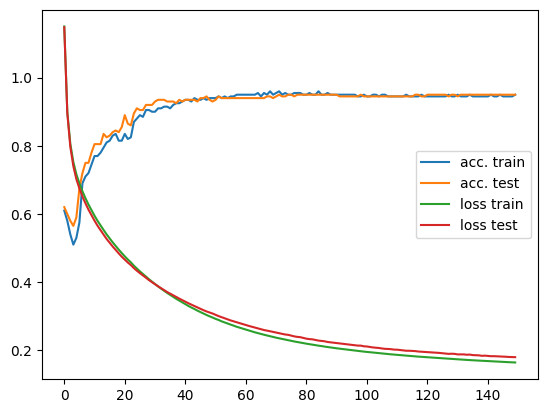

In [ ]:
# init
data = CirclesData()
data.plot_data()
N = data.Xtrain.shape[0]
Nbatch = 10
nx = data.Xtrain.shape[1]
nh = 10
ny = data.Ytrain.shape[1]
eta = 0.03

params = init_params(nx, nh, ny)

curves = [[],[], [], []]

# epoch
for iteration in range(150):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    #####################
    ## Your code here  ##
    #####################
    # batches
    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j+1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]

        # write the optimization algorithm on the batch (X,Y)
        # using the functions: forward, loss_accuracy, sgd
        # and the backward function with autograd
        yhat, outputs = forward(params, X)

        L, acc = loss_accuracy(yhat, Y)

        L.backward()

        sgd(params, eta)



    ####################
    ##      END        #
    ####################


    Yhat_train, _ = forward(params, data.Xtrain)
    Yhat_test, _ = forward(params, data.Xtest)
    Ltrain, acctrain = loss_accuracy(Yhat_train, data.Ytrain)
    Ltest, acctest = loss_accuracy(Yhat_test, data.Ytest)
    Ygrid, _ = forward(params, data.Xgrid)

    title = 'Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})'.format(iteration, acctrain, Ltrain, acctest, Ltest)
    print(title)
    # detach() is used to remove the predictions from the computational graph in autograd
    data.plot_data_with_grid(Ygrid.detach(), title)

    curves[0].append(acctrain)
    curves[1].append(acctest)
    curves[2].append(Ltrain.detach().numpy())
    curves[3].append(Ltest.detach().numpy())

fig = plt.figure()
plt.plot(curves[0], label="acc. train")
plt.plot(curves[1], label="acc. test")
plt.plot(curves[2], label="loss train")
plt.plot(curves[3], label="loss test")
plt.legend()
plt.show()

# Part 3 : Simplification of the forward pass with `torch.nn`

`init_params` and `forward` are replaced by the `init_model` function which defines the network architecture and the loss.

In [ ]:
def init_model(nx, nh, ny):

    #####################
    ## Your code here  ##
    #####################

    model = torch.nn.Sequential(
        torch.nn.Linear(nx, nh),
        torch.nn.Tanh(),
        torch.nn.Linear(nh, ny),
    )
    loss = torch.nn.CrossEntropyLoss()

    ####################
    ##      END        #
    ####################

    return model, loss

In [ ]:
def loss_accuracy(loss, Yhat, Y):

    #####################
    ## Your code here  ##
    #####################
    # call the loss function

    L = loss(Yhat, Y)
    _, indsYhat = torch.max(Yhat, 1)
    _, indsY = torch.max(Y, 1)

    acc = torch.mean((indsYhat == indsY).float())


    ####################
    ##      END        #
    ####################

    return L, acc

In [ ]:
def sgd(model, eta):

    #####################
    ## Your code here  ##
    #####################
    # update the network weights
    # warning: use torch.no_grad()
    # and reset to zero the gradient accumulators
    with torch.no_grad():
      for param in model.parameters():
        param -= eta * param.grad

      model.zero_grad()


    ####################
    ##      END        #
    ####################
    return model

## Global learning procedure with autograd and `torch.nn`

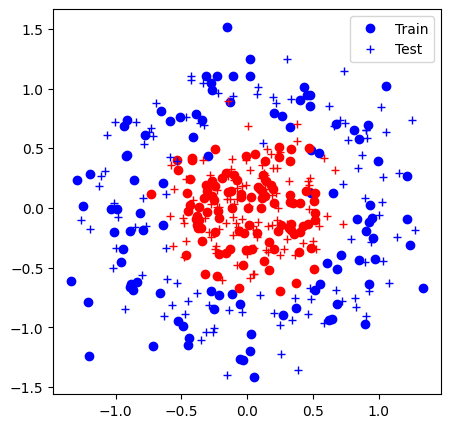

Iter 0: Acc train 0.5% (0.70), acc test 0.6% (0.70)


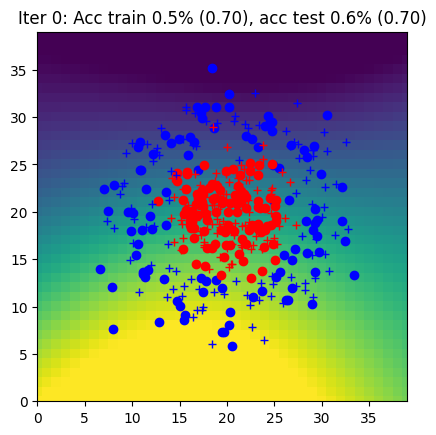

Iter 1: Acc train 0.6% (0.70), acc test 0.6% (0.70)


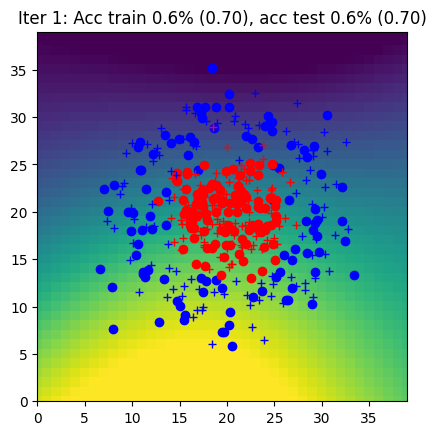

Iter 2: Acc train 0.5% (0.69), acc test 0.6% (0.70)


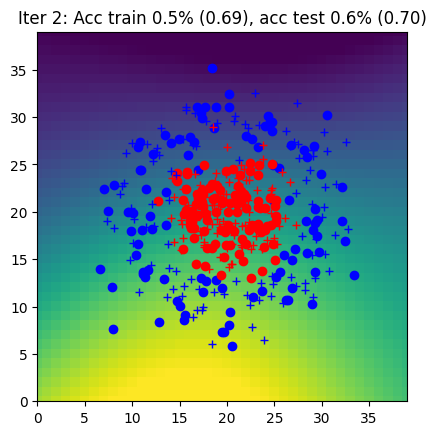

Iter 3: Acc train 0.5% (0.69), acc test 0.6% (0.69)


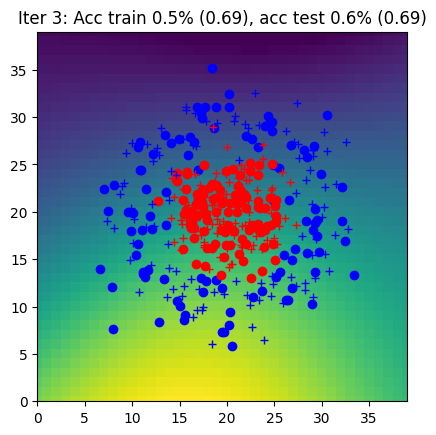

Iter 4: Acc train 0.6% (0.69), acc test 0.6% (0.69)


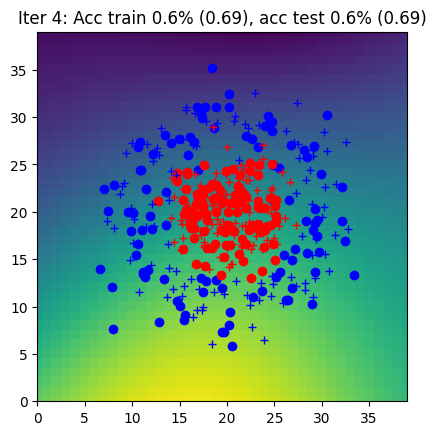

Iter 5: Acc train 0.6% (0.69), acc test 0.6% (0.69)


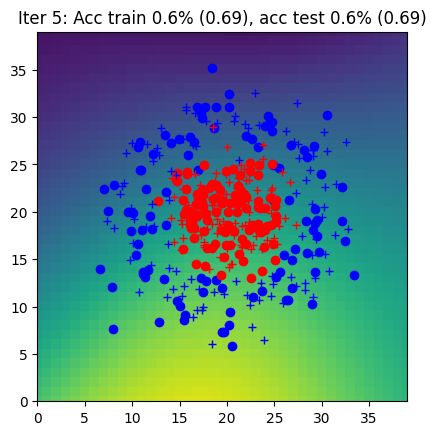

Iter 6: Acc train 0.6% (0.68), acc test 0.6% (0.69)


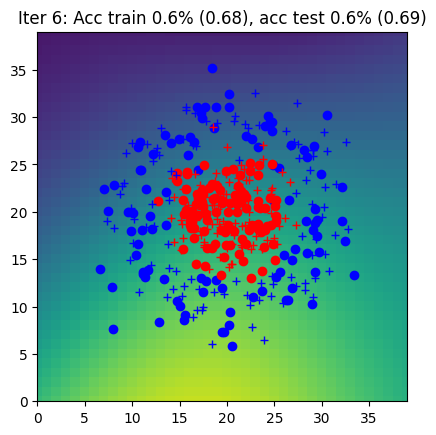

Iter 7: Acc train 0.6% (0.68), acc test 0.6% (0.69)


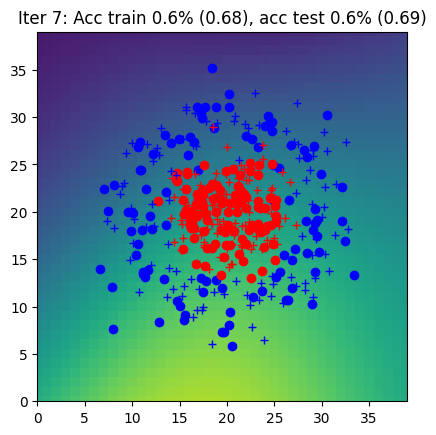

Iter 8: Acc train 0.6% (0.68), acc test 0.6% (0.68)


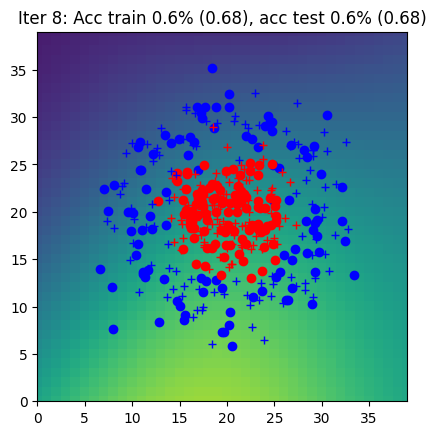

Iter 9: Acc train 0.6% (0.68), acc test 0.6% (0.68)


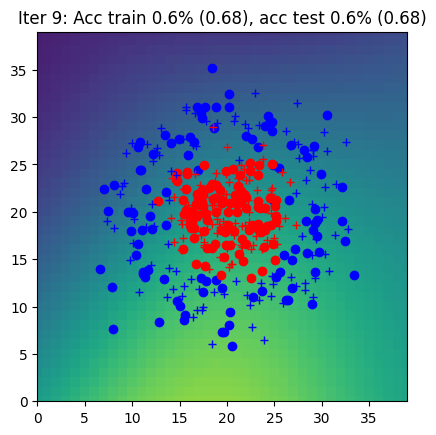

Iter 10: Acc train 0.6% (0.68), acc test 0.6% (0.68)


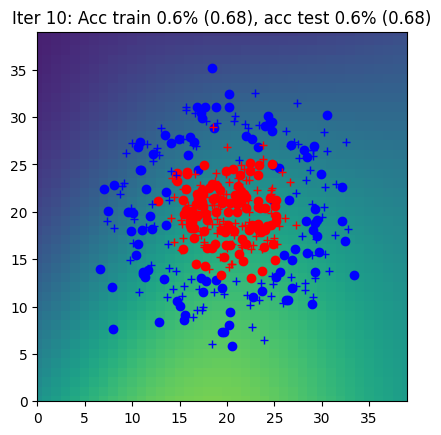

Iter 11: Acc train 0.7% (0.68), acc test 0.7% (0.68)


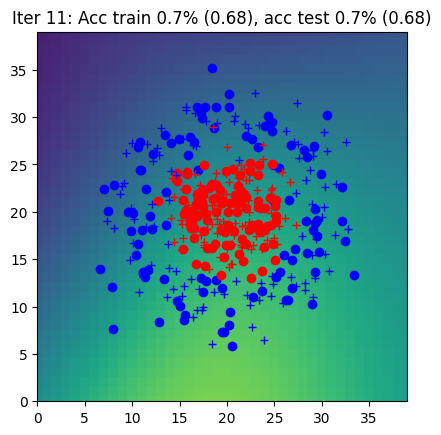

Iter 12: Acc train 0.7% (0.68), acc test 0.7% (0.68)


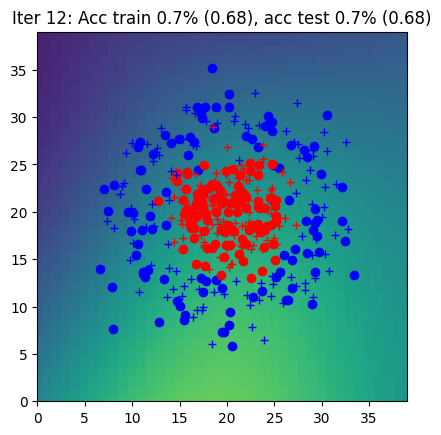

Iter 13: Acc train 0.7% (0.67), acc test 0.7% (0.68)


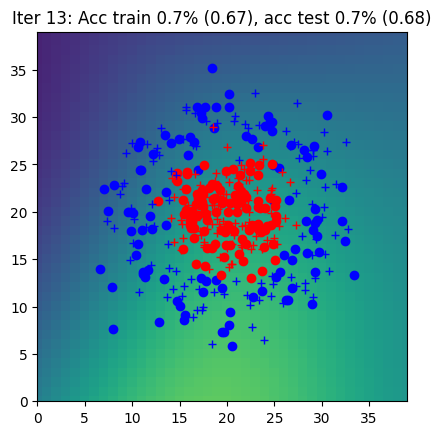

Iter 14: Acc train 0.7% (0.67), acc test 0.7% (0.68)


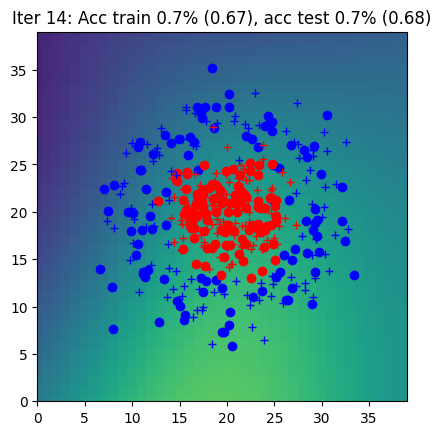

Iter 15: Acc train 0.7% (0.67), acc test 0.7% (0.68)


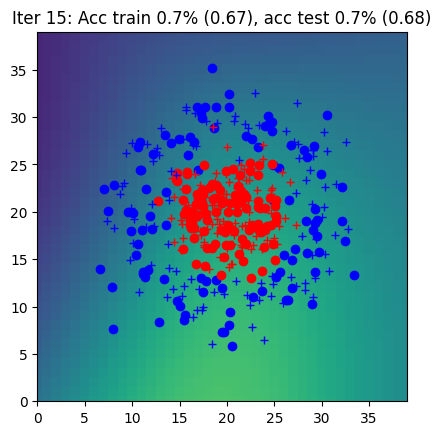

Iter 16: Acc train 0.7% (0.67), acc test 0.7% (0.67)


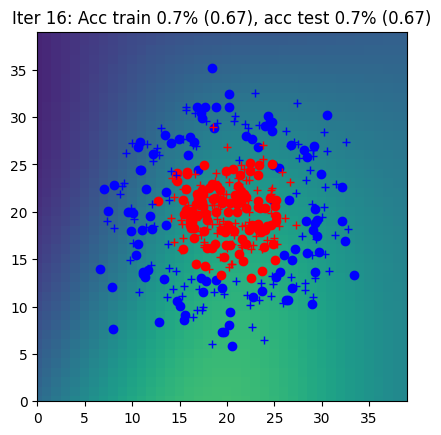

Iter 17: Acc train 0.7% (0.67), acc test 0.7% (0.67)


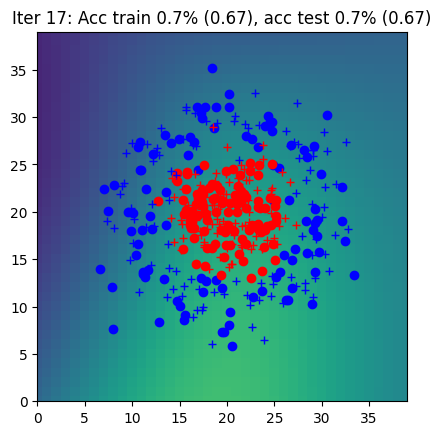

Iter 18: Acc train 0.7% (0.67), acc test 0.7% (0.67)


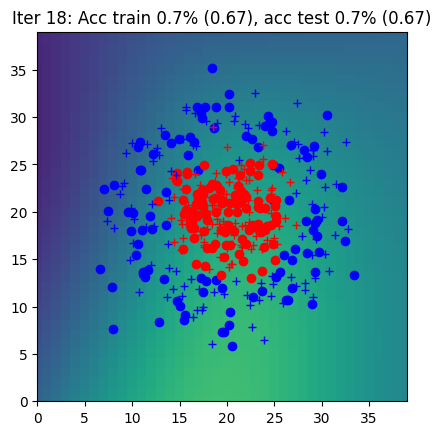

Iter 19: Acc train 0.8% (0.67), acc test 0.7% (0.67)


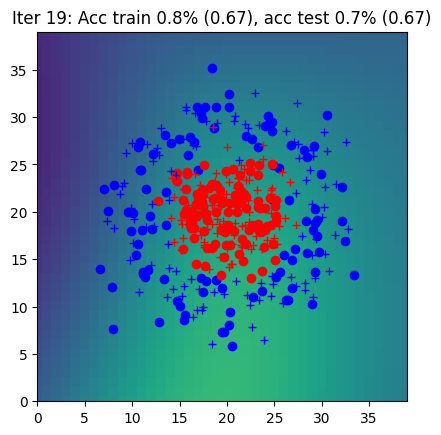

Iter 20: Acc train 0.7% (0.67), acc test 0.7% (0.67)


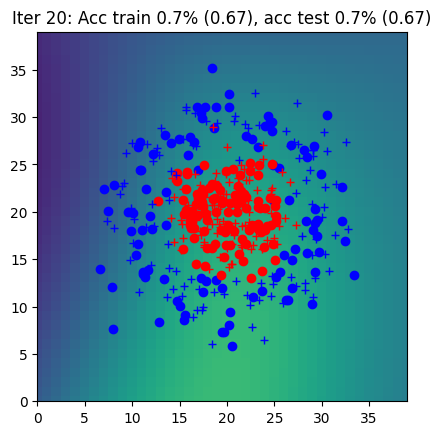

Iter 21: Acc train 0.7% (0.67), acc test 0.7% (0.67)


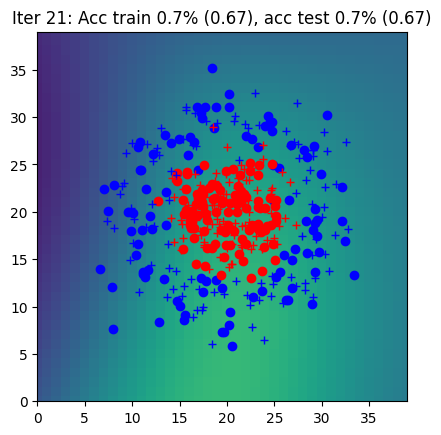

Iter 22: Acc train 0.8% (0.66), acc test 0.7% (0.67)


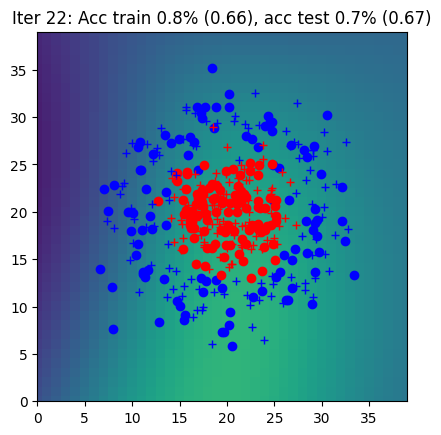

Iter 23: Acc train 0.8% (0.66), acc test 0.7% (0.66)


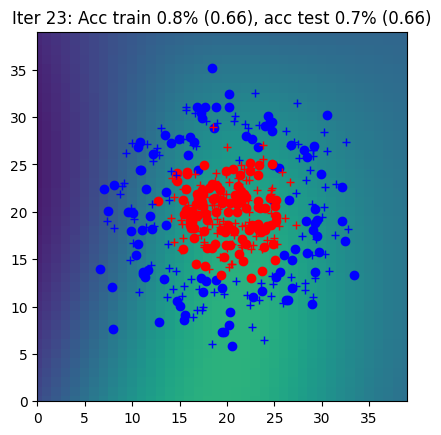

Iter 24: Acc train 0.8% (0.66), acc test 0.7% (0.66)


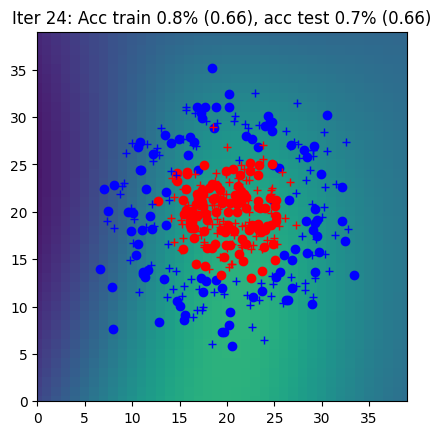

Iter 25: Acc train 0.7% (0.66), acc test 0.7% (0.66)


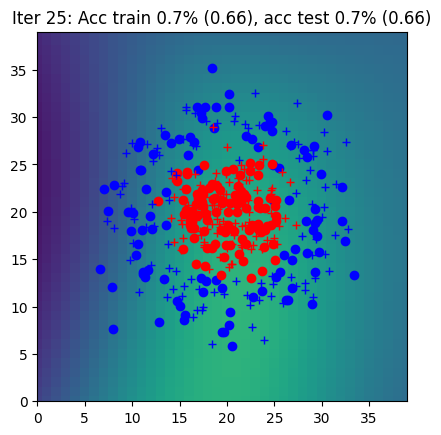

Iter 26: Acc train 0.7% (0.66), acc test 0.7% (0.66)


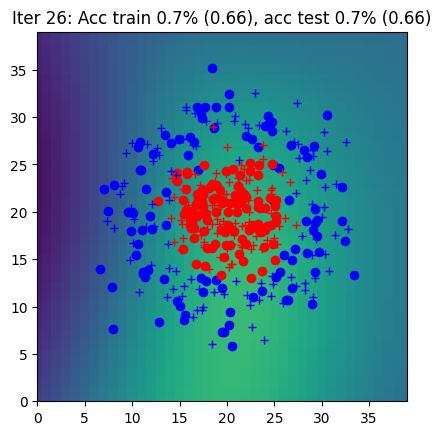

Iter 27: Acc train 0.7% (0.66), acc test 0.7% (0.66)


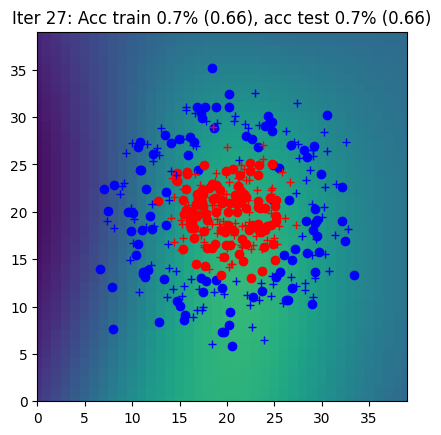

Iter 28: Acc train 0.7% (0.65), acc test 0.7% (0.66)


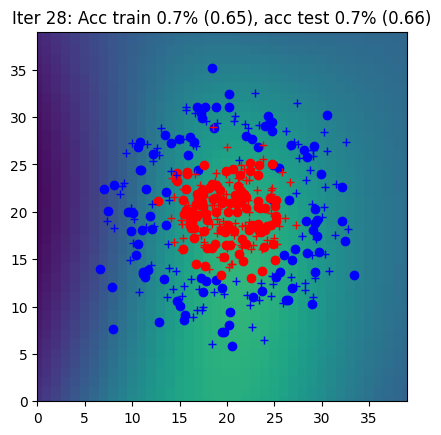

Iter 29: Acc train 0.7% (0.65), acc test 0.7% (0.66)


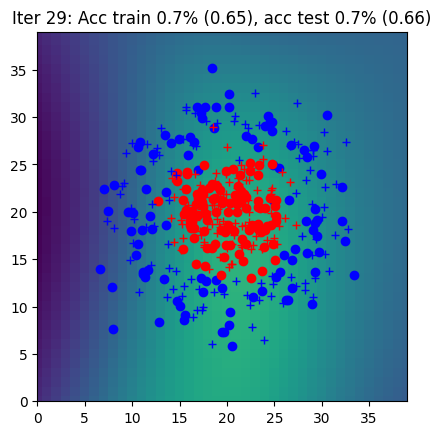

Iter 30: Acc train 0.7% (0.65), acc test 0.7% (0.65)


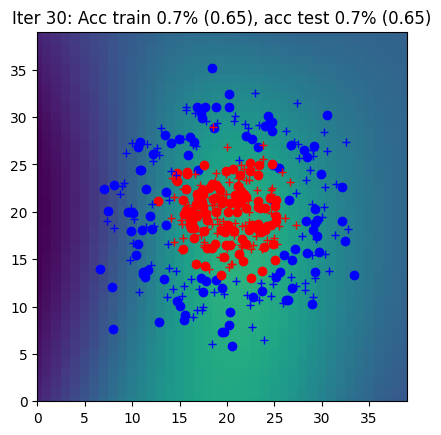

Iter 31: Acc train 0.7% (0.65), acc test 0.7% (0.65)


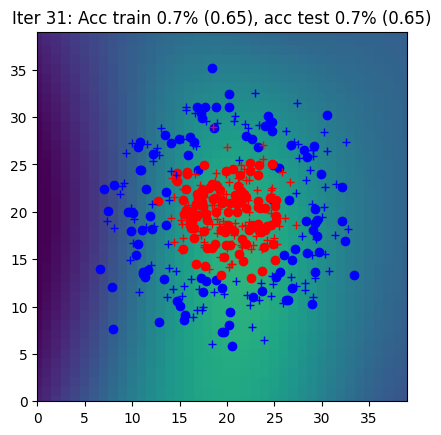

Iter 32: Acc train 0.7% (0.65), acc test 0.7% (0.65)


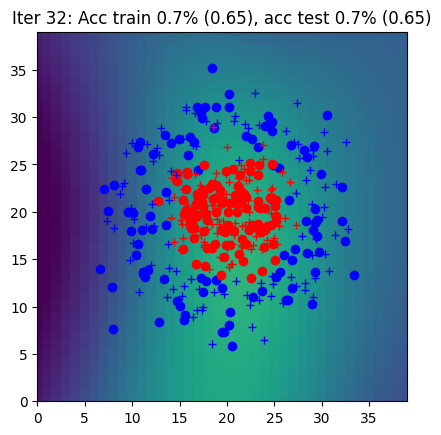

Iter 33: Acc train 0.7% (0.65), acc test 0.8% (0.65)


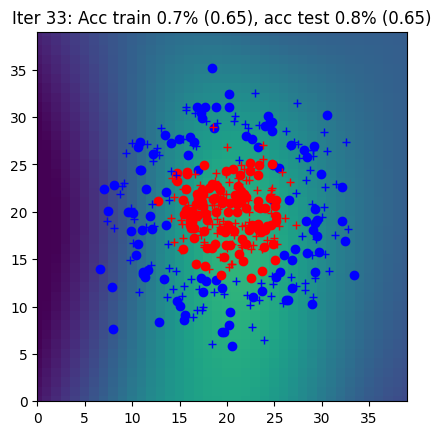

Iter 34: Acc train 0.7% (0.64), acc test 0.7% (0.65)


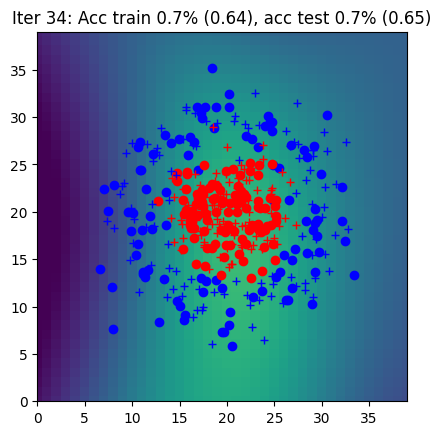

Iter 35: Acc train 0.7% (0.64), acc test 0.7% (0.64)


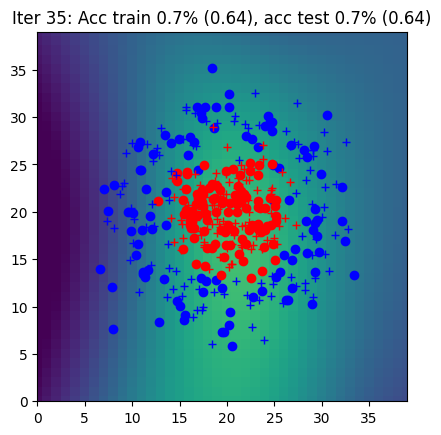

Iter 36: Acc train 0.7% (0.64), acc test 0.7% (0.64)


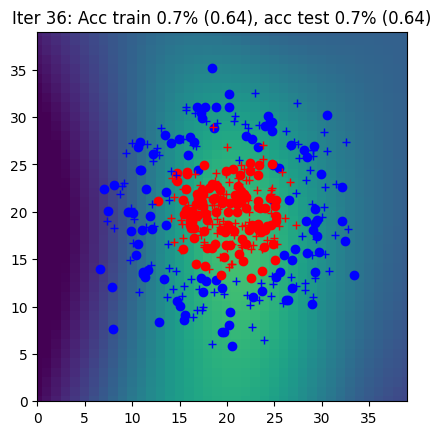

Iter 37: Acc train 0.8% (0.64), acc test 0.8% (0.64)


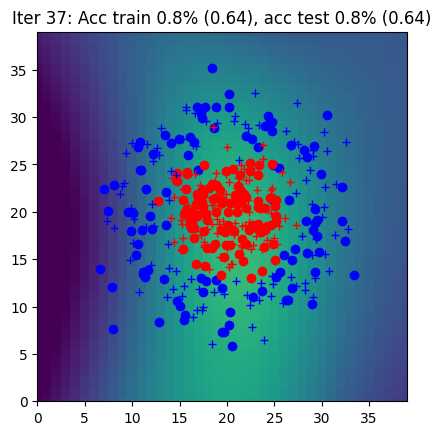

Iter 38: Acc train 0.8% (0.63), acc test 0.8% (0.64)


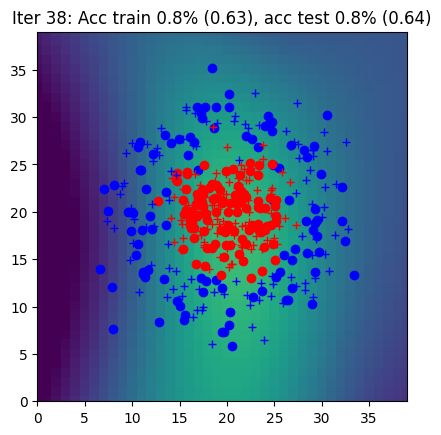

Iter 39: Acc train 0.7% (0.63), acc test 0.8% (0.63)


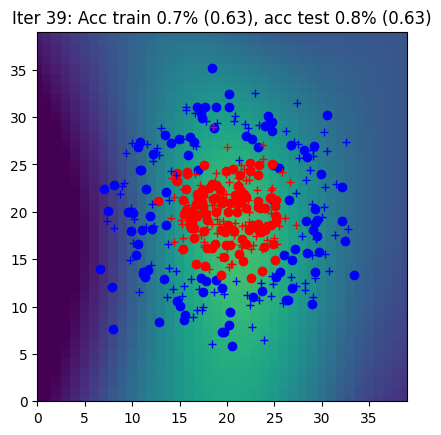

Iter 40: Acc train 0.8% (0.63), acc test 0.8% (0.63)


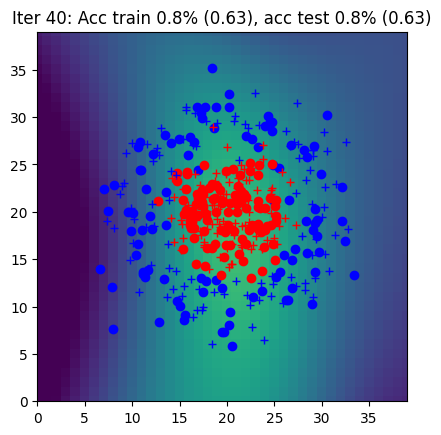

Iter 41: Acc train 0.8% (0.63), acc test 0.8% (0.63)


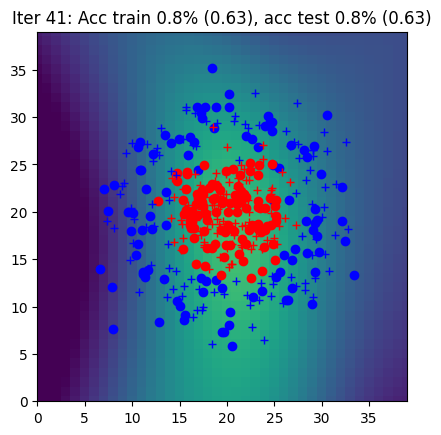

Iter 42: Acc train 0.8% (0.62), acc test 0.8% (0.63)


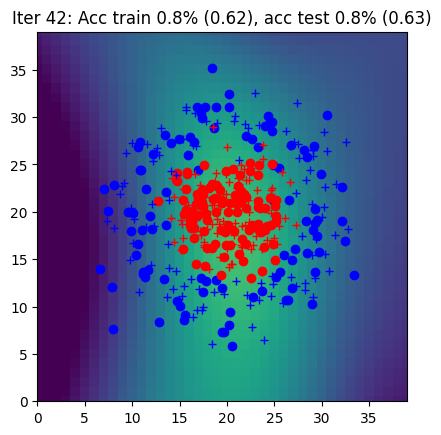

Iter 43: Acc train 0.8% (0.62), acc test 0.8% (0.62)


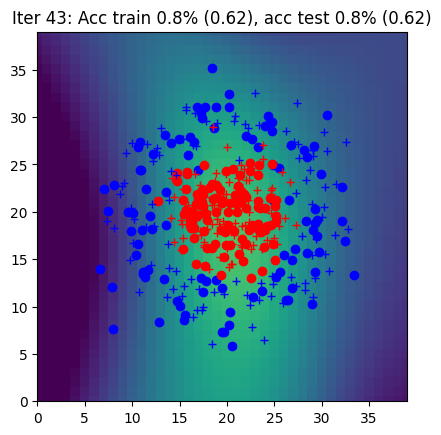

Iter 44: Acc train 0.8% (0.62), acc test 0.8% (0.62)


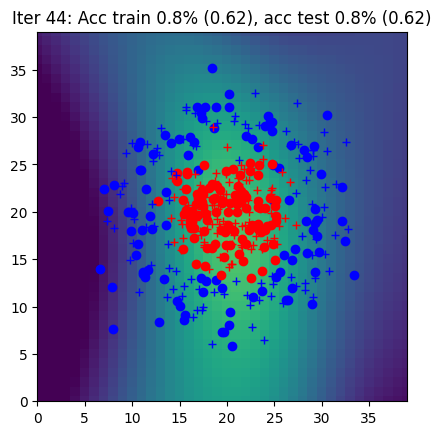

Iter 45: Acc train 0.8% (0.61), acc test 0.8% (0.62)


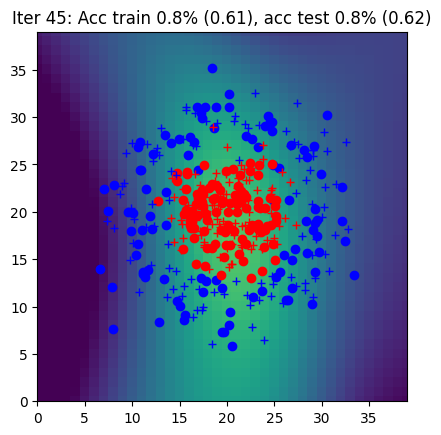

Iter 46: Acc train 0.8% (0.61), acc test 0.8% (0.61)


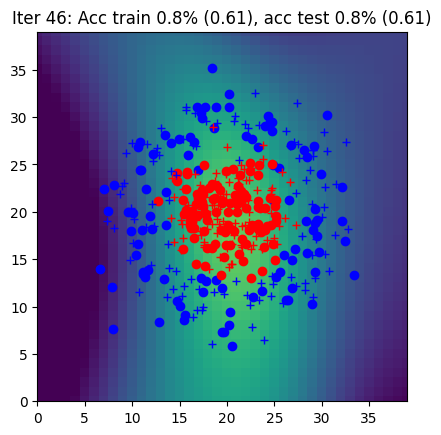

Iter 47: Acc train 0.8% (0.61), acc test 0.8% (0.61)


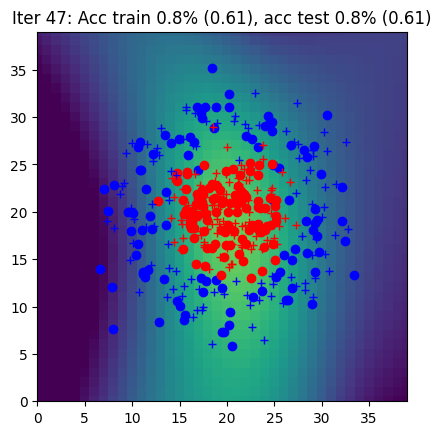

Iter 48: Acc train 0.8% (0.60), acc test 0.8% (0.61)


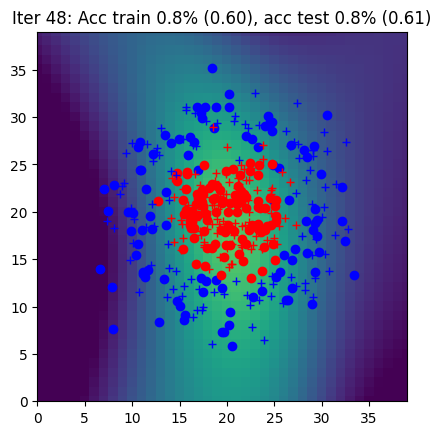

Iter 49: Acc train 0.8% (0.60), acc test 0.8% (0.60)


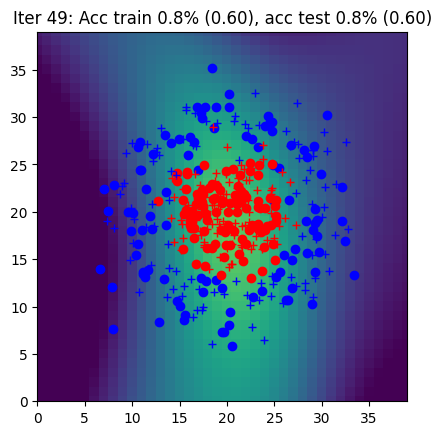

Iter 50: Acc train 0.8% (0.60), acc test 0.8% (0.60)


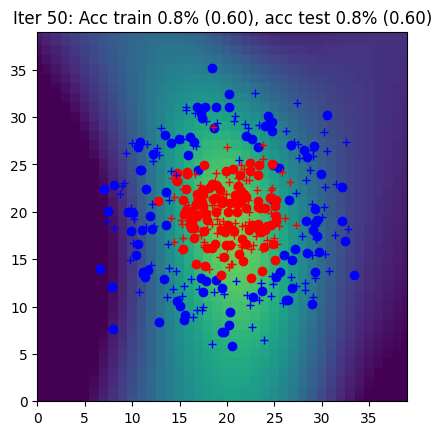

Iter 51: Acc train 0.8% (0.59), acc test 0.8% (0.60)


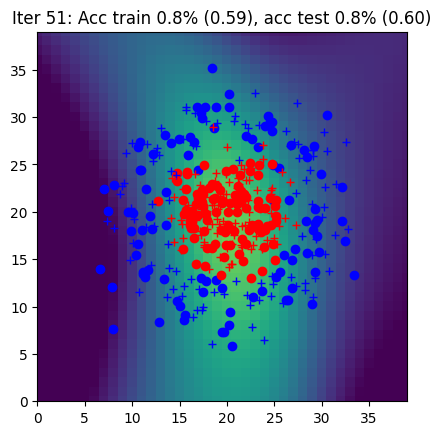

Iter 52: Acc train 0.8% (0.59), acc test 0.8% (0.59)


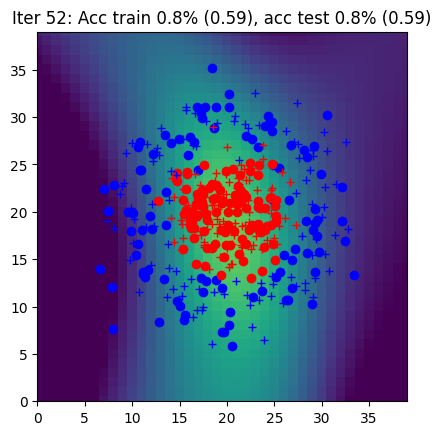

Iter 53: Acc train 0.8% (0.59), acc test 0.8% (0.59)


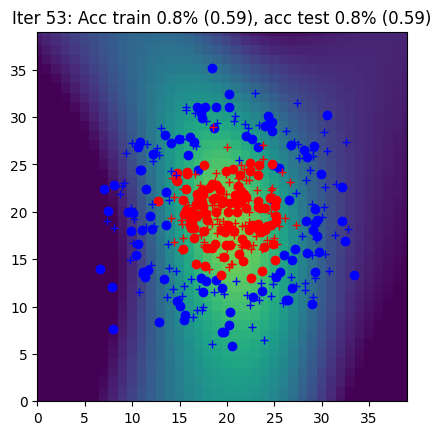

Iter 54: Acc train 0.8% (0.58), acc test 0.8% (0.59)


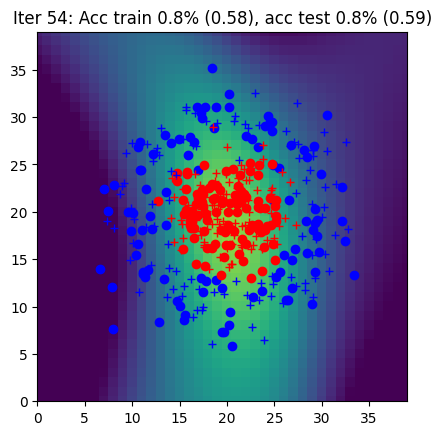

Iter 55: Acc train 0.8% (0.58), acc test 0.8% (0.58)


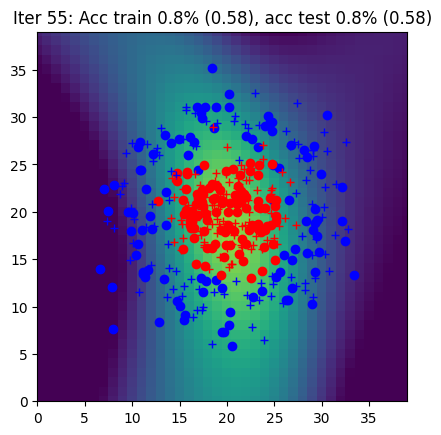

Iter 56: Acc train 0.8% (0.57), acc test 0.8% (0.58)


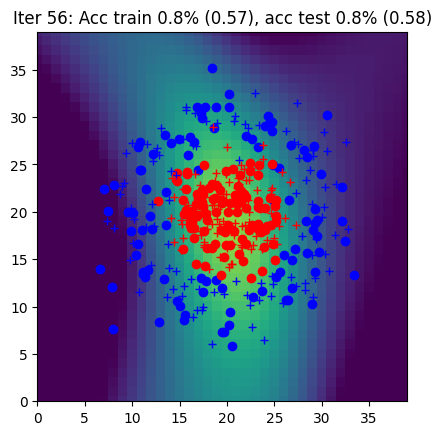

Iter 57: Acc train 0.8% (0.57), acc test 0.8% (0.57)


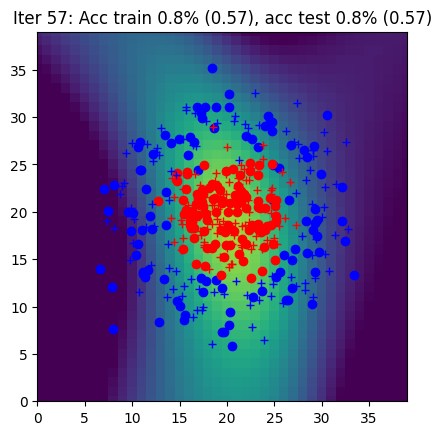

Iter 58: Acc train 0.8% (0.57), acc test 0.8% (0.57)


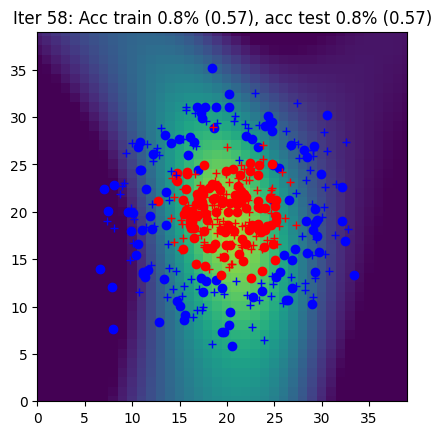

Iter 59: Acc train 0.8% (0.56), acc test 0.8% (0.57)


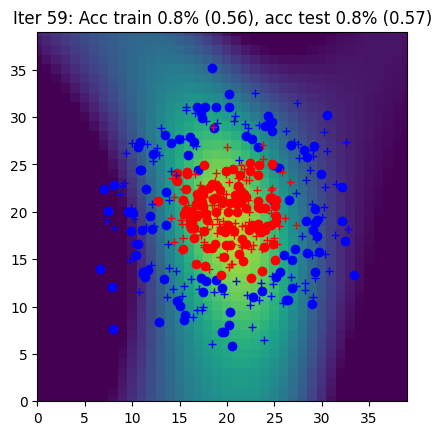

Iter 60: Acc train 0.8% (0.56), acc test 0.8% (0.56)


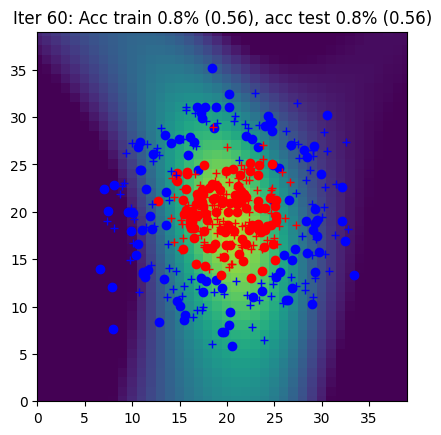

Iter 61: Acc train 0.8% (0.55), acc test 0.8% (0.56)


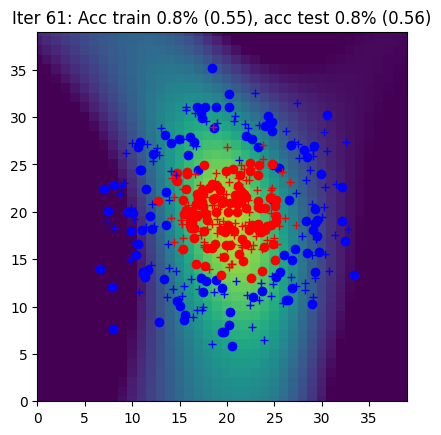

Iter 62: Acc train 0.8% (0.55), acc test 0.8% (0.55)


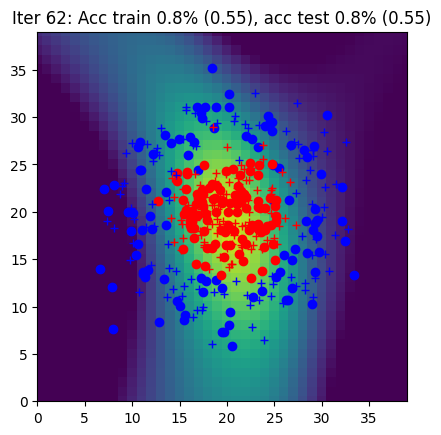

Iter 63: Acc train 0.8% (0.54), acc test 0.8% (0.55)


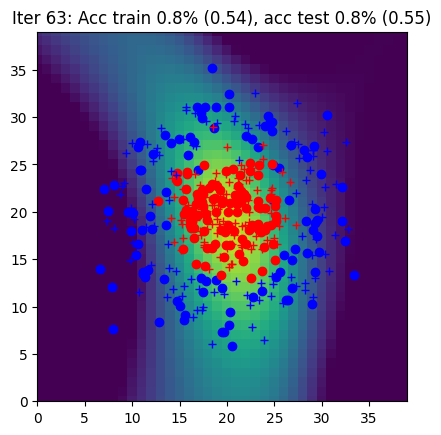

Iter 64: Acc train 0.8% (0.54), acc test 0.8% (0.55)


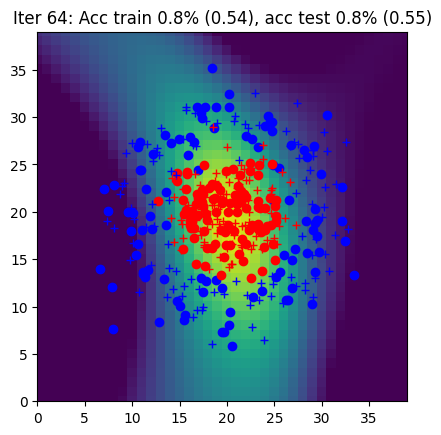

Iter 65: Acc train 0.8% (0.53), acc test 0.8% (0.54)


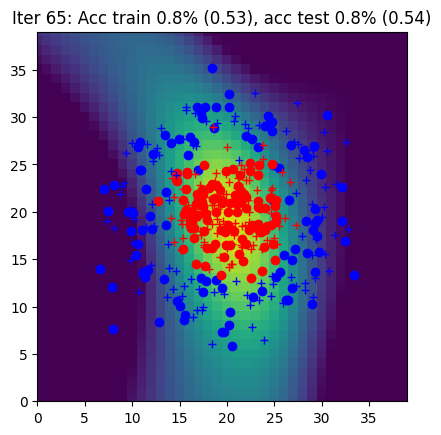

Iter 66: Acc train 0.9% (0.53), acc test 0.8% (0.54)


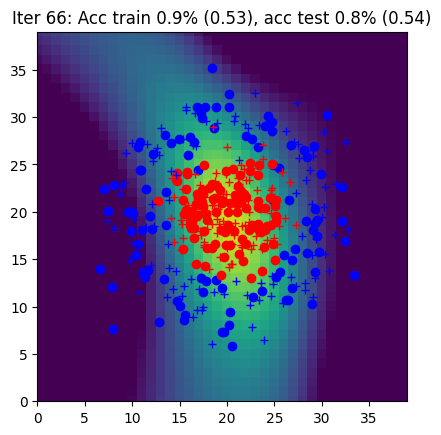

Iter 67: Acc train 0.8% (0.53), acc test 0.8% (0.53)


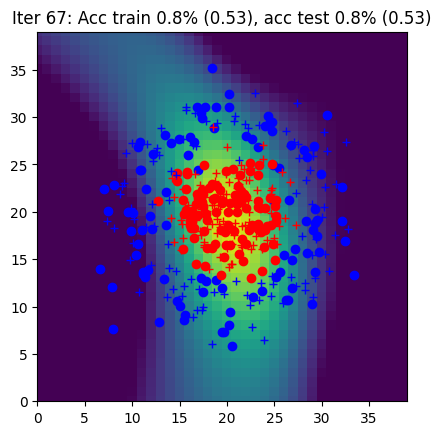

Iter 68: Acc train 0.9% (0.52), acc test 0.8% (0.53)


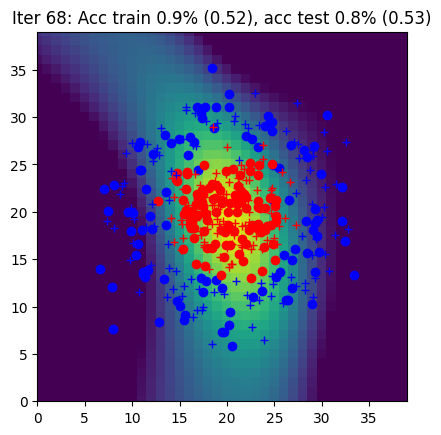

Iter 69: Acc train 0.8% (0.52), acc test 0.8% (0.53)


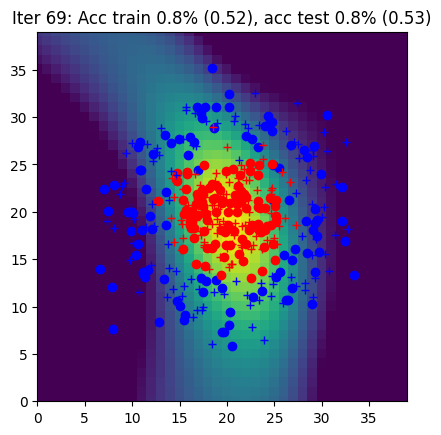

Iter 70: Acc train 0.8% (0.51), acc test 0.8% (0.52)


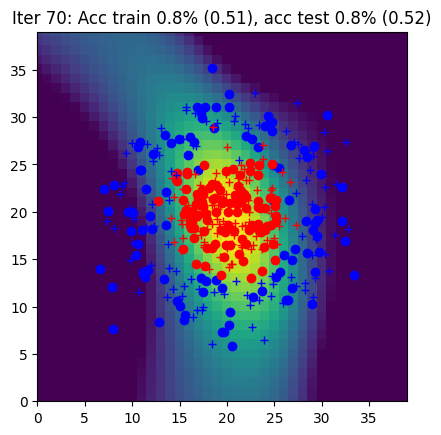

Iter 71: Acc train 0.9% (0.51), acc test 0.8% (0.52)


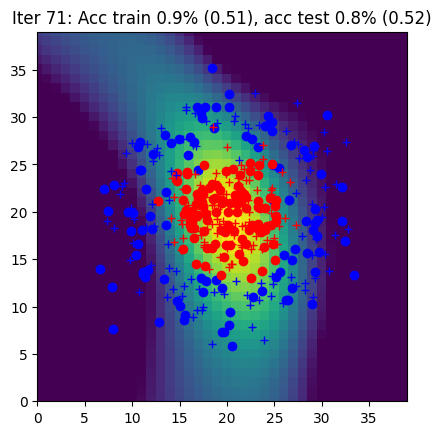

Iter 72: Acc train 0.9% (0.50), acc test 0.8% (0.51)


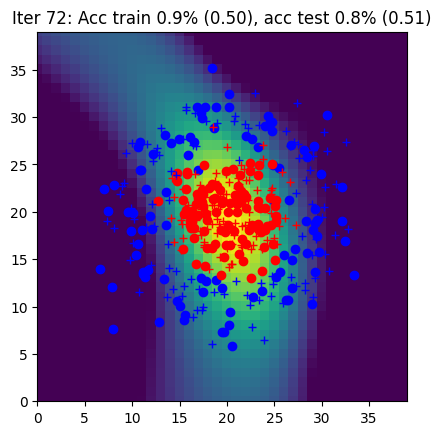

Iter 73: Acc train 0.9% (0.50), acc test 0.8% (0.51)


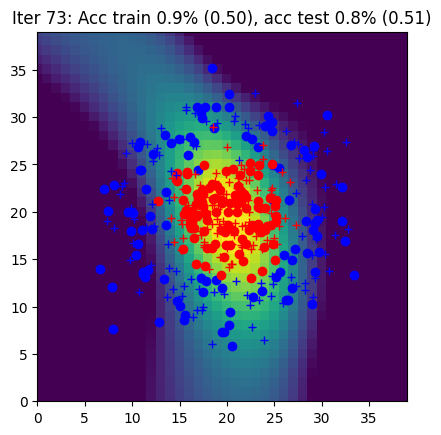

Iter 74: Acc train 0.9% (0.49), acc test 0.8% (0.50)


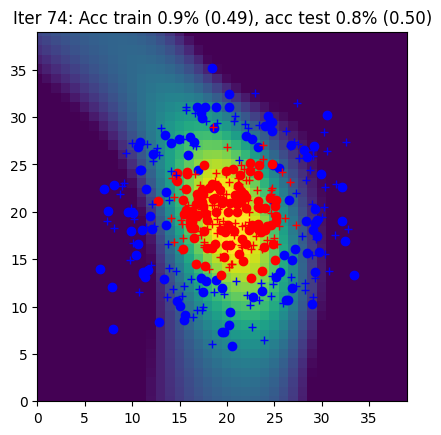

Iter 75: Acc train 0.9% (0.49), acc test 0.8% (0.50)


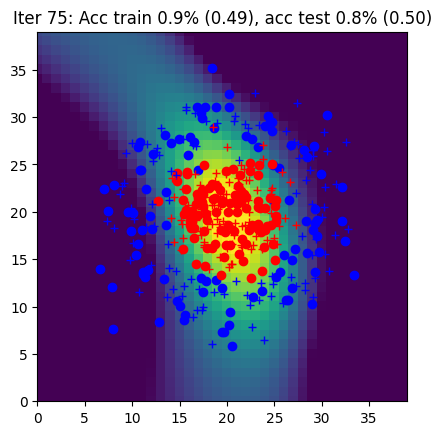

Iter 76: Acc train 0.9% (0.48), acc test 0.8% (0.49)


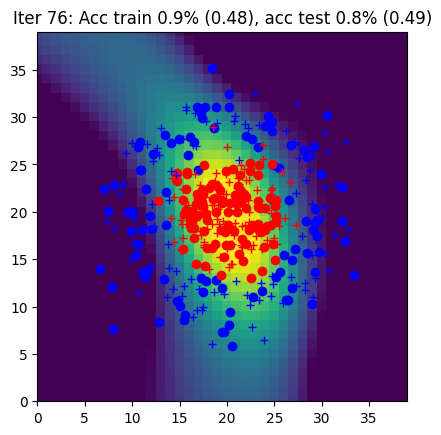

Iter 77: Acc train 0.9% (0.48), acc test 0.8% (0.49)


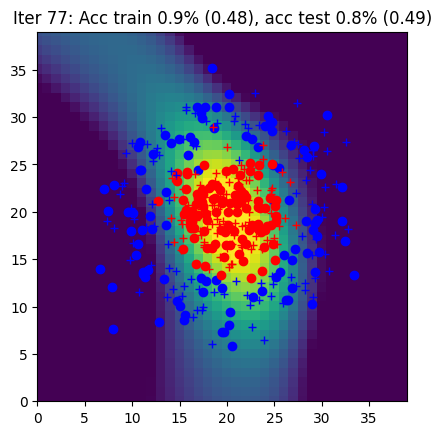

Iter 78: Acc train 0.9% (0.47), acc test 0.8% (0.49)


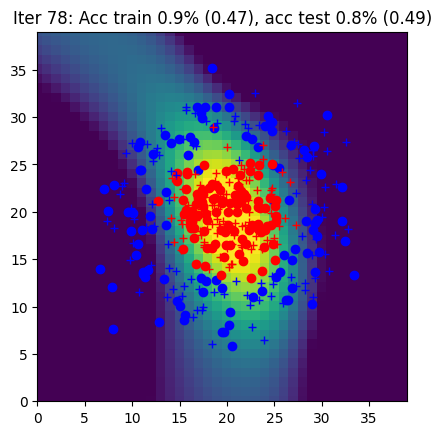

Iter 79: Acc train 0.9% (0.47), acc test 0.9% (0.48)


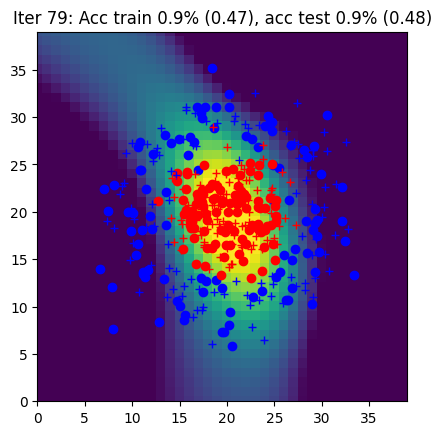

Iter 80: Acc train 0.9% (0.46), acc test 0.9% (0.48)


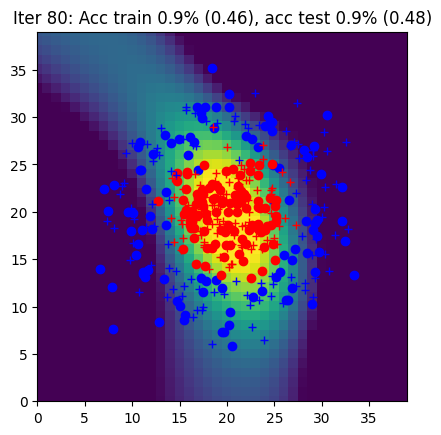

Iter 81: Acc train 0.9% (0.46), acc test 0.9% (0.47)


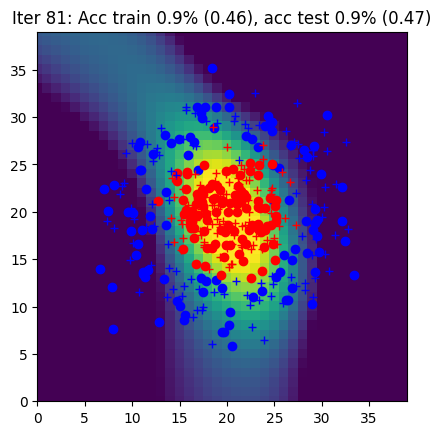

Iter 82: Acc train 0.9% (0.45), acc test 0.9% (0.47)


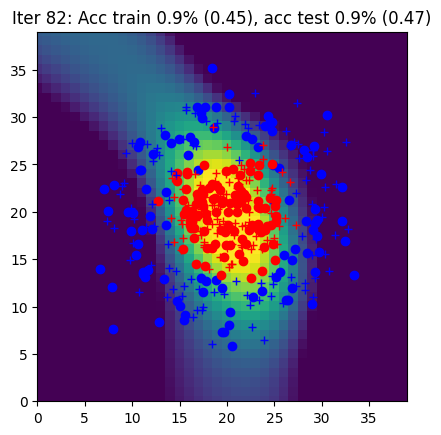

Iter 83: Acc train 0.9% (0.45), acc test 0.9% (0.46)


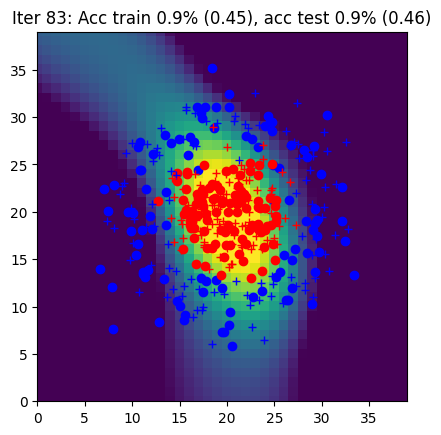

Iter 84: Acc train 0.9% (0.44), acc test 0.9% (0.46)


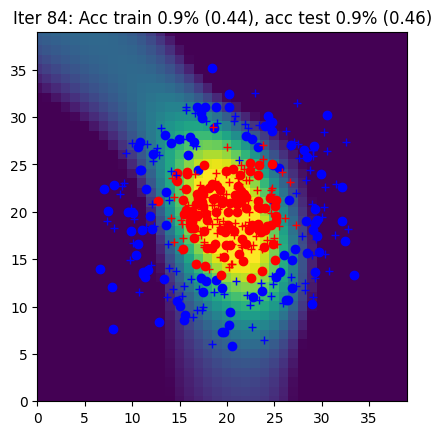

Iter 85: Acc train 0.9% (0.44), acc test 0.9% (0.45)


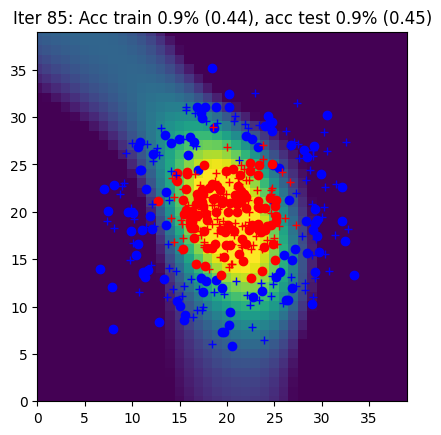

Iter 86: Acc train 0.9% (0.43), acc test 0.9% (0.45)


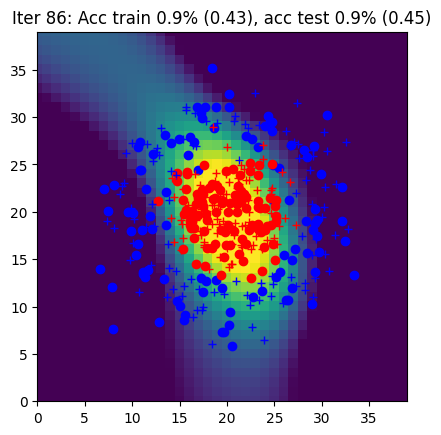

Iter 87: Acc train 0.9% (0.43), acc test 0.9% (0.45)


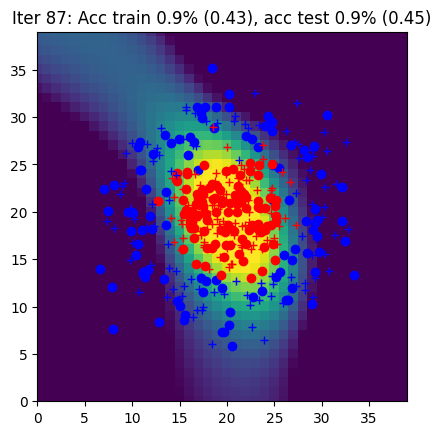

Iter 88: Acc train 0.9% (0.42), acc test 0.9% (0.44)


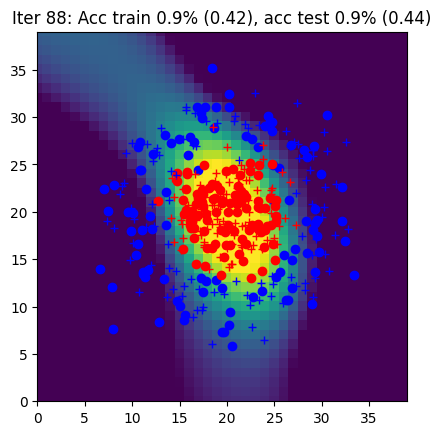

Iter 89: Acc train 0.9% (0.42), acc test 0.9% (0.44)


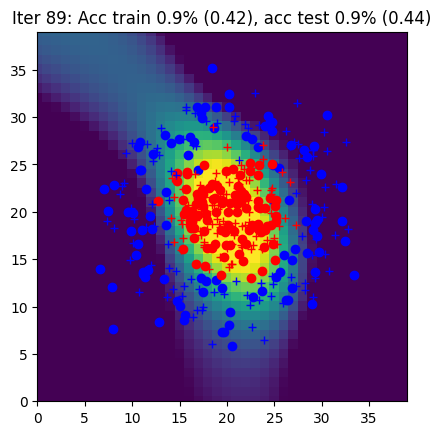

Iter 90: Acc train 0.9% (0.42), acc test 0.9% (0.43)


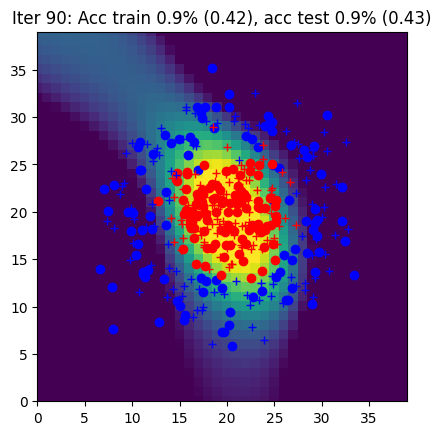

Iter 91: Acc train 0.9% (0.41), acc test 0.9% (0.43)


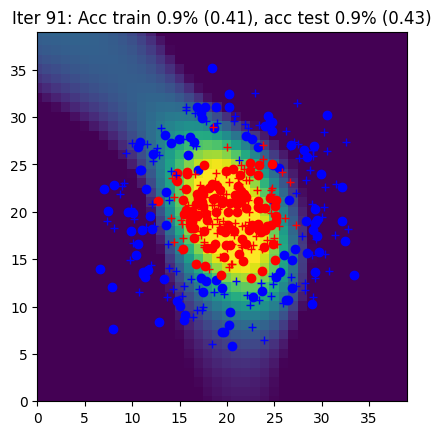

Iter 92: Acc train 0.9% (0.41), acc test 0.9% (0.42)


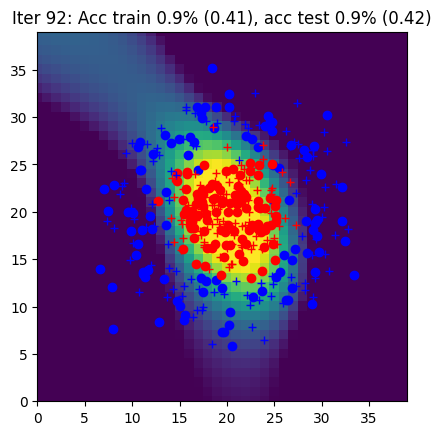

Iter 93: Acc train 0.9% (0.40), acc test 0.9% (0.42)


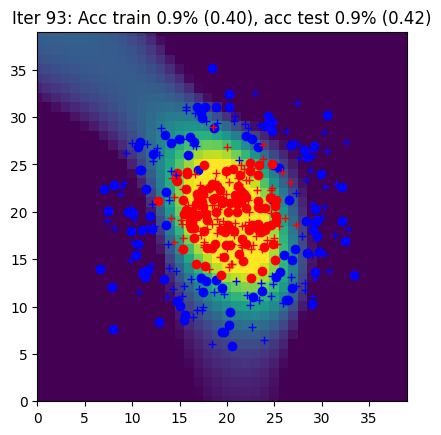

Iter 94: Acc train 0.9% (0.40), acc test 0.9% (0.42)


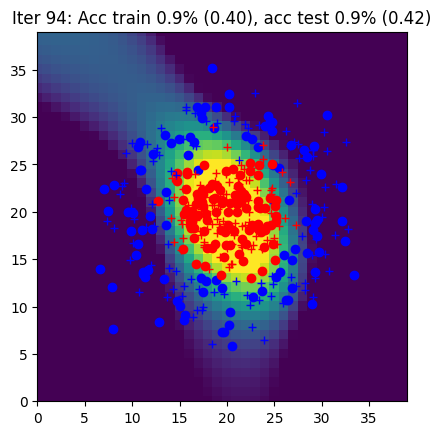

Iter 95: Acc train 0.9% (0.39), acc test 0.9% (0.41)


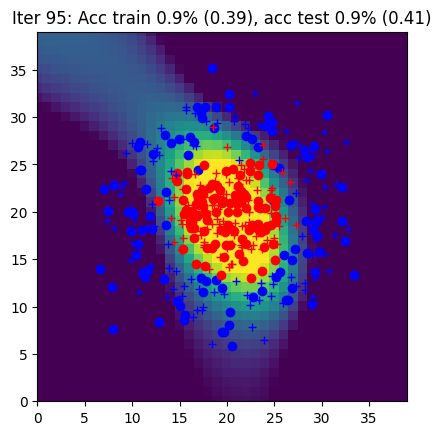

Iter 96: Acc train 0.9% (0.39), acc test 0.9% (0.41)


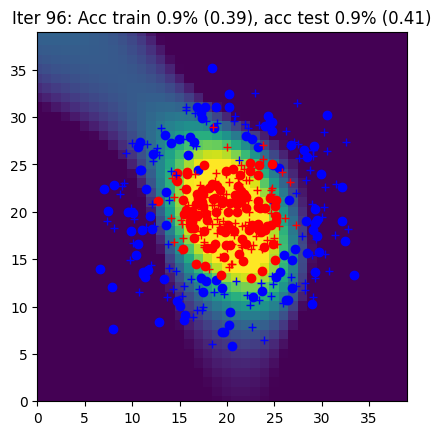

Iter 97: Acc train 0.9% (0.38), acc test 0.9% (0.40)


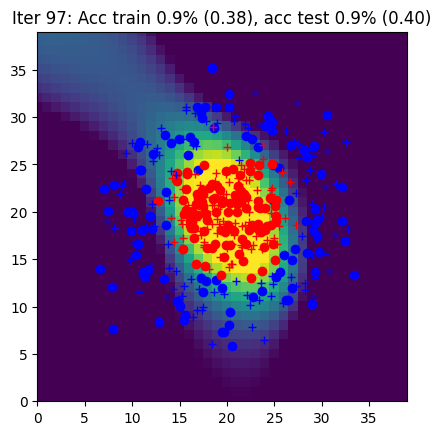

Iter 98: Acc train 0.9% (0.38), acc test 0.9% (0.40)


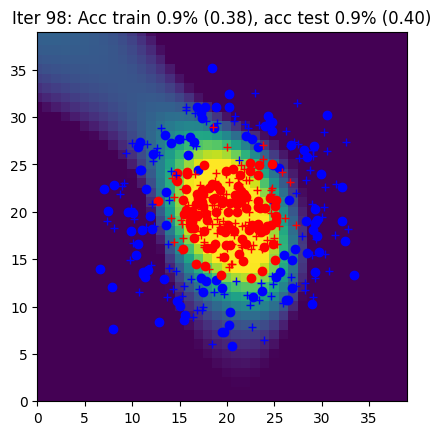

Iter 99: Acc train 0.9% (0.38), acc test 0.9% (0.39)


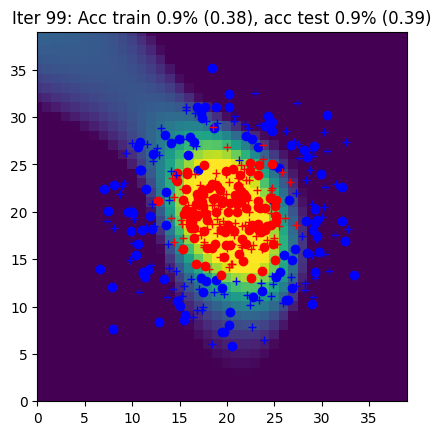

Iter 100: Acc train 0.9% (0.37), acc test 0.9% (0.39)


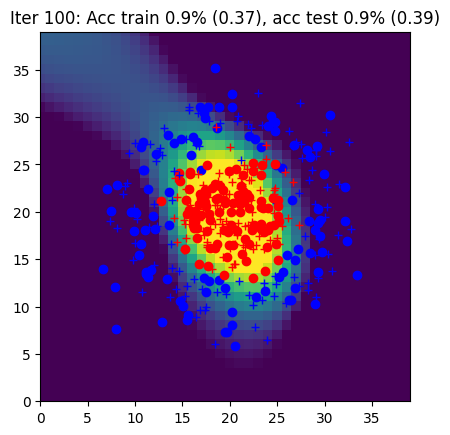

Iter 101: Acc train 0.9% (0.37), acc test 0.9% (0.39)


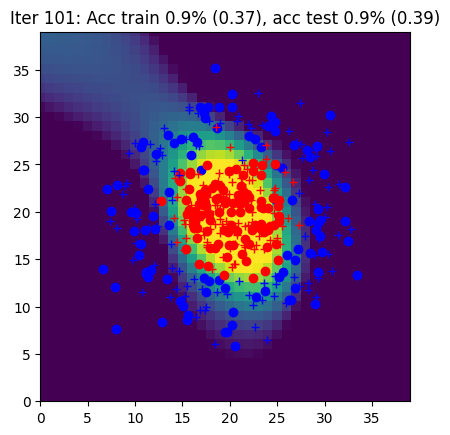

Iter 102: Acc train 0.9% (0.36), acc test 0.9% (0.38)


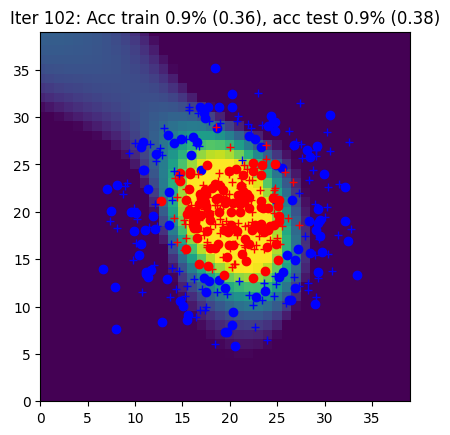

Iter 103: Acc train 0.9% (0.36), acc test 0.9% (0.38)


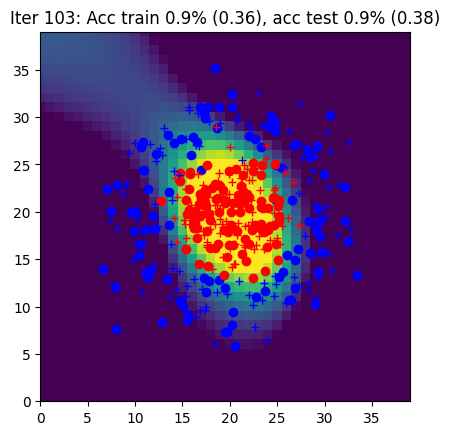

Iter 104: Acc train 0.9% (0.36), acc test 0.9% (0.37)


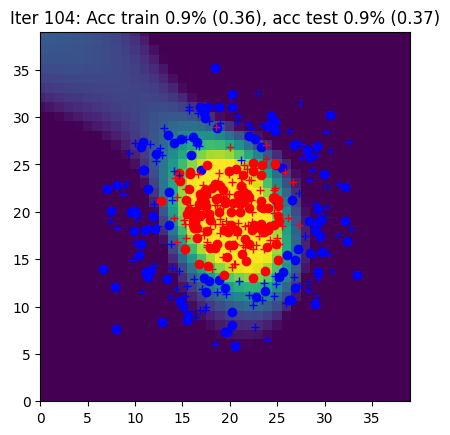

Iter 105: Acc train 0.9% (0.35), acc test 0.9% (0.37)


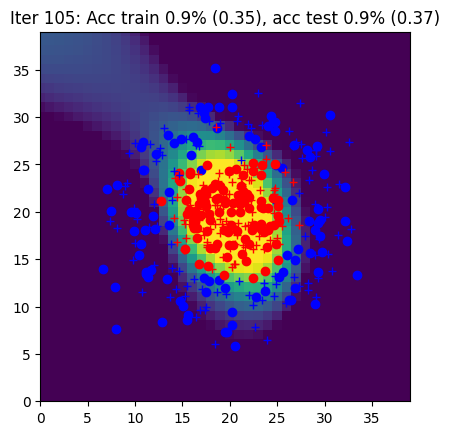

Iter 106: Acc train 0.9% (0.35), acc test 0.9% (0.37)


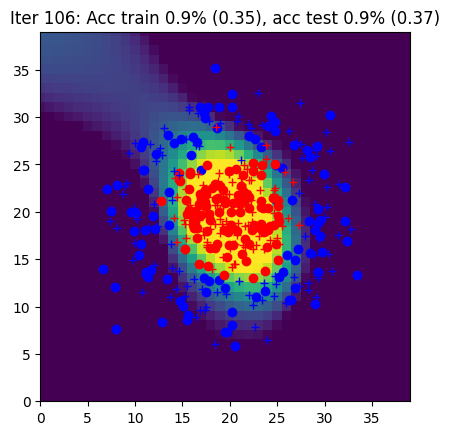

Iter 107: Acc train 0.9% (0.34), acc test 0.9% (0.36)


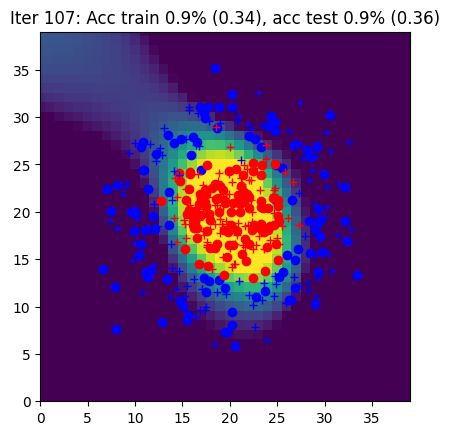

Iter 108: Acc train 0.9% (0.34), acc test 0.9% (0.36)


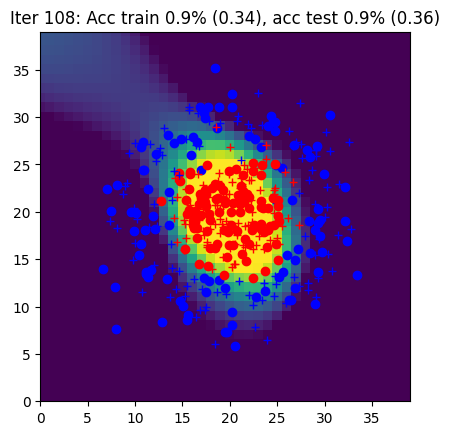

Iter 109: Acc train 0.9% (0.34), acc test 0.9% (0.35)


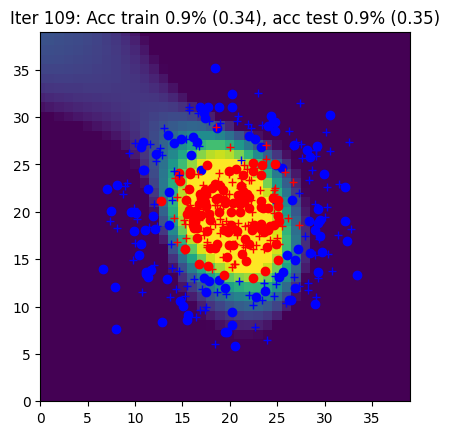

Iter 110: Acc train 0.9% (0.33), acc test 0.9% (0.35)


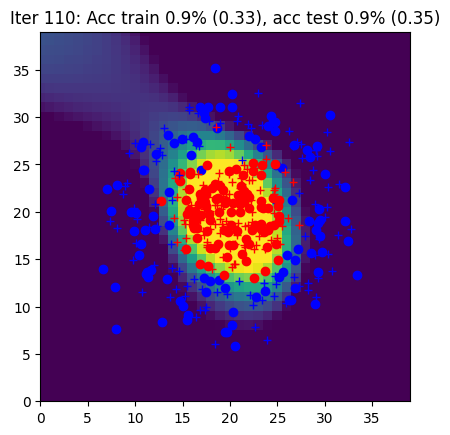

Iter 111: Acc train 0.9% (0.33), acc test 0.9% (0.35)


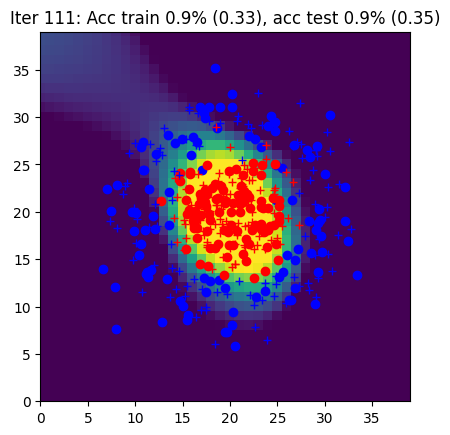

Iter 112: Acc train 0.9% (0.33), acc test 0.9% (0.34)


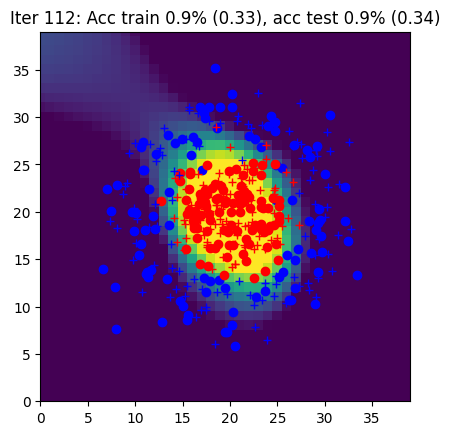

Iter 113: Acc train 0.9% (0.32), acc test 0.9% (0.34)


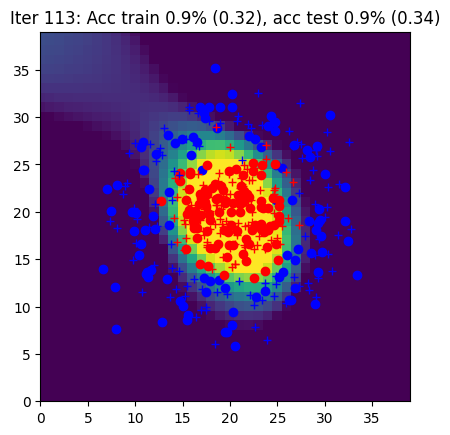

Iter 114: Acc train 0.9% (0.32), acc test 0.9% (0.34)


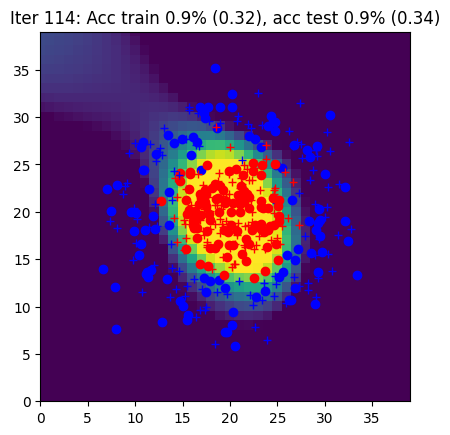

Iter 115: Acc train 0.9% (0.32), acc test 0.9% (0.33)


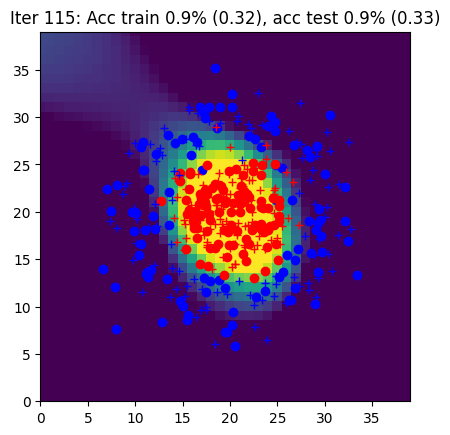

Iter 116: Acc train 0.9% (0.31), acc test 0.9% (0.33)


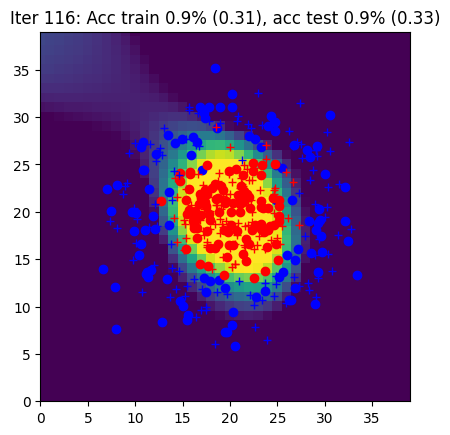

Iter 117: Acc train 0.9% (0.31), acc test 0.9% (0.33)


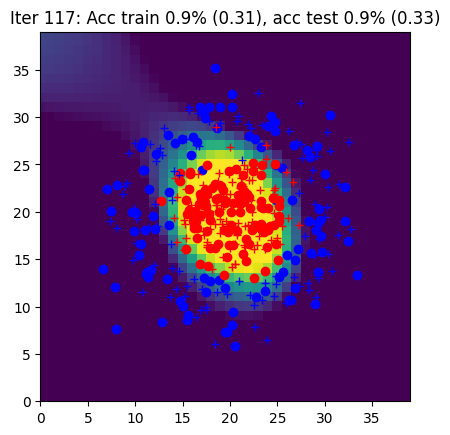

Iter 118: Acc train 0.9% (0.31), acc test 0.9% (0.32)


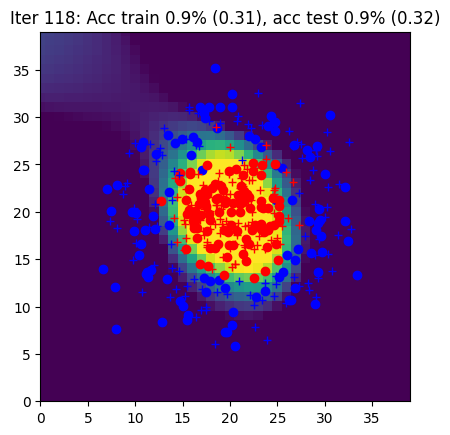

Iter 119: Acc train 0.9% (0.30), acc test 0.9% (0.32)


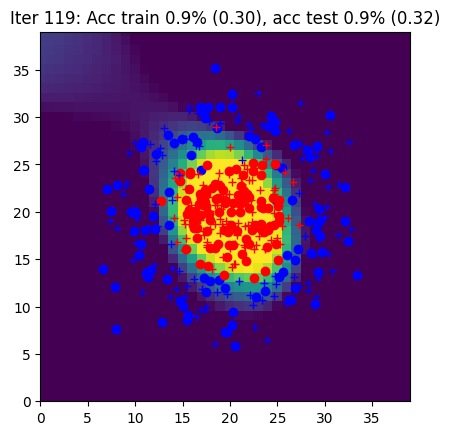

Iter 120: Acc train 0.9% (0.30), acc test 0.9% (0.32)


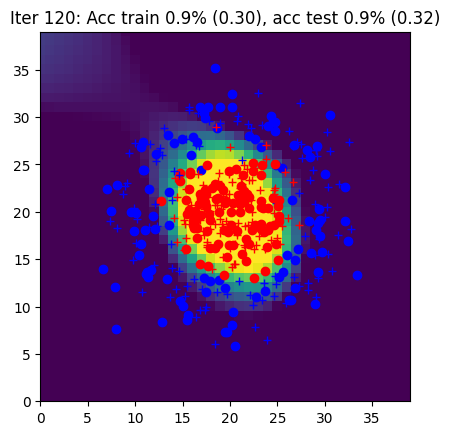

Iter 121: Acc train 1.0% (0.30), acc test 0.9% (0.31)


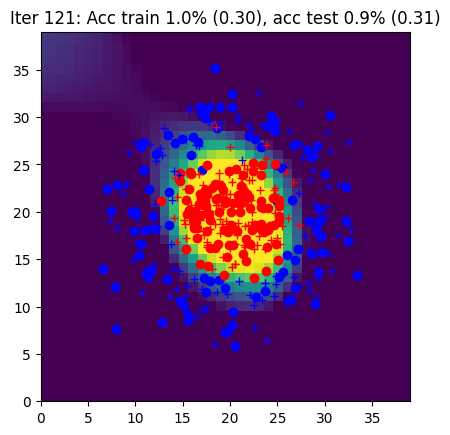

Iter 122: Acc train 1.0% (0.29), acc test 0.9% (0.31)


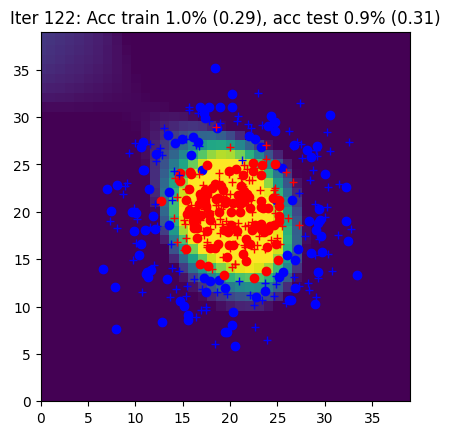

Iter 123: Acc train 1.0% (0.29), acc test 0.9% (0.31)


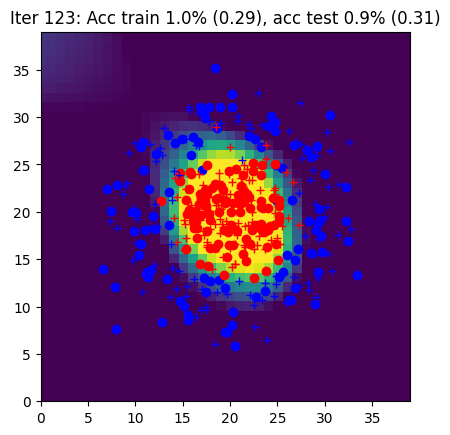

Iter 124: Acc train 1.0% (0.29), acc test 0.9% (0.30)


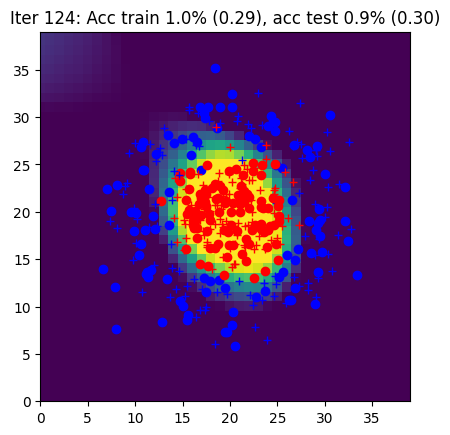

Iter 125: Acc train 1.0% (0.28), acc test 0.9% (0.30)


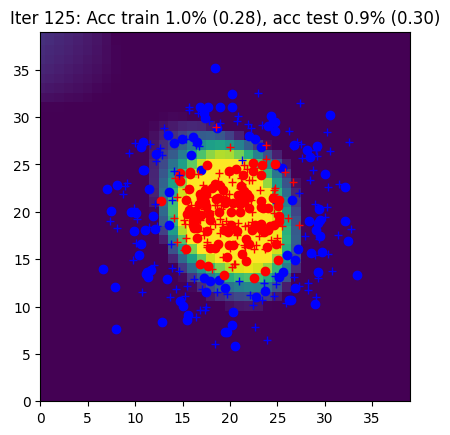

Iter 126: Acc train 1.0% (0.28), acc test 0.9% (0.30)


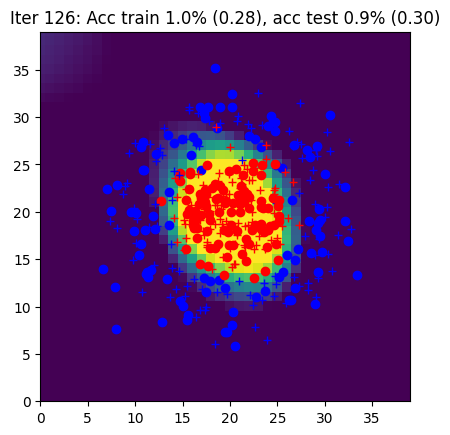

Iter 127: Acc train 1.0% (0.28), acc test 0.9% (0.30)


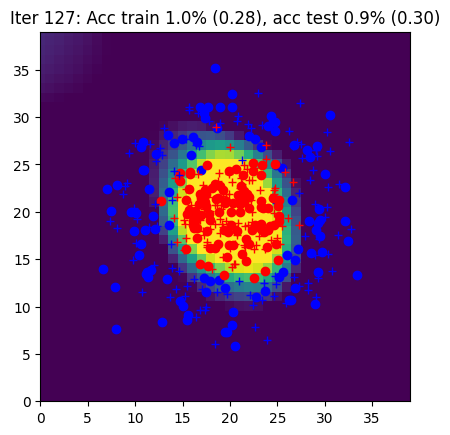

Iter 128: Acc train 1.0% (0.28), acc test 0.9% (0.29)


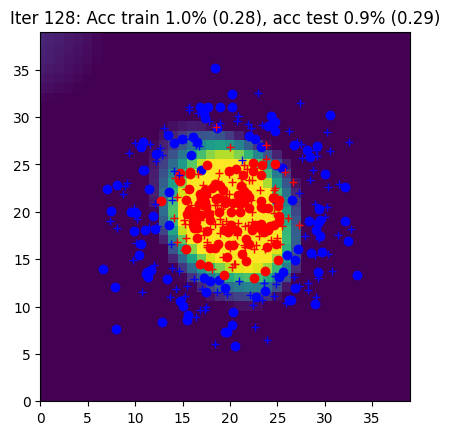

Iter 129: Acc train 1.0% (0.27), acc test 0.9% (0.29)


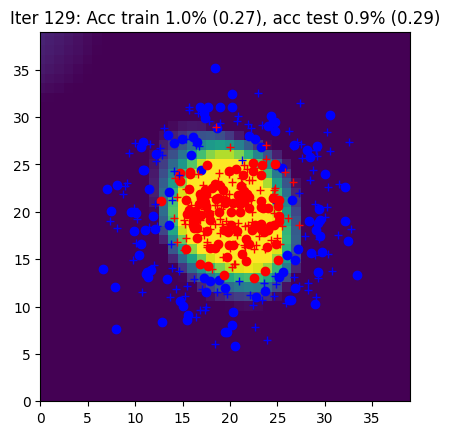

Iter 130: Acc train 1.0% (0.27), acc test 0.9% (0.29)


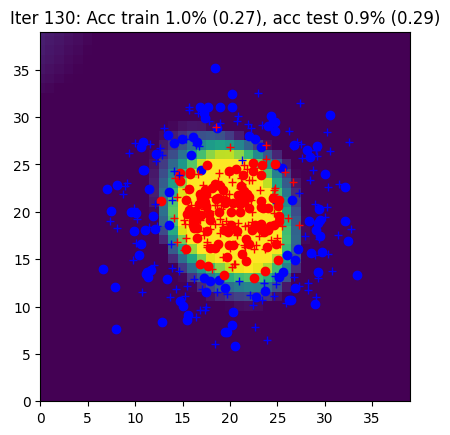

Iter 131: Acc train 1.0% (0.27), acc test 0.9% (0.29)


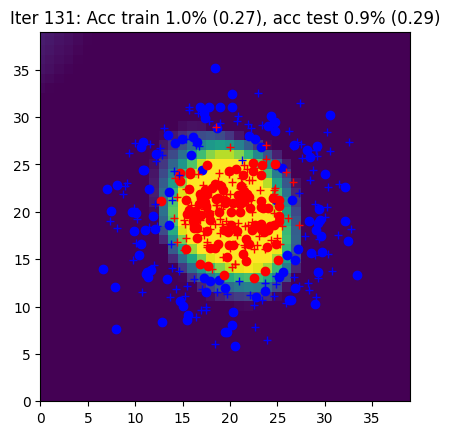

Iter 132: Acc train 1.0% (0.27), acc test 0.9% (0.28)


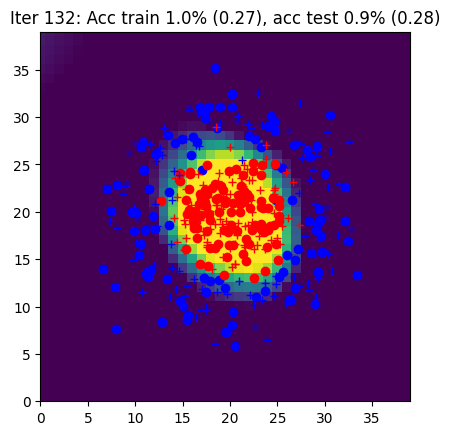

Iter 133: Acc train 1.0% (0.26), acc test 0.9% (0.28)


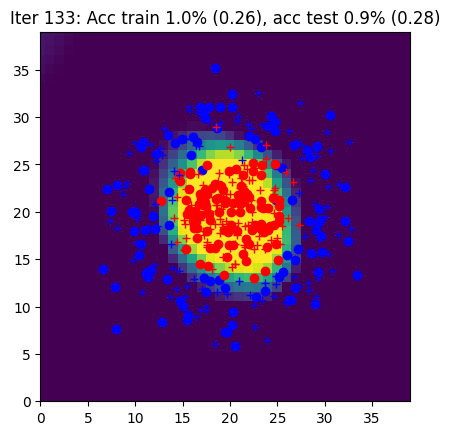

Iter 134: Acc train 1.0% (0.26), acc test 0.9% (0.28)


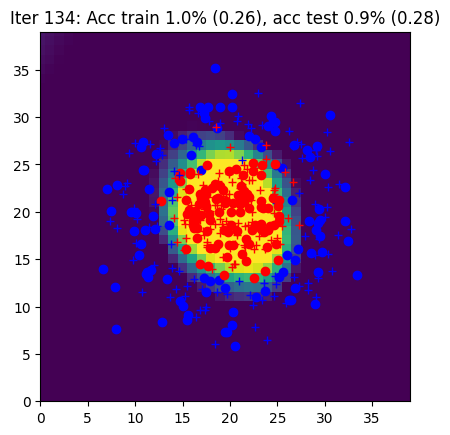

Iter 135: Acc train 1.0% (0.26), acc test 0.9% (0.28)


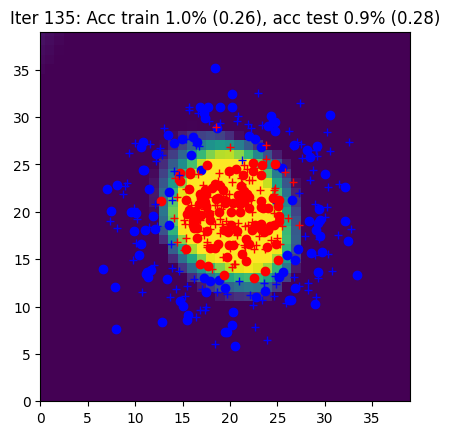

Iter 136: Acc train 1.0% (0.26), acc test 0.9% (0.27)


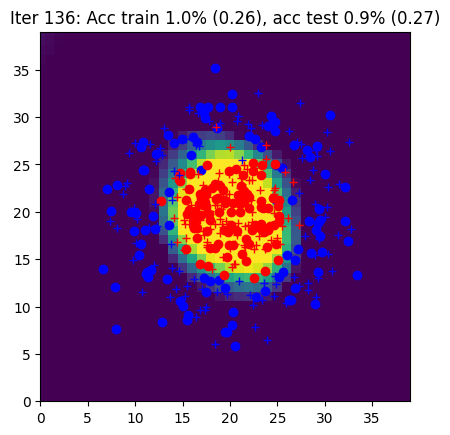

Iter 137: Acc train 1.0% (0.26), acc test 0.9% (0.27)


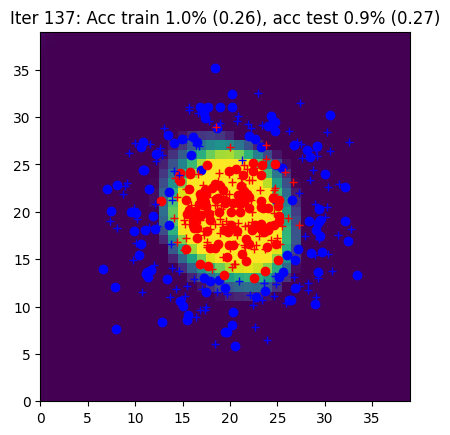

Iter 138: Acc train 1.0% (0.25), acc test 0.9% (0.27)


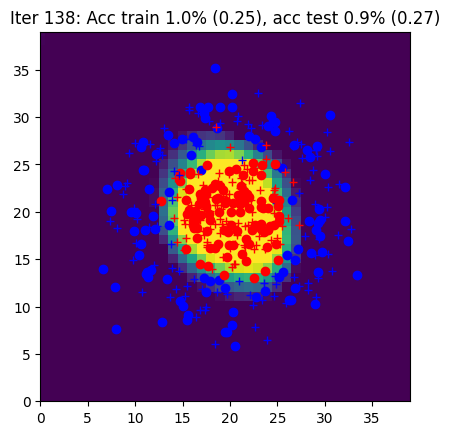

Iter 139: Acc train 1.0% (0.25), acc test 0.9% (0.27)


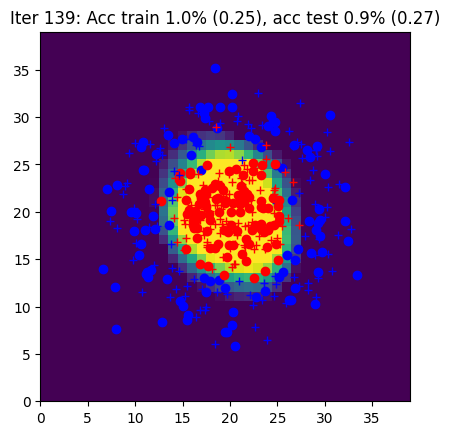

Iter 140: Acc train 1.0% (0.25), acc test 0.9% (0.27)


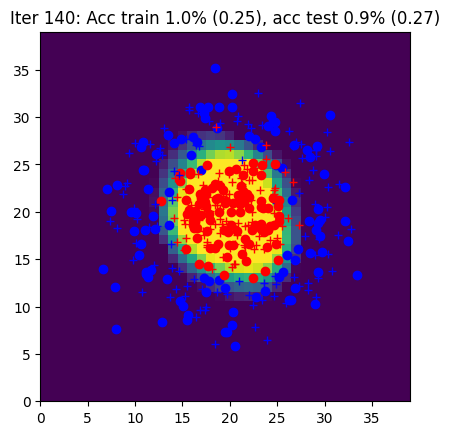

Iter 141: Acc train 1.0% (0.25), acc test 0.9% (0.26)


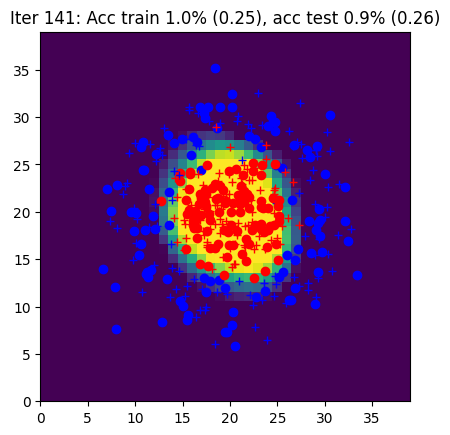

Iter 142: Acc train 1.0% (0.25), acc test 0.9% (0.26)


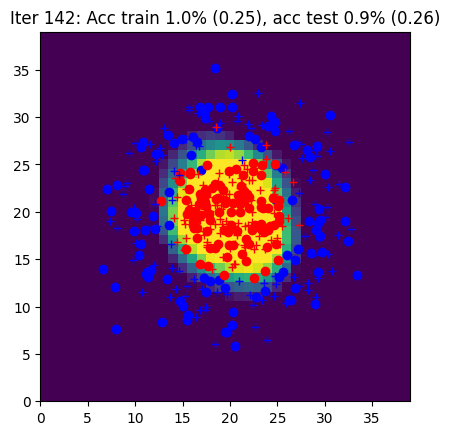

Iter 143: Acc train 1.0% (0.24), acc test 0.9% (0.26)


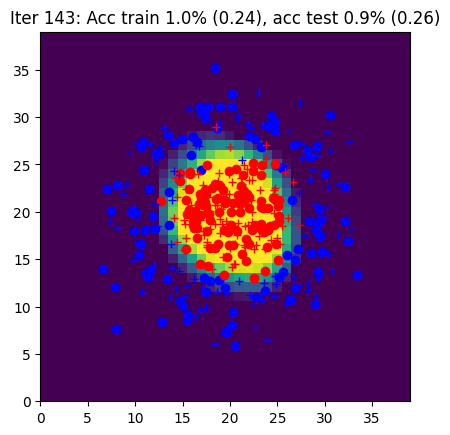

Iter 144: Acc train 1.0% (0.24), acc test 0.9% (0.26)


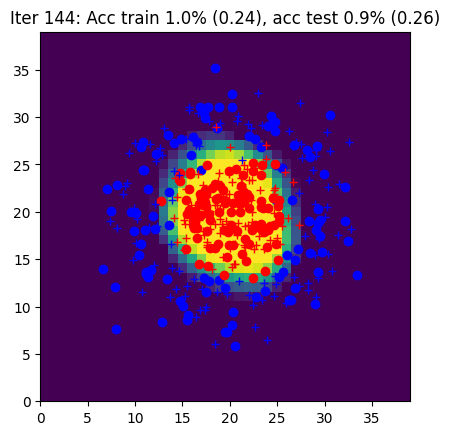

Iter 145: Acc train 1.0% (0.24), acc test 0.9% (0.26)


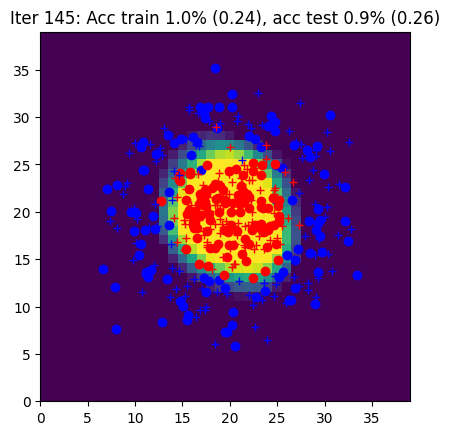

Iter 146: Acc train 1.0% (0.24), acc test 0.9% (0.25)


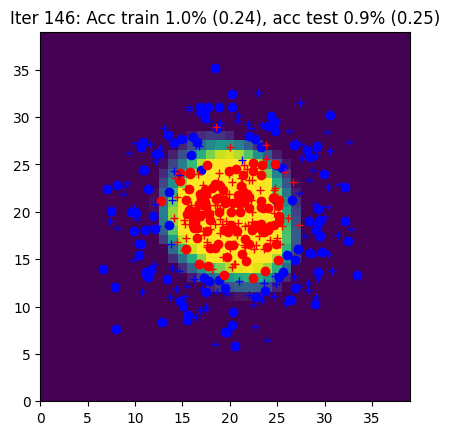

Iter 147: Acc train 1.0% (0.24), acc test 0.9% (0.25)


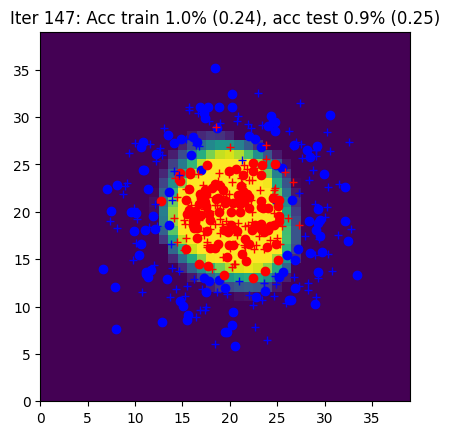

Iter 148: Acc train 1.0% (0.23), acc test 0.9% (0.25)


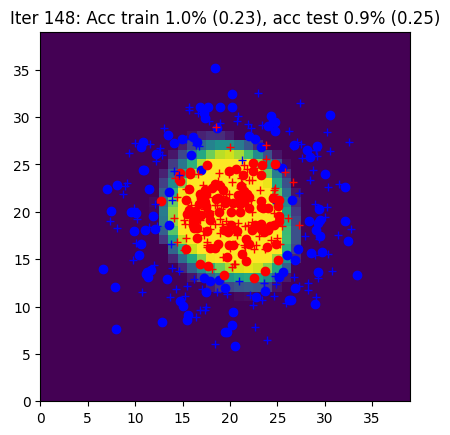

Iter 149: Acc train 1.0% (0.23), acc test 0.9% (0.25)


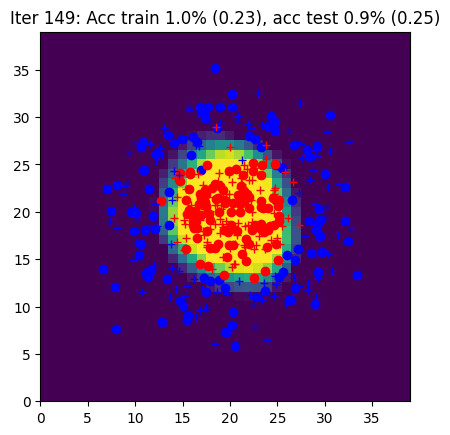

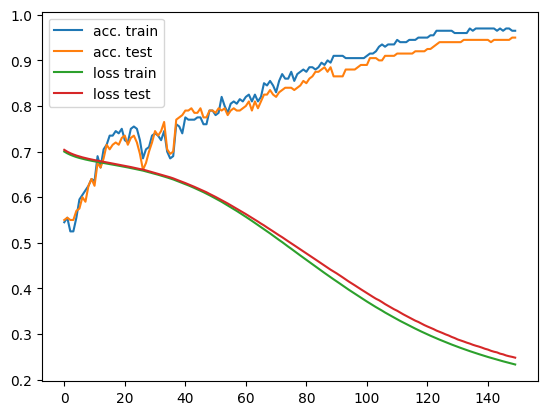

In [ ]:
# init
data = CirclesData()
data.plot_data()
N = data.Xtrain.shape[0]
Nbatch = 10
nx = data.Xtrain.shape[1]
nh = 10
ny = data.Ytrain.shape[1]
eta = 0.03

model, loss = init_model(nx, nh, ny)

curves = [[],[], [], []]

# epoch
for iteration in range(150):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    #####################
    ## Your code here  ##
    #####################
    # batches
    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j+1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]

        # write the optimization algorithm on the batch (X,Y)
        # using the functions: loss_accuracy, sgd
        # the forward with the predict method from the model
        # and the backward function with autograd

        yhat = model(X)

        L, acc = loss_accuracy(loss, yhat, Y)

        L.backward()

        model = sgd(model, eta)

    ####################
    ##      END        #
    ####################


    Yhat_train = model(data.Xtrain)
    Yhat_test = model(data.Xtest)
    Ltrain, acctrain = loss_accuracy(loss, Yhat_train, data.Ytrain)
    Ltest, acctest = loss_accuracy(loss, Yhat_test, data.Ytest)
    Ygrid = model(data.Xgrid)

    title = 'Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})'.format(iteration, acctrain, Ltrain, acctest, Ltest)
    print(title)
    data.plot_data_with_grid(torch.nn.Softmax(dim=1)(Ygrid.detach()), title)

    curves[0].append(acctrain)
    curves[1].append(acctest)
    curves[2].append(Ltrain.detach().numpy())
    curves[3].append(Ltest.detach().numpy())

fig = plt.figure()
plt.plot(curves[0], label="acc. train")
plt.plot(curves[1], label="acc. test")
plt.plot(curves[2], label="loss train")
plt.plot(curves[3], label="loss test")
plt.legend()
plt.show()

# Part 4 : Simplification of the SGD with `torch.optim`

In [ ]:
def init_model(nx, nh, ny, eta):

    #####################
    ## Your code here  ##
    #####################

    model = torch.nn.Sequential(
        torch.nn.Linear(nx, nh),
        torch.nn.Tanh(),
        torch.nn.Linear(nh, ny),
    )
    loss = torch.nn.CrossEntropyLoss()
    optim = torch.optim.SGD(model.parameters(), lr=eta)

    ####################
    ##      END        #
    ####################

    return model, loss, optim

The `sgd` function is replaced by calling the `optim.zero_grad()` before the backward and `optim.step()` after.

## Algorithme global d'apprentissage (avec autograd, les couches `torch.nn` et `torch.optim`)

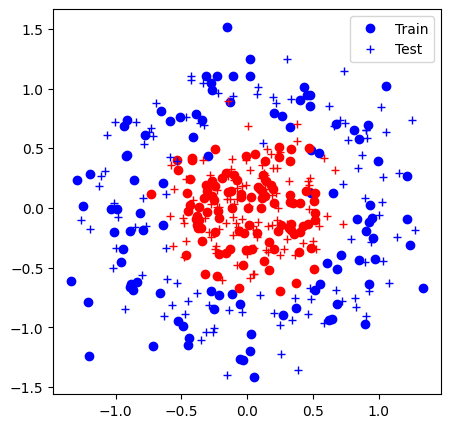

Iter 0: Acc train 0.6% (0.69), acc test 0.6% (0.69)
Iter 1: Acc train 0.6% (0.69), acc test 0.6% (0.69)
Iter 2: Acc train 0.6% (0.69), acc test 0.6% (0.69)
Iter 3: Acc train 0.6% (0.69), acc test 0.6% (0.69)
Iter 4: Acc train 0.6% (0.69), acc test 0.6% (0.69)
Iter 5: Acc train 0.6% (0.68), acc test 0.6% (0.69)
Iter 6: Acc train 0.6% (0.68), acc test 0.6% (0.68)
Iter 7: Acc train 0.6% (0.68), acc test 0.6% (0.68)
Iter 8: Acc train 0.6% (0.68), acc test 0.6% (0.68)
Iter 9: Acc train 0.7% (0.68), acc test 0.7% (0.68)
Iter 10: Acc train 0.7% (0.68), acc test 0.6% (0.68)
Iter 11: Acc train 0.7% (0.68), acc test 0.7% (0.68)
Iter 12: Acc train 0.7% (0.68), acc test 0.7% (0.68)
Iter 13: Acc train 0.7% (0.68), acc test 0.7% (0.68)
Iter 14: Acc train 0.7% (0.67), acc test 0.6% (0.68)
Iter 15: Acc train 0.7% (0.67), acc test 0.6% (0.67)
Iter 16: Acc train 0.7% (0.67), acc test 0.7% (0.67)
Iter 17: Acc train 0.7% (0.67), acc test 0.7% (0.67)
Iter 18: Acc train 0.7% (0.67), acc test 0.7% (0.67)
Ite

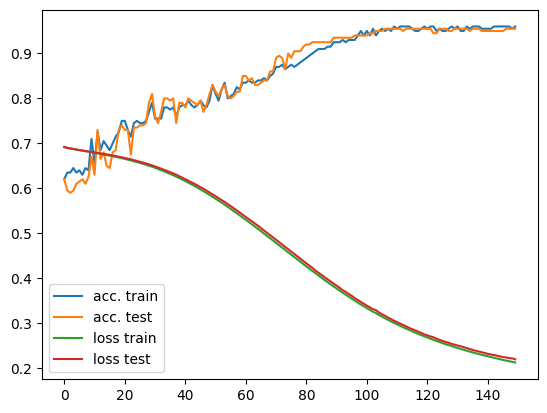

In [ ]:
# init
data = CirclesData()
data.plot_data()
N = data.Xtrain.shape[0]
Nbatch = 10
nx = data.Xtrain.shape[1]
nh = 10
ny = data.Ytrain.shape[1]
eta = 0.03

model, loss, optim = init_model(nx, nh, ny, eta)

curves = [[],[], [], []]

# epoch
for iteration in range(150):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    #####################
    ## Your code  here ##
    #####################
    # batches
    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j+1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]

        # write the optimization algorithm on the batch (X,Y)
        # using the functions: loss_accuracy
        # the forward with the predict method from the model
        # the backward function with autograd
        # and then an optimization step
        yhat = model(X)

        L, acc = loss_accuracy(loss, yhat, Y)

        optim.zero_grad()
        L.backward()

        optim.step()


    ####################
    ##      FIN        #
    ####################


    Yhat_train = model(data.Xtrain)
    Yhat_test = model(data.Xtest)
    Ltrain, acctrain = loss_accuracy(loss, Yhat_train, data.Ytrain)
    Ltest, acctest = loss_accuracy(loss, Yhat_test, data.Ytest)
    Ygrid = model(data.Xgrid)

    title = 'Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})'.format(iteration, acctrain, Ltrain, acctest, Ltest)
    print(title)
    #data.plot_data_with_grid(torch.nn.Softmax(dim=1)(Ygrid.detach()), title)

    curves[0].append(acctrain)
    curves[1].append(acctest)
    curves[2].append(Ltrain.detach().numpy())
    curves[3].append(Ltest.detach().numpy())

fig = plt.figure()
plt.plot(curves[0], label="acc. train")
plt.plot(curves[1], label="acc. test")
plt.plot(curves[2], label="loss train")
plt.plot(curves[3], label="loss test")
plt.legend()
plt.show()

# Part 5 : MNIST

Apply the code from previous part code to the MNIST dataset.

Iter 0: Acc train 0.9% (0.49), acc test 0.9% (0.48)
Iter 1: Acc train 0.9% (0.43), acc test 0.9% (0.42)
Iter 2: Acc train 0.9% (0.46), acc test 0.9% (0.46)
Iter 3: Acc train 0.9% (0.42), acc test 0.9% (0.40)
Iter 4: Acc train 0.9% (0.41), acc test 0.9% (0.41)
Iter 5: Acc train 0.9% (0.40), acc test 0.9% (0.40)
Iter 6: Acc train 0.9% (0.36), acc test 0.9% (0.35)
Iter 7: Acc train 0.9% (0.37), acc test 0.9% (0.36)
Iter 8: Acc train 0.9% (0.38), acc test 0.9% (0.37)
Iter 9: Acc train 0.9% (0.39), acc test 0.9% (0.38)
Iter 10: Acc train 0.9% (0.43), acc test 0.9% (0.42)
Iter 11: Acc train 0.9% (0.37), acc test 0.9% (0.35)
Iter 12: Acc train 0.9% (0.38), acc test 0.9% (0.38)
Iter 13: Acc train 0.9% (0.36), acc test 0.9% (0.35)
Iter 14: Acc train 0.9% (0.35), acc test 0.9% (0.33)
Iter 15: Acc train 0.9% (0.35), acc test 0.9% (0.34)
Iter 16: Acc train 0.9% (0.34), acc test 0.9% (0.33)
Iter 17: Acc train 0.9% (0.32), acc test 0.9% (0.32)
Iter 18: Acc train 0.9% (0.35), acc test 0.9% (0.34)
Ite

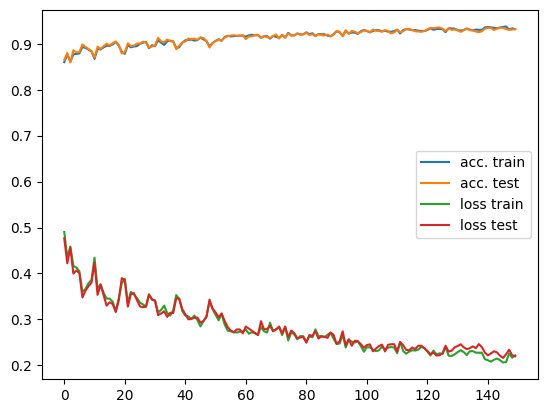

In [ ]:
# init
data = MNISTData()
N = data.Xtrain.shape[0]
Nbatch = 100
nx = data.Xtrain.shape[1]
nh = 100
ny = data.Ytrain.shape[1]
eta = 0.03

model, loss, optim = init_model(nx, nh, ny, eta)

curves = [[],[], [], []]

# epoch
for iteration in range(150):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    #####################
    ## Your code  here ##
    #####################
    # batches
    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j+1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]

        # write the optimization algorithm on the batch (X,Y)
        # using the functions: loss_accuracy
        # the forward with the predict method from the model
        # the backward function with autograd
        # and then an optimization step
        yhat = model(X)

        L, acc = loss_accuracy(loss, yhat, Y)

        optim.zero_grad()
        L.backward()

        optim.step()


    ####################
    ##      FIN        #
    ####################


    Yhat_train = model(data.Xtrain)
    Yhat_test = model(data.Xtest)
    Ltrain, acctrain = loss_accuracy(loss, Yhat_train, data.Ytrain)
    Ltest, acctest = loss_accuracy(loss, Yhat_test, data.Ytest)
    #Ygrid = model(data.Xgrid)

    title = 'Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})'.format(iteration, acctrain, Ltrain, acctest, Ltest)
    print(title)
    #data.plot_data_with_grid(torch.nn.Softmax(dim=1)(Ygrid.detach()), title)

    curves[0].append(acctrain)
    curves[1].append(acctest)
    curves[2].append(Ltrain.detach().numpy())
    curves[3].append(Ltest.detach().numpy())

fig = plt.figure()
plt.plot(curves[0], label="acc. train")
plt.plot(curves[1], label="acc. test")
plt.plot(curves[2], label="loss train")
plt.plot(curves[3], label="loss test")
plt.legend()
plt.show()

# Part 6: Bonus: SVM


Train a SVM model on the Circles dataset.

Ideas :
- First try a linear SVM (sklearn.svm.LinearSVC dans scikit-learn). Does it work well ? Why ?
- Then try more complex kernels (sklearn.svm.SVC). Which one is the best ? why ?
- Does the parameter C of regularization have an impact? Why ?

In [5]:
# data
data = CirclesData()
Xtrain = data.Xtrain.numpy()
Ytrain = data.Ytrain[:, 0].numpy()

Xgrid = data.Xgrid.numpy()

Xtest = data.Xtest.numpy()
Ytest = data.Ytest[:, 0].numpy()

def plot_svm_predictions(data, predictions):
      plt.figure(2)
      plt.clf()
      plt.imshow(np.reshape(predictions, (40,40)))
      plt.plot(data._Xtrain[data._Ytrain[:,0] == 1,0]*10+20, data._Xtrain[data._Ytrain[:,0] == 1,1]*10+20, 'bo', label="Train")
      plt.plot(data._Xtrain[data._Ytrain[:,1] == 1,0]*10+20, data._Xtrain[data._Ytrain[:,1] == 1,1]*10+20, 'ro')
      plt.plot(data._Xtest[data._Ytest[:,0] == 1,0]*10+20, data._Xtest[data._Ytest[:,0] == 1,1]*10+20, 'b+', label="Test")
      plt.plot(data._Xtest[data._Ytest[:,1] == 1,0]*10+20, data._Xtest[data._Ytest[:,1] == 1,1]*10+20, 'r+')
      plt.xlim(0,39)
      plt.ylim(0,39)
      plt.clim(0.3,0.7)
      plt.draw()
      plt.pause(1e-3)

## LinearSVC

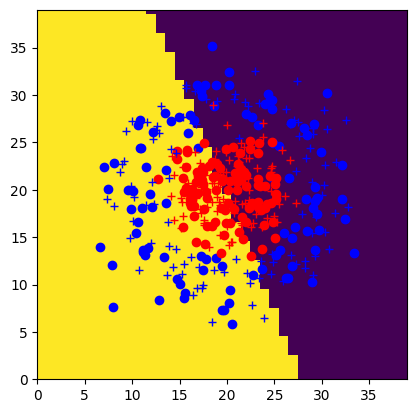

In [7]:
import sklearn.svm

############################
### Your code here   #######
### Train the SVM    #######
## See https://scikit-learn.org/stable/modules/generated/sklearn.svm.LinearSVC.html
## and https://scikit-learn.org/stable/modules/generated/sklearn.svm.SVC.html
############################

svm = sklearn.svm.LinearSVC()
svm.fit(Xtrain, Ytrain)

# Make predictions on the grid data
predictions = svm.predict(Xgrid)

# Plot the predictions
plot_svm_predictions(data, predictions)


###########################

Accuracy : 53.00


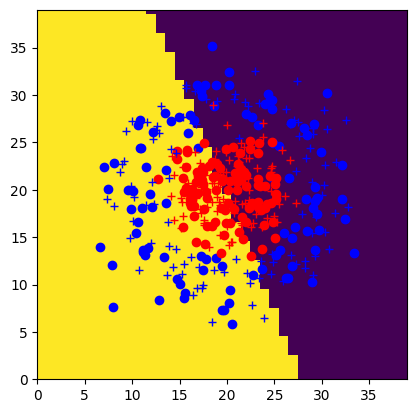

In [8]:
## Print results

Ytest_pred = svm.predict(Xtest)
accuracy = np.sum(Ytest == Ytest_pred) / len(Ytest)
print(f"Accuracy : {100 * accuracy:.2f}")
Ygrid_pred = svm.predict(Xgrid)
plot_svm_predictions(data, Ygrid_pred)

No, the linear SVM does not work well, as it only achieved 53% accuracy, close to random guessing. This is likely because the data is not linearly separable


## More complex kernel SVC

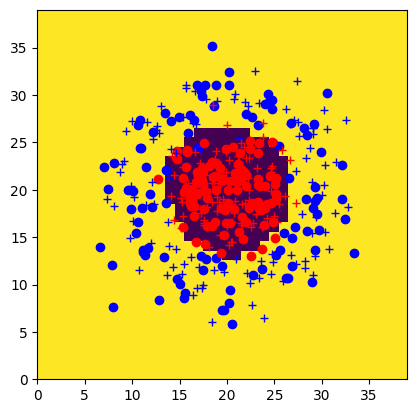

In [9]:
import sklearn.svm

############################
### Your code here   #######
### Train the SVM    #######
## See https://scikit-learn.org/stable/modules/generated/sklearn.svm.LinearSVC.html
## and https://scikit-learn.org/stable/modules/generated/sklearn.svm.SVC.html
############################

svm = sklearn.svm.SVC()
svm.fit(Xtrain, Ytrain)

# Make predictions on the grid data
predictions = svm.predict(Xgrid)

# Plot the predictions
plot_svm_predictions(data, predictions)


###########################

Accuracy : 94.00


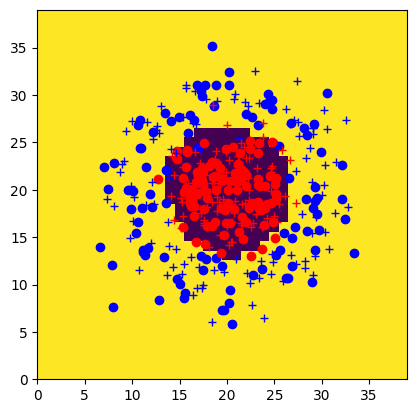

In [10]:
## Print results

Ytest_pred = svm.predict(Xtest)
accuracy = np.sum(Ytest == Ytest_pred) / len(Ytest)
print(f"Accuracy : {100 * accuracy:.2f}")
Ygrid_pred = svm.predict(Xgrid)
plot_svm_predictions(data, Ygrid_pred)

Using `SVC` with different kernels improved accuracy significantly. For instance, the RBF kernel achieved 94% accuracy, which is much better than the linear model.

The RBF (Radial Basis Function) kernel works best here because it can model non-linear boundaries by mapping the data into a higher-dimensional space. This flexibility allows it to handle complex, circular patterns, like those in this dataset, that linear models struggle with.
